In [2]:
library(Seurat)
library(ggplot2)
library(grid)
library(dplyr)
folder_path <- "/home/exacloud/gscratch/ShreeLab/scRNAseq_Data/Tumor_Normal/Seurat_Objects/Indiv_Pre_Objects"
file_list <- list.files(path = folder_path, pattern = "\\.RDS$", full.names = TRUE)

# Read all files into a list of data frames
data_list <- lapply(file_list, readRDS)

In [8]:
print(length(file_list))

[1] 44


In [3]:
data_list <- lapply(data_list, UpdateSeuratObject)

Merged_patients <- merge(data_list[[1]], y = data_list[-1], project = "Merged_patients")

Validating object structure

Updating object slots

Ensuring keys are in the proper structure

Warning message:
“Assay RNA changing from Assay to Assay”
Ensuring keys are in the proper structure

Ensuring feature names don't have underscores or pipes

Updating slots in RNA

Validating object structure for Assay ‘RNA’

Object representation is consistent with the most current Seurat version

Validating object structure

Updating object slots

Ensuring keys are in the proper structure

Warning message:
“Assay RNA changing from Assay to Assay”
Ensuring keys are in the proper structure

Ensuring feature names don't have underscores or pipes

Updating slots in RNA

Validating object structure for Assay ‘RNA’

Object representation is consistent with the most current Seurat version

Validating object structure

Updating object slots

Ensuring keys are in the proper structure

Warning message:
“Assay RNA changing from Assay to Assay”
Ensuring keys are in the proper structure

Ensuring feature

In [4]:
# Add number of genes per UMI for each cell to metadata
Merged_patients$log10GenesPerUMI <- log10(Merged_patients$nFeature_RNA) / log10(Merged_patients$nCount_RNA)
# Compute percent mito ratio
Merged_patients$mitoRatio <- PercentageFeatureSet(object = Merged_patients, pattern = "^MT-")
Merged_patients$mitoRatio <- Merged_patients@meta.data$mitoRatio / 100

# Create metadata dataframe
metadata <- Merged_patients@meta.data
# Add cell IDs to metadata
metadata$cells <- rownames(metadata)

# Rename columns
metadata <- metadata %>%
        dplyr::rename(seq_folder = orig.ident,
                      nUMI = nCount_RNA,
                      nGene = nFeature_RNA)

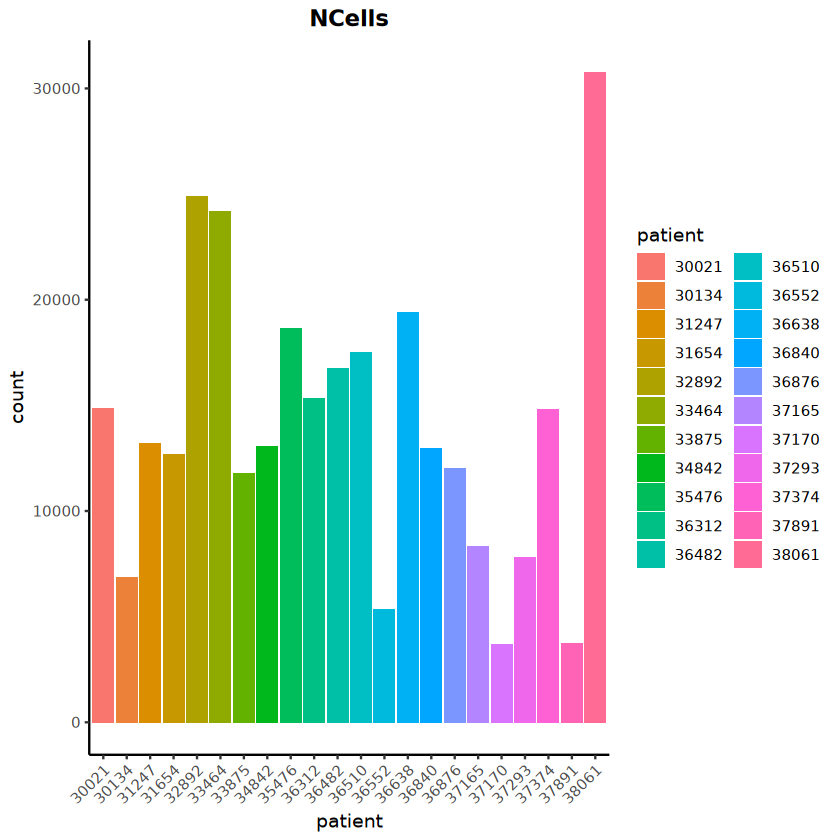

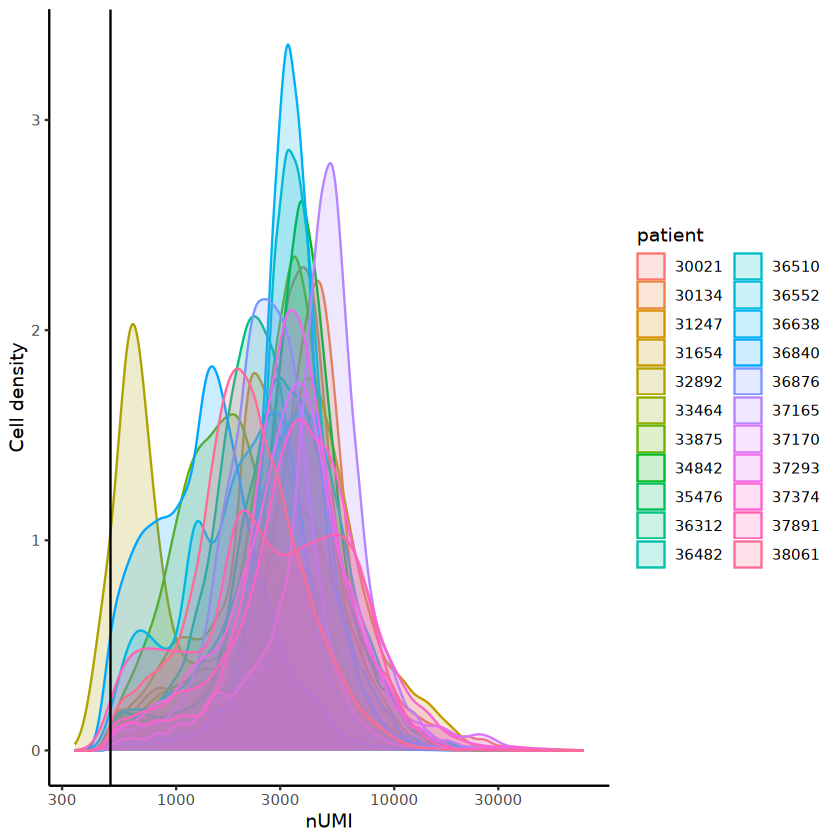

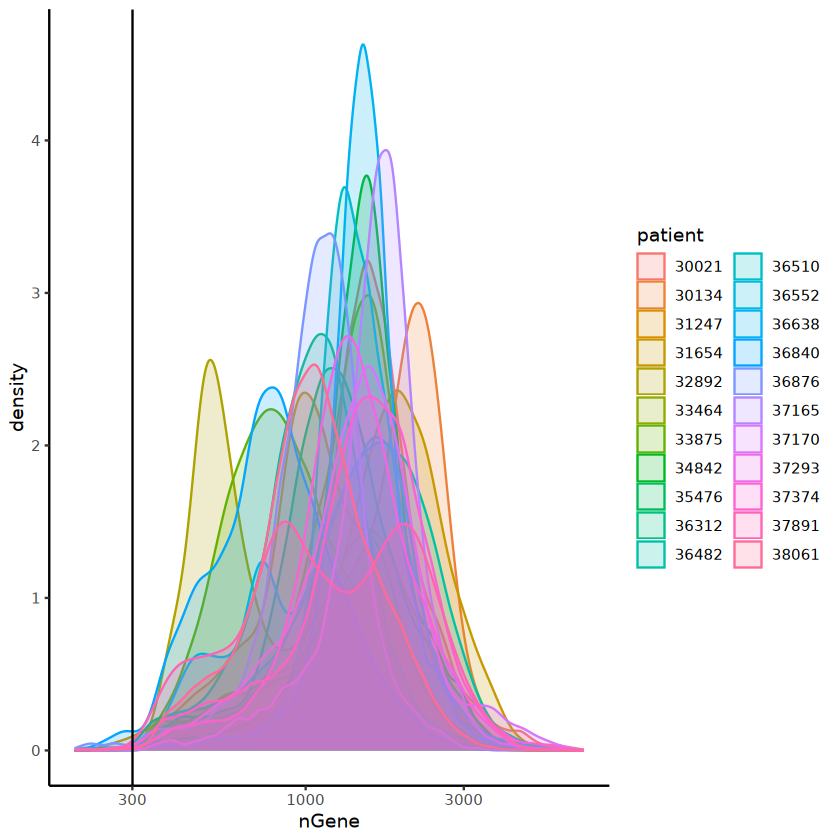

`geom_smooth()` using formula = 'y ~ x'
Warning message:
“The following aesthetics were dropped during statistical transformation: colour.
ℹ This can happen when ggplot fails to infer the correct grouping structure in the data.
ℹ Did you forget to specify a `group` aesthetic or to convert a numerical variable into a factor?”
Warning message:
“The following aesthetics were dropped during statistical transformation: colour.
ℹ This can happen when ggplot fails to infer the correct grouping structure in the data.
ℹ Did you forget to specify a `group` aesthetic or to convert a numerical variable into a factor?”
Warning message:
“The following aesthetics were dropped during statistical transformation: colour.
ℹ This can happen when ggplot fails to infer the correct grouping structure in the data.
ℹ Did you forget to specify a `group` aesthetic or to convert a numerical variable into a factor?”
Warning message:
“The following aesthetics were dropped during statistical transformation: colour.


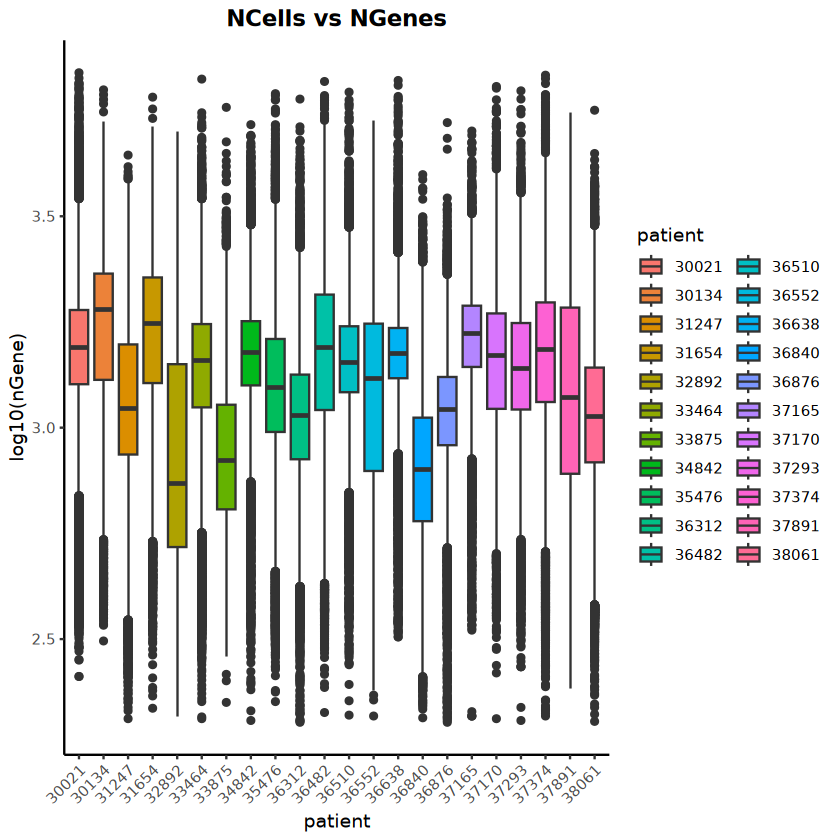

Warning message in scale_x_log10():
“log-10 transformation introduced infinite values.”
Warning message:
“Removed 1827 rows containing non-finite outside the scale range (`stat_density()`).”


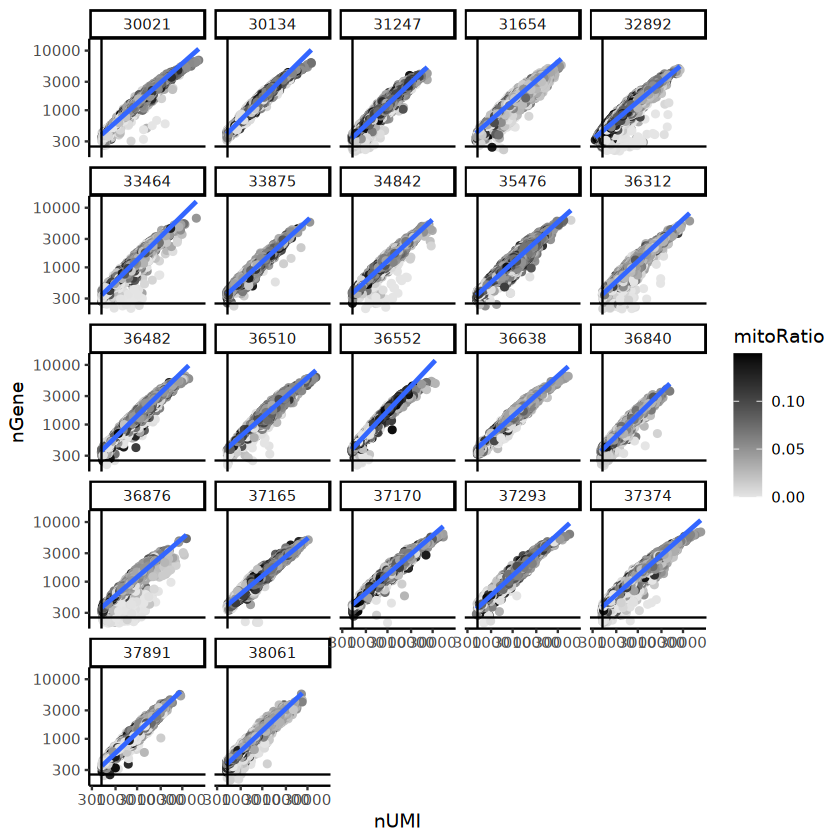

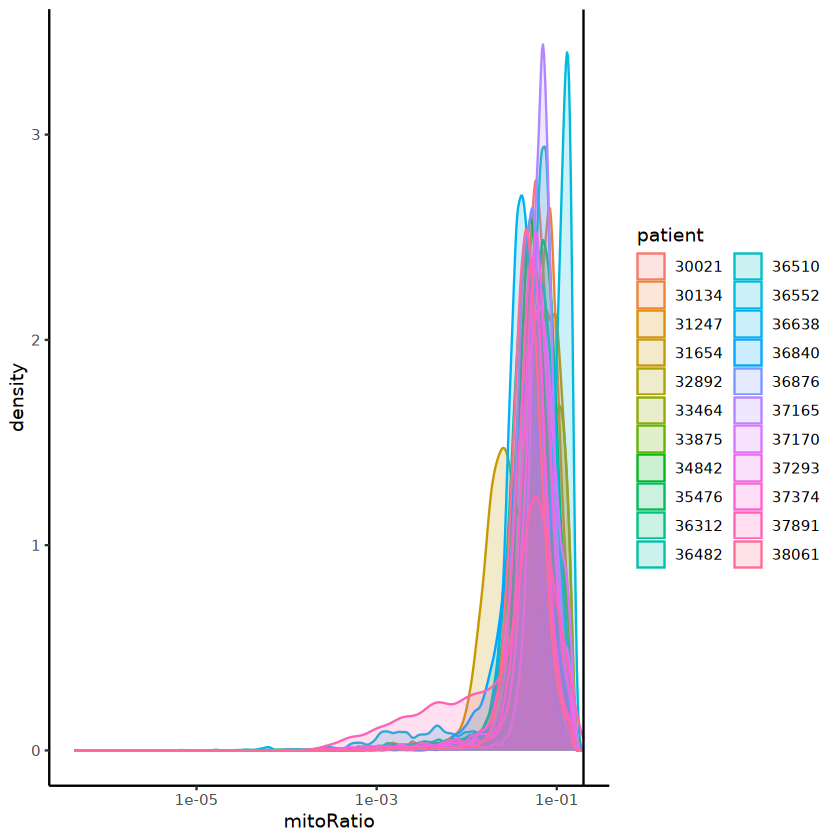

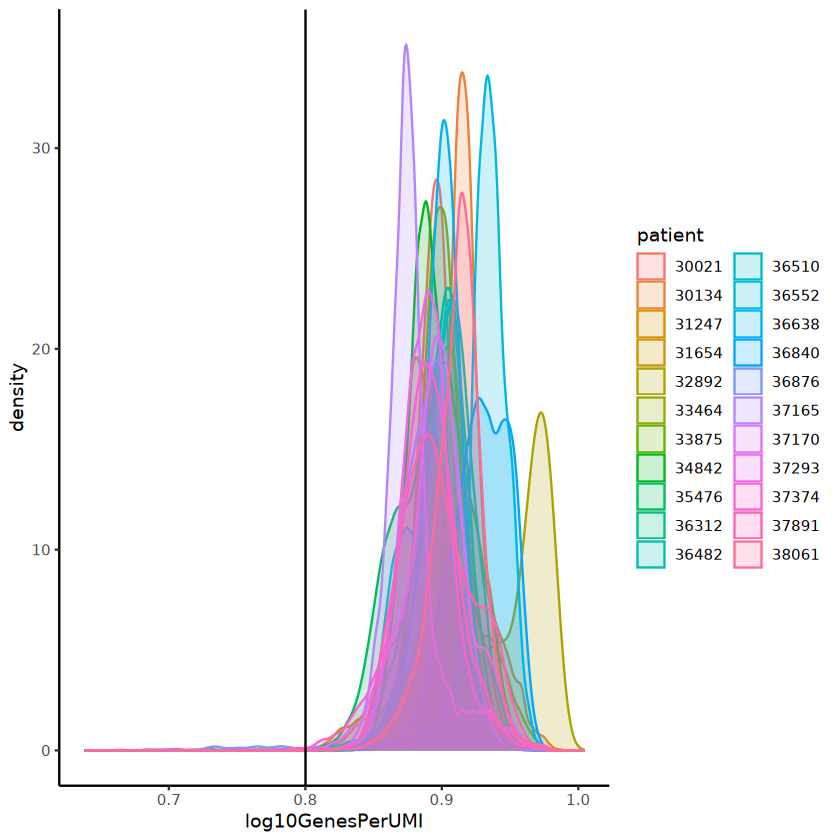

In [35]:
# Visualize the number of cell counts per patient
metadata %>% 
  	ggplot(aes(x=patient, fill=patient)) + 
  	geom_bar() +
  	theme_classic() +
  	theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1)) +
  	theme(plot.title = element_text(hjust=0.5, face="bold")) +
  	ggtitle("NCells")

metadata %>% 
  	ggplot(aes(color=patient, x=nUMI, fill= patient)) + 
  	geom_density(alpha = 0.2) + 
  	scale_x_log10() + 
  	theme_classic() +
  	ylab("Cell density") +
  	geom_vline(xintercept = 500)

    # Visualize the distribution of genes detected per cell via histogram
metadata %>% 
  	ggplot(aes(color=patient, x=nGene, fill= patient)) + 
  	geom_density(alpha = 0.2) + 
  	theme_classic() +
  	scale_x_log10() + 
  	geom_vline(xintercept = 300)

# Visualize the distribution of genes detected per cell via boxplot
metadata %>% 
  	ggplot(aes(x=patient, y=log10(nGene), fill=patient)) + 
  	geom_boxplot() + 
  	theme_classic() +
  	theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1)) +
  	theme(plot.title = element_text(hjust=0.5, face="bold")) +
  	ggtitle("NCells vs NGenes")

    # Visualize the correlation between genes detected and number of UMIs and determine whether strong presence of cells with low numbers of genes/UMIs
metadata %>% 
  	ggplot(aes(x=nUMI, y=nGene, color=mitoRatio)) + 
  	geom_point() + 
	scale_colour_gradient(low = "gray90", high = "black") +
  	stat_smooth(method=lm) +
  	scale_x_log10() + 
  	scale_y_log10() + 
  	theme_classic() +
  	geom_vline(xintercept = 500) +
  	geom_hline(yintercept = 250) +
  	facet_wrap(~patient)

    # Visualize the distribution of mitochondrial gene expression detected per cell
metadata %>% 
  	ggplot(aes(color=patient, x=mitoRatio, fill=patient)) + 
  	geom_density(alpha = 0.2) + 
  	scale_x_log10() + 
  	theme_classic() +
  	geom_vline(xintercept = 0.2)

    # Visualize the overall complexity of the gene expression by visualizing the genes detected per UMI
metadata %>%
  	ggplot(aes(x=log10GenesPerUMI, color = patient, fill=patient)) +
  	geom_density(alpha = 0.2) +
  	theme_classic() +
  	geom_vline(xintercept = 0.8)

In [5]:
Merged_patients[["percent.mt"]] <- PercentageFeatureSet(Merged_patients, pattern = "^MT-")
#VlnPlot(Merged_patients, features = c("nFeature_RNA", "nCount_RNA", "percent.mt"), ncol = 3)
#plot1 <- FeatureScatter(Merged_patients, feature1 = "nCount_RNA", feature2 = "percent.mt")
#plot2 <- FeatureScatter(Merged_patients, feature1 = "nCount_RNA", feature2 = "nFeature_RNA")
#plot1 + plot2

In [6]:
#Mitofiltered_data <- subset(x = Merged_patients, 
                         #subset= (nCount_RNA >= 500) & 
                         #  (nFeature_RNA >= 250) & 
                         #  (log10GenesPerUMI > 0.80) & 
                         #  (mitoRatio < 0.20))

Merged_patients <- subset(x = Merged_patients, 
                         subset= (nCount_RNA >= 500) & 
                           (nFeature_RNA >= 250) & 
                           (log10GenesPerUMI > 0.80))  

#RESULTS IN LOSS OF 0.8% of TOTAL CELLS FOR EITHER                

In [49]:
#colnames(Merged_patients@assays$RNA$data)
g1 <- length(rownames(Merged_patients@assays$RNA$data))
g2 <- length(rownames(GeneFiltered_data@assays$RNA@features))
g3 <- length(rownames(filtered_data@assays$RNA$data))
g1
g2
g3

[1] 33538

[1] 23587

[1] 33538

In [30]:
UpdateSeuratObject(GeneFiltered_data)
p1 <- length(colnames(Merged_patients@assays$RNA@counts))
p2 <- length(colnames(GeneFiltered_data@assays$RNA$counts))
p3 <- length(colnames(filtered_data@assays$RNA@counts))
p1
p2
p3
t <- p1 - p2
paste("Number of cells removed:", t)
ratio <- (t/p1)*100
ratio


Validating object structure

Updating object slots

Ensuring keys are in the proper structure

Ensuring keys are in the proper structure

Ensuring feature names don't have underscores or pipes

Updating slots in RNA

Validating object structure for Assay5 ‘RNA’

Object representation is consistent with the most current Seurat version



An object of class Seurat 
23587 features across 308491 samples within 1 assay 
Active assay: RNA (23587 features, 0 variable features)
 1 layer present: counts

[1] 308491

[1] 308491

[1] 305921

[1] "Number of cells removed: 0"

[1] 0

In [8]:
# Filter out low quality reads using selected thresholds - these will change with experiment
filtered_data <- subset(x = Merged_patients, 
                         subset= (nCount_RNA >= 500) & 
                           (nFeature_RNA >= 250) & 
                           (log10GenesPerUMI > 0.80))

In [9]:
# Output a logical vector for every gene on whether the more than zero counts per cell
# Extract counts
counts <- GetAssayData(object = Merged_patients, slot = "counts")

# Output a logical vector for every gene on whether the more than zero counts per cell
nonzero <- counts > 0

# Sums all TRUE values and returns TRUE if more than 10 TRUE values per gene
keep_genes <- Matrix::rowSums(nonzero) >= 10

# Only keeping those genes expressed in more than 10 cells
filtered_counts <- counts[keep_genes, ]

# Reassign to filtered Seurat object
Merged_patients <- CreateSeuratObject(filtered_counts, meta.data = Merged_patients@meta.data)

#RESULTS IN LOSS OF AROUND 10,000 POOR GENES (33k to 23k genes)

In [ ]:
HLA.genes <- grep("^HLA-", rownames(bcells), value = T)
HLA2.genes <- grep("^HLA-D", rownames(bcells), value = T)
HLA1.genes <- setdiff(HLA.genes, HLA2.genes)

HLA.genes
length(unique(HLA.genes))
HLA2.genes
length(unique(HLA2.genes))
HLA1.genes
length(unique(HLA1.genes))


bcells <- subset(bcells, idents = setdiff(Idents(bcells), 'Prolif Bcell'))
bcells$group_patient <- paste(Idents(bcells), bcells$patient, sep = "_")

Dot1 <- DotPlot(bcells, HLA.genes, assay="RNA", cols = c("gold", "blue"), group.by = "group_patient")
Dot1 <- Dot1 + theme(axis.text.x = element_text(angle = 80, hjust = 1)) + ggtitle("HLA Genes in Tumor vs Normal Bcells")
Dot1
ggsave("HLA DotPlot by Patient.jpeg", plot = Dot1, width = 65, height = 12, units = "in", dpi = 300, limitsize = FALSE) # 72 dpi for points to inches conversion

HLA_avg <- Dot1$data

HLA_avg$site <- ifelse(grepl("Tumor", HLA_avg$id), "Tumor", 
                       ifelse(grepl("Normal", HLA_avg$id), "Normal", NA))

HLA_avg$HLA <- ifelse(HLA_avg$features.plot %in% HLA1.genes, "HLA1", 
                 ifelse(HLA_avg$features.plot %in% HLA2.genes, "HLA2", "Unknown"))

HLA_avg$id <- as.character(HLA_avg$id)

HLA_avg$patient <- ifelse(
  grepl("Tumor", HLA_avg$id), 
  substr(HLA_avg$id, 13, nchar(HLA_avg$id)),  # Remove first 12 characters for Tumor
  substr(HLA_avg$id, 14, nchar(HLA_avg$id))   # Remove 13 characters for Normal
)
head(HLA_avg)
length(unique(HLA_avg$features.plot))
unique(HLA_avg$patient)

summary_plot <- ggplot(HLA_avg, aes(x = site, y = avg.exp, fill = HLA)) +
  geom_boxplot(position= "dodge", color = "black") +  # Boxplot without outliers shown
  geom_jitter(width = 0.2, alpha = 0.6, color = "black", size = 0.8) +  # Add jittered points
  stat_compare_means(paired = TRUE, method = "wilcox.test", hjust = -3, vjust = 5) +
  facet_wrap(~features.plot, scales = 'free', ncol = 10) +
  theme(axis.text.x = element_text(angle = 65, hjust = 1)) +
  labs(title = "HLA_avg Markers Summary",
       x = "Site",
       y = "Average Expression",
       fill = "Legend")

summary_plot
ggsave("test.jpeg", plot = summary_plot, width = 14, height = 8, units = "in", dpi = 100, limitsize = FALSE)

In [1]:
library(Seurat)
library(ggplot2)
library(grid)
library(dplyr)
library(ggpubr)
library(rstatix)

#load("/home/exacloud/gscratch/ShreeLab/FabianS/Jupyter/labeled-bcells.Robj")
#load("/home/exacloud/gscratch/ShreeLab/FabianS/Jupyter/labeled-tcells.Robj")
load("/home/exacloud/gscratch/ShreeLab/FabianS/Jupyter/labeled-int_tcells.Robj")
#rm(bcells)

Loading required package: SeuratObject

Loading required package: sp




Attaching package: ‘SeuratObject’


The following objects are masked from ‘package:base’:

    intersect, t



Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



Attaching package: ‘rstatix’


The following object is masked from ‘package:stats’:

    filter




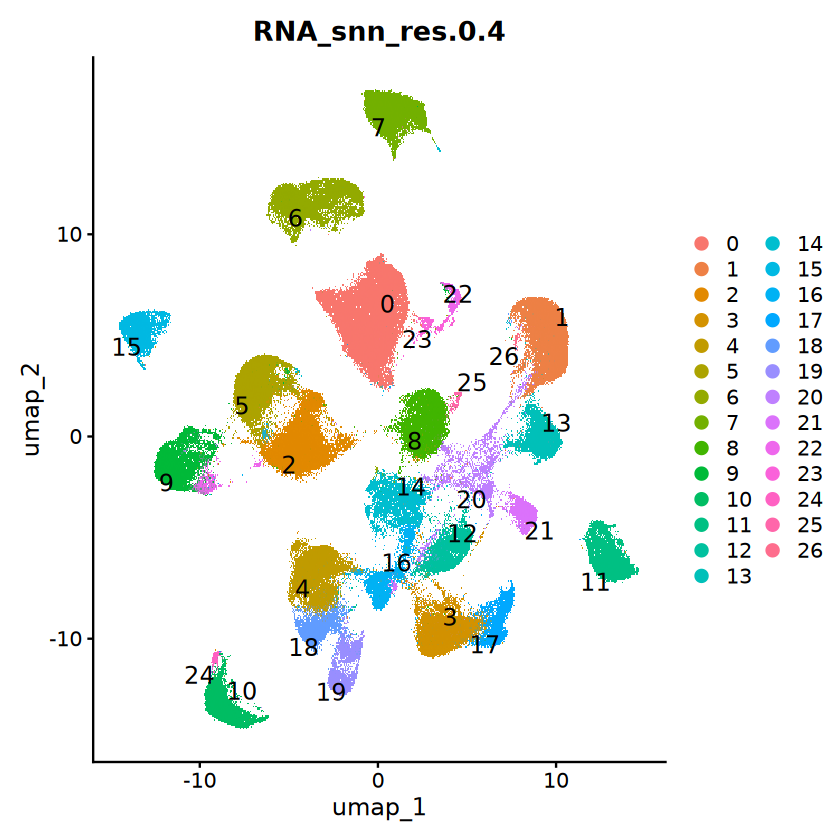

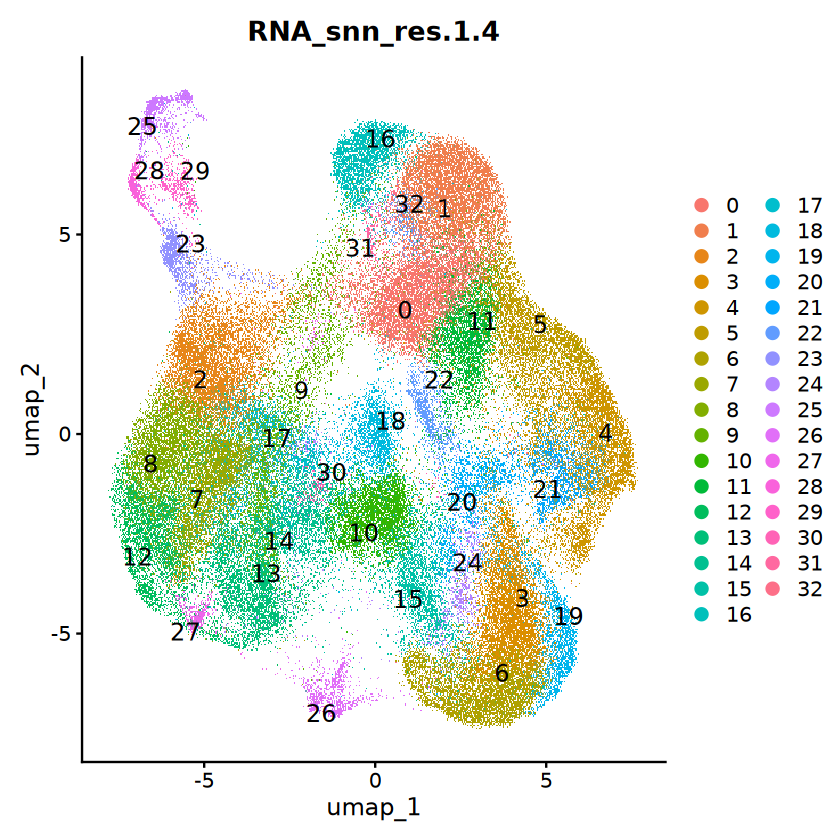

In [3]:
DimPlot(bcells, reduction = "umap", group.by = "RNA_snn_res.0.4", 
    label = TRUE, label.size = 5, repel = TRUE, raster = TRUE)

DimPlot(tcells, reduction = "umap", group.by = "RNA_snn_res.1.4", 
    label = TRUE, label.size = 5, repel = TRUE, raster = TRUE)

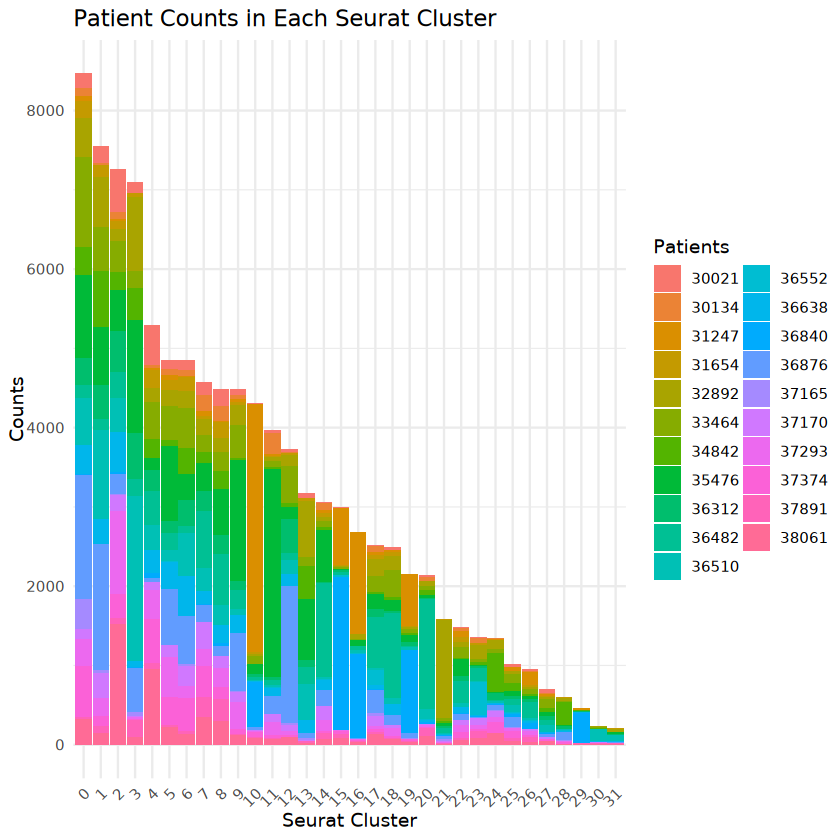

In [3]:
tcells@active.ident <- as.factor(tcells$`RNA_snn_res.1.4`)
data <- as.data.frame(table(Idents(tcells), tcells$patient))

# Rename columns for clarity
colnames(data) <- c("Cluster", "Patient", "Count")

ggplot(data, aes(x = Cluster, y = Count, fill = factor(Patient))) +
  geom_bar(stat = "identity") +
  labs(title = "Patient Counts in Each Seurat Cluster",
       x = "Seurat Cluster", y = "Counts", fill = "Patients") +
  theme_minimal() +
  theme(axis.text.x = element_text(angle = 45, hjust = 1))

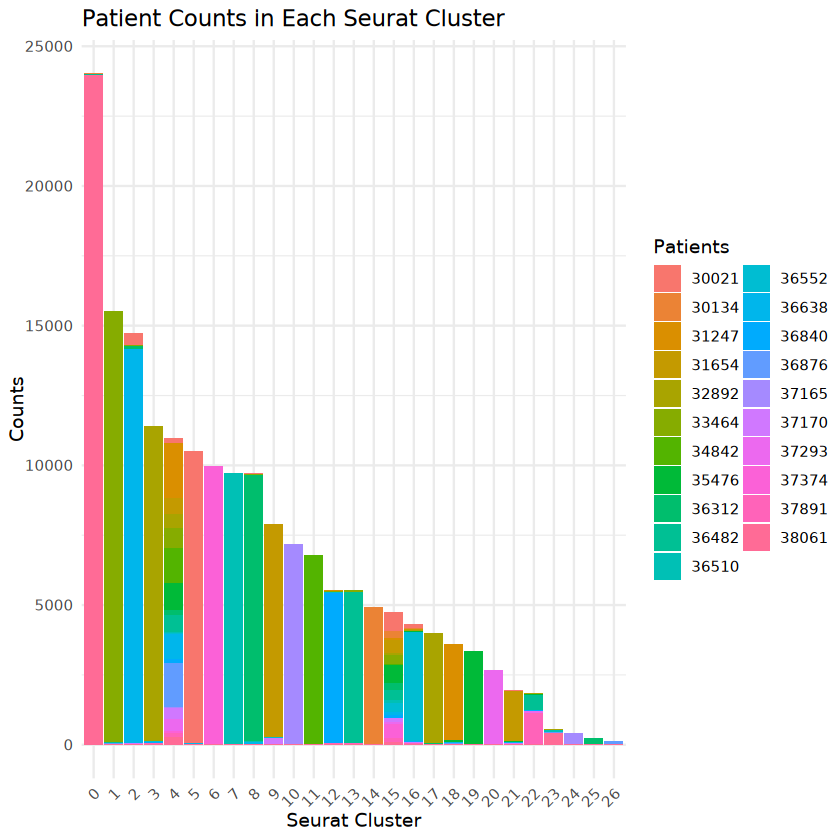

In [4]:
bcells@active.ident <- as.factor(bcells$`RNA_snn_res.0.4`)
data <- as.data.frame(table(Idents(bcells), bcells$patient))

# Rename columns for clarity
colnames(data) <- c("Cluster", "Patient", "Count")

ggplot(data, aes(x = Cluster, y = Count, fill = factor(Patient))) +
  geom_bar(stat = "identity") +
  labs(title = "Patient Counts in Each Seurat Cluster",
       x = "Seurat Cluster", y = "Counts", fill = "Patients") +
  theme_minimal() +
  theme(axis.text.x = element_text(angle = 45, hjust = 1))

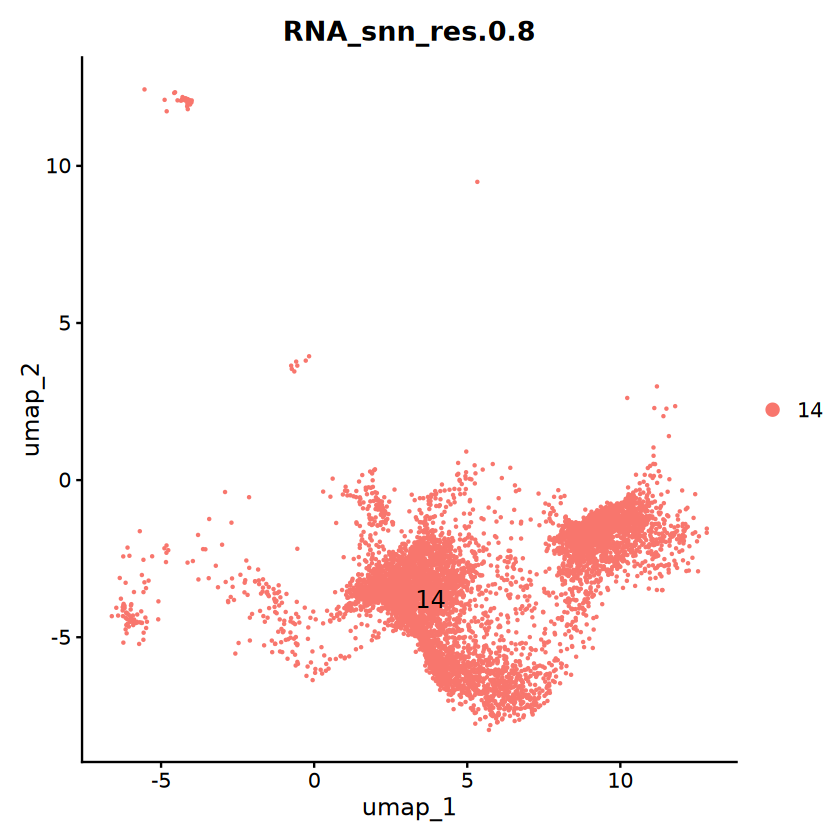

In [15]:
Merged_patients@active.ident <- Merged_patients$'RNA_snn_res.0.8'

clus14 <- subset(Merged_patients, idents = 14)
DimPlot(clus14, reduction = "umap", group.by = "RNA_snn_res.0.8", 
    label = TRUE, label.size = 5, repel = TRUE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



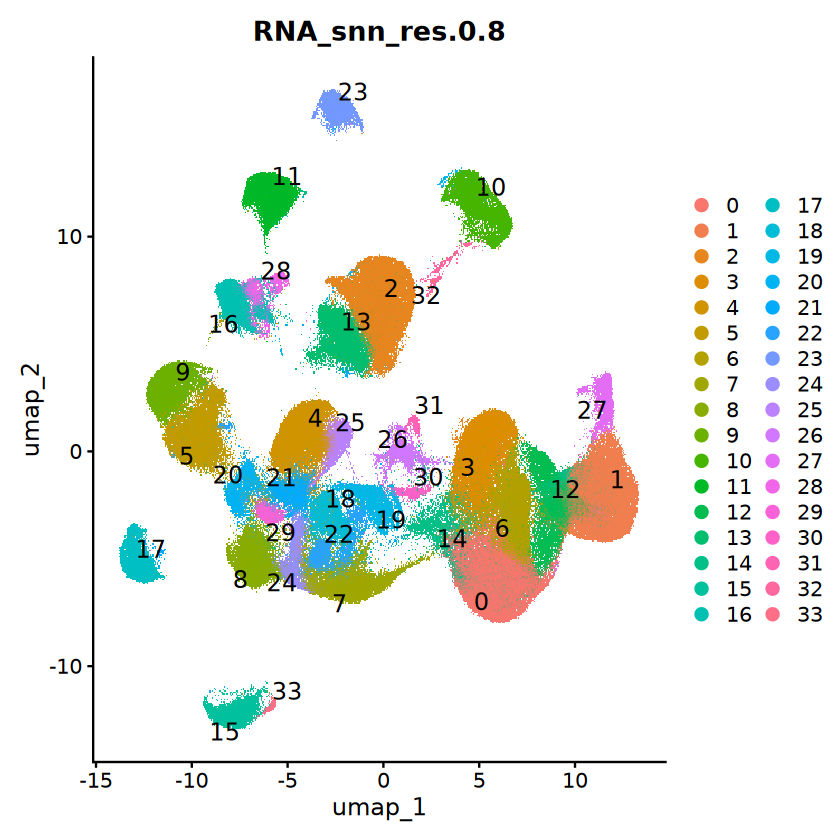

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



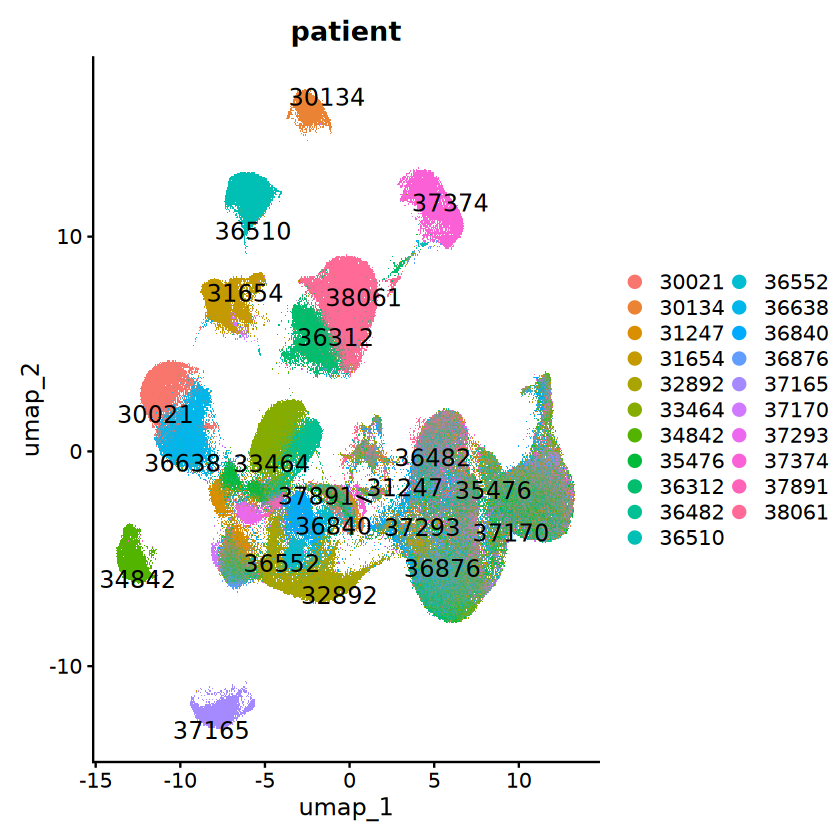

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



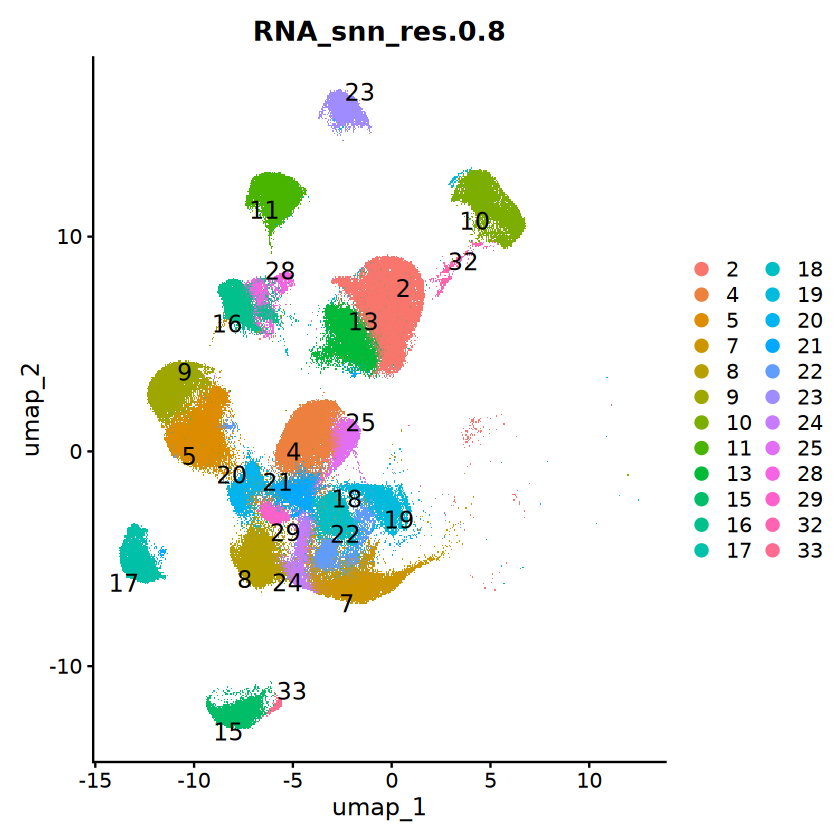

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



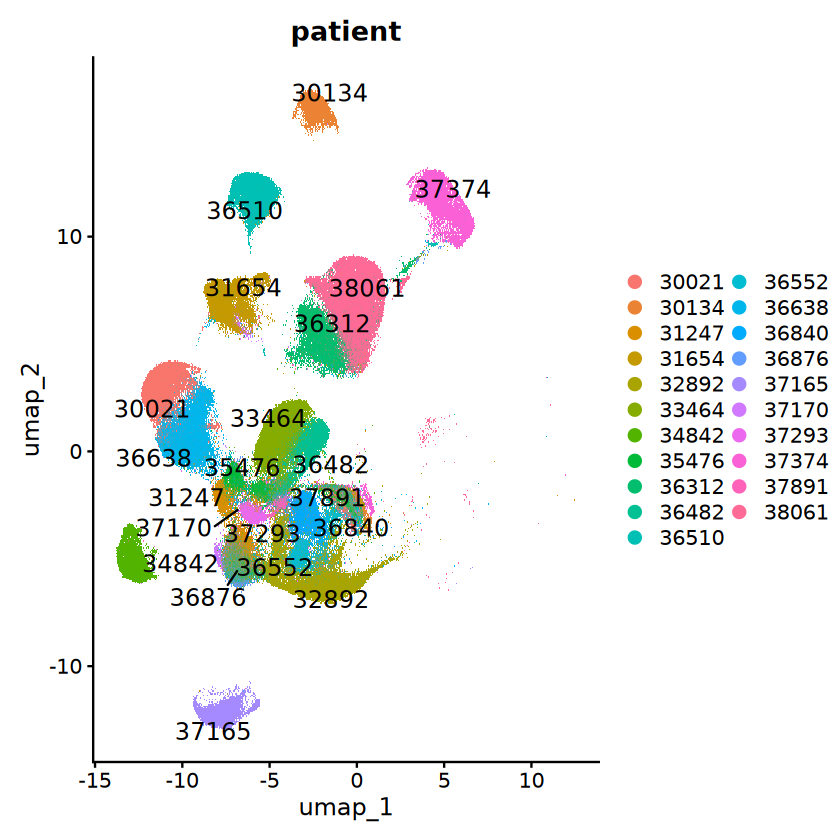

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Warning message:
“ggrepel: 14 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


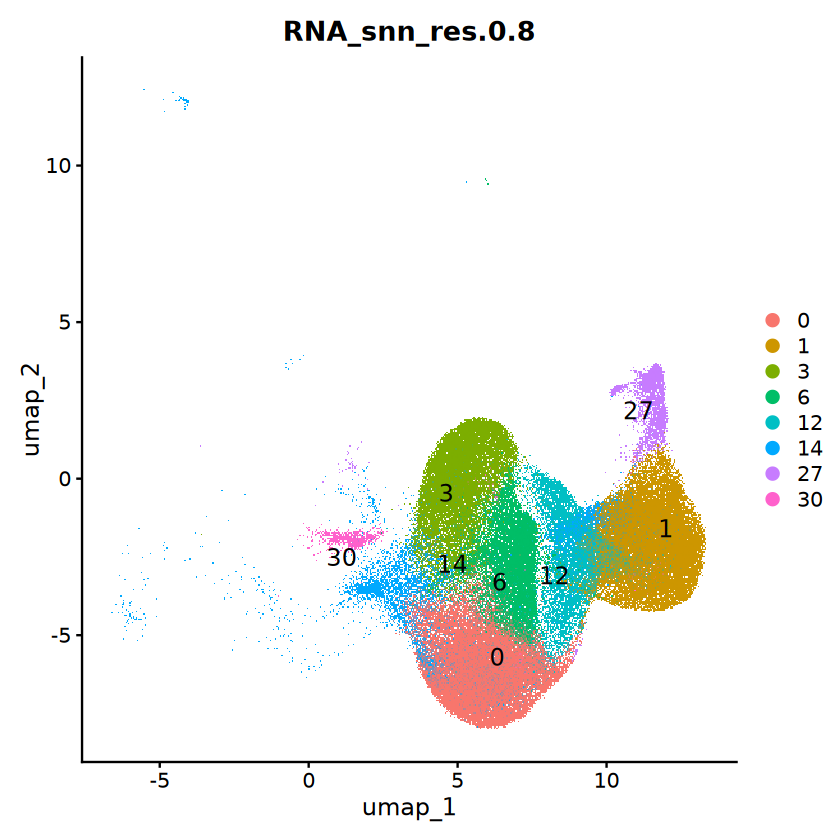

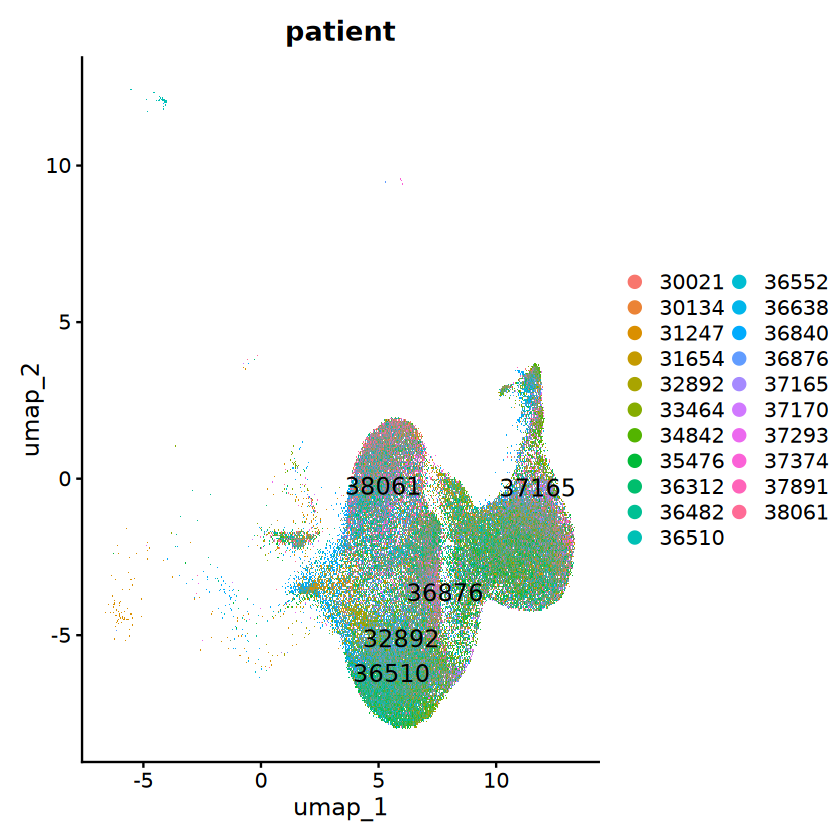

In [19]:
Merged_patients@active.ident <- Merged_patients$'RNA_snn_res.0.8'

DimPlot(Merged_patients, reduction = "umap", group.by = "RNA_snn_res.0.8", 
    label = TRUE, label.size = 5, repel = TRUE)

DimPlot(Merged_patients, reduction = "umap", group.by = "patient", 
    label = TRUE, label.size = 5, repel = TRUE)

bcells <- subset(Merged_patients, idents = c(2, 4, 5, 7, 8, 9, 10, 11, 13, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 28, 29, 32, 33))
DimPlot(bcells, reduction = "umap", group.by = "RNA_snn_res.0.8", 
    label = TRUE, label.size = 5, repel = TRUE)
DimPlot(bcells, reduction = "umap", group.by = "patient", 
    label = TRUE, label.size = 5, repel = TRUE)

tcells <- subset(Merged_patients, idents = c(0, 1, 3, 6, 12, 14, 27, 30))
DimPlot(tcells, reduction = "umap", group.by = "RNA_snn_res.0.8", 
    label = TRUE, label.size = 5, repel = TRUE)
DimPlot(tcells, reduction = "umap", group.by = "patient", 
    label = TRUE, label.size = 5, repel = TRUE)


[1] 105698

Warning message:
“The `slot` argument of `GetAssayData()` is deprecated as of SeuratObject 5.0.0.
ℹ Please use the `layer` argument instead.”


[1] 101938

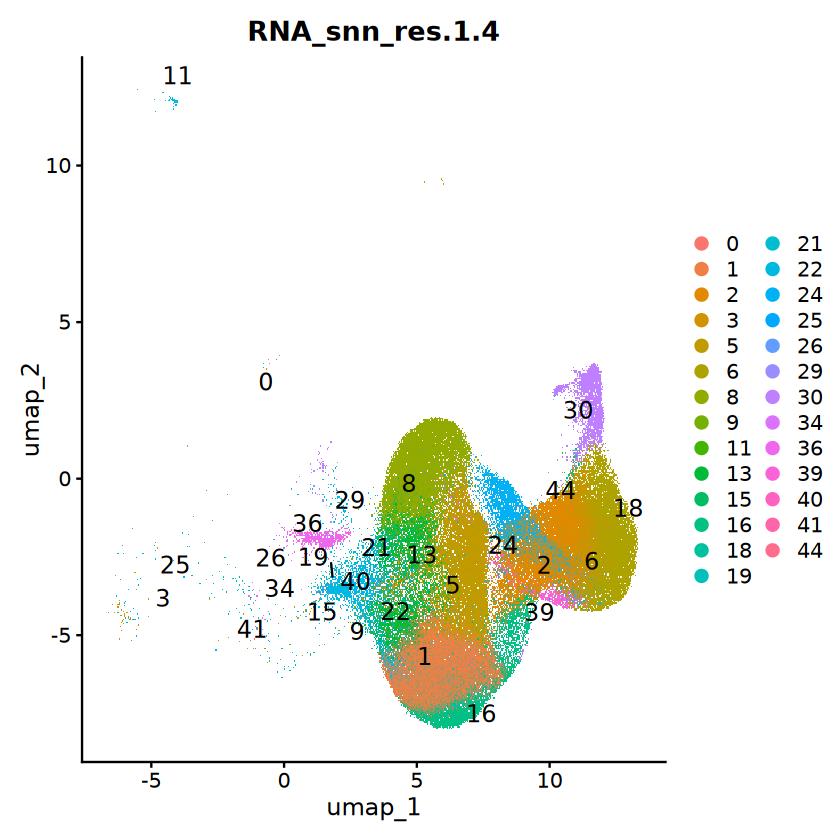

In [4]:
DimPlot(
        tcells, reduction = "umap", 
        group.by = "RNA_snn_res.1.4", label = TRUE, 
        label.size = 5, repel = TRUE, raster = TRUE
    )

ncol(tcells)

# Step 1: Define your gene list
gene_list <- c("CD2", "CD3D", "CD7","CD8B", "CD8A", "CD4")  # Example genes

# Step 2: Retrieve the counts matrix for the RNA assay
counts_matrix <- GetAssayData(tcells, assay = "RNA", slot = "counts")

# Step 3: Identify the indices of the genes in the matrix
gene_indices <- which(rownames(counts_matrix) %in% gene_list)

# Step 4: Ensure that all genes were found
if (length(gene_indices) < length(gene_list)) {
    warning("Some genes were not found in the dataset:")
    print(setdiff(gene_list, rownames(counts_matrix)[gene_indices]))
}

# Step 5: Subsetting logic (choose one)

## Option A: Cells expressing **at least one gene** from the list
expressing_cells <- which(colSums(counts_matrix[gene_indices, ] > 0) > 0)

## Option B: Cells expressing **all genes** in the list
# expressing_cells <- which(colSums(counts_matrix[gene_indices, ] > 0) == length(gene_list))

# Step 6: Retrieve the barcodes of the expressing cells
barcode_list <- colnames(counts_matrix)[expressing_cells]

# Step 7: Subset the Seurat object to retain only these cells
if (length(barcode_list) > 0) {
    tcells <- subset(tcells, cells = barcode_list)

    # Step 8: Plot the UMAP
    DimPlot(
        tcells, reduction = "umap", 
        group.by = "RNA_snn_res.1.4", label = TRUE, 
        label.size = 5, repel = TRUE, raster = TRUE
    )
    ncol(tcells)
} else {
    stop("No cells expressing the specified genes were found.")
}


[1] 183784

[1] 181911

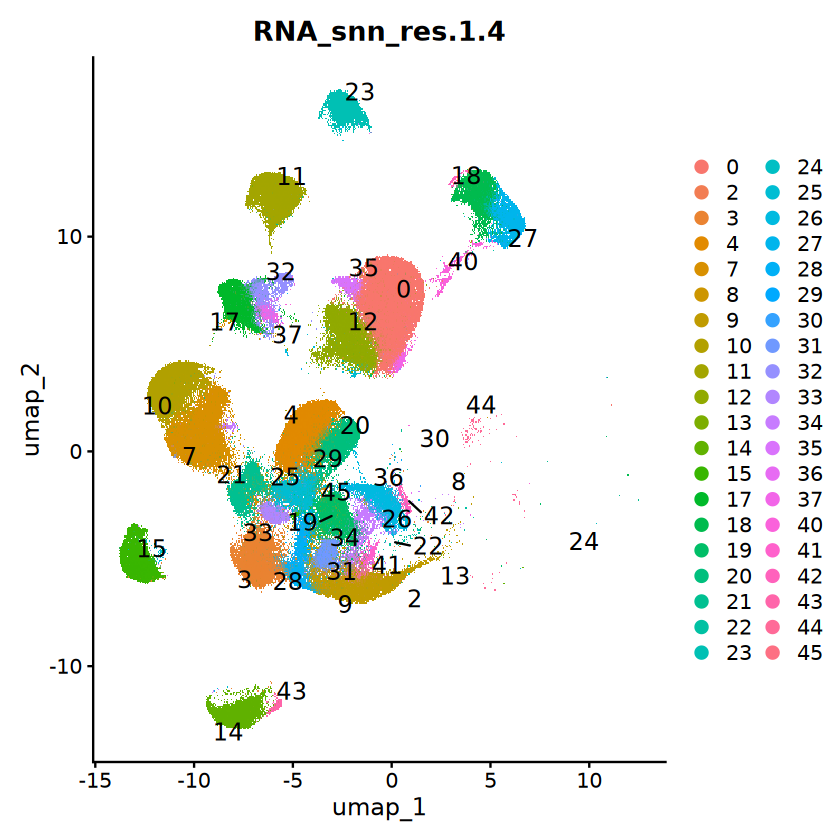

In [5]:
DimPlot(
        bcells, reduction = "umap", 
        group.by = "RNA_snn_res.1.4", label = TRUE, 
        label.size = 5, repel = TRUE, raster = TRUE
    )

ncol(bcells)

# Step 1: Define your gene list
gene_list <- c("CD19", "MS4A1", "CD79A","CD79B")  # Example genes

# Step 2: Retrieve the counts matrix for the RNA assay
counts_matrix <- GetAssayData(bcells, assay = "RNA", slot = "counts")

# Step 3: Identify the indices of the genes in the matrix
gene_indices <- which(rownames(counts_matrix) %in% gene_list)

# Step 4: Ensure that all genes were found
if (length(gene_indices) < length(gene_list)) {
    warning("Some genes were not found in the dataset:")
    print(setdiff(gene_list, rownames(counts_matrix)[gene_indices]))
}

# Step 5: Subsetting logic (choose one)

## Option A: Cells expressing **at least one gene** from the list
expressing_cells <- which(colSums(counts_matrix[gene_indices, ] > 0) > 0)

## Option B: Cells expressing **all genes** in the list
# expressing_cells <- which(colSums(counts_matrix[gene_indices, ] > 0) == length(gene_list))

# Step 6: Retrieve the barcodes of the expressing cells
barcode_list <- colnames(counts_matrix)[expressing_cells]

# Step 7: Subset the Seurat object to retain only these cells
if (length(barcode_list) > 0) {
    bcells <- subset(bcells, cells = barcode_list)

    # Step 8: Plot the UMAP
    DimPlot(
        bcells, reduction = "umap", 
        group.by = "RNA_snn_res.1.4", label = TRUE, 
        label.size = 5, repel = TRUE, raster = TRUE
    )
    ncol(bcells)
} else {
    stop("No cells expressing the specified genes were found.")
}


In [12]:
subsetted_obj <- subset(Merged_patients, subset = patient != "33875")
#str(Merged_patients@meta.data)
str(subsetted_obj@meta.data)

#table(subsetted_obj$patient)

'data.frame':	294144 obs. of  112 variables:
 $ orig.ident                       : chr  "SeuratProject" "SeuratProject" "SeuratProject" "SeuratProject" ...
 $ nCount_RNA                       : num  3778 4257 2439 3144 3606 ...
 $ nFeature_RNA                     : int  1264 1659 1017 1243 1450 1429 2135 1357 1612 1146 ...
 $ patient                          : chr  "30021" "30021" "30021" "30021" ...
 $ site                             : chr  "lesA" "lesA" "lesA" "lesA" ...
 $ timepoint                        : chr  "pre" "pre" "pre" "pre" ...
 $ site.timepoint                   : chr  "lesA_pre" "lesA_pre" "lesA_pre" "lesA_pre" ...
 $ tissue                           : chr  "lymph" "lymph" "lymph" "lymph" ...
 $ patient.timepoint                : chr  "30021_pre" "30021_pre" "30021_pre" "30021_pre" ...
 $ patient.site                     : chr  "30021_lesA" "30021_lesA" "30021_lesA" "30021_lesA" ...
 $ patient.site.timepoint           : chr  "30021_lesA_pre" "30021_lesA_pre" "30021_le

Normalizing layer: counts



Normalizing layer: counts

Finding variable features for layer counts

Finding variable features for layer counts

Centering and scaling data matrix

Warning message:
“Different features in new layer data than already exists for scale.data”
Centering and scaling data matrix

Warning message:
“Different features in new layer data than already exists for scale.data”
PC_ 1 
Positive:  PDCD1, SRGN, TOX2, TIGIT, ITM2A, TOX, COTL1, DRAIC, SMCO4, RNF19A 
	   CORO1B, GAPDH, SH2D1A, MAF, CXCL13, LIMS1, ICA1, RAB27A, BATF, FABP5 
	   CD82, CTLA4, GNG4, IKZF3, CHI3L2, CXCR5, AC012645.3, CD200, ZNRF1, CD74 
Negative:  RPS12, VIM, IL7R, KLF2, EMP3, TPT1, ANXA1, SELL, RPS18, CCR7 
	   FLT3LG, TMSB10, RPS6, RPL3, S1PR1, RPS2, NOSIP, EEF1A1, RASGRP2, PLAC8 
	   LEF1, C1orf162, TXNIP, RPSA, EEF1B2, S100A6, LDHB, IFITM1, CD55, S100A10 
PC_ 2 
Positive:  CD40LG, TCF7, FKBP5, SMCO4, LTB, TOX2, FBLN7, IL6ST, EEF1A1, IL6R 
	   AC012645.3, NR3C1, CD4, TNFRSF4, PASK, SPOCK2, ICA1, LEF1, LIMS2, ARMH1 
	   EEF1

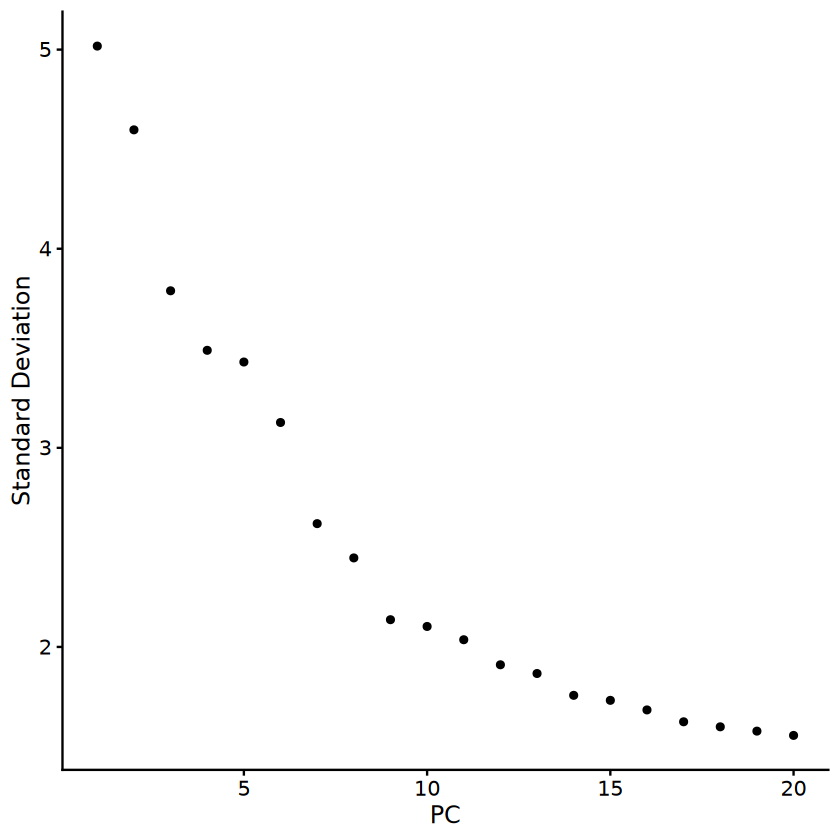

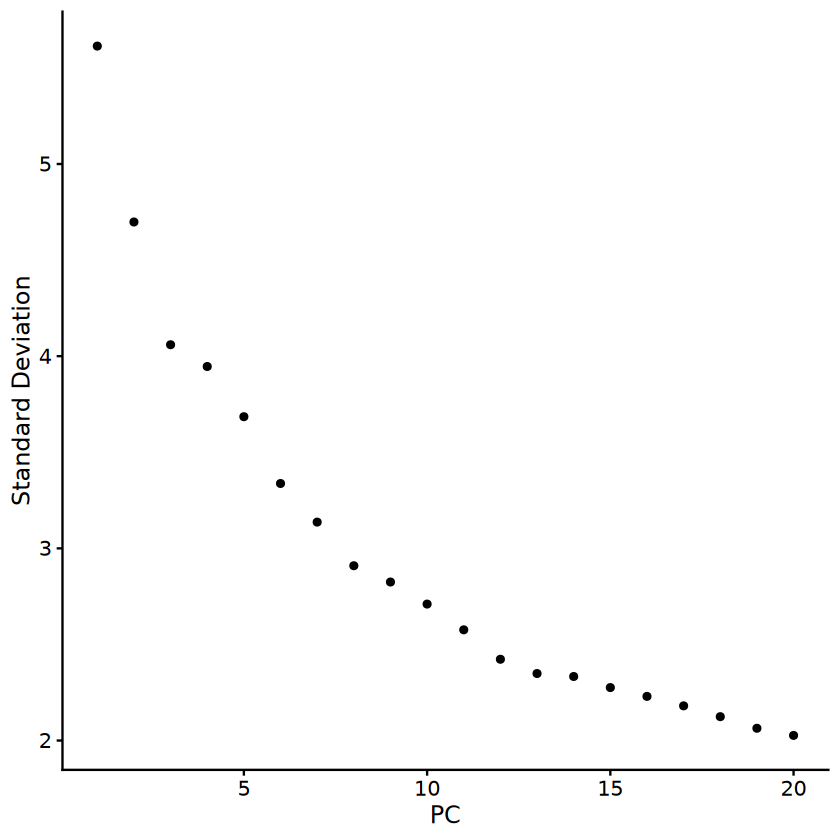

In [60]:
# Step 1: Normalize Data
tcells <- NormalizeData(tcells)
bcells <- NormalizeData(bcells)

# Step 2: Find Variable Features
tcells <- FindVariableFeatures(tcells)
bcells <- FindVariableFeatures(bcells)
# Step 3: Scale Data
tcells <- ScaleData(tcells)
bcells <- ScaleData(bcells)
# Step 4: Run PCA
tcells <- RunPCA(tcells)
bcells <- RunPCA(bcells)

ElbowPlot(tcells)
ElbowPlot(bcells)

Normalizing layer: counts

Finding variable features for layer counts



Centering and scaling data matrix

Warning message:
“Different features in new layer data than already exists for scale.data”
PC_ 1 
Positive:  MTRNR2L8, XIST, NEAT1, DTHD1, MIAT, LYST, AOAH, GZMK, FCRL3, CD84 
	   AF165147.1, IGLV2-14, IFNG-AS1, HNRNPLL, PPP2R2B, SLAMF7, ITGA4, TTN, TRPS1, DUSP4 
	   ENC1, DUSP2, TBC1D2B, ATP9A, SLC20A1, MTRNR2L12, MYO1F, PDE4DIP, F2R, BICDL1 
Negative:  RPS12, EEF1A1, RPL32, RPL10, RPS14, RPL13, RPS4X, RPS18, RPL18A, RPS3A 
	   RPS23, RPL35A, RPL19, RPL21, RPS3, RPS13, RPS19, RPS5, RPS6, RPL29 
	   RPS25, RPL7A, RPL9, RPL5, TPT1, RPL3, RPLP0, RPS16, RPL10A, RPL23A 
PC_ 2 
Positive:  HBB, HBA2, HBA1, SLC25A37, IGLV3-19, MS4A1, JCHAIN, SNCA, ALAS2, CD74 
	   HLA-DRA, TRIM58, MARCKSL1, DCAF12, HBM, STRADB, SLC25A39, BNIP3L, VPREB3, HLA-DRB5 
	   IGLC2, FAM210B, HLA-DQA2, MEF2C, IGHE, HBD, IGHV4-34, HLA-DPB1, YBX3, PRPSAP2 
Negative:  MT-ATP6, ZFP36L2, MTRNR2L12, JUNB, GZMK, MT-ATP8, KLF6, JUN, MTRNR2L8, DUSP2 
	   DUSP1, AHNAK, TNFAIP3, ITGA4, CXCR4, CD

[1] 44

[1] 9

[1] 9

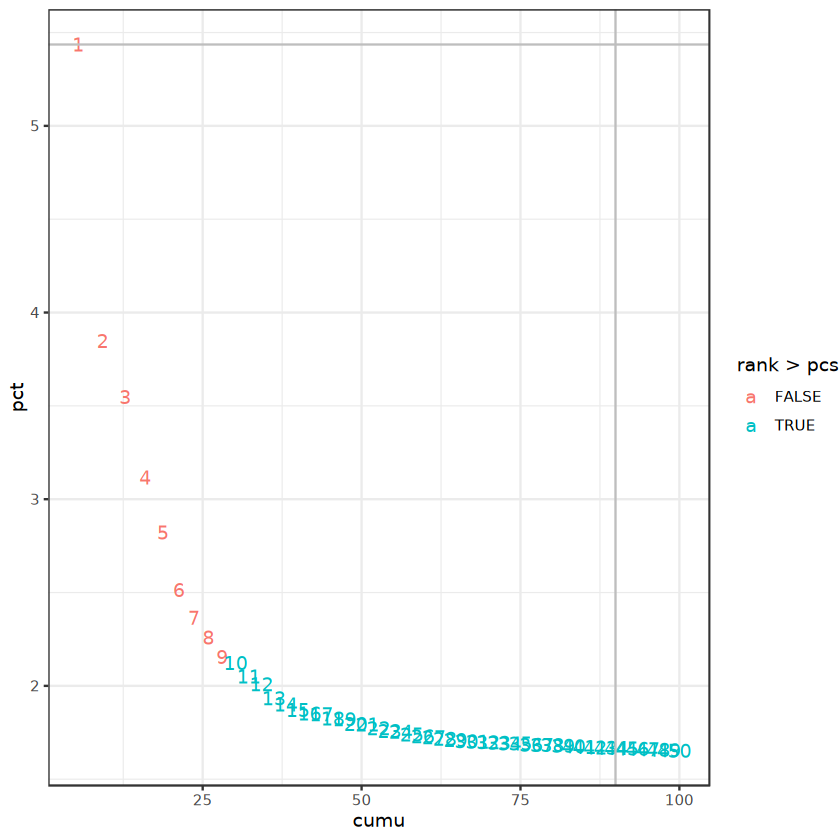

In [16]:
# Step 1: Normalize Data
clus14 <- NormalizeData(clus14)

# Step 2: Find Variable Features
clus14 <- FindVariableFeatures(clus14)

# Step 3: Scale Data
clus14 <- ScaleData(clus14)

# Step 4: Run PCA
clus14 <- RunPCA(clus14)

# Determine percent of variation associated with each PC
pct <- clus14[["pca"]]@stdev / sum(clus14[["pca"]]@stdev) * 100

# Calculate cumulative percents for each PC
cumu <- cumsum(pct)

# Determine which PC exhibits cumulative percent greater than 90% and % variation associated with the PC as less than 5
co1 <- which(cumu > 90 & pct < 5)[1]

co1
# Determine the difference between variation of PC and subsequent PC
co2 <- sort(which((pct[1:length(pct) - 1] - pct[2:length(pct)]) > 0.1), decreasing = T)[1] + 1

# last point where change of % of variation is more than 0.1%.
co2
# Minimum of the two calculation
pcs <- min(co1, co2)

pcs

# Create a dataframe with values
plot_df <- data.frame(pct = pct, 
           cumu = cumu, 
           rank = 1:length(pct))

# Elbow plot to visualize 
ggplot(plot_df, aes(cumu, pct, label = rank, color = rank > pcs)) + 
  geom_text() + 
  geom_vline(xintercept = 90, color = "grey") + 
  geom_hline(yintercept = min(pct[pct > 5]), color = "grey") +
  theme_bw()

11:17:53 UMAP embedding parameters a = 0.9922 b = 1.112

11:17:53 Read 294144 rows and found 15 numeric columns

11:17:53 Using Annoy for neighbor search, n_neighbors = 30

11:17:53 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*


*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

11:18:24 Writing NN index file to temp file /tmp/Rtmpk4gLx6/file522a3785d8e28

11:18:24 Searching Annoy index using 1 thread, search_k = 3000

11:20:31 Annoy recall = 100%

11:20:32 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

11:20:45 Initializing from normalized Laplacian + noise (using RSpectra)

11:21:33 Commencing optimization for 200 epochs, with 12918622 positive edges

11:21:33 Using rng type: pcg

11:24:42 Optimization finished

Computing nearest neighbor graph

Computing SNN

Warning message:
“The following arguments are not used: dims”
Warning message:
“The following arguments are not used: dims”


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 294144
Number of edges: 8440102

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9095
Number of communities: 54
Elapsed time: 166 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 294144
Number of edges: 8440102

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9152
Number of communities: 46
Elapsed time: 173 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 294144
Number of edges: 8440102

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9216
Number of communities: 42
Elapsed time: 162 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 294144
Number of edges: 8440102

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9292
Number of communities: 38
Elapsed time: 179 seco

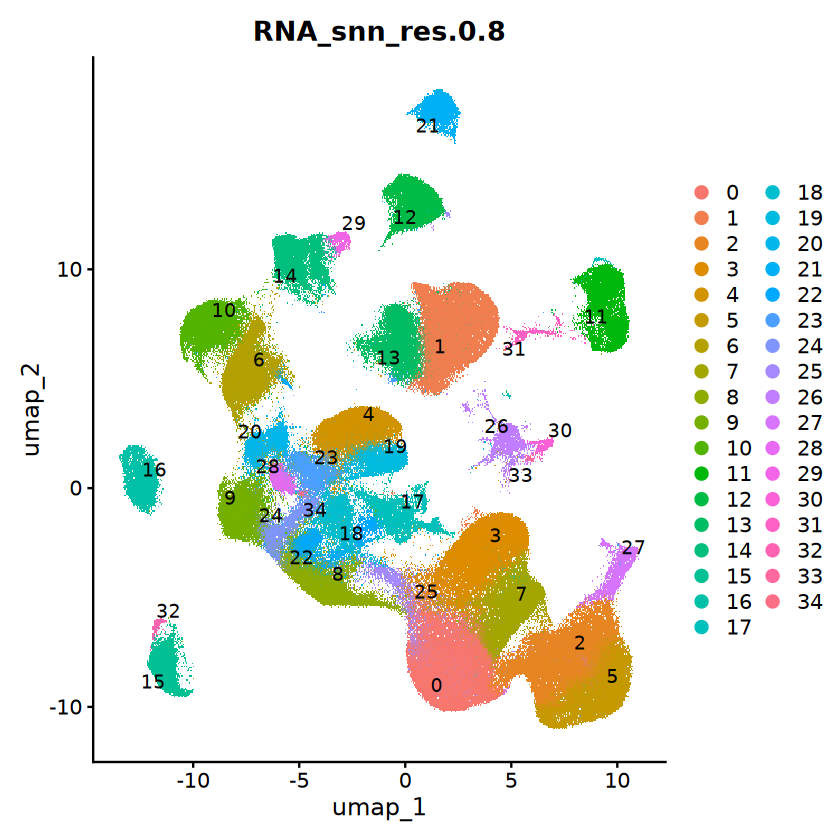

In [16]:
subsetted_obj <- RunUMAP(subsetted_obj, dims = 1:15)
subsetted_obj <- FindNeighbors(subsetted_obj, dims = 1:15)
subsetted_obj <- FindClusters(subsetted_obj, resolution = c(1.6, 1.4, 1.2, 1.0, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4), dims = 1:15)

DimPlot(subsetted_obj, reduction = "umap", group.by = "RNA_snn_res.0.8", label = TRUE, repel = TRUE, raster = TRUE)


In [18]:
clus14@active.ident <- as.factor(clus14$`RNA_snn_res.0.1`)

clus14.m <- FindAllMarkers(object = clus14)

write.csv(clus14.m, file = "clus14.csv")

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4



Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



Warning message:
“The following requested variables were not found: TCF1”


ERROR: [1m[33mError[39m in `FeaturePlot()`:[22m
[33m![39m None of the requested features were found: TCF1 in slot  data


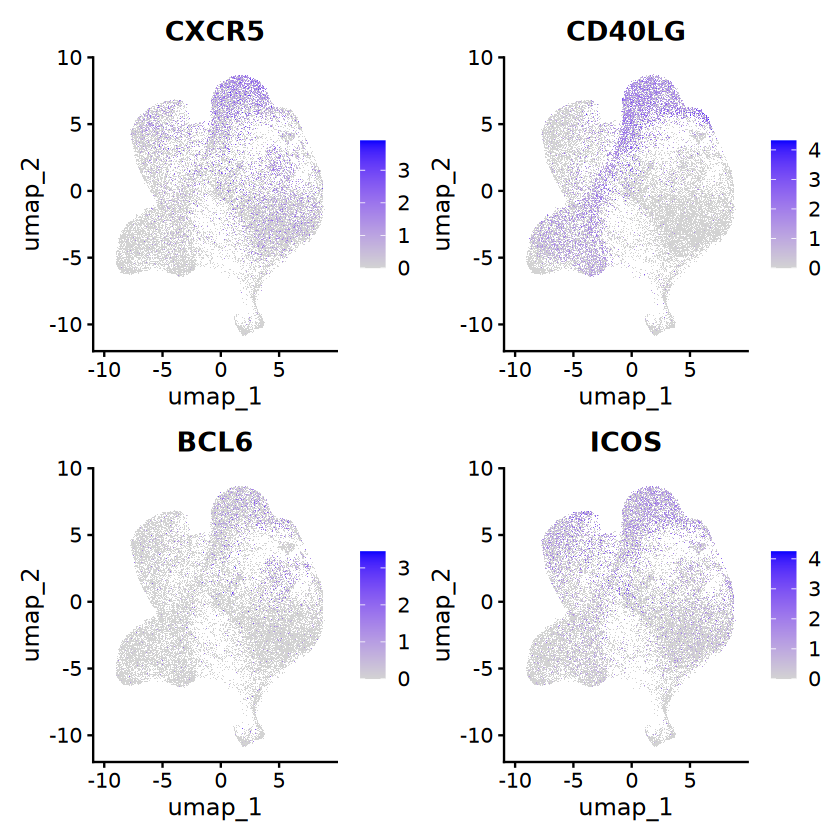

In [18]:
FeaturePlot(int_tcells, features = c("CXCR5", "CD40LG", "BCL6", "ICOS"))
FeaturePlot(int_tcells, features = c("TCF1"))

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



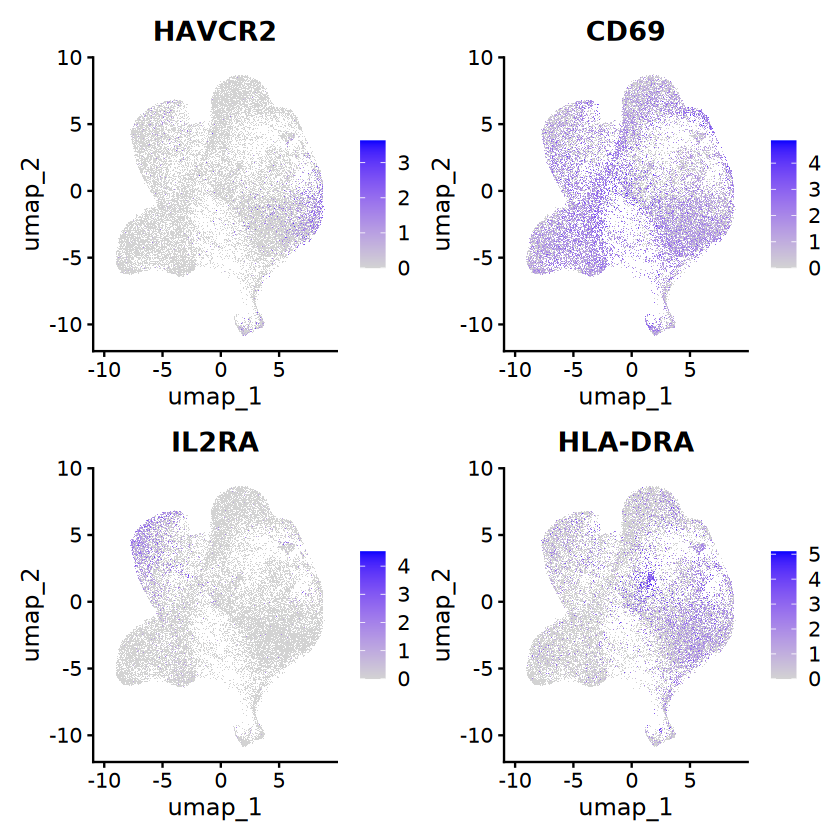

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To di

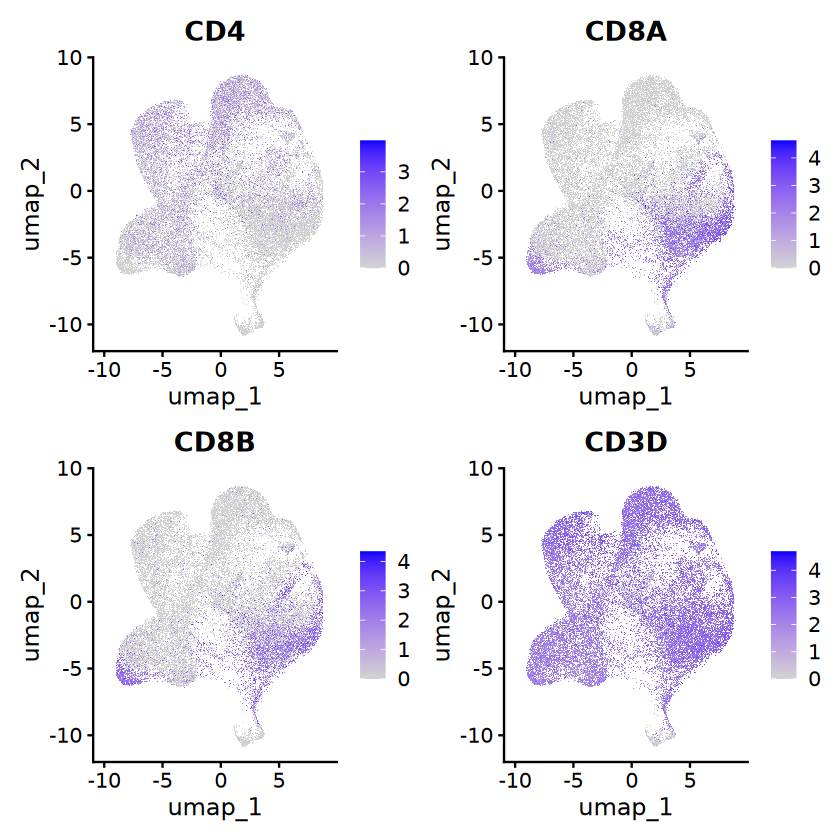

In [11]:
FeaturePlot(int_tcells, features = c("HAVCR2", "CD69", "IL2RA", "HLA-DRA"))

FeaturePlot(int_tcells, features = c("CD4", "CD8A", "CD8B", "CD3D"))
FeaturePlot(int_tcells, features = c("IL7R", "IL4", "IL2", "IL5"))
FeaturePlot(int_tcells, features = c("SELL", "NKG7", "MS4A1", "CCR7"))
FeaturePlot(int_tcells, features = c("NOSIP", "ICOS", "IL10", "FOXP3"))
FeaturePlot(int_tcells, features = c("PDCD1", "TCF7", "CXCR3", "GZMA"))
#CM
FeaturePlot(int_tcells, features = c("IL7R", "CCR7", "SELL", "TCF7"))
#exhausted
FeaturePlot(int_tcells, features = c("CTLA4", "LAG3", "TIGIT", "PDCD1", "CD38"))
#Tfh
FeaturePlot(int_tcells, features = c("BTLA4", "CD40LG", "BCL6", "ICOS"))
#Bcell
FeaturePlot(int_tcells, features = c("MS4A1", "CD19", "CD79B", "CD79A"))
#RBC
FeaturePlot(int_tcells, features = c("HBB", "HBD", "HBA1", "KLF2"))

FeaturePlot(int_tcells, features = c("GZMM", "GZMK", "GZMB", "GZMA"))


Normalizing layer: counts



Finding variable features for layer counts

Centering and scaling data matrix

PC_ 1 
Positive:  CD3E, CD3D, IL32, IFITM1, CD2, FYB1, LAT, CD7, CD3G, SRGN 
	   GIMAP4, GIMAP7, RARRES3, ITM2A, CST7, LCP2, S100A4, FYN, ZAP70, GZMK 
	   CD247, TRBC1, PRKCH, GZMM, TIGIT, TC2N, SPOCK2, SIRPG, CD6, CCL5 
Negative:  MS4A1, CD79A, HLA-DRA, CD79B, CD74, HLA-DRB1, HLA-DPA1, TCL1A, CD24, HLA-DPB1 
	   HLA-DMA, HLA-DQA1, HLA-DQB1, JCHAIN, HLA-DRB5, IGHM, VPREB3, TCF4, SMIM14, RGS13 
	   BCL11A, IL4R, CTSH, FCRLA, BACH2, STAG3, IGHV5-78, IGKC, CD22, ELL3 
PC_ 2 
Positive:  FCER2, CD69, KLF2, IGHV4-34, MS4A1, JUN, SELL, FAM129C, IGLV2-14, ADAM28 
	   IER2, JUNB, FOS, EGR1, MTRNR2L12, CD83, FOSB, LINC00926, IGKV3-20, PLD4 
	   AC245014.3, PLAC8, HLA-DRB1, CD74, CCR7, CCR6, IGHV3-33, LINC01857, RNASE6, HLA-DRA 
Negative:  UBE2C, TYMS, MKI67, TOP2A, CDK1, BIRC5, NUSAP1, AURKB, STMN1, CCNA2 
	   TPX2, KIFC1, CENPF, CDC20, ZWINT, CDKN3, CDCA3, CCNB2, GTSE1, PLK1 
	   CDCA8, GAPDH, HMGB2, ASPM, TK1, CKS2,

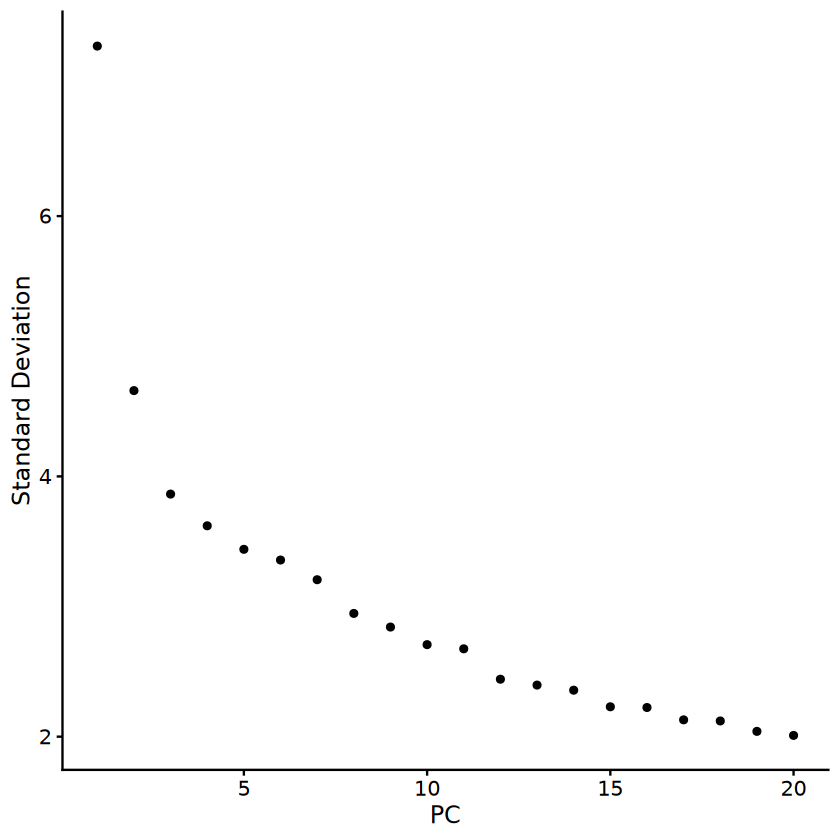

In [10]:
# Step 1: Normalize Data
Merged_patients <- NormalizeData(Merged_patients)

# Step 2: Find Variable Features
Merged_patients <- FindVariableFeatures(Merged_patients)

# Step 3: Scale Data
Merged_patients <- ScaleData(Merged_patients)

# Step 4: Run PCA
Merged_patients <- RunPCA(Merged_patients)

ElbowPlot(Merged_patients)

[1] 42

[1] 15

[1] 15

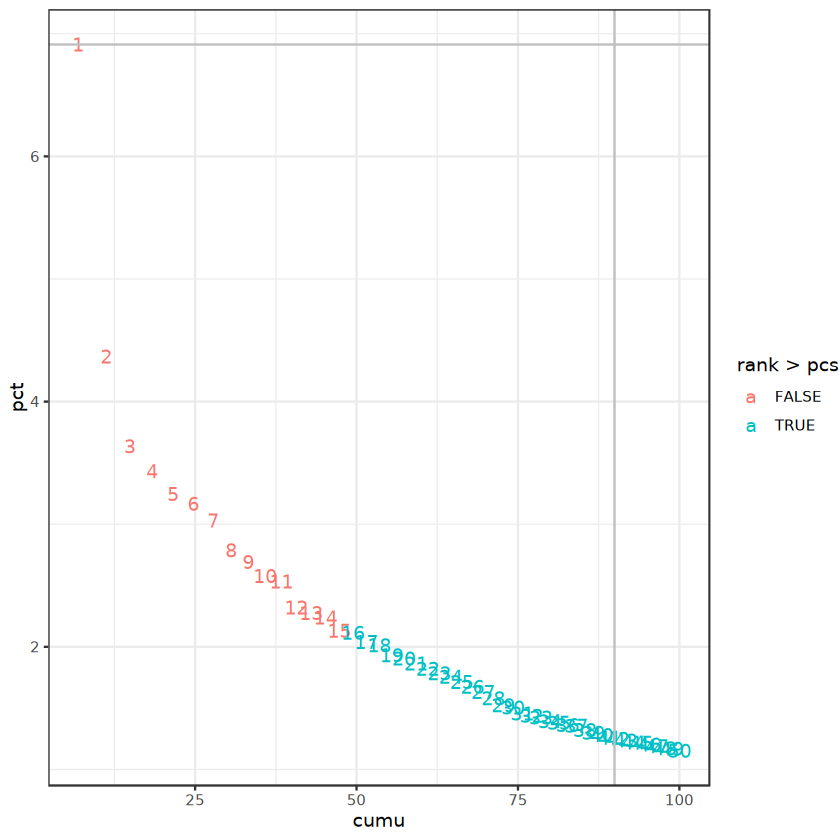

In [5]:
library(ggplot2)
# Determine percent of variation associated with each PC
pct <- subsetted_obj[["pca"]]@stdev / sum(subsetted_obj[["pca"]]@stdev) * 100

# Calculate cumulative percents for each PC
cumu <- cumsum(pct)

# Determine which PC exhibits cumulative percent greater than 90% and % variation associated with the PC as less than 5
co1 <- which(cumu > 90 & pct < 5)[1]

co1
# Determine the difference between variation of PC and subsequent PC
co2 <- sort(which((pct[1:length(pct) - 1] - pct[2:length(pct)]) > 0.1), decreasing = T)[1] + 1

# last point where change of % of variation is more than 0.1%.
co2
# Minimum of the two calculation
pcs <- min(co1, co2)

pcs

# Create a dataframe with values
plot_df <- data.frame(pct = pct, 
           cumu = cumu, 
           rank = 1:length(pct))

# Elbow plot to visualize 
  ggplot(plot_df, aes(cumu, pct, label = rank, color = rank > pcs)) + 
  geom_text() + 
  geom_vline(xintercept = 90, color = "grey") + 
  geom_hline(yintercept = min(pct[pct > 5]), color = "grey") +
  theme_bw()

In [16]:
tcells <- FindClusters(tcells, resolution = (1.8), dims = 1:15)

Warning message:
“The following arguments are not used: dims”
Warning message:
“The following arguments are not used: dims”


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 101938
Number of edges: 2832685

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8285
Number of communities: 35
Elapsed time: 34 seconds


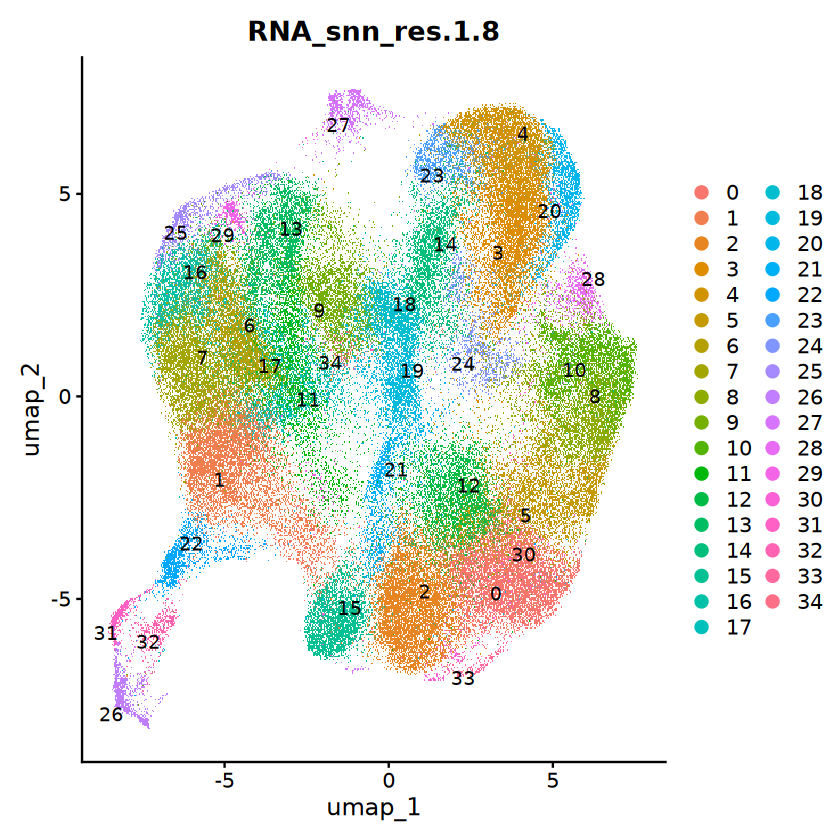

In [17]:
DimPlot(tcells, reduction = "umap", group.by = "RNA_snn_res.1.8", label = TRUE, repel = TRUE, raster = TRUE)

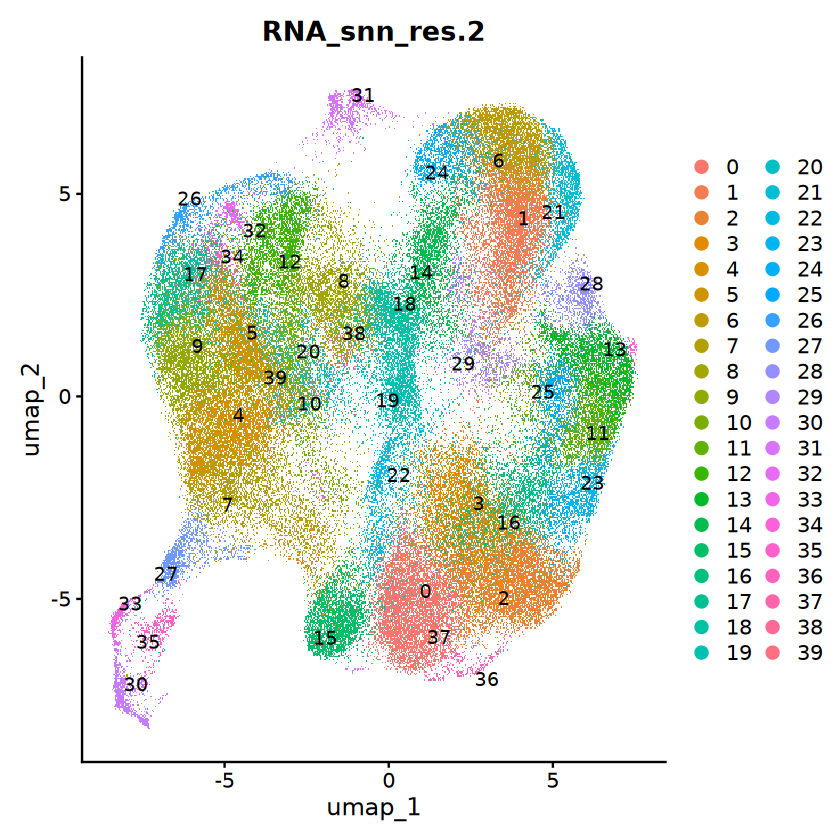

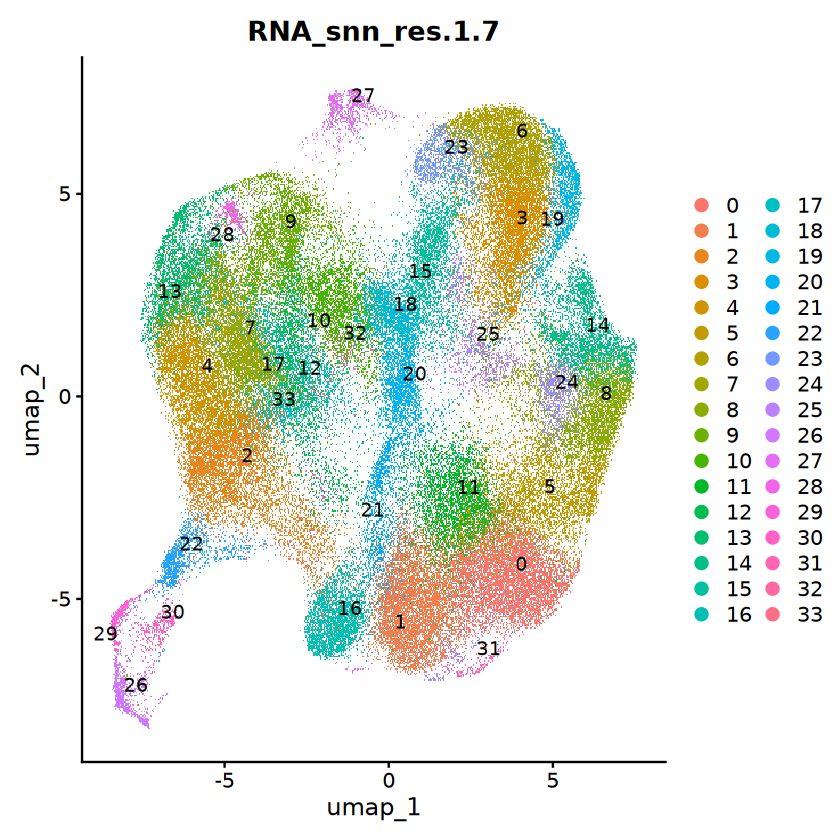

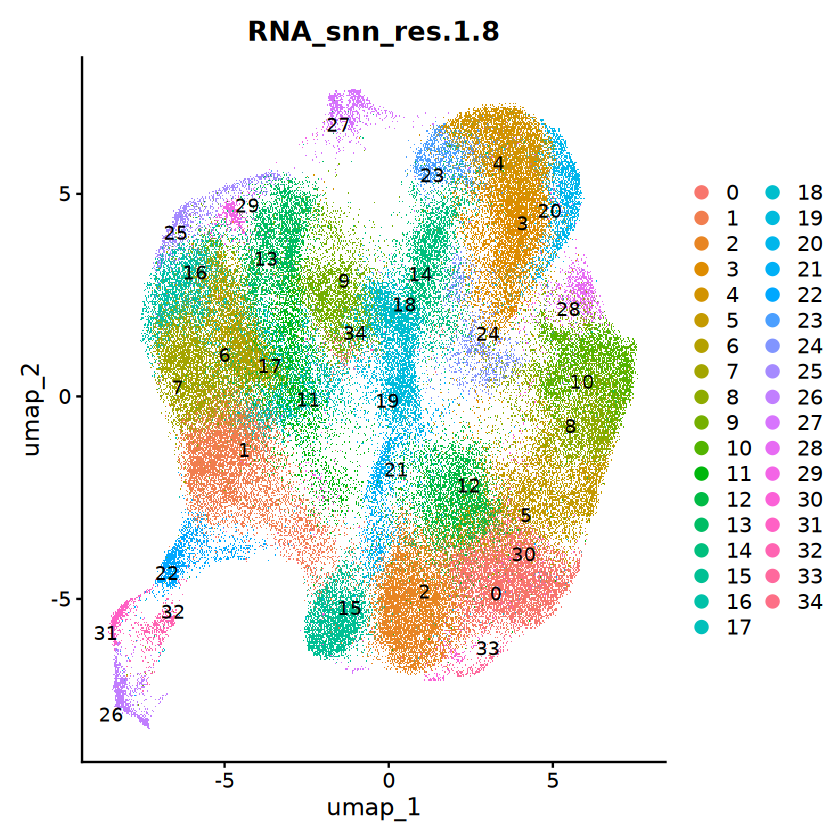

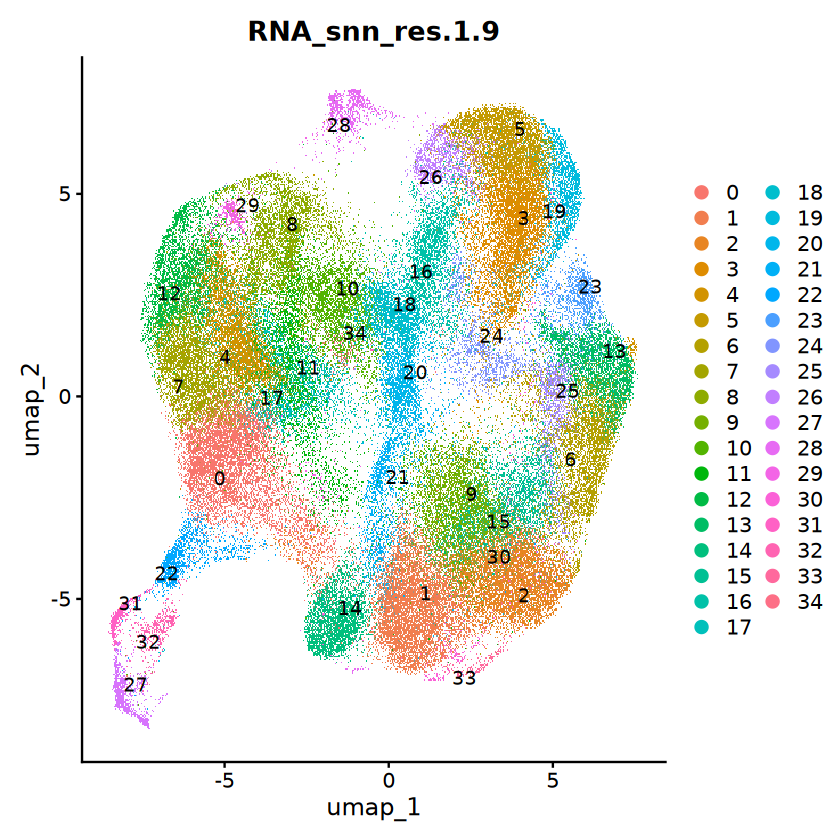

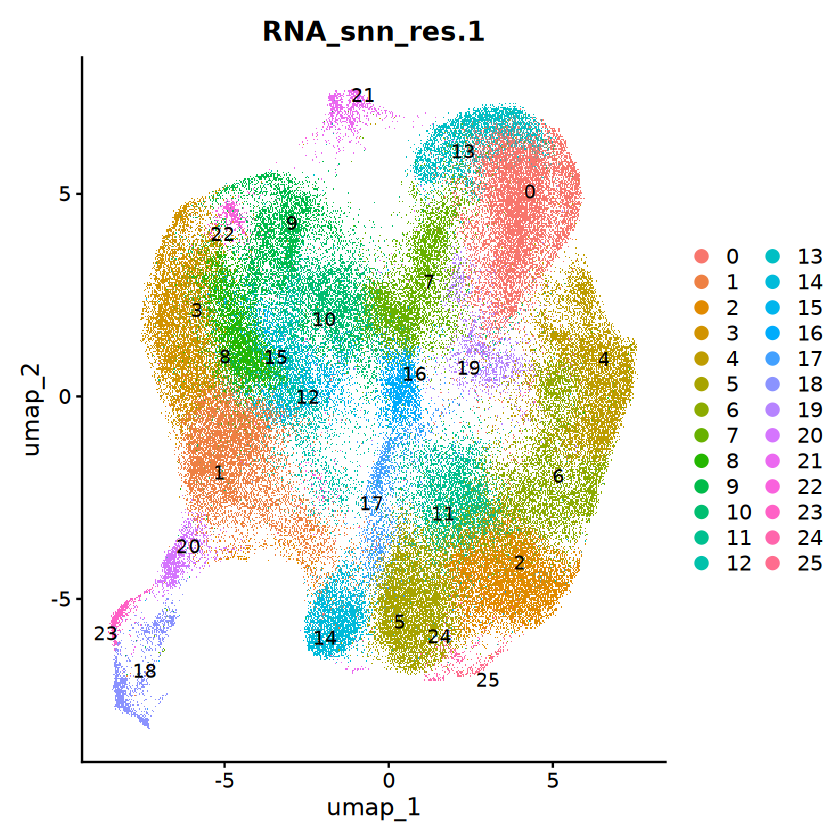

In [11]:
#tcells <- FindClusters(tcells, resolution = c(2.0, 1.9, 1.8, 1.7, 1), dims = 1:15)
DimPlot(tcells, reduction = "umap", group.by = "RNA_snn_res.2", label = TRUE, repel = TRUE, raster = TRUE)
DimPlot(tcells, reduction = "umap", group.by = "RNA_snn_res.1.7", label = TRUE, repel = TRUE, raster = TRUE)
DimPlot(tcells, reduction = "umap", group.by = "RNA_snn_res.1.8", label = TRUE, repel = TRUE, raster = TRUE)
DimPlot(tcells, reduction = "umap", group.by = "RNA_snn_res.1.9", label = TRUE, repel = TRUE, raster = TRUE)
DimPlot(tcells, reduction = "umap", group.by = "RNA_snn_res.1", label = TRUE, repel = TRUE, raster = TRUE)

In [8]:
saveRDS(Merged_patients_other, file = "Other_immune_cells.RDS")
save(Merged_patients_other, file = "Other_immune_cells.Robj")

In [23]:
saveRDS(tcells, file = "labeled-tcells.RDS")
save(tcells, file = "labeled-tcells.Robj")

In [9]:
saveRDS(bcells, file = "labeled-bcells.RDS")
save(bcells, file = "labeled-bcells.Robj")

In [4]:
saveRDS(int_tcells, file = "labeled-int_tcells.RDS")
save(int_tcells, file = "labeled-int_tcells.Robj")

Normalizing layer: counts

Normalizing layer: counts

Finding variable features for layer counts

Finding variable features for layer counts

Centering and scaling data matrix

Warning message:
“Different features in new layer data than already exists for scale.data”
Centering and scaling data matrix

Warning message:
“Different features in new layer data than already exists for scale.data”
PC_ 1 
Positive:  RPS12, VIM, IL7R, TPT1, KLF2, EMP3, RPS18, SELL, CCR7, ANXA1 
	   RPL3, RPS6, EEF1A1, RPS5, TMSB10, FLT3LG, RPS2, NOSIP, S1PR1, LEF1 
	   RASGRP2, RPSA, EEF1B2, PLAC8, C1orf162, LDHB, TXNIP, S100A6, IFITM1, RPLP0 
Negative:  SRGN, PDCD1, TOX2, TIGIT, ITM2A, TOX, COTL1, DRAIC, RNF19A, SMCO4 
	   GAPDH, SH2D1A, CD74, CORO1B, CXCL13, RAB27A, LIMS1, MAF, FABP5, BATF 
	   ICA1, CHI3L2, IKZF3, CD82, CTLA4, GNG4, CXCR5, CD200, ZNRF1, AC012645.3 
PC_ 2 
Positive:  CD40LG, SMCO4, FKBP5, TCF7, TOX2, LTB, FBLN7, IL6ST, AC012645.3, IL6R 
	   EEF1A1, NR3C1, TNFRSF4, ICA1, PASK, SPOCK2, LIMS2, A

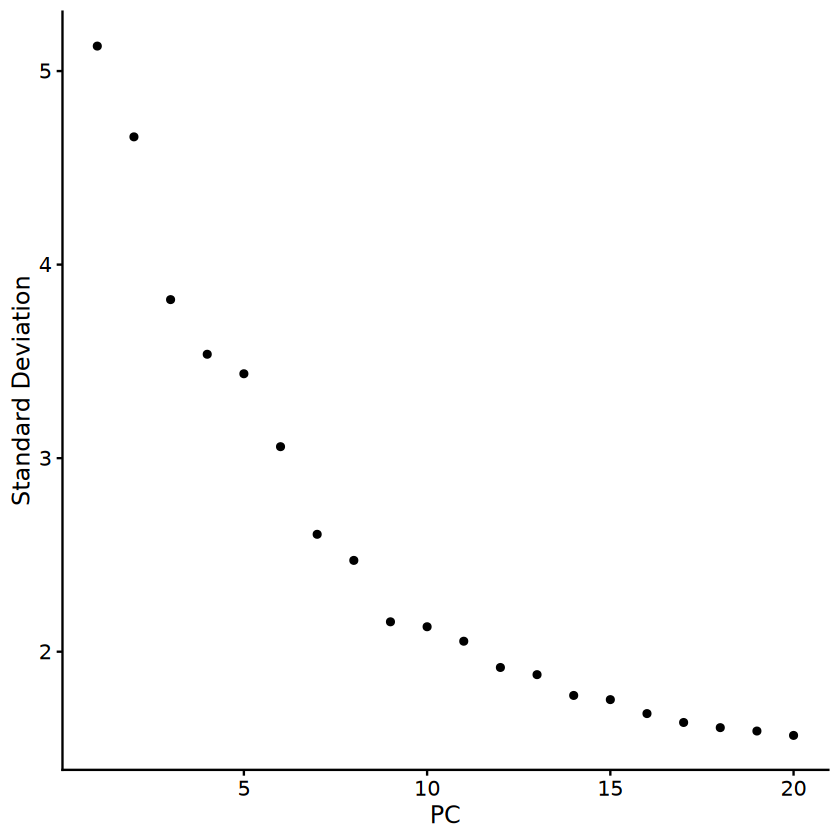

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
11:11:50 UMAP embedding parameters a = 0.9922 b = 1.112

11:11:50 Read 101938 rows and found 15 numeric columns

11:11:50 Using Annoy for neighbor search, n_neighbors = 30

11:11:50 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

11:12:02 Writing NN index file to temp file /tmp/RtmpOH21kt/file42dc448ad00e

11:12:02 Searching Annoy index using 1 thread, search_k = 3000

11:12:42 Annoy recall = 100%

11:12:44 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 101938
Number of edges: 2832685

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8439
Number of communities: 32
Elapsed time: 36 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 101938
Number of edges: 2832685

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8526
Number of communities: 29
Elapsed time: 37 seconds


11:16:46 UMAP embedding parameters a = 0.9922 b = 1.112

11:16:46 Read 181911 rows and found 15 numeric columns

11:16:46 Using Annoy for neighbor search, n_neighbors = 30

11:16:46 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

11:17:06 Writing NN index file to temp file /tmp/RtmpOH21kt/file42dce4acac9

11:17:06 Searching Annoy index using 1 thread, search_k = 3000

11:18:11 Annoy recall = 100%

11:18:12 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

11:18:21 Initializing from normalized Laplacian + noise (using RSpectra)

11:19:03 Commencing optimization for 200 epochs, with 8041708 positive edges

11:22:43 Optimization finished

Computing nearest neighbor graph

Computing SNN

Warning message:
“The following arguments are n

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 181911
Number of edges: 5407244

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9491
Number of communities: 35
Elapsed time: 81 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 181911
Number of edges: 5407244

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9582
Number of communities: 30
Elapsed time: 78 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 181911
Number of edges: 5407244

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9684
Number of communities: 27
Elapsed time: 87 seconds


Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16

Calculating cluster 17

Calculating cluster 18

Calculating cluster 19

Calculating cluster 20

Calculating cluster 21

Calculating cluster 22

Calculating cluster 23

Calculating cluster 24

Calculating cluster 25

Calculating cluster 26

Calculating cluster 27

Calculating cluster 28

Calculating cluster 29

Calculating cluster 30

Calculating cluster 31

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating 

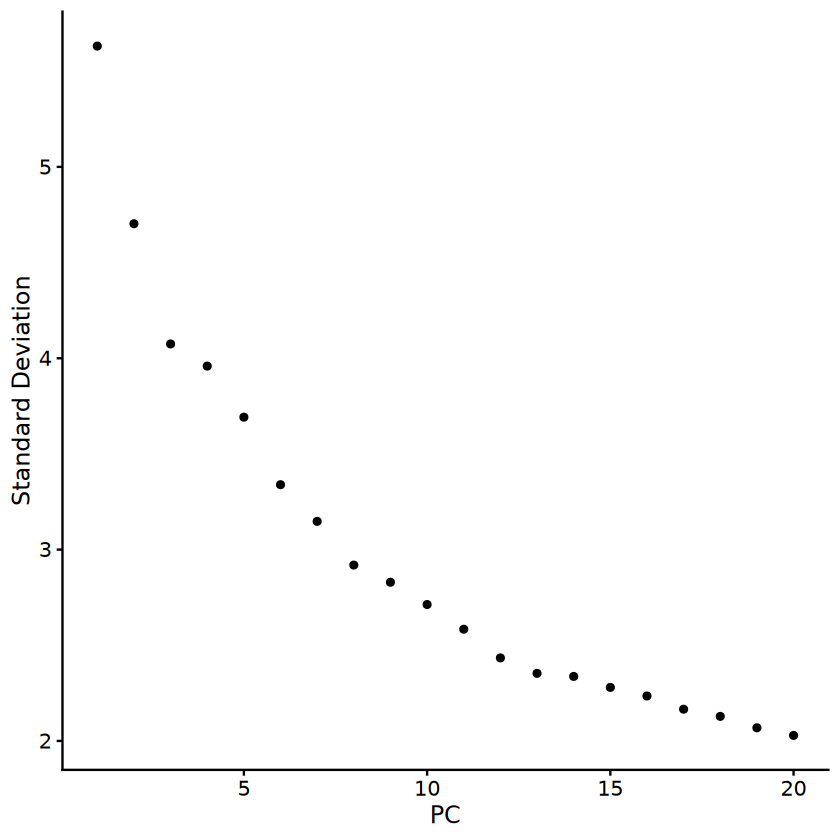

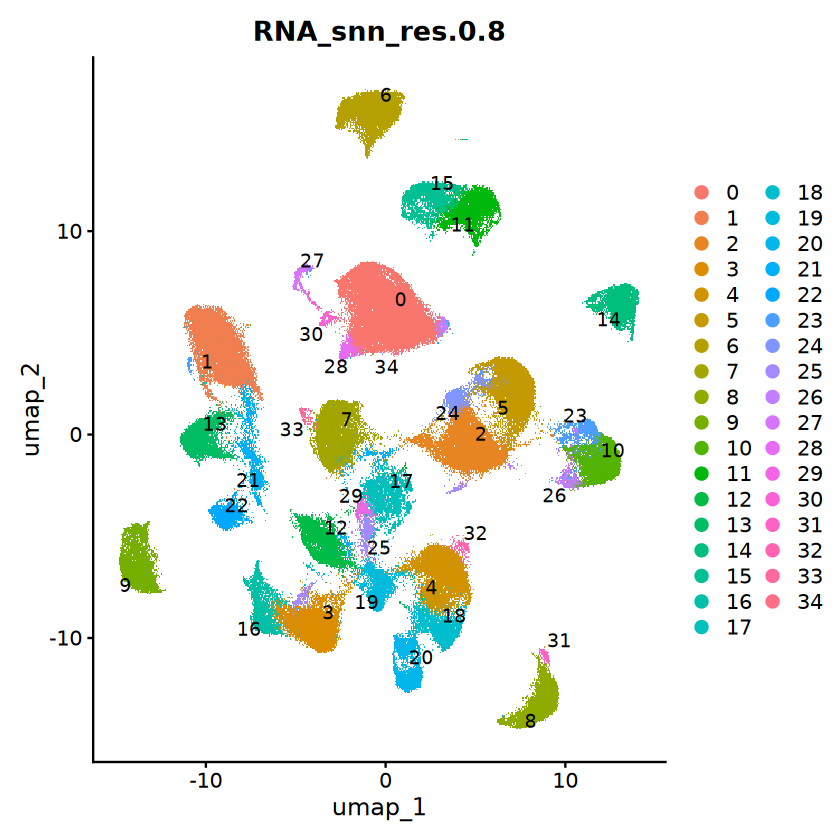

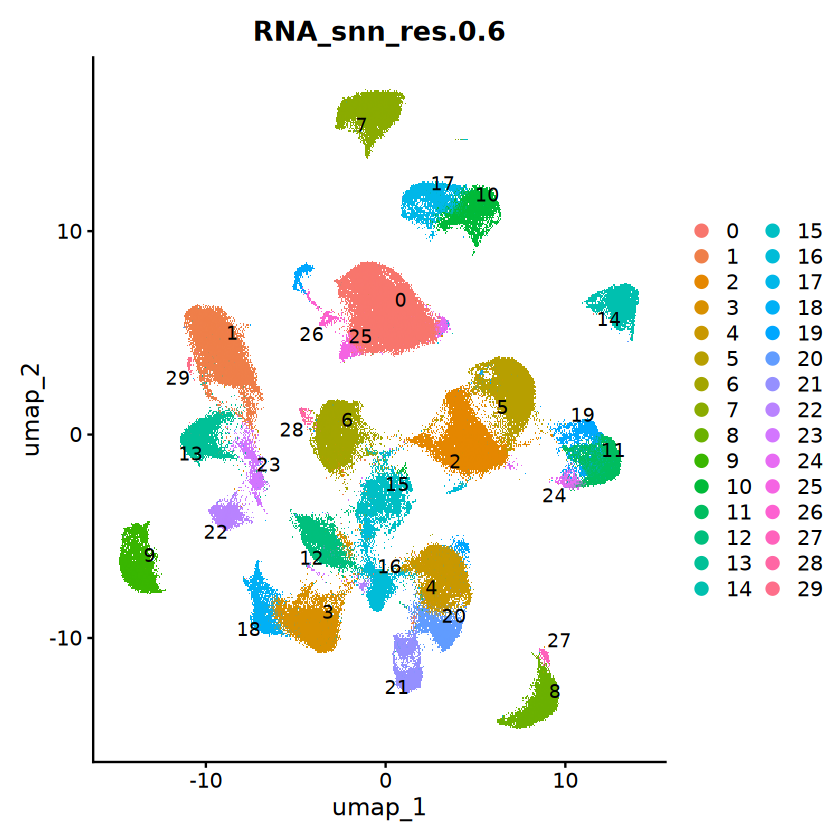

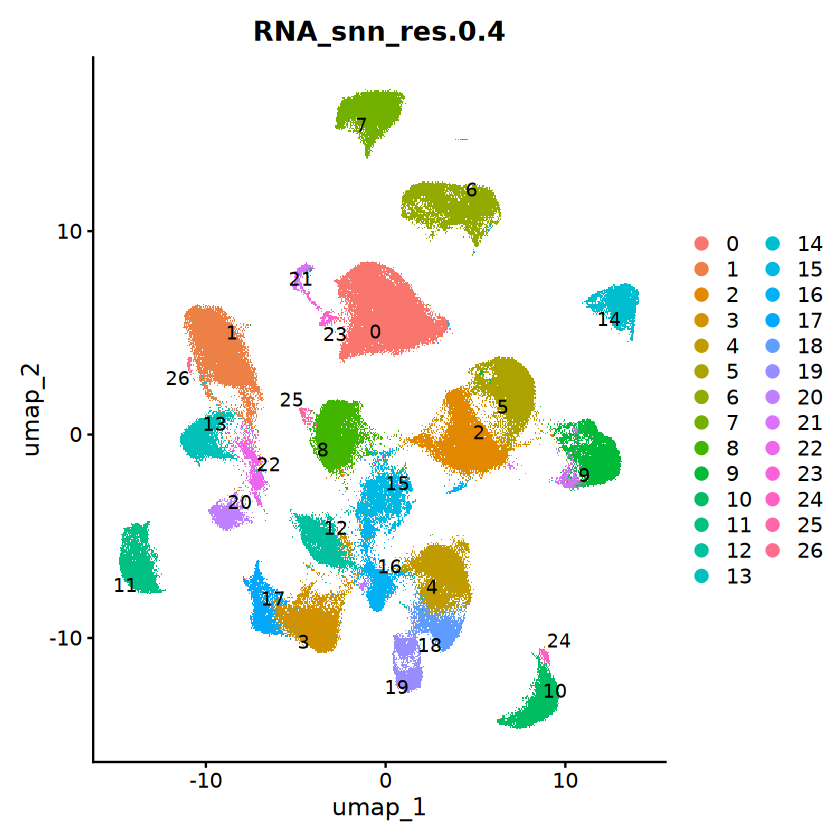

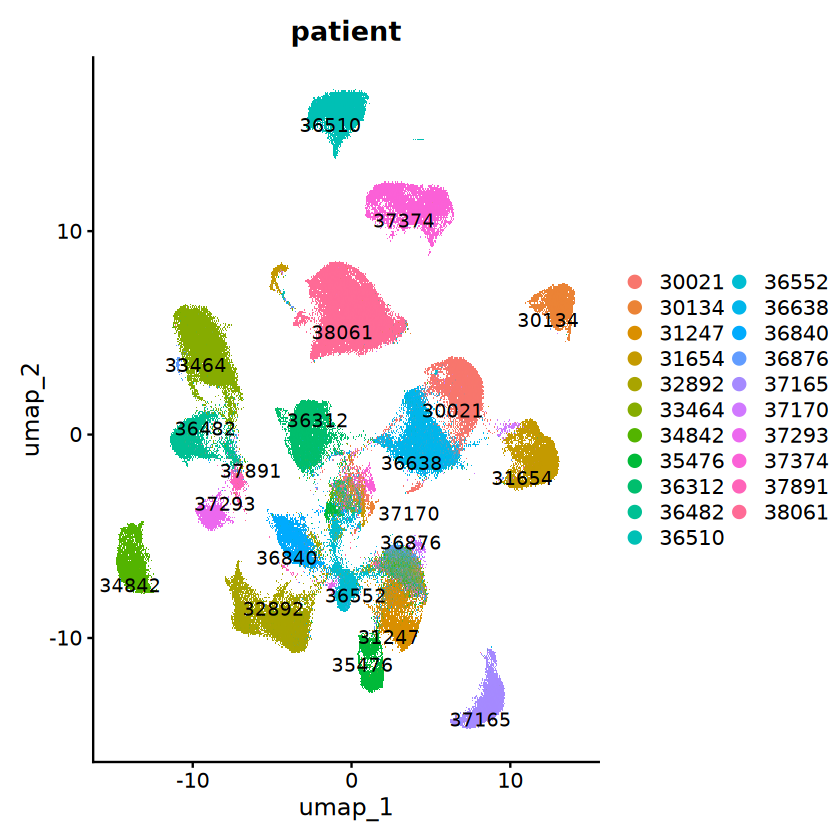

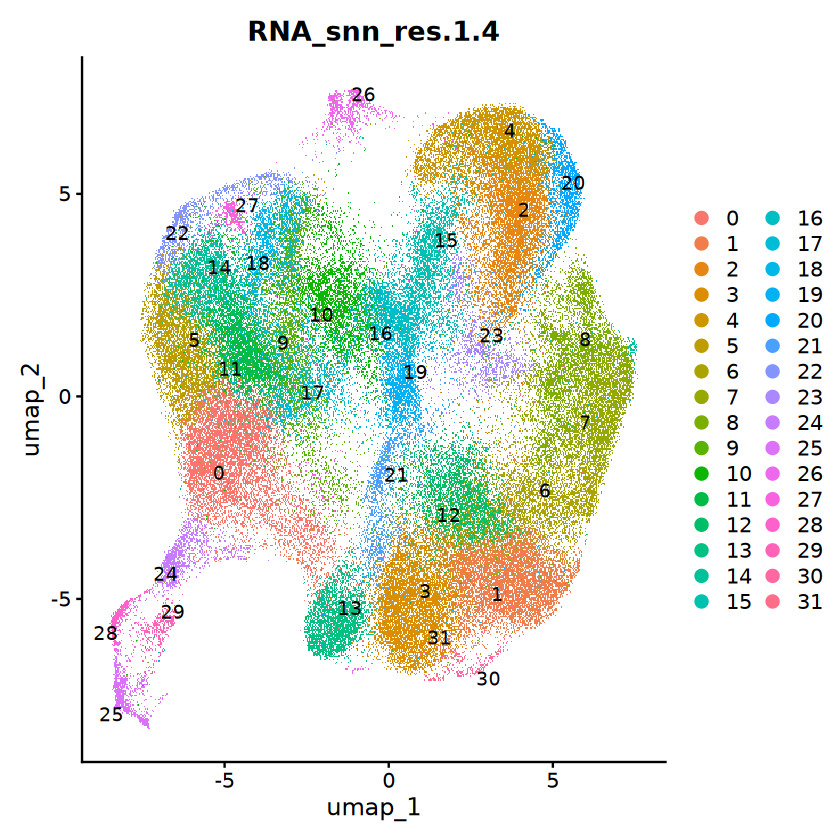

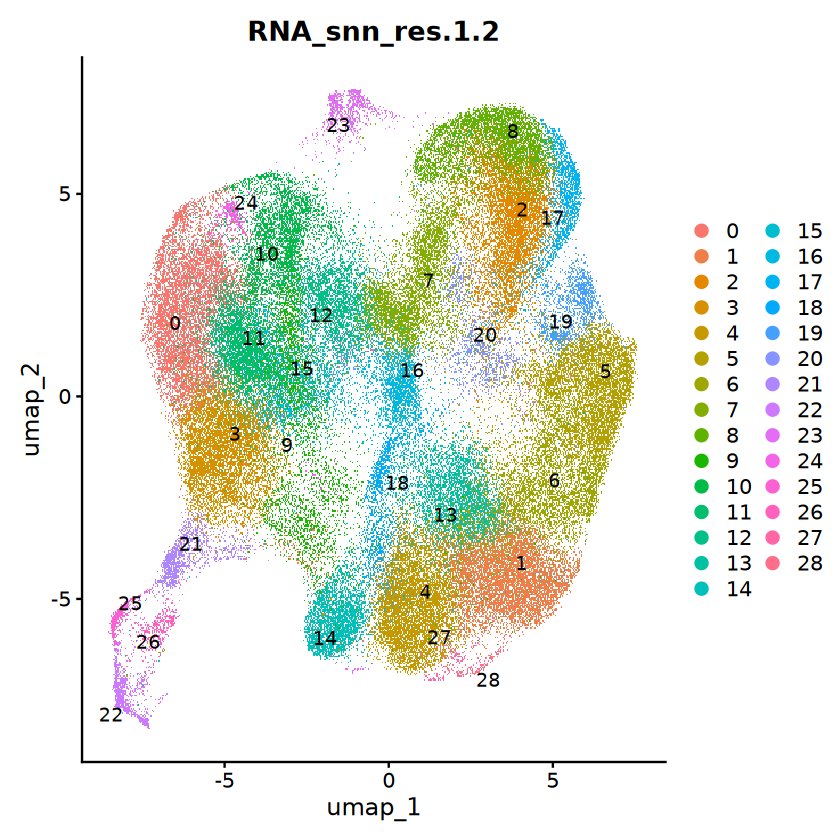

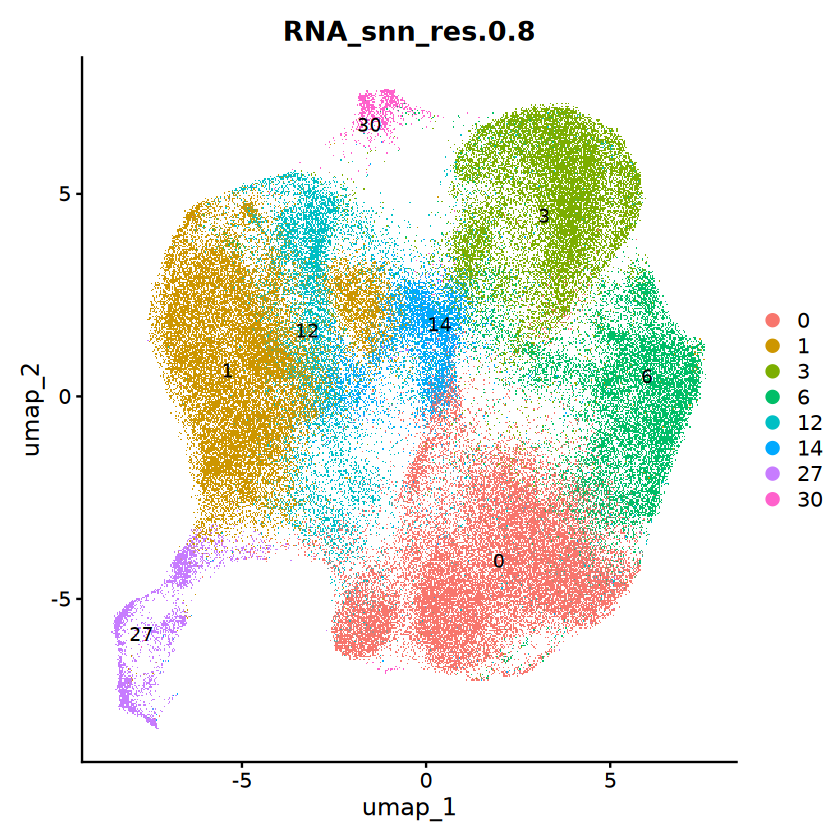

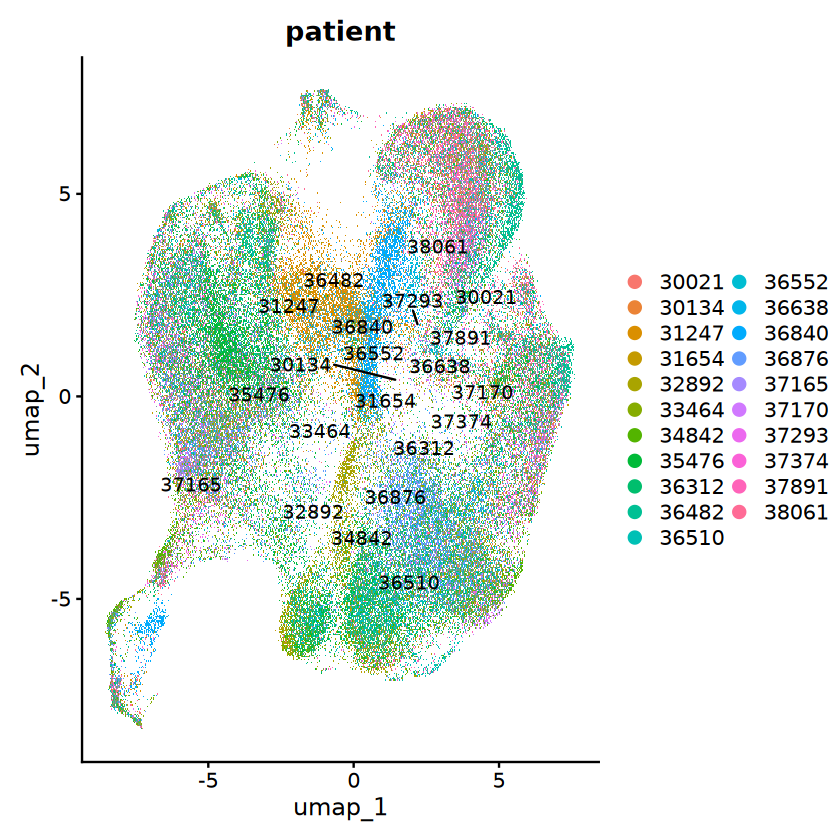

In [6]:
# Step 1: Normalize Data
tcells <- NormalizeData(tcells)
bcells <- NormalizeData(bcells)

# Step 2: Find Variable Features
tcells <- FindVariableFeatures(tcells)
bcells <- FindVariableFeatures(bcells)
# Step 3: Scale Data
tcells <- ScaleData(tcells)
bcells <- ScaleData(bcells)
# Step 4: Run PCA
tcells <- RunPCA(tcells)
bcells <- RunPCA(bcells)

ElbowPlot(tcells)
ElbowPlot(bcells)

tcells <- RunUMAP(tcells, dims = 1:15)
tcells <- FindNeighbors(tcells, dims = 1:15)
tcells <- FindClusters(tcells, resolution = c(1.4, 1.2), dims = 1:15)

bcells <- RunUMAP(bcells, dims = 1:15)
bcells <- FindNeighbors(bcells, dims = 1:15)
bcells <- FindClusters(bcells, resolution = c(0.8, 0.6, 0.4), dims = 1:15)

bcells@active.ident <- as.factor(bcells$`RNA_snn_res.0.4`)
tcells@active.ident <- as.factor(tcells$`RNA_snn_res.1.4`)

saveRDS(bcells, file = "bcells.RDS")
save(bcells, file = "bcells.Robj")
saveRDS(tcells, file = "bcells.RDS")
save(tcells, file = "tcells.Robj")


t.markers <- FindAllMarkers(object = tcells)
save(t.markers, file = "tcell-markers-unlabeled.Robj")
write.csv(t.markers, file = "tcell-markers-unlabeled.csv")

b.markers <- FindAllMarkers(object = bcells)
save(b.markers, file = "bcell-markers-unlabeled.Robj")
write.csv(b.markers, file = "bcell-markers-unlabeled.csv")

DimPlot(bcells, reduction = "umap", group.by = "RNA_snn_res.0.8", label = TRUE, repel = TRUE, raster = TRUE)
DimPlot(bcells, reduction = "umap", group.by = "RNA_snn_res.0.6", label = TRUE, repel = TRUE, raster = TRUE)
DimPlot(bcells, reduction = "umap", group.by = "RNA_snn_res.0.4", label = TRUE, repel = TRUE, raster = TRUE)
DimPlot(bcells, reduction = "umap", group.by = "patient", label = TRUE, repel = TRUE, raster = TRUE)

DimPlot(tcells, reduction = "umap", group.by = "RNA_snn_res.1.4", label = TRUE, repel = TRUE, raster = TRUE)
DimPlot(tcells, reduction = "umap", group.by = "RNA_snn_res.1.2", label = TRUE, repel = TRUE, raster = TRUE)
DimPlot(tcells, reduction = "umap", group.by = "RNA_snn_res.0.8", label = TRUE, repel = TRUE, raster = TRUE)
DimPlot(tcells, reduction = "umap", group.by = "patient", label = TRUE, repel = TRUE, raster = TRUE)

Calculating cluster CD8.TEM



Calculating cluster Treg

Calculating cluster CD4.naive

Calculating cluster Tfh

Calculating cluster CD4.TCM

Calculating cluster Texh

Calculating cluster CD4.TEM

Calculating cluster Tfh.exh

Calculating cluster Toxphos

Calculating cluster CD8.TCM

Calculating cluster CD8.naive

Calculating cluster Tr1

Calculating cluster NK

Calculating cluster Bcell

Calculating cluster Prolif

Warning message in DoHeatmap(subset(int_tcells, downsample = 100), features = top$gene):
“The following features were omitted as they were not found in the scale.data slot for the RNA assay: AC116337.3, N4BP2L2, DDX17, MBNL1, MALAT1, CAMK4”
Warning message in DoHeatmap(subset(int_tcells), features = top$gene):
“The following features were omitted as they were not found in the scale.data slot for the RNA assay: AC116337.3, N4BP2L2, DDX17, MBNL1, MALAT1, CAMK4”


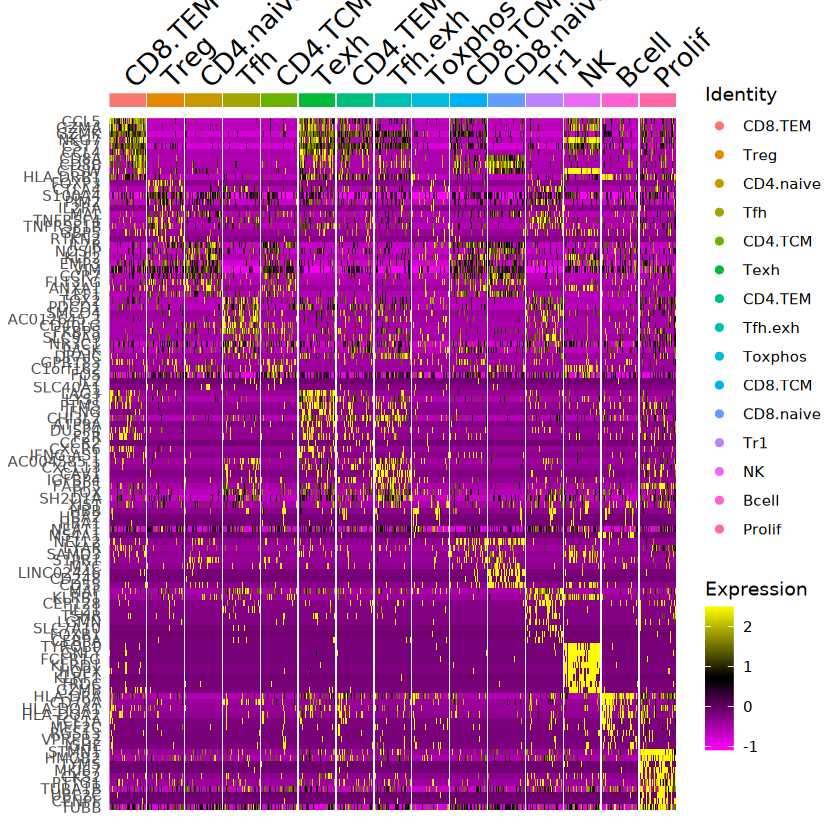

In [61]:
#tcells@active.ident <- as.factor(tcells$`RNA_snn_res.1.8`)

t.markers <- FindAllMarkers(object = int_tcells)
save(t.markers, file = "tcell-markers-labeled.Robj")
write.csv(t.markers, file = "tcell-markers-labeled.csv")

t.markers %>%
    group_by(cluster) %>%
    dplyr::filter(avg_log2FC > 1) %>%
    slice_head(n = 10) %>%
    ungroup() -> top

#DoHeatmap(Merged_patients, features = top$gene)
DoHeatmap(subset(int_tcells, downsample = 100), features = top$gene)
Dot <- DoHeatmap(subset(int_tcells), features = top$gene)
ggsave("tcell-DEG.jpeg", plot = Dot, width = 12, height = 24, units = "in", dpi = 350, limitsize = FALSE)

In [52]:
Dot <- DoHeatmap(subset(tcells), features = top$gene)
ggsave("tcell-DEG.jpeg", plot = Dot, width = 12, height = 24, units = "in", dpi = 350, limitsize = FALSE) # 72 dpi for points to inches conversion

Warning message in DoHeatmap(subset(tcells), features = top$gene):
“The following features were omitted as they were not found in the scale.data slot for the RNA assay: LDLRAP1, CAMK4”


In [26]:
bcells@active.ident <- as.factor(bcells$`RNA_snn_res.0.4`)
tcells@active.ident <- as.factor(tcells$`RNA_snn_res.1.4`)

saveRDS(bcells, file = "bcells.RDS")
save(bcells, file = "bcells.Robj")
saveRDS(tcells, file = "bcells.RDS")
save(tcells, file = "tcells.Robj")


t.markers <- FindAllMarkers(object = tcells)
save(t.markers, file = "tcell-markers-unlabeled.Robj")
write.csv(t.markers, file = "tcell-markers-unlabeled.csv")

b.markers <- FindAllMarkers(object = bcells)
save(b.markers, file = "bcell-markers-unlabeled.Robj")
write.csv(b.markers, file = "bcell-markers-unlabeled.csv")

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16

Calculating cluster 17

Calculating cluster 18

Calculating cluster 19

Calculating cluster 20

Calculating cluster 21

Calculating cluster 22

Calculating cluster 23

Calculating cluster 24

Calculating cluster 25

Calculating cluster 26

Calculating cluster 27

Calculating cluster 28

Calculating cluster 29

Calculating cluster 30

Calculating cluster 31



ERROR: Error in is.data.frame(x): object 'all.markers' not found


In [27]:
write.csv(t.markers, file = "tcell-markers-unlabeled.csv")

b.markers <- FindAllMarkers(object = bcells)
save(b.markers, file = "bcell-markers-unlabeled.Robj")
write.csv(b.markers, file = "bcell-markers-unlabeled.csv")

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16

Calculating cluster 17

Calculating cluster 18

Calculating cluster 19

Calculating cluster 20

Calculating cluster 21

Calculating cluster 22

Calculating cluster 23

Calculating cluster 24

Calculating cluster 25

Calculating cluster 26



[1] 98125

[1] 96342

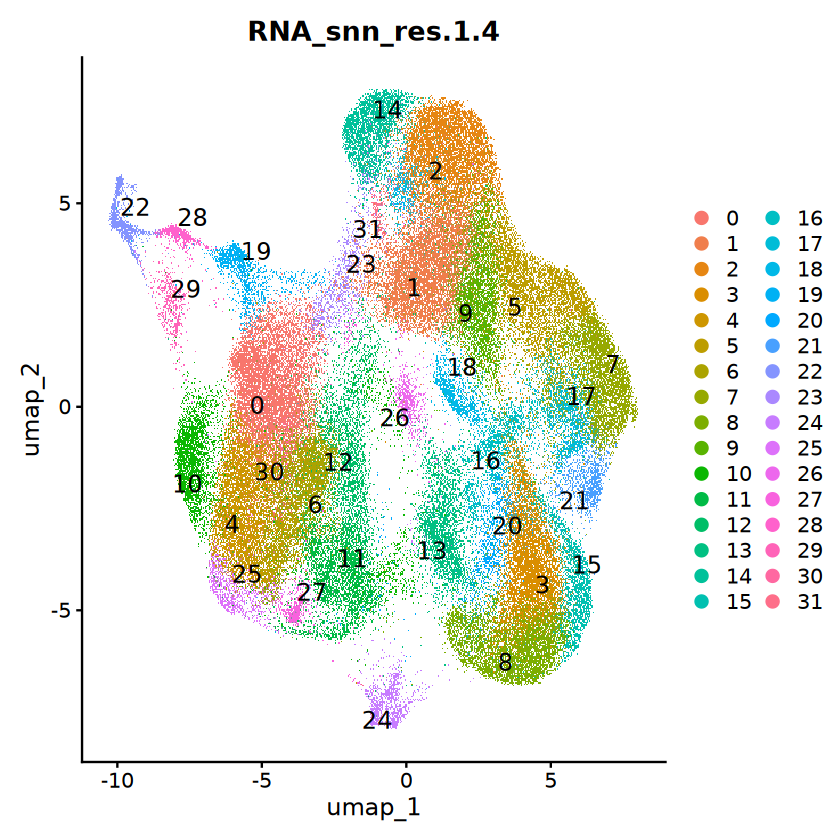

In [55]:
DimPlot(
        tcells, reduction = "umap", 
        group.by = "RNA_snn_res.1.4", label = TRUE, 
        label.size = 5, repel = TRUE, raster = TRUE
    )

ncol(tcells)

# Step 1: Define your gene list
gene_list <- c("CD2", "CD3D", "CD7","CD8B", "CD8A", "CD4")  # Example genes

# Step 2: Retrieve the counts matrix for the RNA assay
counts_matrix <- GetAssayData(tcells, assay = "RNA", slot = "counts")

# Step 3: Identify the indices of the genes in the matrix
gene_indices <- which(rownames(counts_matrix) %in% gene_list)

# Step 4: Ensure that all genes were found
if (length(gene_indices) < length(gene_list)) {
    warning("Some genes were not found in the dataset:")
    print(setdiff(gene_list, rownames(counts_matrix)[gene_indices]))
}

# Step 5: Subsetting logic (choose one)

## Option A: Cells expressing **at least one gene** from the list
expressing_cells <- which(colSums(counts_matrix[gene_indices, ] > 0) > 0)

## Option B: Cells expressing **all genes** in the list
# expressing_cells <- which(colSums(counts_matrix[gene_indices, ] > 0) == length(gene_list))

# Step 6: Retrieve the barcodes of the expressing cells
barcode_list <- colnames(counts_matrix)[expressing_cells]

# Step 7: Subset the Seurat object to retain only these cells
if (length(barcode_list) > 0) {
    sub.merged_obj <- subset(tcells, cells = barcode_list)

    # Step 8: Plot the UMAP
    DimPlot(
        sub.merged_obj, reduction = "umap", 
        group.by = "RNA_snn_res.0.8", label = TRUE, 
        label.size = 5, repel = TRUE, raster = TRUE
    )
    ncol(sub.merged_obj)
} else {
    stop("No cells expressing the specified genes were found.")
}


Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



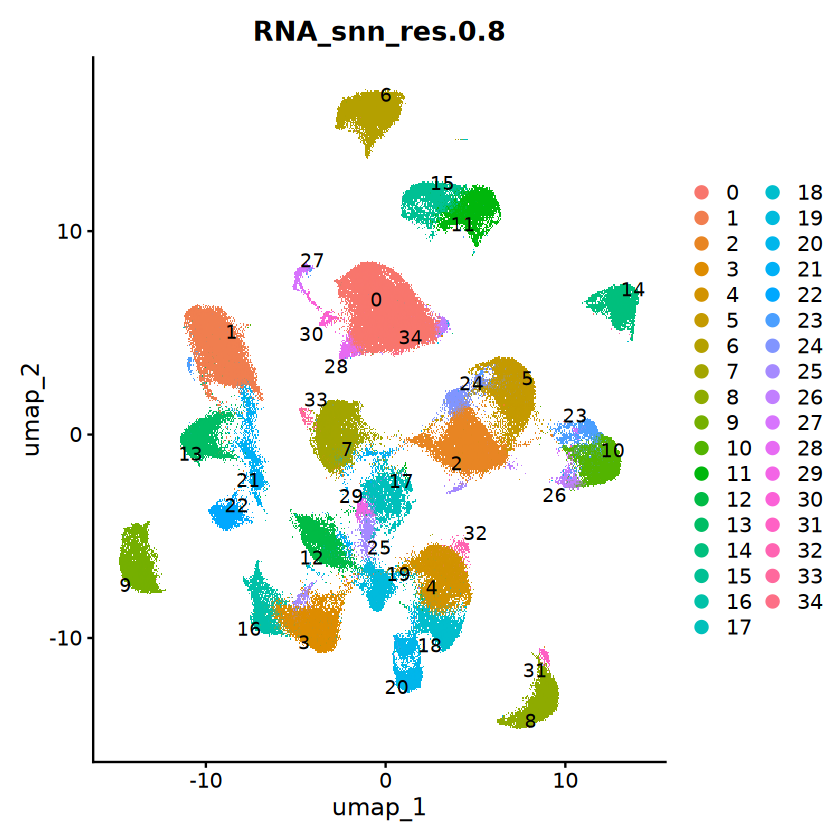

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



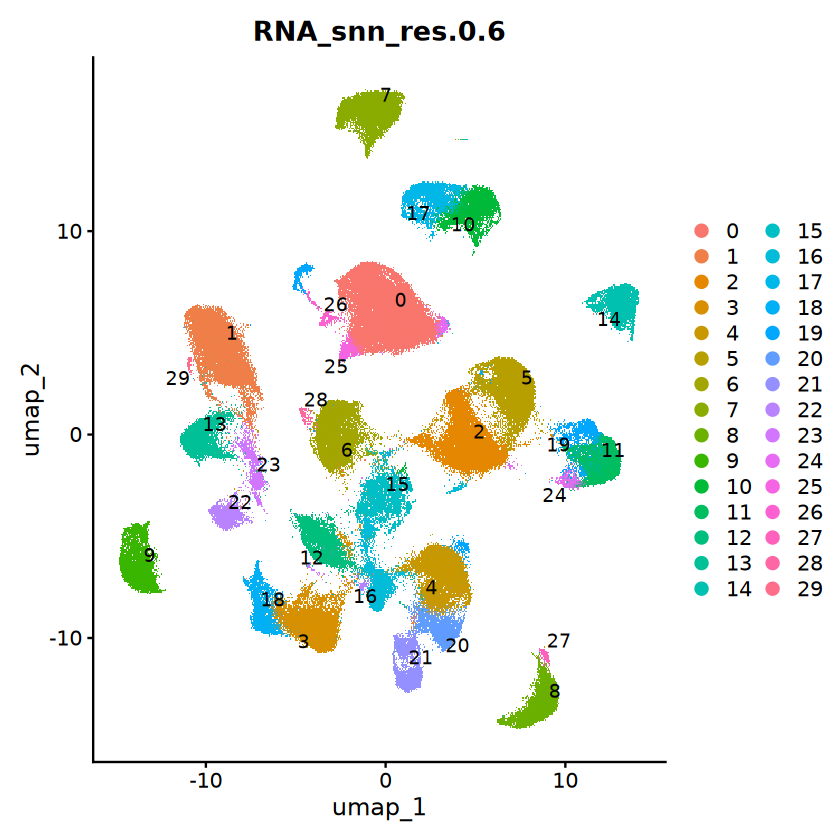

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



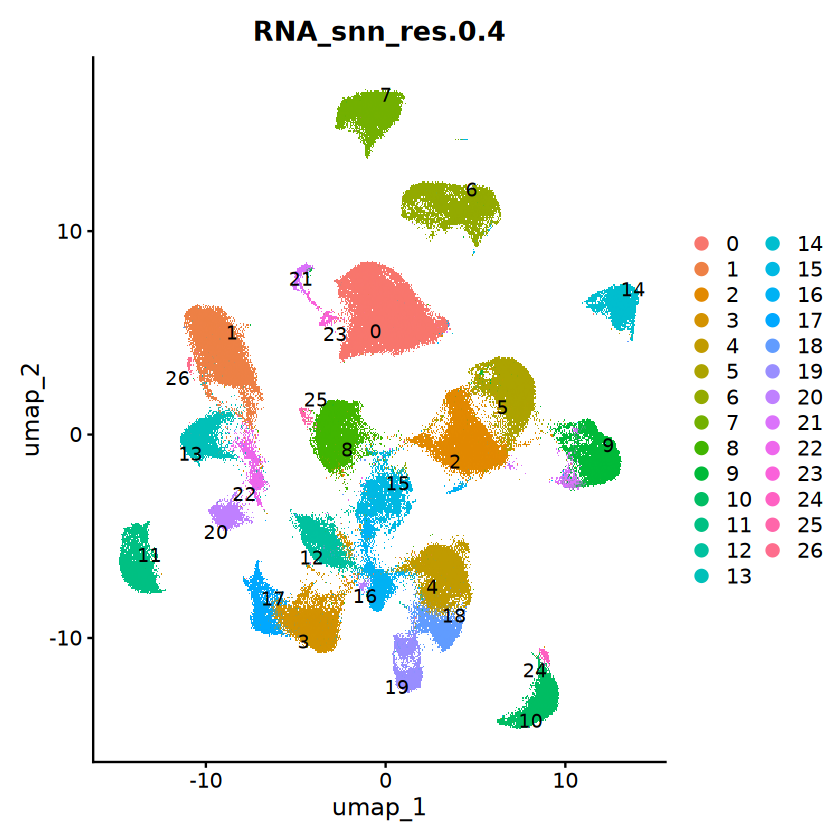

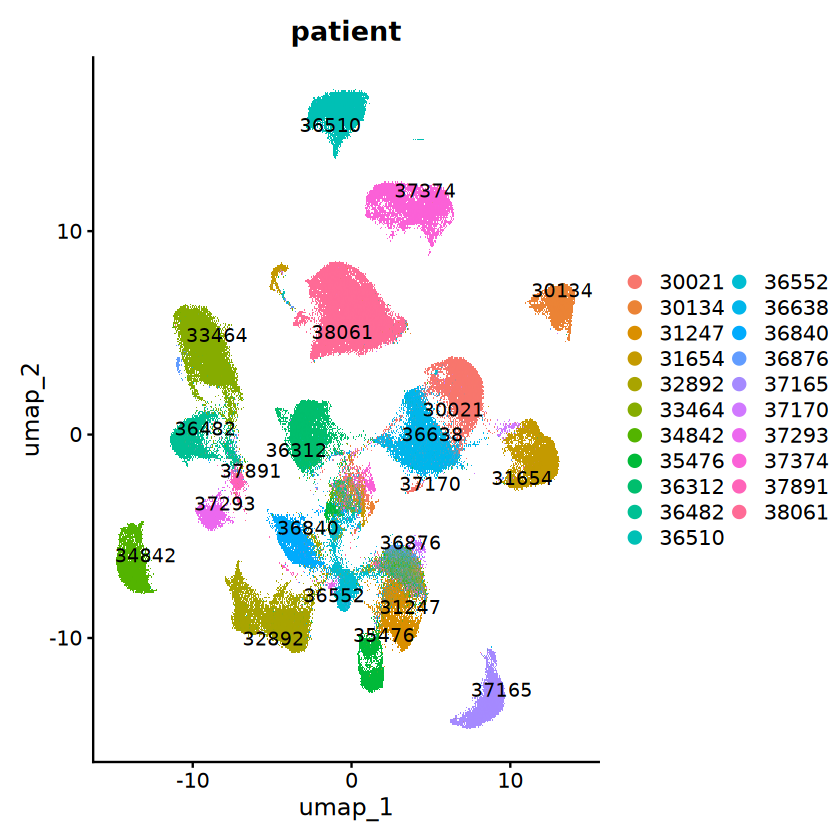

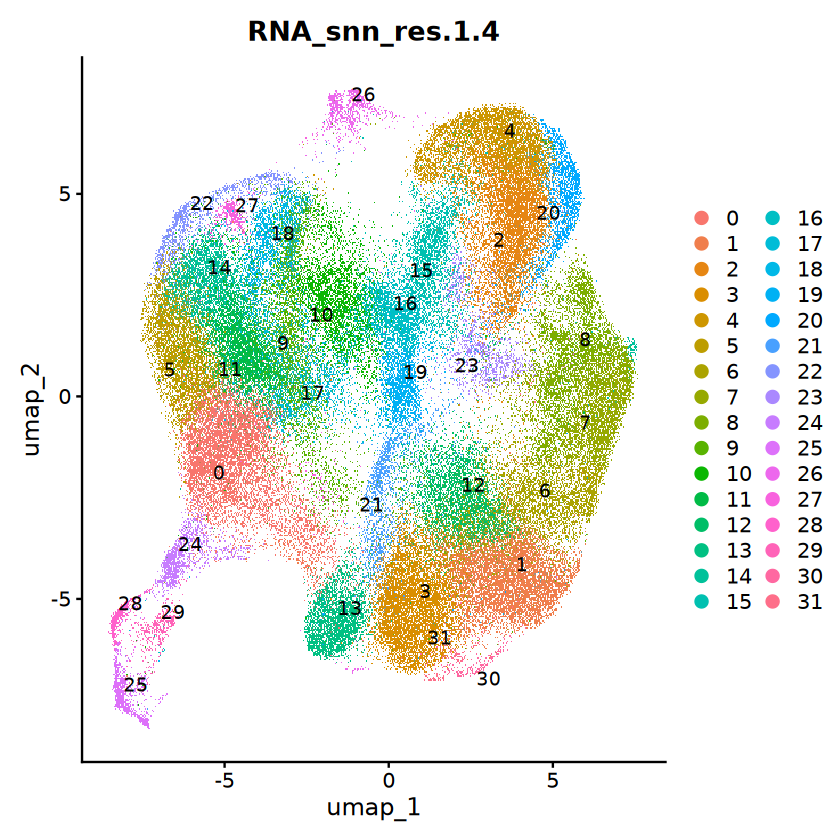

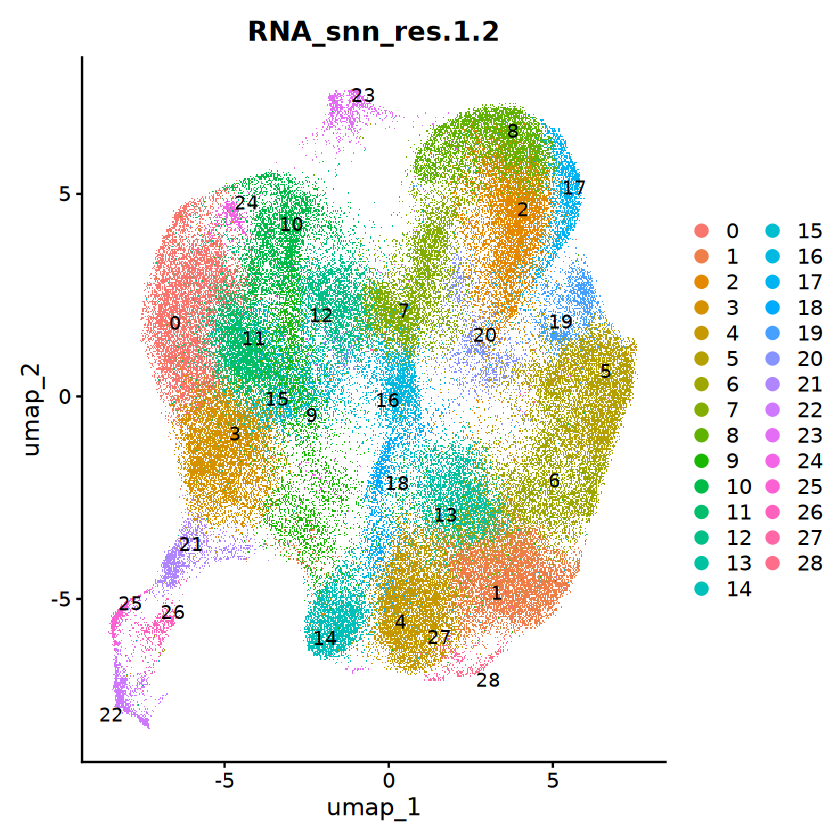

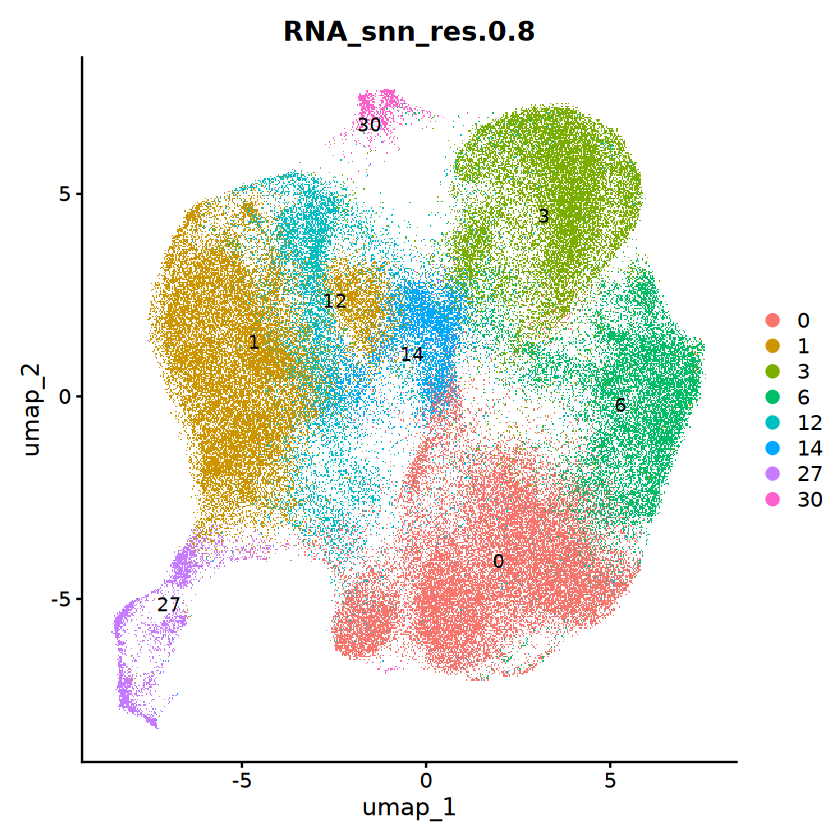

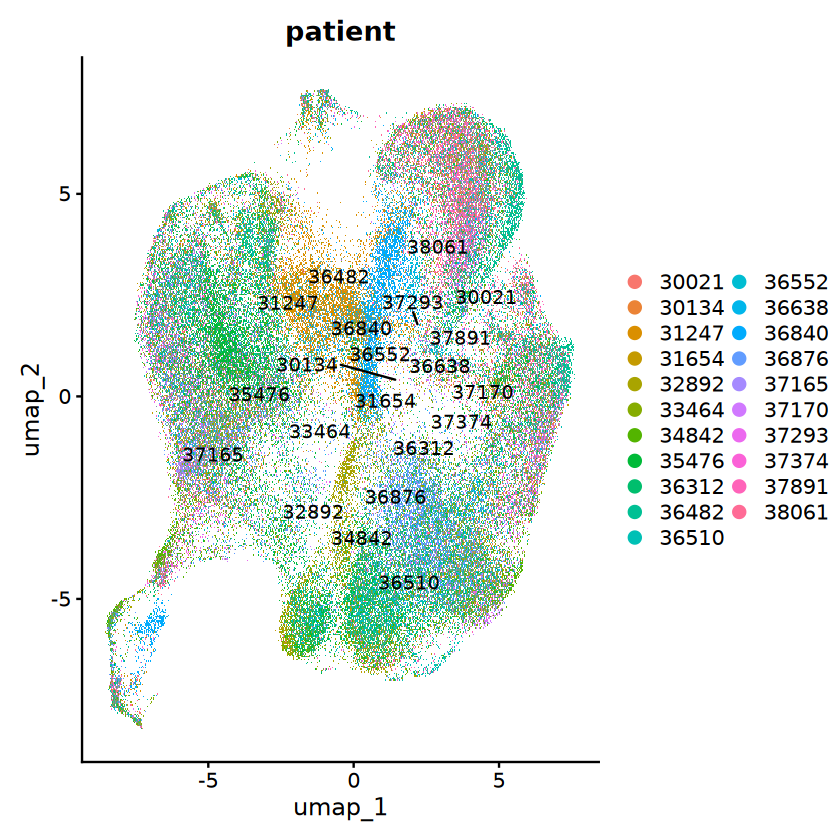

In [14]:
DimPlot(bcells, reduction = "umap", group.by = "RNA_snn_res.0.8", label = TRUE, repel = TRUE)
DimPlot(bcells, reduction = "umap", group.by = "RNA_snn_res.0.6", label = TRUE, repel = TRUE)
DimPlot(bcells, reduction = "umap", group.by = "RNA_snn_res.0.4", label = TRUE, repel = TRUE)
DimPlot(bcells, reduction = "umap", group.by = "patient", label = TRUE, repel = TRUE)

DimPlot(tcells, reduction = "umap", group.by = "RNA_snn_res.1.4", label = TRUE, repel = TRUE, raster = TRUE)
DimPlot(tcells, reduction = "umap", group.by = "RNA_snn_res.1.2", label = TRUE, repel = TRUE, raster = TRUE)
DimPlot(tcells, reduction = "umap", group.by = "RNA_snn_res.0.8", label = TRUE, repel = TRUE, raster = TRUE)
DimPlot(tcells, reduction = "umap", group.by = "patient", label = TRUE, repel = TRUE, raster = TRUE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



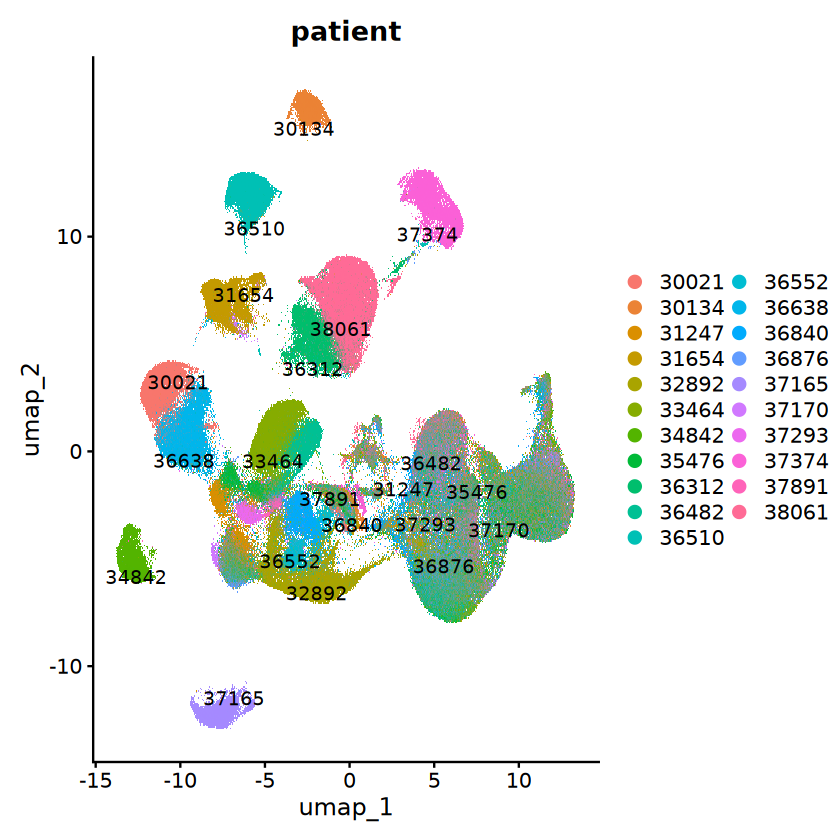

In [16]:
p2 <- DimPlot(subsetted_obj, reduction = "umap", group.by = "patient", label = TRUE, repel = TRUE)
p2

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



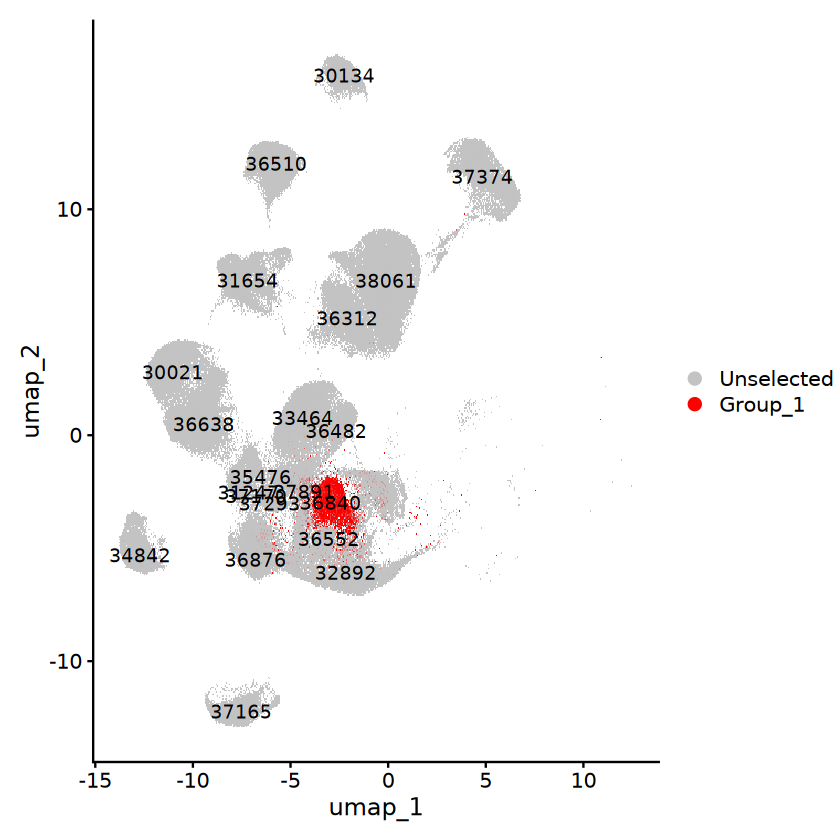

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



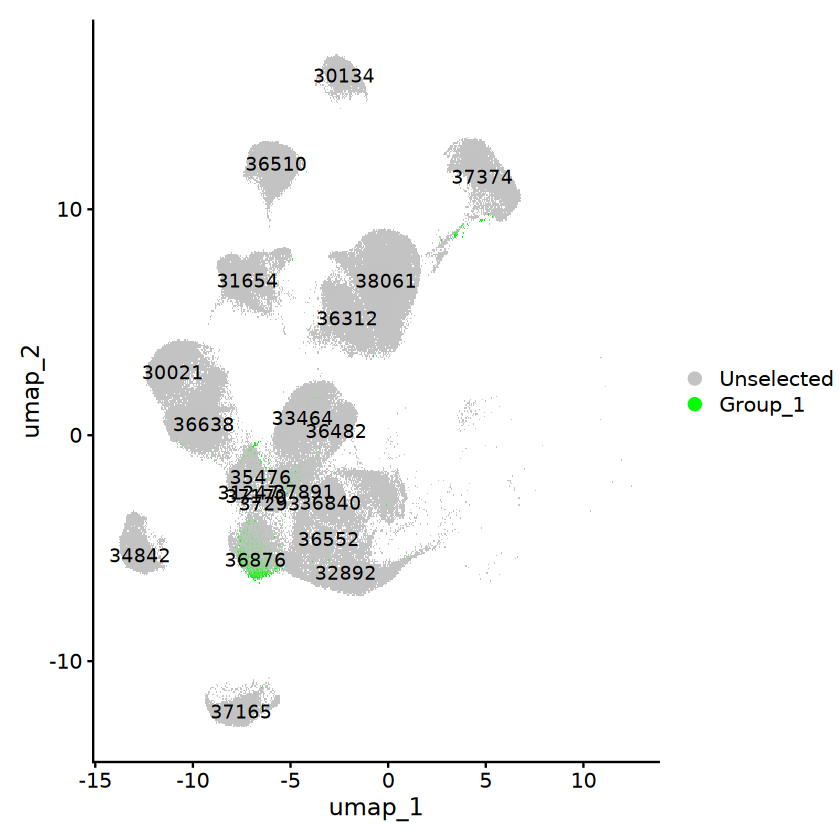

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



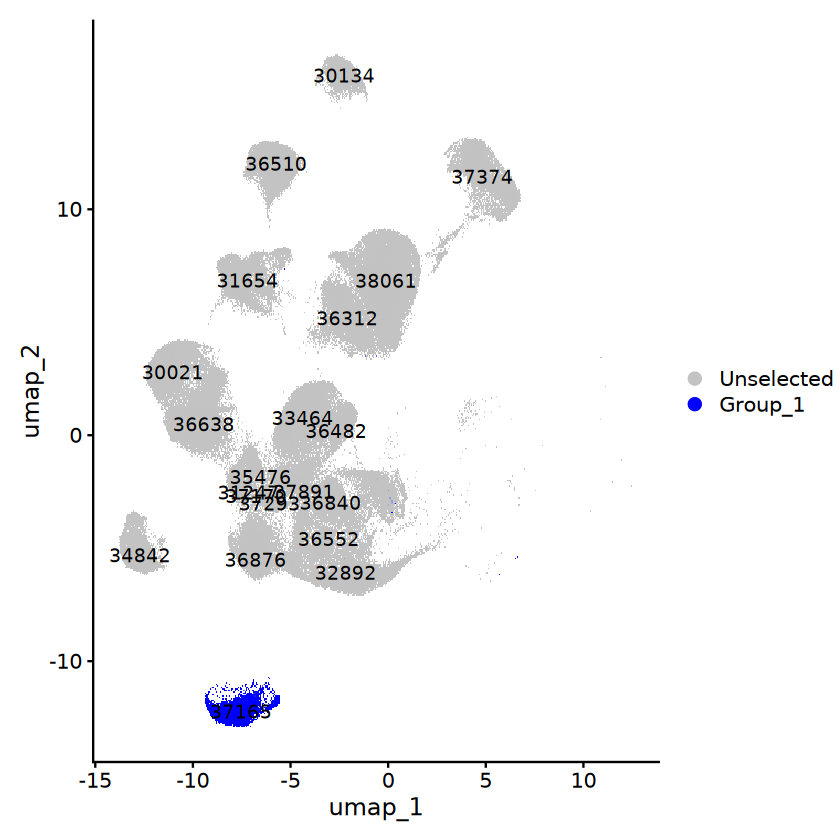

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



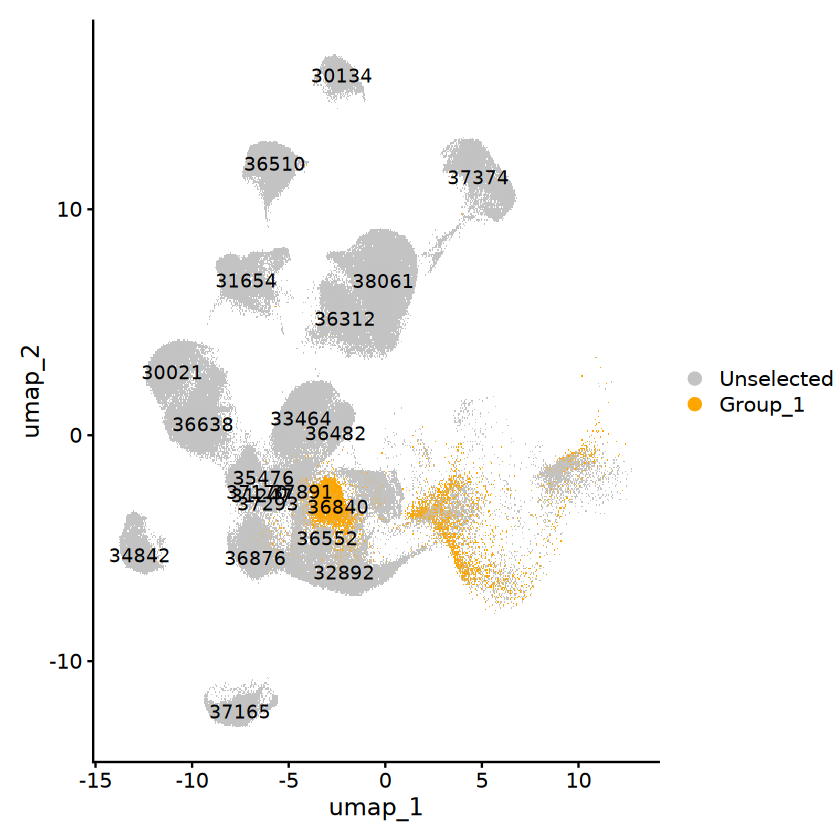

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



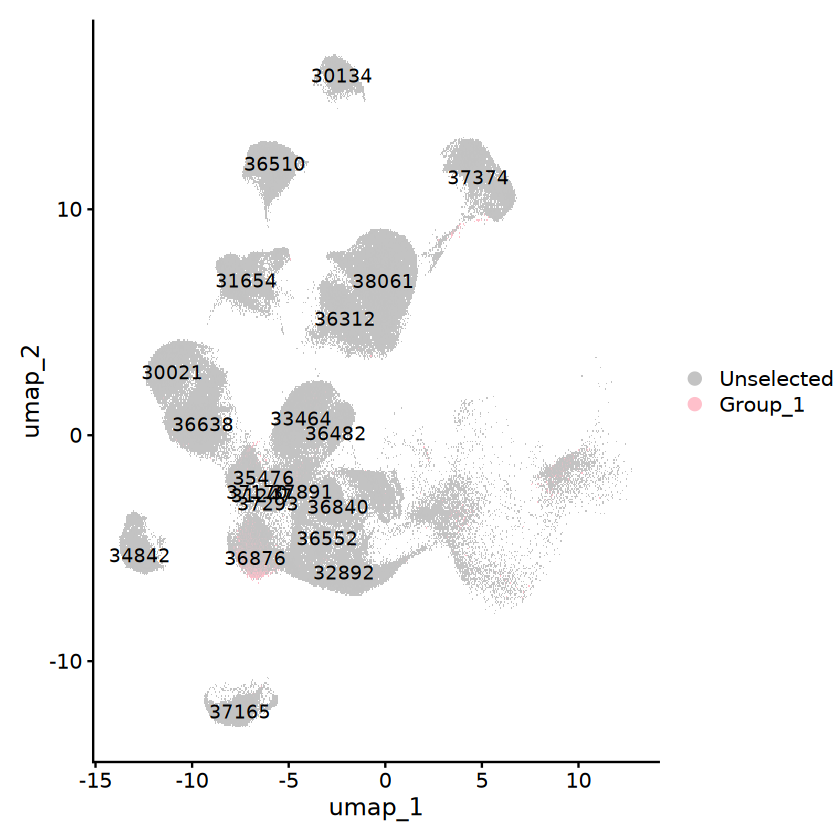

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



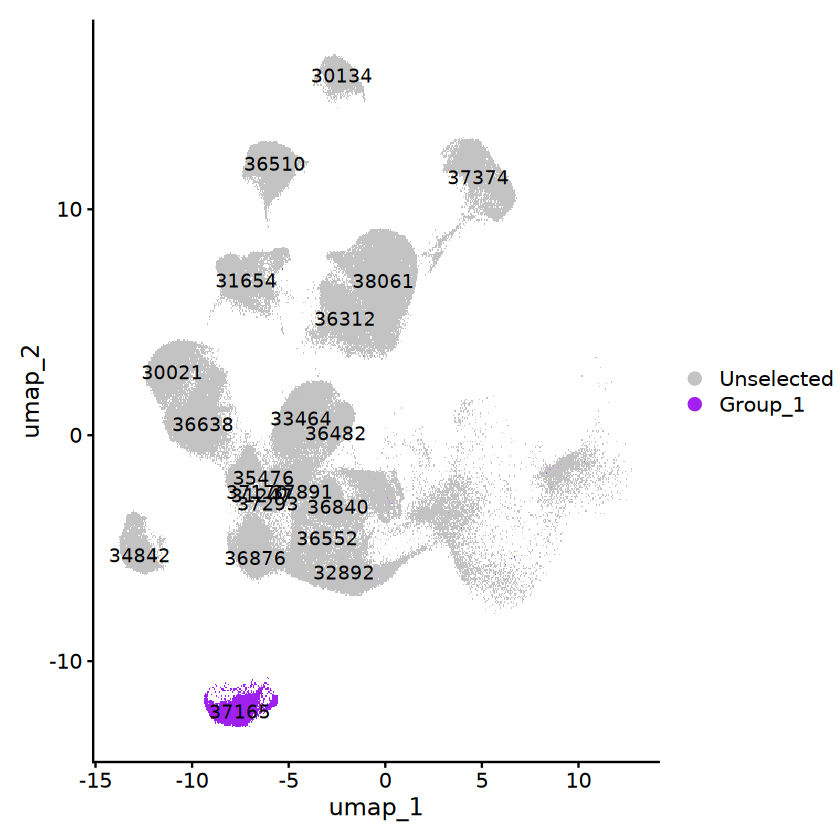

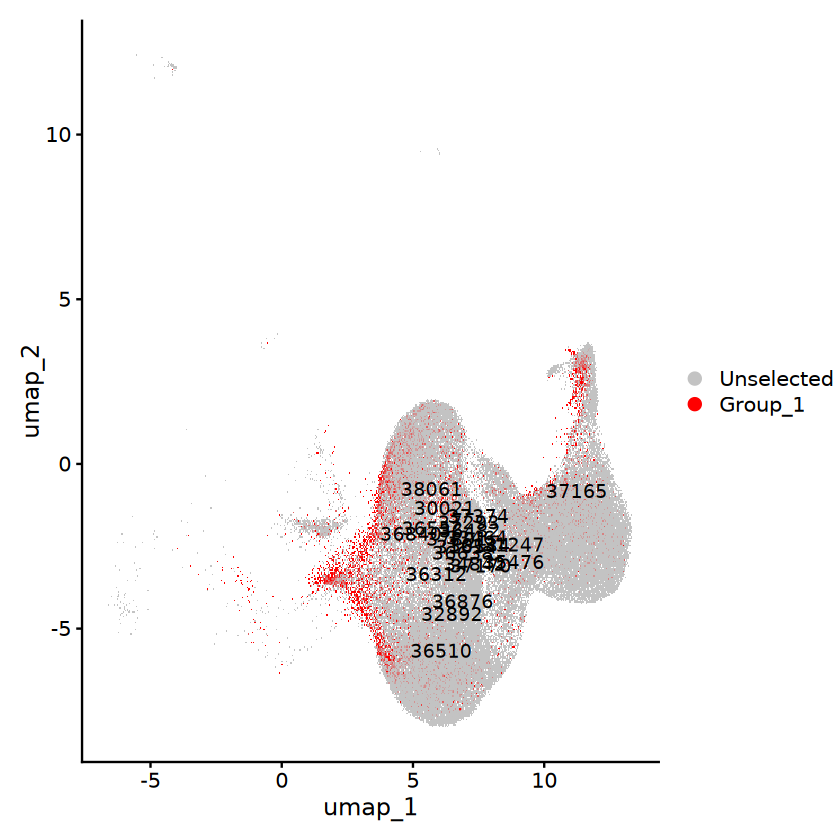

In [13]:
bcells$patient <- as.factor(bcells$patient)
bcells@active.ident <- bcells$patient

test.bcells$patient <- as.factor(test.bcells$patient)
test.bcells@active.ident <- test.bcells$patient

tcells$patient <- as.factor(tcells$patient)
tcells@active.ident <- tcells$patient

Test.cells <-  WhichCells(bcells, ident = 36840)
Test <- DimPlot(bcells, reduction = "umap", label = TRUE, cells.highlight = Test.cells, cols.highlight = "red")
Test

Test.cells <-  WhichCells(bcells, ident = 36876)
Test <- DimPlot(bcells, reduction = "umap", label = TRUE, cells.highlight = Test.cells, cols.highlight = "green")
Test

Test.cells <-  WhichCells(bcells, ident = 37165)
Test <- DimPlot(bcells, reduction = "umap", label = TRUE, cells.highlight = Test.cells, cols.highlight = "blue")
Test

Test.cells <-  WhichCells(test.bcells, ident = 36840)
Test <- DimPlot(test.bcells, reduction = "umap", label = TRUE, cells.highlight = Test.cells, cols.highlight = "orange")
Test

Test.cells <-  WhichCells(test.bcells, ident = 36876)
Test <- DimPlot(test.bcells, reduction = "umap", label = TRUE, cells.highlight = Test.cells, cols.highlight = "pink")
Test

Test.cells <-  WhichCells(test.bcells, ident = 37165)
Test <- DimPlot(test.bcells, reduction = "umap", label = TRUE, cells.highlight = Test.cells, cols.highlight = "purple")
Test

Test.cells <-  WhichCells(tcells, ident = 36840)
Test <- DimPlot(tcells, reduction = "umap", label = TRUE, cells.highlight = Test.cells, cols.highlight = "red")
Test

#tcells$patient <- as.factor(tcells$patient)
#bcells@active.ident <- tcells$patient

#Test.cells <-  WhichCells(tcells, ident = 36840)
#Test <- DimPlot(tcells, reduction = "umap", label = TRUE, cells.highlight = Test.cells, cols.highlight = "red")
#Test

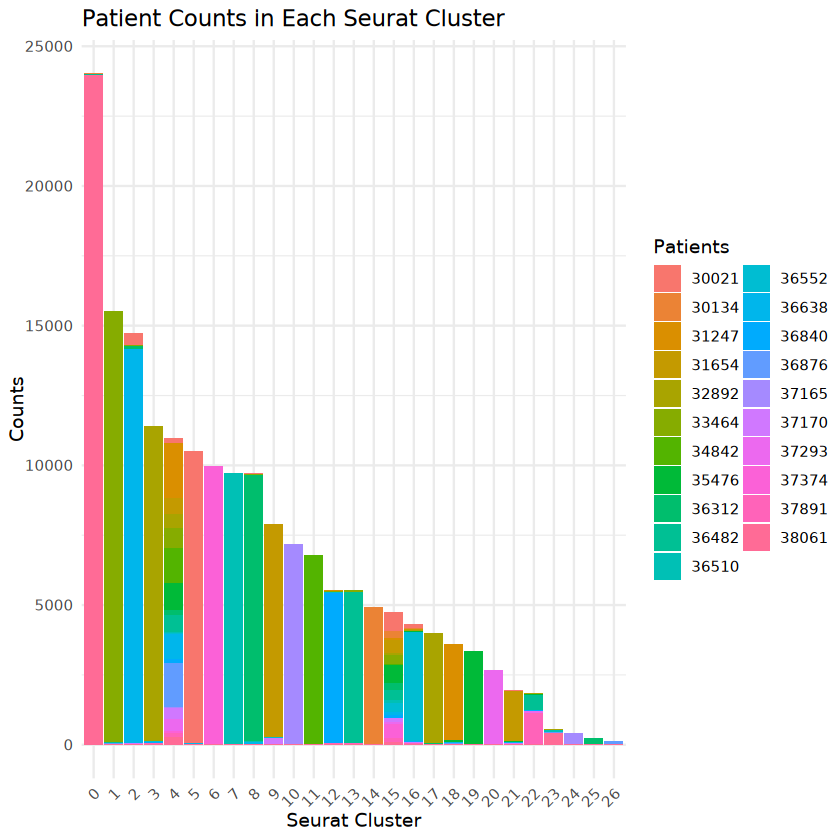

In [6]:
bcells@active.ident <- as.factor(bcells$`RNA_snn_res.0.4`)
data <- as.data.frame(table(Idents(bcells), bcells$patient))

# Rename columns for clarity
colnames(data) <- c("Cluster", "Patient", "Count")

ggplot(data, aes(x = Cluster, y = Count, fill = factor(Patient))) +
  geom_bar(stat = "identity") +
  labs(title = "Patient Counts in Each Seurat Cluster",
       x = "Seurat Cluster", y = "Counts", fill = "Patients") +
  theme_minimal() +
  theme(axis.text.x = element_text(angle = 45, hjust = 1))

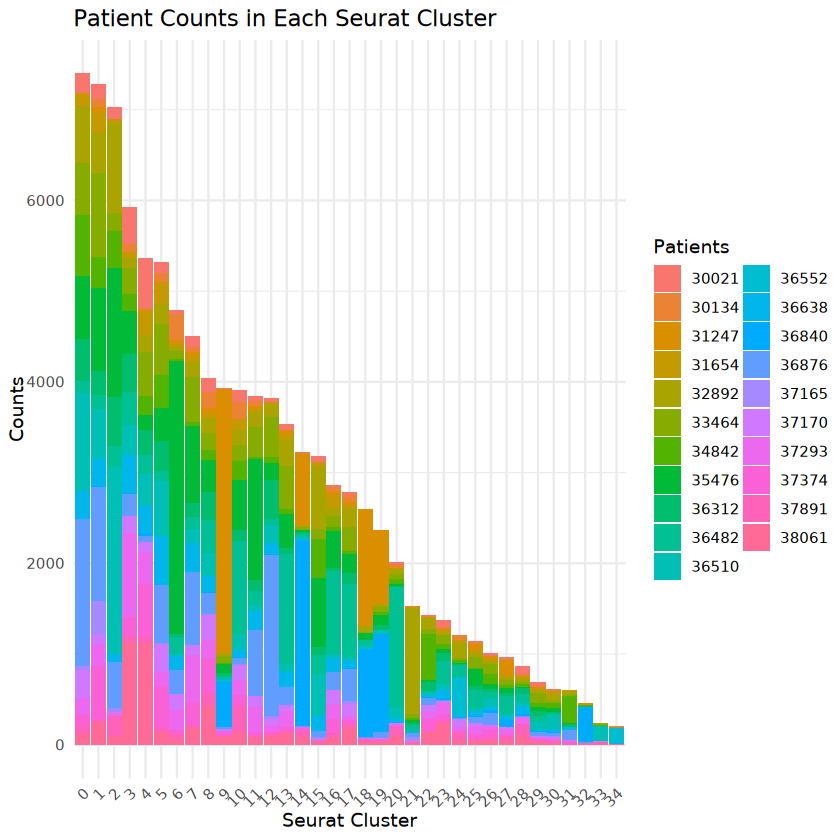

In [20]:
tcells@active.ident <- as.factor(tcells$`RNA_snn_res.1.8`)
data <- as.data.frame(table(Idents(tcells), tcells$patient))

# Rename columns for clarity
colnames(data) <- c("Cluster", "Patient", "Count")

ggplot(data, aes(x = Cluster, y = Count, fill = factor(Patient))) +
  geom_bar(stat = "identity") +
  labs(title = "Patient Counts in Each Seurat Cluster",
       x = "Seurat Cluster", y = "Counts", fill = "Patients") +
  theme_minimal() +
  theme(axis.text.x = element_text(angle = 45, hjust = 1))

[1] "0"  "1"  "2"  "3"  "4"  "5"  "6"  "7"  "8"  "9"  "10" "11" "12" "13" "14"
[16] "15" "16" "17" "18" "19" "20" "21" "22" "23" "24" "25" "26" "27" "28" "29"
[31] "30" "31" "32" "33"

[1] "Tcell"        "Tumor Bcell"  "Normal Bcell" "Prolif Bcell" "Myeloid"     
[6] "NK"           "Prolif Tcell" "Plasma"

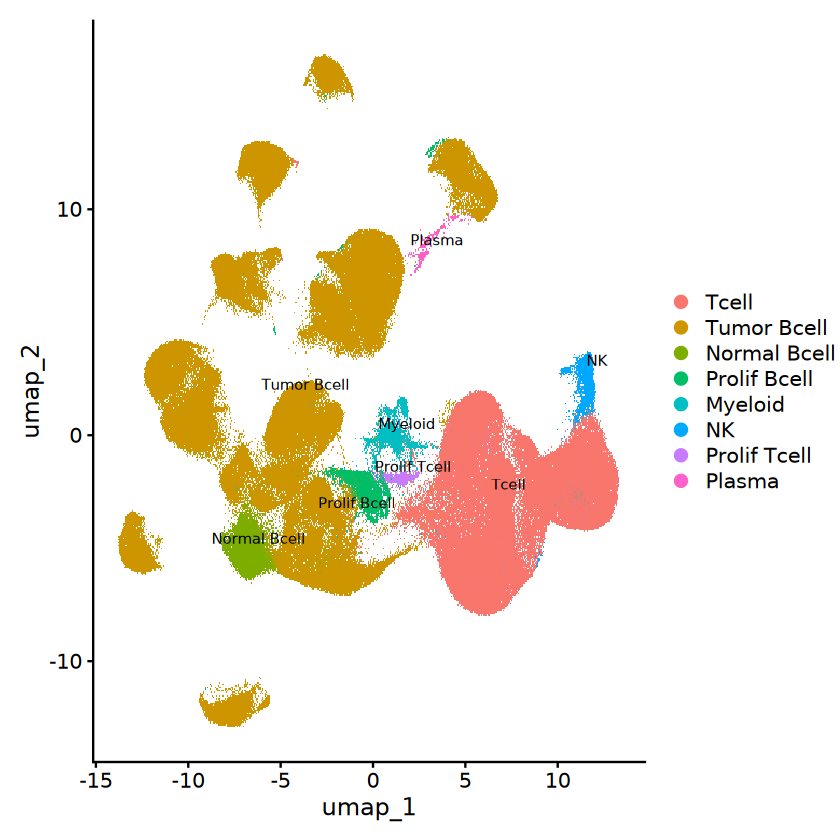

[1] Tcell        Tumor Bcell  Prolif Bcell Myeloid      NK          
[6] Normal Bcell Prolif Tcell Plasma      
8 Levels: Tcell Tumor Bcell Normal Bcell Prolif Bcell Myeloid ... Plasma

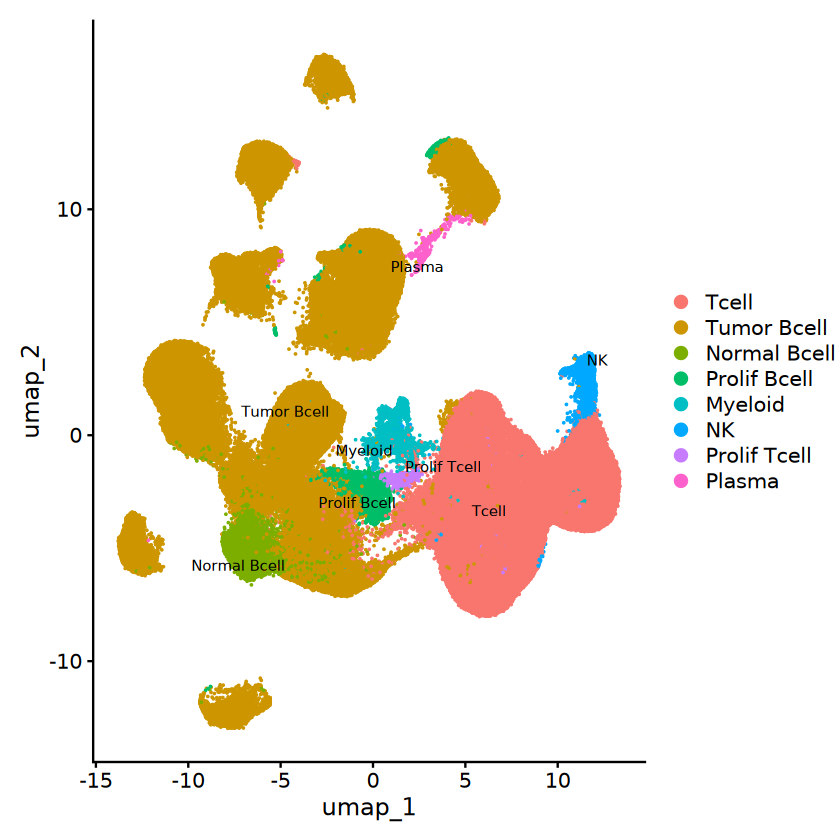

In [15]:
# Rename cell identity classes for res 1.9
subsetted_obj@active.ident <- as.factor(subsetted_obj$`RNA_snn_res.0.8`)
# Can provide an arbitrary amount of idents to rename
levels(subsetted_obj)
#> [1] "0" "1" "2"
subsetted_obj <- RenameIdents(
  subsetted_obj,
  '0' = 'Tcell',
  '1' = 'Tcell',
  '2' = 'Tumor Bcell',
  '3' = 'Tcell', 
  '4' = 'Tumor Bcell', 
  '5' = 'Tumor Bcell', 
  '6' = 'Tcell', 
  '7' = 'Tumor Bcell', 
  '8' = 'Normal Bcell', 
  '9' = 'Tumor Bcell', 
  '10' = 'Tumor Bcell',
  '11' = 'Tumor Bcell', 
  '12' = 'Tcell', 
  '13' = 'Tumor Bcell',
  '14' = 'Tcell',
  '15' = 'Tumor Bcell', 
  '16' = 'Tumor Bcell', 
  '17' = 'Tumor Bcell',
  '18' = 'Tumor Bcell', 
  '19' = 'Prolif Bcell', 
  '20' = 'Tumor Bcell', 
  '21' = 'Tumor Bcell', 
  '22' = 'Tumor Bcell',
  '23' = 'Tumor Bcell', 
  '24' = 'Tumor Bcell', 
  '25' = 'Tumor Bcell', 
  '26' = 'Myeloid', 
  '27' = 'NK',
  '28' = 'Tumor Bcell',
  '29' = 'Tumor Bcell', 
  '30' = 'Prolif Tcell', 
  '31' = 'Myeloid', 
  '32' = 'Plasma', 
  '33' = 'Tumor Bcell'
)
levels(subsetted_obj)
DimPlot(subsetted_obj, reduction = "umap", label = TRUE, label.size = 3 ,repel = TRUE, raster = TRUE)
DimPlot(subsetted_obj, reduction = "umap", label = TRUE, label.size = 3 ,repel = TRUE, raster = FALSE)

subsetted_obj$new.ident <- subsetted_obj@active.ident 
unique(subsetted_obj$new.ident)


In [21]:
subsetted_obj@active.ident <- subsetted_obj$`RNA_snn_res.0.6`
#markers in cluster 3 that seperate it from cluster 0
clustertest <- FindMarkers(object = subsetted_obj, ident.1 = '5', ident.2 = '20')
head(x = clustertest)


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
MALAT1,0,3.585689,0.992,0.219,0
CD69,0,4.231775,0.713,0.076,0
SARAF,0,2.646760,0.812,0.184,0
DUSP1,0,5.079471,0.662,0.037,0
CXCR4,0,3.953749,0.669,0.067,0
FOS,0,5.089629,0.622,0.042,0


ERROR: Error in top(clustertest): could not find function "top"


In [23]:
clustertest
write.csv(clustertest, file = "Comparing Normal Bcells.csv")

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
MALAT1,0,3.585689,0.992,0.219,0
CD69,0,4.231775,0.713,0.076,0
SARAF,0,2.646760,0.812,0.184,0
DUSP1,0,5.079471,0.662,0.037,0
CXCR4,0,3.953749,0.669,0.067,0
FOS,0,5.089629,0.622,0.042,0
FCMR,0,3.434208,0.686,0.111,0
JUN,0,5.128353,0.599,0.037,0
JUNB,0,3.353318,0.731,0.178,0


Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



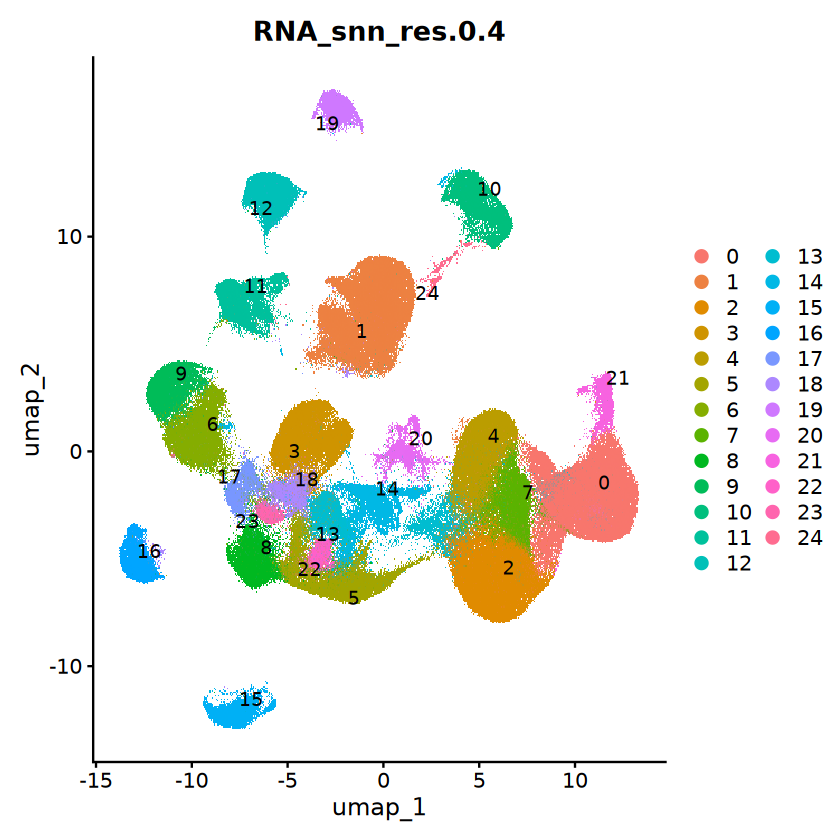

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



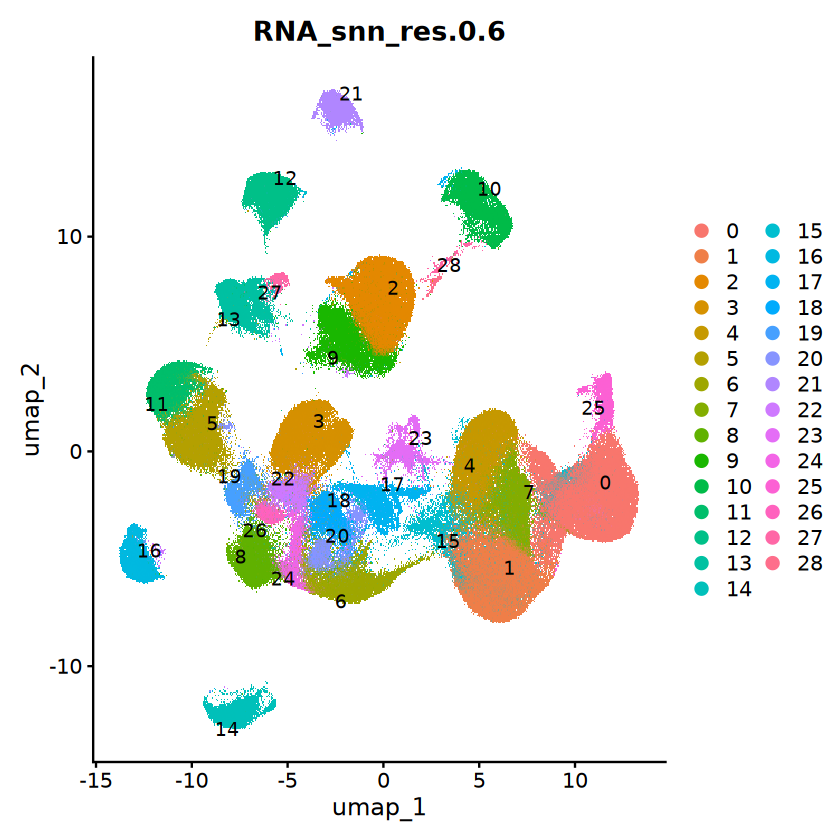

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



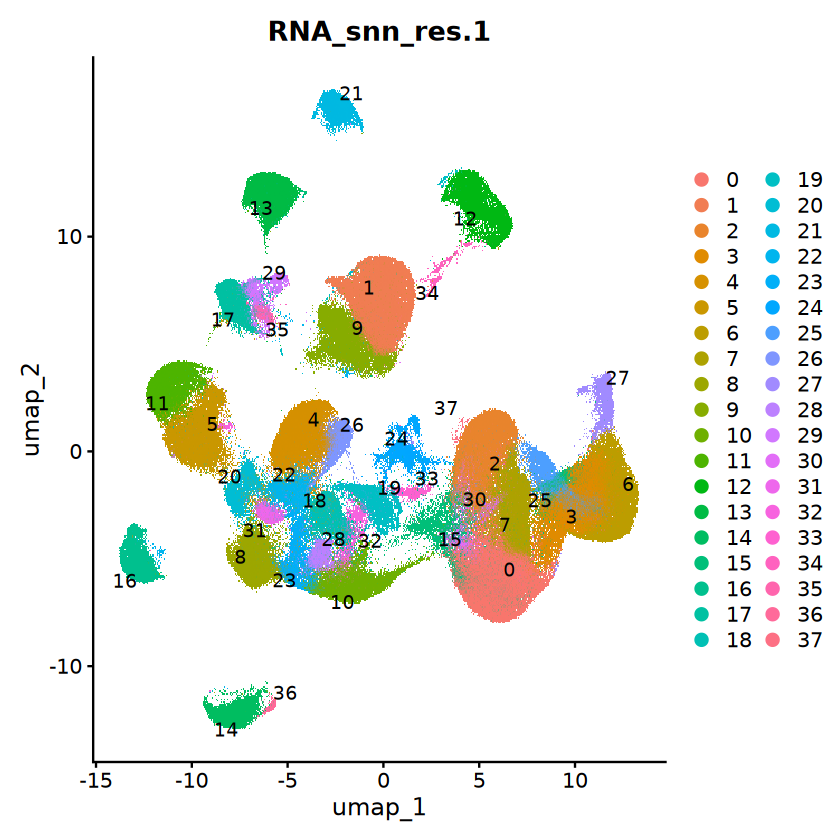

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



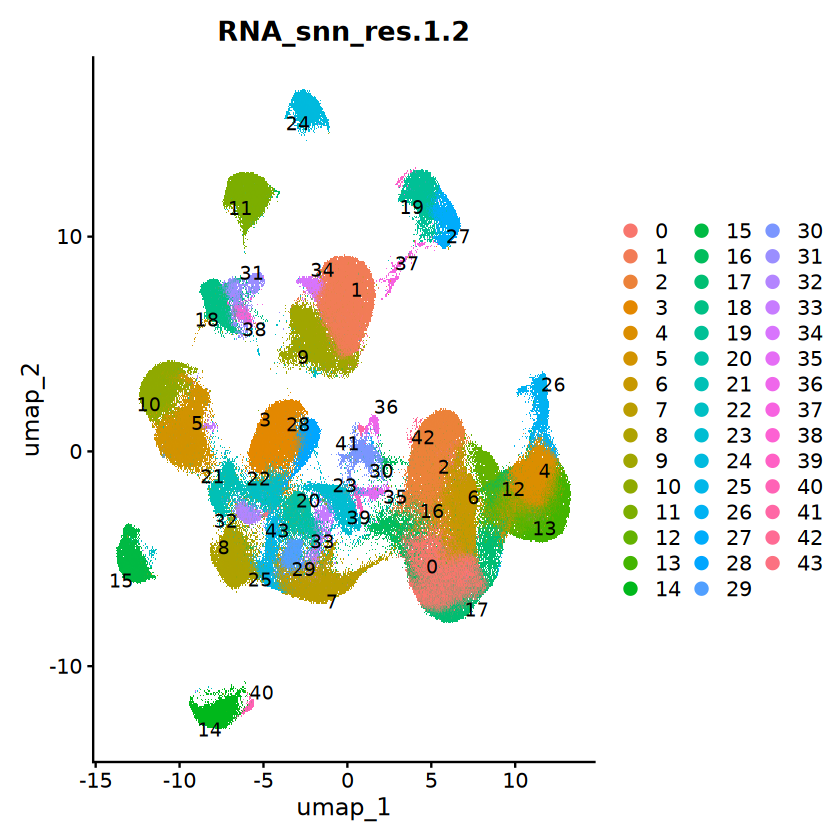

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



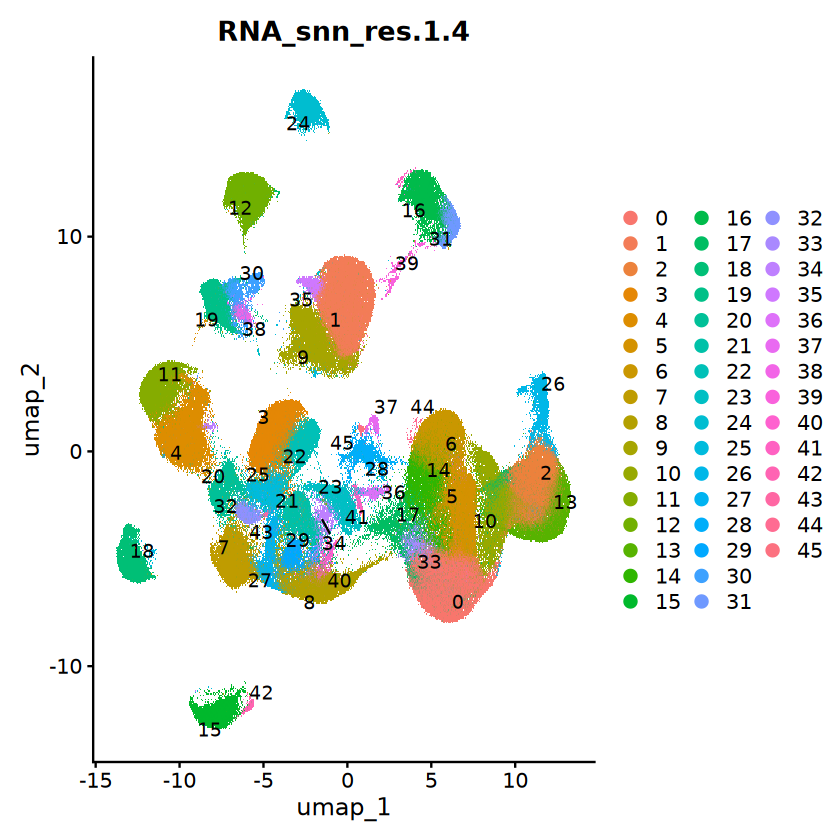

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



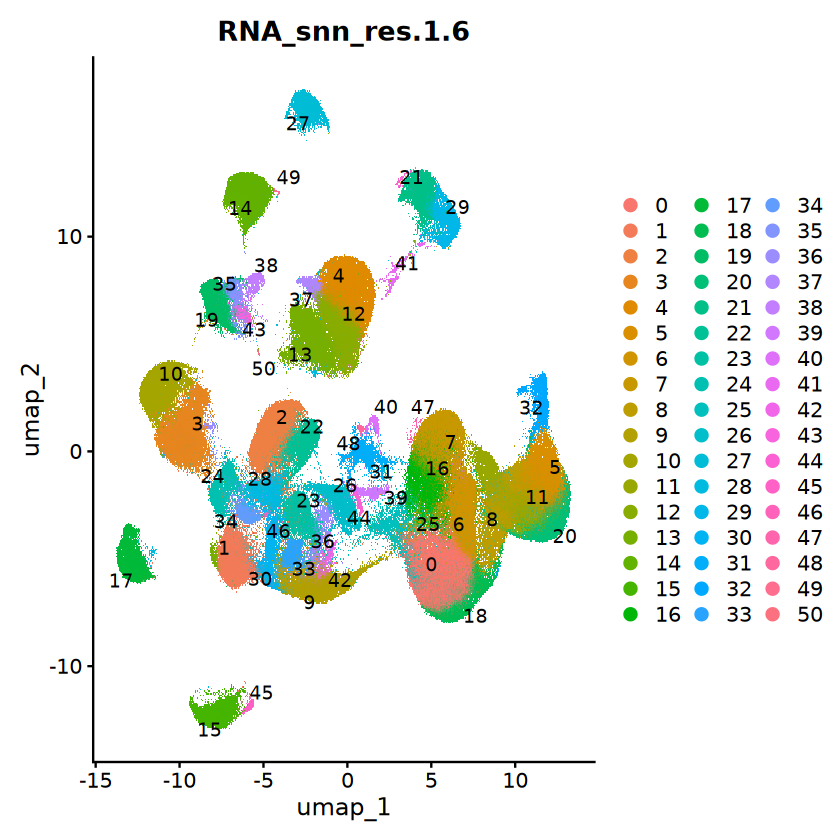

In [8]:
DimPlot(subsetted_obj, reduction = "umap", group.by = "RNA_snn_res.0.4", label = TRUE, repel = TRUE)
DimPlot(subsetted_obj, reduction = "umap", group.by = "RNA_snn_res.0.6", label = TRUE, repel = TRUE)
p1 <- DimPlot(subsetted_obj, reduction = "umap", group.by = "RNA_snn_res.0.8", label = TRUE, repel = TRUE)
DimPlot(subsetted_obj, reduction = "umap", group.by = "RNA_snn_res.1", label = TRUE, repel = TRUE)
DimPlot(subsetted_obj, reduction = "umap", group.by = "RNA_snn_res.1.2", label = TRUE, repel = TRUE)
DimPlot(subsetted_obj, reduction = "umap", group.by = "RNA_snn_res.1.4", label = TRUE, repel = TRUE)
DimPlot(subsetted_obj, reduction = "umap", group.by = "RNA_snn_res.1.6", label = TRUE, repel = TRUE)

p2 <- DimPlot(subsetted_obj, reduction = "umap", group.by = "patient", label = TRUE, repel = TRUE)
#saveRDS(Merged_patients, file = "Merged_patients.RDS")

In [9]:
subsetted_obj@active.ident <- subsetted_obj$`RNA_snn_res.0.8`
data <- as.data.frame(table(Idents(subsetted_obj), subsetted_obj$patient))

# Rename columns for clarity
colnames(data) <- c("Cluster", "Patient", "Count")

p3 <- ggplot(data, aes(x = Cluster, y = Count, fill = factor(Patient))) +
  geom_bar(stat = "identity") +
  labs(title = "Patient Counts in Each Seurat Cluster",
       x = "Seurat Cluster", y = "Counts", fill = "Patients") +
  theme_minimal() +
  theme(axis.text.x = element_text(angle = 45, hjust = 1))

In [16]:
library(patchwork)
options(repr.plot.width = 15, repr.plot.height = 10)
combined_plot <- p1 + p2 + p3
ggsave("combined_plot.png", combined_plot, width = 25, height = 6)

In [26]:
Merged_patients <- RunUMAP(Merged_patients, dims = 1:15)
Merged_patients <- FindNeighbors(Merged_patients, dims = 1:15)
#Merged_patients <- FindClusters(Merged_patients, resolution = c(0.6, 0.8, 0.9, 1.0, 1.1, 1.2, 1.3, 1.4, 1.5, 1.6, 1.7, 1.8, 1.9), dims = 1:16)
#Merged_patients <- FindClusters(Merged_patients, resolution = c(1.8, 1.6, 1.4, 1.2, 1.0, 0.8), dims = 1:15)
Merged_patients <- FindClusters(Merged_patients, resolution = c(1.6, 1.4, 1.2, 1.0, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4), dims = 1:15)
# Optional: Visualize the clusters using UMAP
#DimPlot(Merged_patients, reduction = "umap")

12:08:15 UMAP embedding parameters a = 0.9922 b = 1.112

12:08:15 Read 305921 rows and found 15 numeric columns

12:08:15 Using Annoy for neighbor search, n_neighbors = 30

12:08:15 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

12:08:51 Writing NN index file to temp file /tmp/RtmpBnVcVe/file60af2c787d6e

12:08:52 Searching Annoy index using 1 thread, search_k = 3000

12:10:49 Annoy recall = 100%

12:10:50 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

12:11:05 Initializing from normalized Laplacian + noise (using RSpectra)

12:12:05 Commencing optimization for 200 epochs, with 13438946 positive edges

12:18:08 Optimization finished

Computing nearest neighbor graph

Computing SNN

Warning message:
“The following arguments are

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 305921
Number of edges: 8717915

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9084
Number of communities: 51
Elapsed time: 179 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 305921
Number of edges: 8717915

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9141
Number of communities: 46
Elapsed time: 188 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 305921
Number of edges: 8717915

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9212
Number of communities: 41
Elapsed time: 174 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 305921
Number of edges: 8717915

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9287
Number of communities: 38
Elapsed time: 176 seco

In [17]:
saveRDS(subsetted_obj, file = "Merged_patients_sub.RDS")

In [7]:
library(Seurat)
library(ggplot2)
library(grid)
library(dplyr)
Merged_patients <- readRDS("/home/exacloud/gscratch/ShreeLab/FabianS/Jupyter/Merged_patients_sub.RDS")

In [7]:
Normal_bcells <-  WhichCells(bcells, ident = 'Normal Bcell')
Test <- DimPlot(subsetted_obj, reduction = "umap", label = TRUE, cells.highlight = Normal_bcells, cols.highlight = "red")
Test

Prolif_bcells <-  WhichCells(bcells, ident = 'Prolif Bcell')
Test <- DimPlot(subsetted_obj, reduction = "umap", label = TRUE, cells.highlight = Prolif_bcells, cols.highlight = "blue")
Test

bcells@active.ident <- as.factor(bcells$`RNA_snn_res.0.6`)
Unkown_bcells <-  WhichCells(bcells, ident = '22')
Test <- DimPlot(subsetted_obj, reduction = "umap", label = TRUE, cells.highlight = Unkown_bcells, cols.highlight = "green")
Test

ERROR: Error in WhichCells(bcells, ident = "Normal Bcell"): object 'bcells' not found


Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



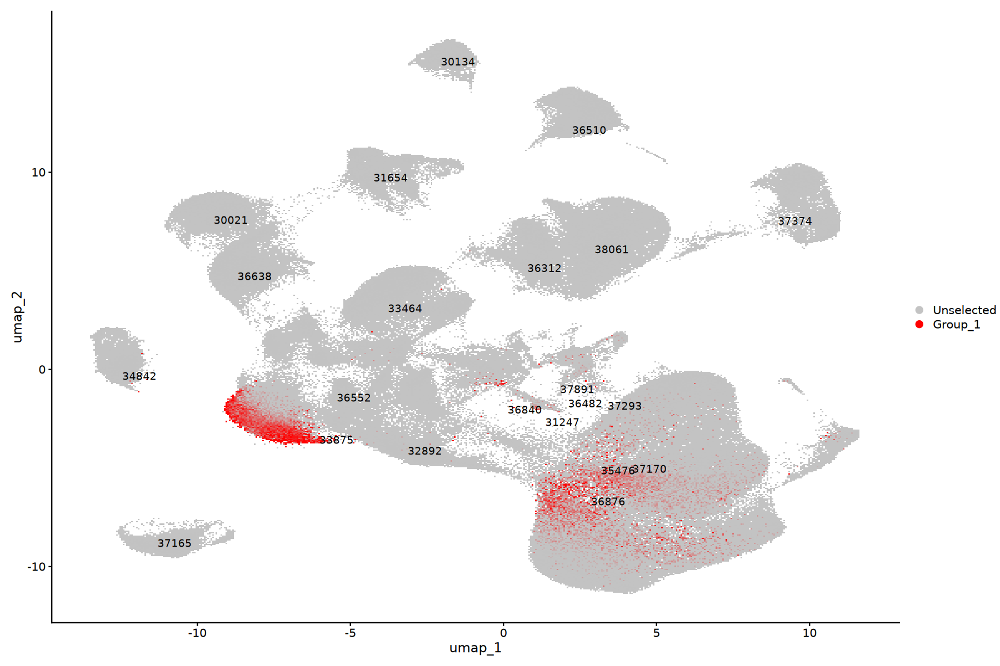

In [18]:
Merged_patients$patient <- as.factor(Merged_patients$patient)
Merged_patients@active.ident <- Merged_patients$patient

Test.cells <-  WhichCells(Merged_patients, ident = 33875)
Test <- DimPlot(Merged_patients, reduction = "umap", label = TRUE, cells.highlight = Test.cells, cols.highlight = "red")
Test

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



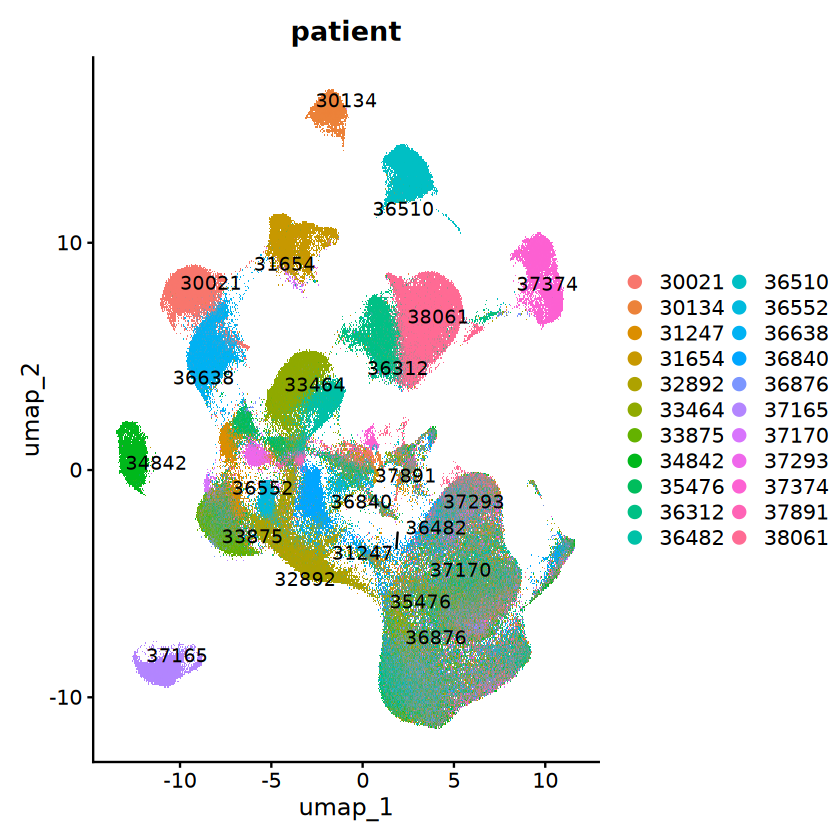

In [5]:
library(Seurat)
library(ggplot2)
library(grid)
library(dplyr)

Merged_patients@active.ident <- Merged_patients$`RNA_snn_res.0.6`
DimPlot(Merged_patients, reduction = "umap", group.by = "patient", label = TRUE, repel = TRUE)

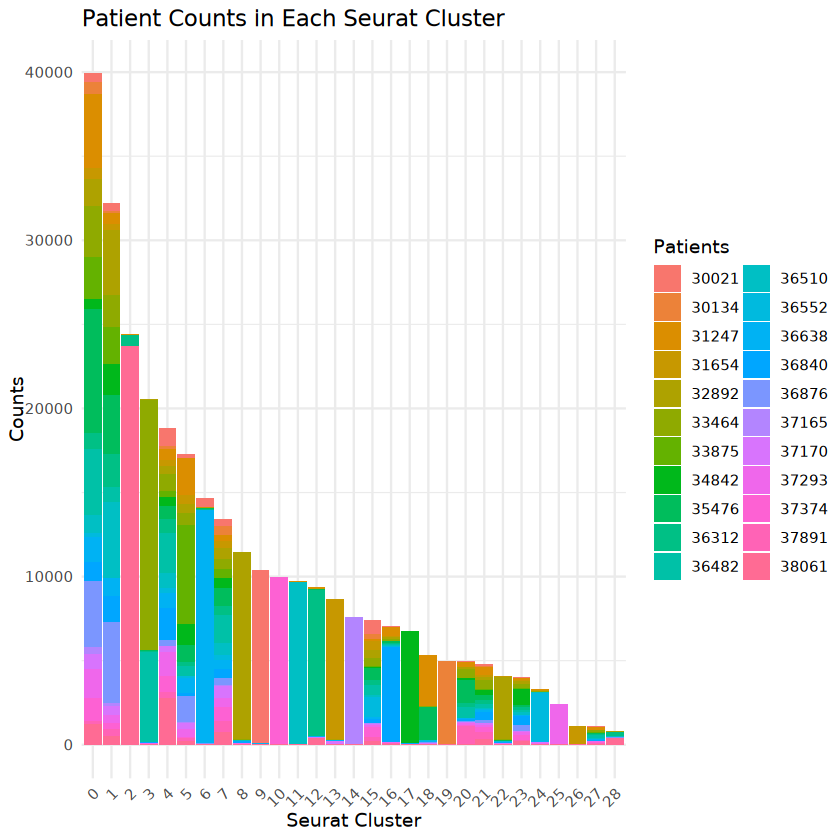

In [14]:
data <- as.data.frame(table(Idents(Merged_patients), Merged_patients$patient))

# Rename columns for clarity
colnames(data) <- c("Cluster", "Patient", "Count")

ggplot(data, aes(x = Cluster, y = Count, fill = factor(Patient))) +
  geom_bar(stat = "identity") +
  labs(title = "Patient Counts in Each Seurat Cluster",
       x = "Seurat Cluster", y = "Counts", fill = "Patients") +
  theme_minimal() +
  theme(axis.text.x = element_text(angle = 45, hjust = 1))

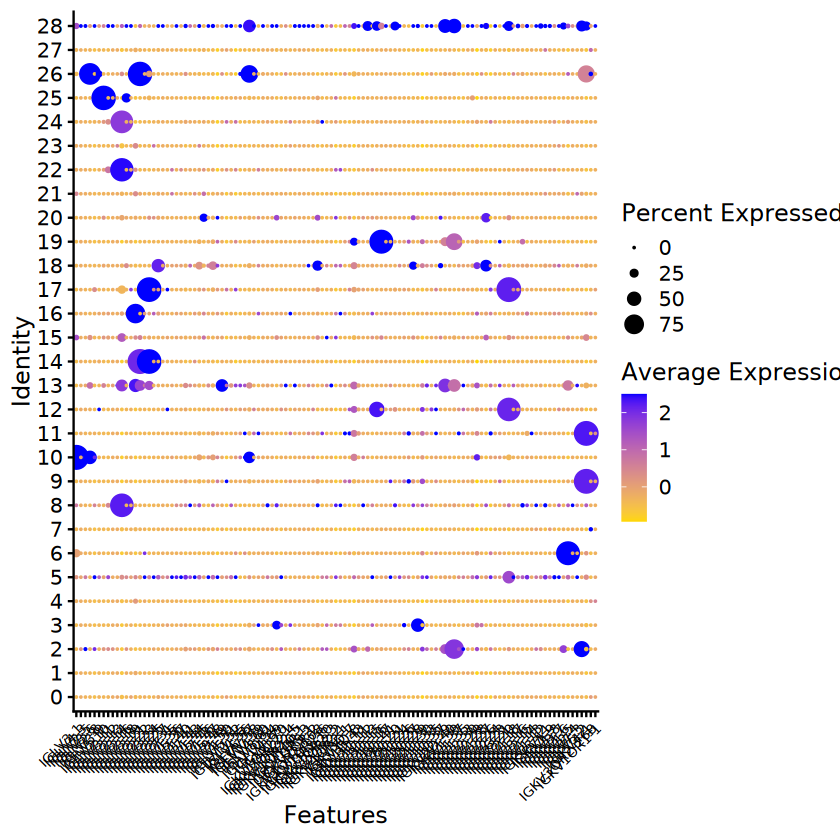

$LV.genes
  [1] "IGLV3-1"      "IGLV4-3"      "IGLV2-5"      "IGLV3-6"      "IGLV2-8"     
  [6] "IGLV3-9"      "IGLV3-10"     "IGLV2-11"     "IGLV3-12"     "IGLV3-13"    
 [11] "IGLV2-14"     "IGLV3-16"     "IGLV2-18"     "IGLV3-19"     "IGLV3-21"    
 [16] "IGLV3-22"     "IGLV2-23"     "IGLV3-24"     "IGLV3-25"     "IGLV3-27"    
 [21] "IGLV3-31"     "IGLV7-35"     "IGLV1-36"     "IGLV5-37"     "IGLV1-40"    
 [26] "IGLV1-41"     "IGLV7-43"     "IGLV1-44"     "IGLV5-45"     "IGLV7-46"    
 [31] "IGLV1-47"     "IGLV5-48"     "IGLV9-49"     "IGLV1-50"     "IGLV1-51"    
 [36] "IGLV5-52"     "IGLV11-55"    "IGLVI-56"     "IGLV6-57"     "IGLVV-58"    
 [41] "IGLVIV-59"    "IGLV4-60"     "IGLV8-61"     "IGLV10-54"    "IGLV4-69"    
 [46] "IGLVI-70"     "IGKV1OR22-1"  "IGKV2OR22-4"  "IGKV1OR22-5"  "IGKV1OR10-1" 
 [51] "IGKV1OR-3"    "IGKV1OR9-1"   "IGKV1OR-2"    "IGKV1OR2-108" "IGKV1OR2-6"  
 [56] "IGKV2OR2-10"  "IGKV1OR2-3"   "IGKV2OR2-2"   "IGKV2OR2-1"   "IGKV1OR2-1"  
 [61] "IGKV3D-7"  

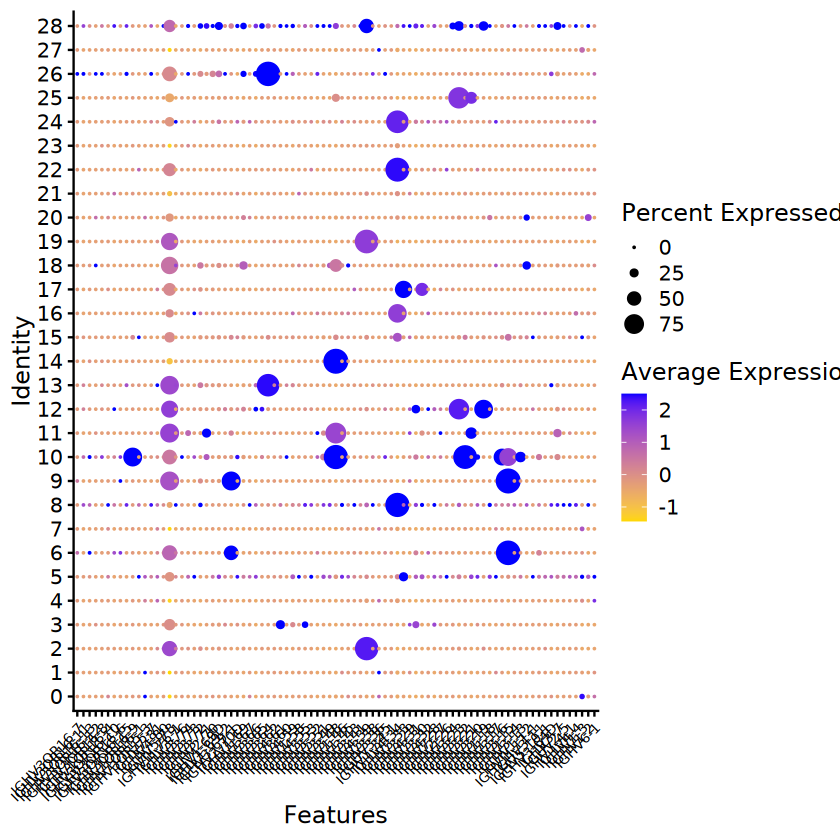

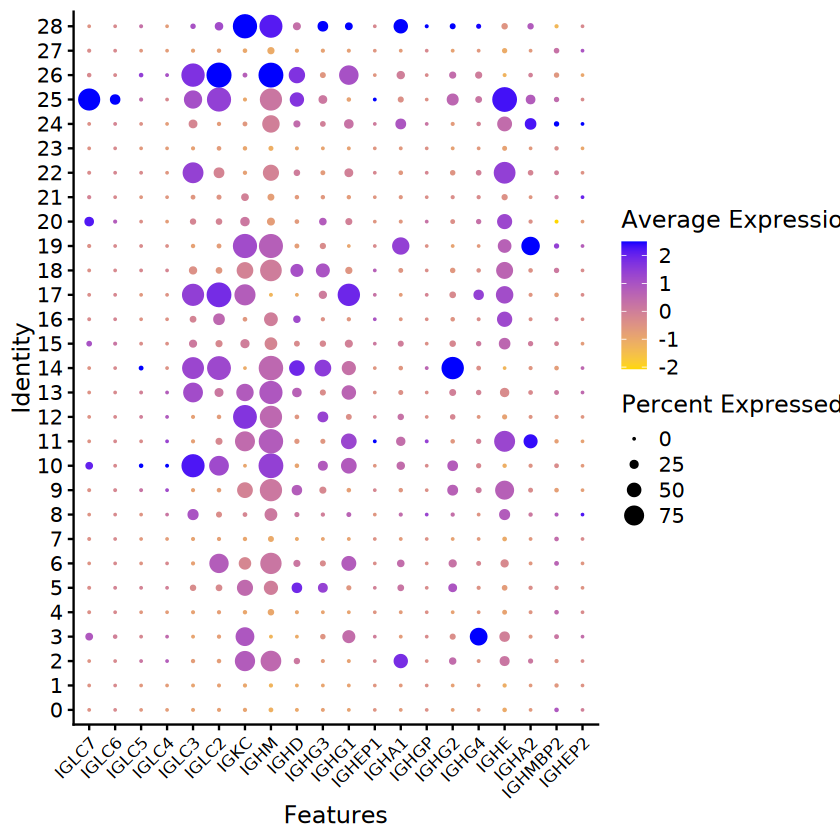

In [9]:
Ig_plots <- function(obj) {
  #obj <- subset(obj, idents = setdiff(Idents(obj), 'Prolif Bcell'))

  LV.genes <- rev(grep(pattern = "^IG[KL]V", rownames(obj), value = TRUE))
  LC.genes <- rev(grep(pattern = "^IG[KL]C", rownames(obj), value = TRUE))
  HV.genes <- rev(grep(pattern = "^IGHV", rownames(obj), value = TRUE))
  HC.genes <- rev(grep(pattern = "^IGH[ADEGM]", rownames(obj), value = TRUE))
  C.genes <- c(LC.genes, HC.genes)
  #C.genes <- C.genes[-grep("-", C.genes)]

  #obj$group_patient <- paste(Idents(obj), obj$patient, sep = "_")

# Use the new variable for grouping in the DotPlot
  LV.plot <- DotPlot(obj, features = LV.genes, cols = c("gold", "blue")) + RotatedAxis() +
  theme(axis.text.x = element_text(size = 8))

  HV.plot <- DotPlot(obj, features = c(HV.genes), cols = c("gold", "blue")) + RotatedAxis() +
    theme(axis.text.x = element_text(size = 8))

  C.plot <- DotPlot(obj, features = c(C.genes), cols = c("gold", "blue")) + RotatedAxis() +
    theme(axis.text.x = element_text(size = 10))

  ggsave("LV_plot.jpeg", plot = LV.plot, width = 30, height = 12, units = "in", dpi = 350, limitsize = FALSE) # 72 dpi for points to inches conversion
  ggsave("HV_plot.jpeg", plot = HV.plot, width = 30, height = 12, units = "in", dpi = 350, limitsize = FALSE) # 72 dpi for points to inches conversion
  ggsave("C_plot.jpeg", plot = C.plot, width = 20, height = 12, units = "in", dpi = 350, limitsize = FALSE) # 72 dpi for points to inches conversion

  return(list(LV.genes = LV.genes, HV.genes = HV.genes, C.genes = C.genes, 
              LV.plot = LV.plot, HV.plot = HV.plot, C.plot = C.plot))
}
Ig_plots(Merged_patients)

[1] "0"  "1"  "2"  "3"  "4"  "5"  "6"  "7"  "8"  "9"  "10" "11" "12" "13" "14"
[16] "15" "16" "17" "18" "19" "20" "21" "22" "23" "24" "25" "26" "27" "28"

[1] "Tcell"        "Tumor Bcell"  "Normal Bcell" "Prolif Bcell" "Myeloid"     
[6] "NK"           "Prolif Tcell" "Plasma"

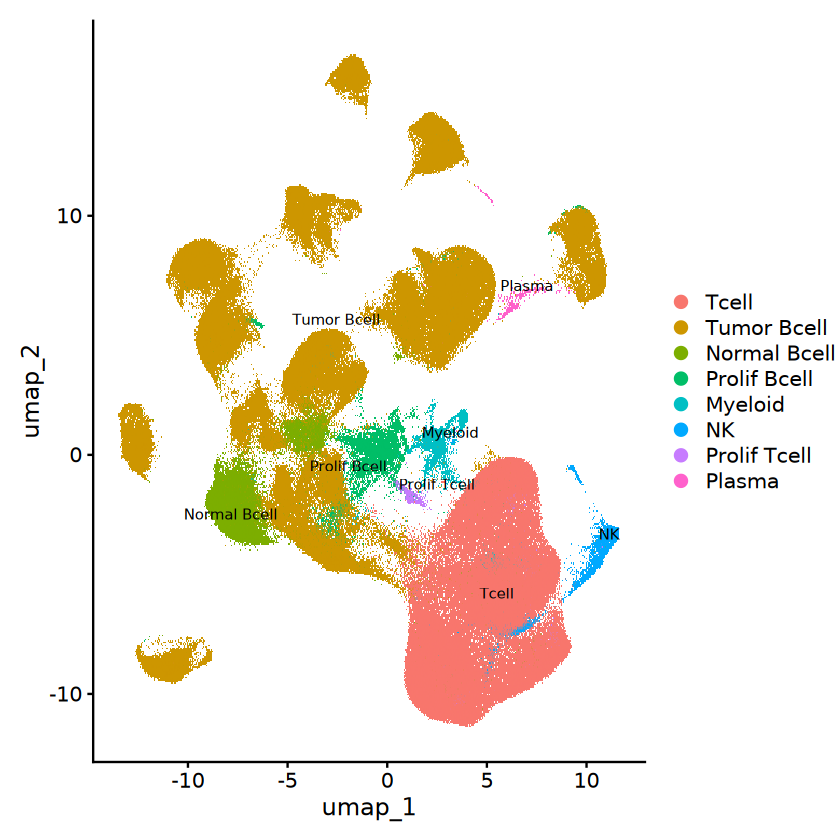

[1] Tcell        Tumor Bcell  Prolif Bcell Myeloid      NK          
[6] Normal Bcell Prolif Tcell Plasma      
8 Levels: Tcell Tumor Bcell Normal Bcell Prolif Bcell Myeloid ... Plasma

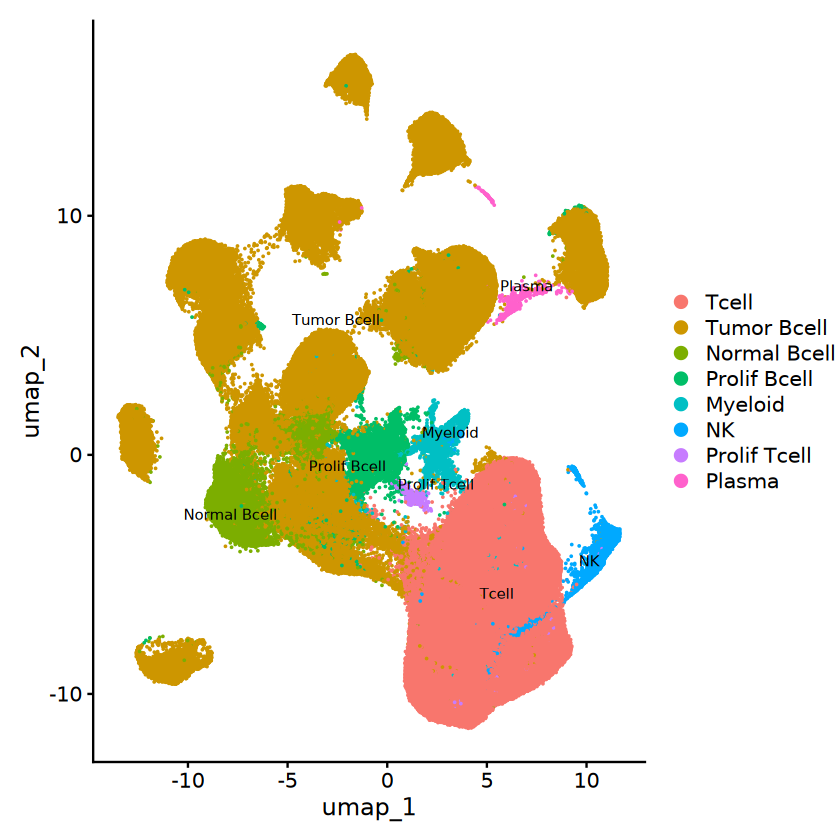

In [4]:
# Rename cell identity classes for res 1.9
Merged_patients@active.ident <- as.factor(Merged_patients$`RNA_snn_res.0.6`)
# Can provide an arbitrary amount of idents to rename
levels(Merged_patients)
#> [1] "0" "1" "2"
Merged_patients <- RenameIdents(
  Merged_patients,
  '0' = 'Tcell',
  '1' = 'Tcell',
  '2' = 'Tumor Bcell',
  '3' = 'Tumor Bcell', 
  '4' = 'Tcell', 
  '5' = 'Normal Bcell', 
  '6' = 'Tumor Bcell', 
  '7' = 'Tcell', 
  '8' = 'Tumor Bcell', 
  '9' = 'Tumor Bcell', 
  '10' = 'Tumor Bcell',
  '11' = 'Tumor Bcell', 
  '12' = 'Tumor Bcell', 
  '13' = 'Tumor Bcell',
  '14' = 'Tumor Bcell',
  '15' = 'Prolif Bcell', 
  '16' = 'Tumor Bcell', 
  '17' = 'Tumor Bcell',
  '18' = 'Tumor Bcell', 
  '19' = 'Tumor Bcell', 
  '20' = 'Normal Bcell', 
  '21' = 'Myeloid', 
  '22' = 'Tumor Bcell',
  '23' = 'NK', 
  '24' = 'Tumor Bcell', 
  '25' = 'Tumor Bcell', 
  '26' = 'Tumor Bcell', 
  '27' = 'Prolif Tcell',
  '28' = 'Plasma'
)
levels(Merged_patients)
DimPlot(Merged_patients, reduction = "umap", label = TRUE, label.size = 3 ,repel = TRUE, raster = TRUE)
DimPlot(Merged_patients, reduction = "umap", label = TRUE, label.size = 3 ,repel = TRUE, raster = FALSE)

Merged_patients$new.ident <- Merged_patients@active.ident 
unique(Merged_patients$new.ident)


In [32]:
all.markers <- FindAllMarkers(object = Merged_patients)
save(all.markers, file = "merged_patients_markers-unlabeled.Robj")
#all.markers
write.csv(all.markers, file = "merged_patients_markers-unlabeled.csv")

Calculating cluster 0



Warning message in DoHeatmap(Merged_patients, features = top5$gene):
“The following features were omitted as they were not found in the scale.data slot for the RNA assay: HLA-DMB, AC025164.1, BANK1”


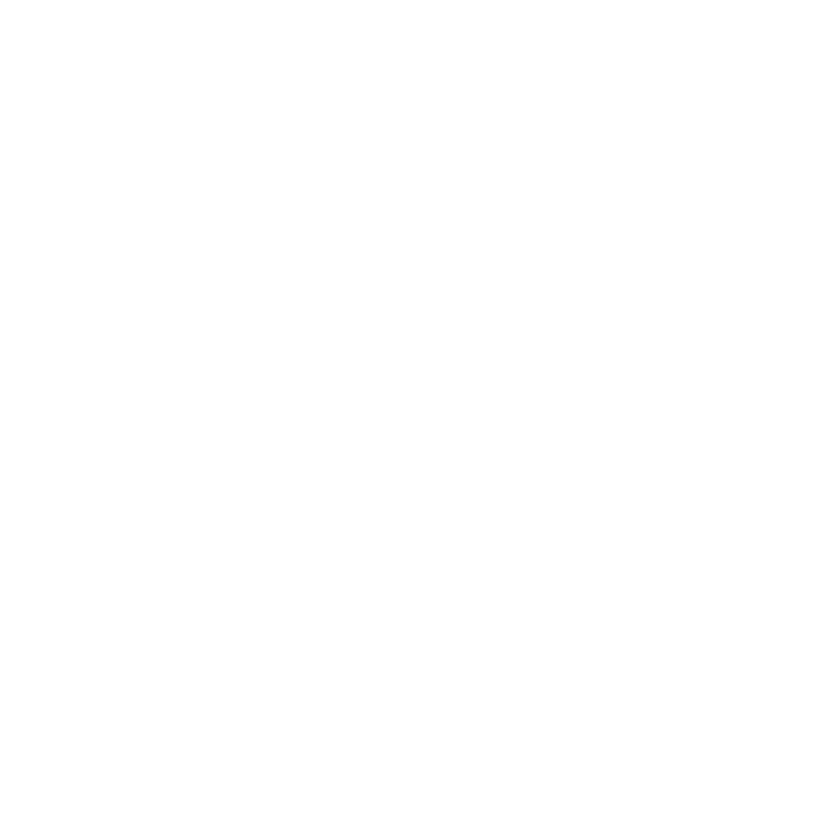

In [17]:
all.markers %>%
    group_by(cluster) %>%
    dplyr::filter(avg_log2FC > 1) %>%
    slice_head(n = 10) %>%
    ungroup() -> top

#DoHeatmap(Merged_patients, features = top$gene)
DoHeatmap(subset(Merged_patients, downsample = 100), features = top$gene)

In [ ]:
#Merged_patients@active.ident <- Merged_patients$`RNA_snn_res.1.4`
FeaturePlot(Merged_patients, features = c("CD14", "CD27", "CD28"))
FeaturePlot(Merged_patients, features = c("CD79A", "CD79B", "CD19"))
FeaturePlot(Merged_patients, features = c("CD3D", "CD56", "CD33"))
FeaturePlot(Merged_patients, features = c("CD8A", "CD8B", "CD4"))

FeaturePlot(Merged_patients, features = c("CCR7", "KLRG1", "HBB")) 
FeaturePlot(Merged_patients, features = c("LAG3", "FOXP3", "IL10"))
FeaturePlot(Merged_patients, features = c("IL4", "IL7R", "IL2"))
FeaturePlot(Merged_patients, features = c("GNLY", "CD68", "SDC1")) 

FeaturePlot(Merged_patients, features = c("PDCD1", "CXCL13", "NOSIP"))
FeaturePlot(Merged_patients, features = c("MS4A1", "TNF", "FCGR3A"))
FeaturePlot(Merged_patients, features = c("CXCL6", "TCF7", "NCAM1"))
FeaturePlot(Merged_patients, features = c("CTLA4", "BCL6", "KLF2"))

FeaturePlot(Merged_patients, features = c("IFNG", "SELL", "PTPRC", "MKI67"))
FeaturePlot(Merged_patients, features = c("GZMK", "GZMA", "GZMB", "GZMD"))
FeaturePlot(Merged_patients, features = c("LYZ", "HBA2", "PPBP", "NKG7"))

#Macrophages
FeaturePlot(Merged_patients, features = c("MARCO", "ITGAM", "ADGRE1"))
#Dendritic Cells
FeaturePlot(Merged_patients, features = c("FCER1A", "CST3"))
#Plasmacytoid Dendritic Cell
FeaturePlot(Merged_patients, features = c("IL3RA", "GZMB", "SERPINF1", "ITM2C"))

In [7]:
library(Seurat)
library(ggplot2)
library(grid)
Merged_patients@active.ident <- Merged_patients$`RNA_snn_res.1.4`
Idents(object = Merged_patients) <- Merged_patients$`RNA_snn_res.1.4`
# List of known celltype markers
markers <- list()
markers[["CD14+ monocytes"]] <- c("CD14", "LYZ")
markers[["FCGR3A+ monocyte"]] <- c("FCGR3A", "MS4A7")
markers[["Macrophages"]] <- c("MARCO", "ITGAM", "ADGRE1")
markers[["Conventional dendritic"]] <- c("FCER1A", "CST3")
markers[["Plasmacytoid dendritic"]] <- c("IL3RA", "GZMB", "SERPINF1", "ITM2C")
markers[["Naive Cells"]] <- c("CCR7", "SELL")
markers[["Activated Cells"]] <- c("CREM", "CD69")
markers[["T Cells"]] <- c("CD3D", "CD8A", "CD8B", "CD4")
markers[["B Cells"]] <- c("CD19", "CD79A", "CD79B")
markers[["Tr1"]] <- c("FOXP3", "IL10", "LAG3")

# Create dotplot based on RNA expression
Dot <- DotPlot(Merged_patients, markers, assay="RNA")
ggsave("DotPlot.jpeg", plot = Dot, width = 2400 / 100, height = 1200 / 100, units = "in", dpi = 100) # 72 dpi for points to inches conversion

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



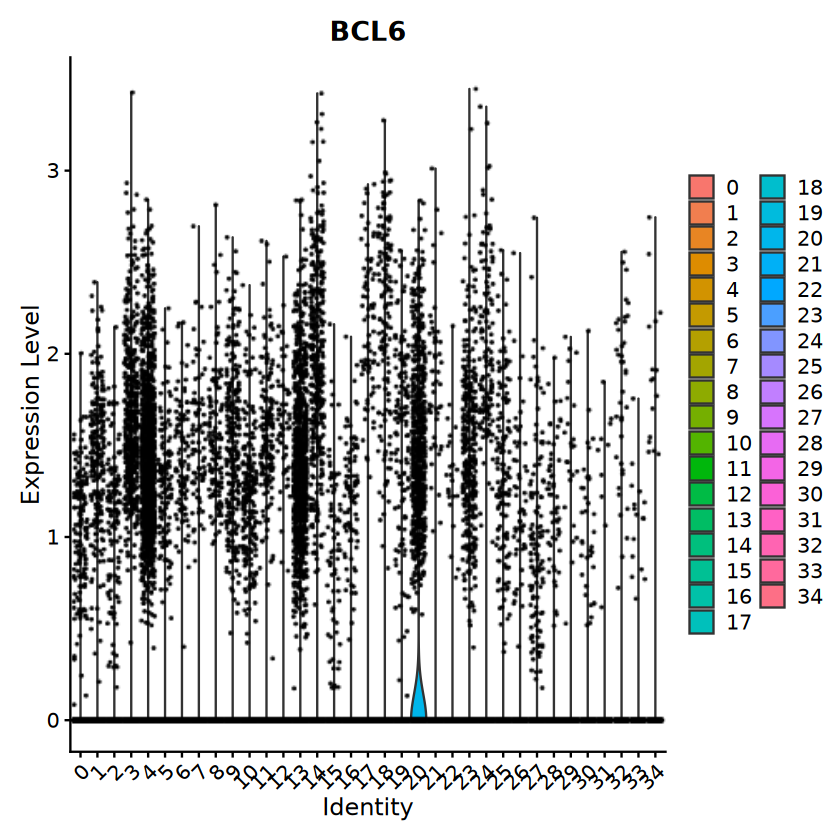

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



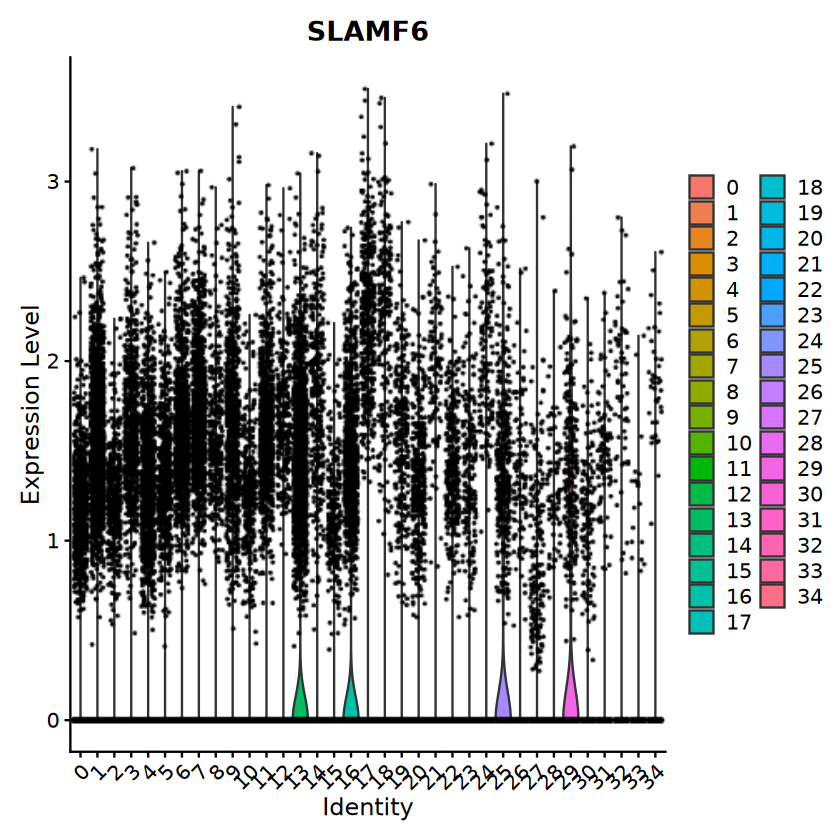

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



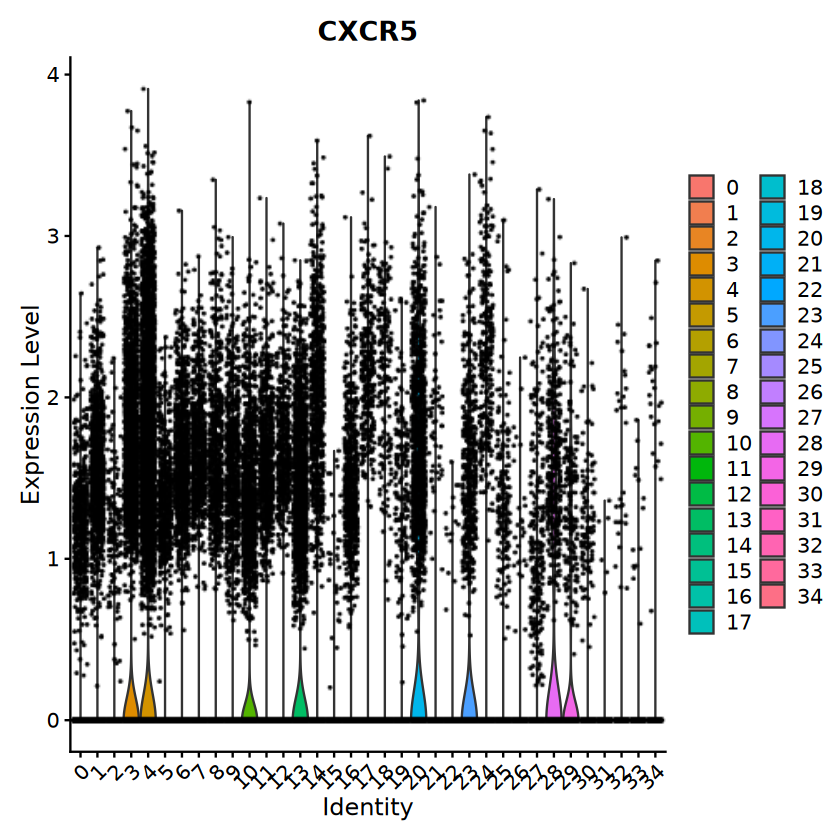

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



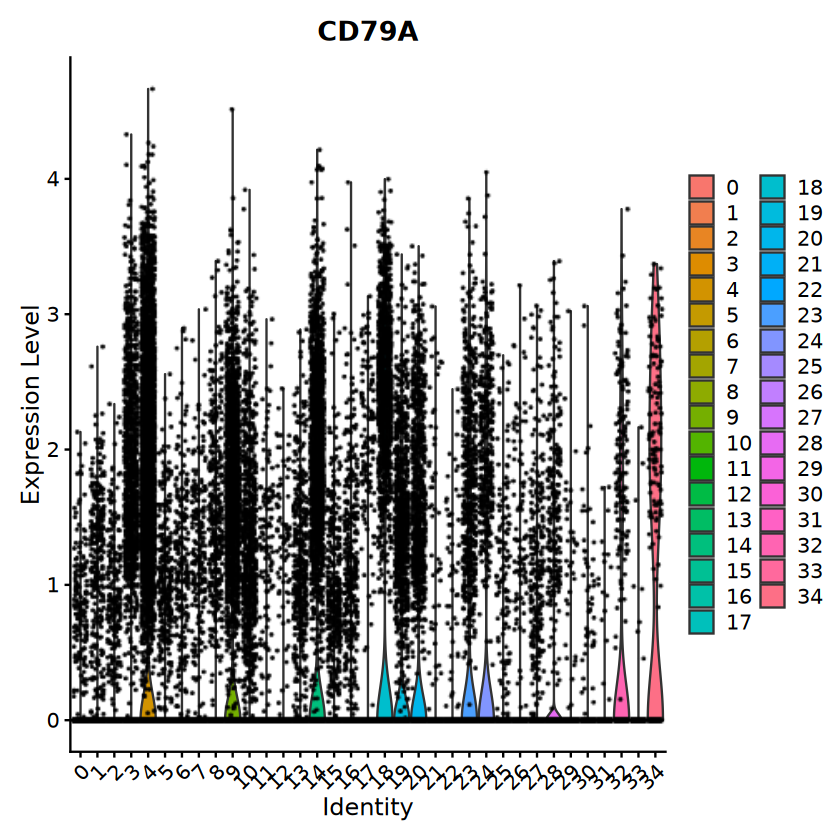

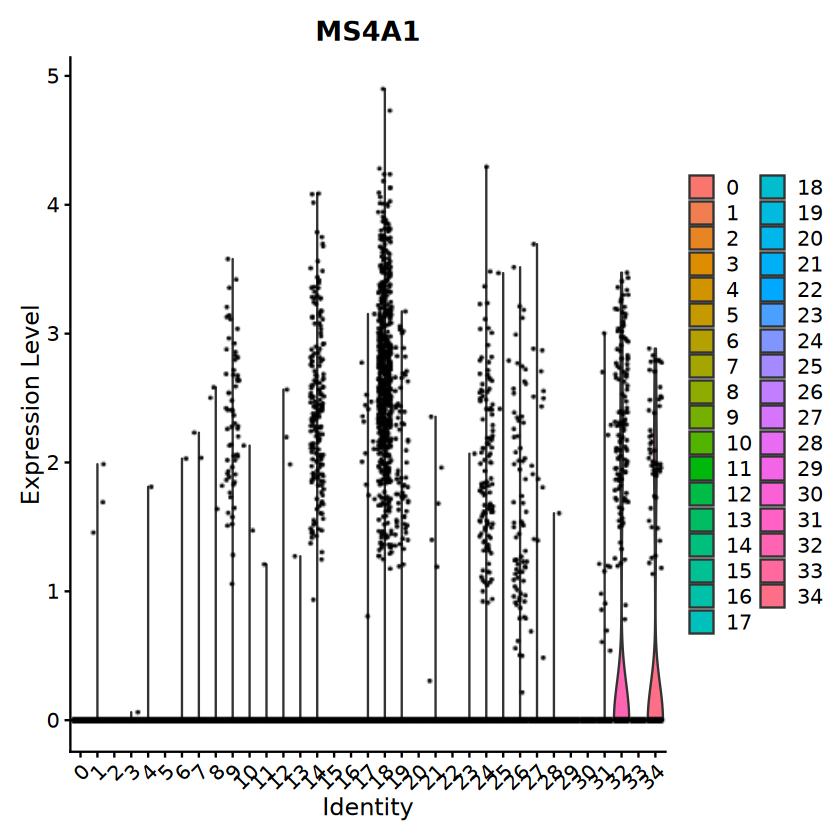

In [7]:
tcells@active.ident <- as.factor(tcells$`RNA_snn_res.1.8`)

VlnPlot(tcells, features = c("BCL6"))
VlnPlot(tcells, features = c("SLAMF6"))
VlnPlot(tcells, features = c("CXCR5"))

VlnPlot(tcells, features = c("CD79A"))
VlnPlot(tcells, features = c("MS4A1"))

When using repel, set xnudge and ynudge to 0 for optimal results

Warning message:
“ggrepel: 6 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


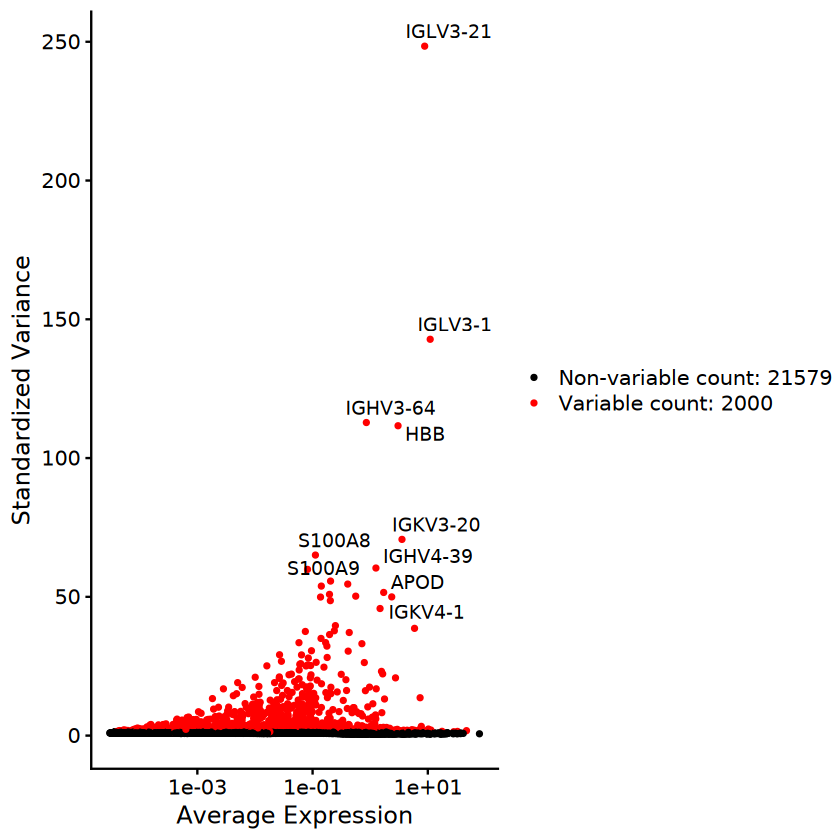

In [35]:
# Identify the 15 most highly variable genes
ranked_variable_genes <- VariableFeatures(Merged_patients)
top_genes <- ranked_variable_genes[1:15]

# Plot the average expression and variance of these genes
# With labels to indicate which genes are in the top 15
p <- VariableFeaturePlot(Merged_patients)
LabelPoints(plot = p, points = top_genes, repel = TRUE)

In [44]:
library(Seurat)
library(ggplot2)
library(grid)
library(dplyr)
load("/home/exacloud/gscratch/ShreeLab/FabianS/Jupyter/Merged_patients_bcells.Robj")

In [8]:
# Retrieve Ig Genes and plot light and heavy V and C genes using DotPlot
Ig_plots <- function(obj) {
  obj <- subset(obj, idents = setdiff(Idents(obj), 'Prolif Bcell'))

  LV.genes <- rev(grep(pattern = "^IG[KL]V", rownames(obj), value = TRUE))
  LC.genes <- rev(grep(pattern = "^IG[KL]C", rownames(obj), value = TRUE))
  HV.genes <- rev(grep(pattern = "^IGHV", rownames(obj), value = TRUE))
  HC.genes <- rev(grep(pattern = "^IGH[ADEGM]", rownames(obj), value = TRUE))
  C.genes <- c(LC.genes, HC.genes)
  #C.genes <- C.genes[-grep("-", C.genes)]

  obj$group_patient <- paste(Idents(obj), obj$patient, sep = "_")

# Use the new variable for grouping in the DotPlot
  LV.plot <- DotPlot(obj, features = LV.genes, cols = c("gold", "blue"), group.by = "group_patient") + RotatedAxis() +
  theme(axis.text.x = element_text(size = 8))

  HV.plot <- DotPlot(obj, features = c(HV.genes), cols = c("gold", "blue"), group.by = "group_patient") + RotatedAxis() +
    theme(axis.text.x = element_text(size = 8))

  C.plot <- DotPlot(obj, features = c(C.genes), cols = c("gold", "blue"), group.by = "group_patient") + RotatedAxis() +
    theme(axis.text.x = element_text(size = 10))

  ggsave("LV_plot.jpeg", plot = LV.plot, width = 30, height = 12, units = "in", dpi = 350, limitsize = FALSE) # 72 dpi for points to inches conversion
  ggsave("HV_plot.jpeg", plot = HV.plot, width = 30, height = 12, units = "in", dpi = 350, limitsize = FALSE) # 72 dpi for points to inches conversion
  ggsave("C_plot.jpeg", plot = C.plot, width = 20, height = 12, units = "in", dpi = 350, limitsize = FALSE) # 72 dpi for points to inches conversion

  return(list(LV.genes = LV.genes, HV.genes = HV.genes, C.genes = C.genes, 
              LV.plot = LV.plot, HV.plot = HV.plot, C.plot = C.plot))
}
Ig_plots(bcells)

ERROR: Error in rownames(obj): object 'bcells' not found


Warning message:
“The `facets` argument of `facet_grid()` is deprecated as of ggplot2 2.2.0.
ℹ Please use the `rows` argument instead.
ℹ The deprecated feature was likely used in the Seurat package.
  Please report the issue at <https://github.com/satijalab/seurat/issues>.”
Warning message:
“Scaling data with a low number of groups may produce misleading results”


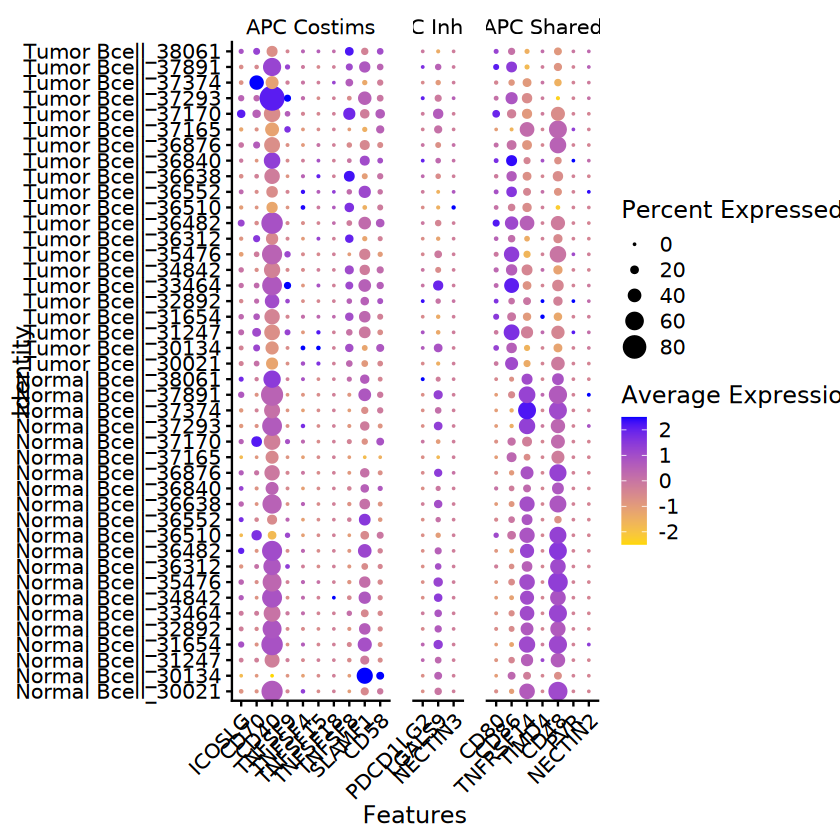

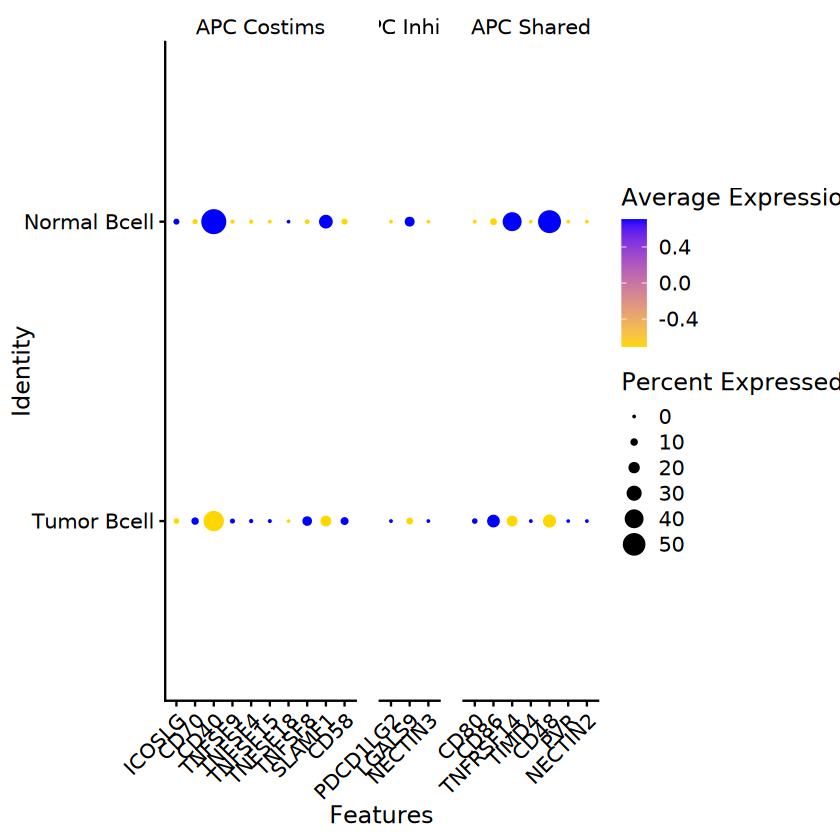

In [2]:
bcells <- subset(bcells, idents = setdiff(Idents(bcells), 'Prolif Bcell'))
bcells$group_patient <- paste(Idents(bcells), bcells$patient, sep = "_")

# List of known celltype markers
markers <- list()
markers[["APC Costims"]] <- c("ICOSLG", "CD70", "CD40", "TNFSF9", "TNFSF4", "TNFSF15", "TNFSF18", "TNFSF8", "SLAMF1", "CD58")
markers[["APC Inhibs"]] <- c("PDCD1LG2", "LGALS9", "NECTIN3")
markers[["APC Shared"]] <- c("CD80", "CD86", "TNFRSF14", "TIMD4", "CD48", "PVR", "NECTIN2")

# Create dotplot based on RNA expression
Dot <- DotPlot(bcells, markers, assay="RNA", cols = c("gold", "blue"), group.by = "group_patient")
Dot <- Dot + theme(axis.text.x = element_text(angle = 45, hjust = 1))
Dot

Dot2 <- DotPlot(bcells, markers, assay="RNA", cols = c("gold", "blue"))
Dot2 <- Dot2 + theme(axis.text.x = element_text(angle = 45, hjust = 1))
Dot2

ggsave("APC DotPlot by Patient.jpeg", plot = Dot, width = 12, height = 12, units = "in", dpi = 300) # 72 dpi for points to inches conversion

In [3]:
APC_avg <- Dot$data

APC_avg$site <- ifelse(grepl("Tumor", APC_avg$id), "Tumor", 
                       ifelse(grepl("Normal", APC_avg$id), "Normal", NA))

APC_avg$id <- as.character(APC_avg$id)

APC_avg$patient <- ifelse(
  grepl("Tumor", APC_avg$id), 
  substr(APC_avg$id, 13, nchar(APC_avg$id)),  # Remove first 12 characters for Tumor
  substr(APC_avg$id, 14, nchar(APC_avg$id))   # Remove 13 characters for Normal
)
head(APC_avg)
unique(APC_avg$patient)

,avg.exp,pct.exp,features.plot,id,avg.exp.scaled,feature.groups,site,patient
,<dbl>,<dbl>,<fct>,<chr>,<dbl>,<fct>,<chr>,<chr>
ICOSLG,0.13431883,5.2911484,ICOSLG,Tumor Bcell_30021,-0.3158191,APC Costims,Tumor,30021
CD70,0.27061179,8.3198125,CD70,Tumor Bcell_30021,0.1108449,APC Costims,Tumor,30021
CD40,1.13552514,33.4955832,CD40,Tumor Bcell_30021,-1.2351050,APC Costims,Tumor,30021
TNFSF9,0.01183424,0.4957635,TNFSF9,Tumor Bcell_30021,-0.6830012,APC Costims,Tumor,30021
TNFSF4,0.06597378,2.6861367,TNFSF4,Tumor Bcell_30021,0.9466826,APC Costims,Tumor,30021
TNFSF15,0.03901325,1.8298179,TNFSF15,Tumor Bcell_30021,1.6468899,APC Costims,Tumor,30021


[1] "30021" "30134" "31247" "31654" "32892" "33464" "34842" "35476" "36312"
[10] "36482" "36510" "36552" "36638" "36840" "36876" "37165" "37170" "37293"
[19] "37374" "37891" "38061"

In [4]:
stat.test <- APC_avg %>%
  group_by(features.plot) %>%
  t_test(avg.exp ~ site) %>%
  adjust_pvalue() %>%
  add_significance("p.adj")
stat.test

table(stat.test$p.adj.signif)

features.plot,.y.,group1,group2,n1,n2,statistic,df,p,p.adj,p.adj.signif
<fct>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
ICOSLG,avg.exp,Normal,Tumor,21,21,0.60606938,36.10929,5.48e-01,1.0000e+00,ns
CD70,avg.exp,Normal,Tumor,21,21,-1.77621835,32.66047,8.50e-02,8.7600e-01,ns
CD40,avg.exp,Normal,Tumor,21,21,0.65982261,37.18964,5.13e-01,1.0000e+00,ns
TNFSF9,avg.exp,Normal,Tumor,21,21,-1.85841874,29.90784,7.30e-02,8.7600e-01,ns
TNFSF4,avg.exp,Normal,Tumor,21,21,-0.63136231,37.21410,5.32e-01,1.0000e+00,ns
TNFSF15,avg.exp,Normal,Tumor,21,21,-3.66806490,20.66301,1.46e-03,2.1900e-02,*
TNFSF18,avg.exp,Normal,Tumor,21,21,0.07800838,25.60226,9.38e-01,1.0000e+00,ns
TNFSF8,avg.exp,Normal,Tumor,21,21,-5.24647048,23.17733,2.48e-05,4.2160e-04,***
SLAMF1,avg.exp,Normal,Tumor,21,21,1.55642324,27.14420,1.31e-01,1.0000e+00,ns



   *  *** ****   ns 
   1    2    3   14 

In [5]:
# Filter the data frame to extract rows with asterisks in the 'p.adj.signif' column
significant_rows <- stat.test[grepl("\\*", stat.test$p.adj.signif), ]

# View the filtered rows
head(significant_rows)
sig.genes <- significant_rows$features.plot

sig.genes

sig.p_val <- significant_rows$p.adj

# Order the dataset by ascending p-value
geneset_data <- stat.test[order(stat.test$p.adj), ]

# Add a rank column, ranking the genes by p-value (1 being the smallest)
geneset_data$rank <- seq_len(nrow(geneset_data))

# Calculate the BH critical value (Q) for each gene
total_samples <- 20  # Total number of samples
geneset_data$Q <- geneset_data$rank / total_samples

# View the updated dataset
head(geneset_data)


# Filter the dataset to include only genes with Q < 0.05
significant_genes <- geneset_data[geneset_data$Q < 0.05, ]

# Count the number of such genes
num_significant_genes <- nrow(significant_genes)

significant_genes
sig.genes <- significant_genes$features.plot
# Print the result
print(paste("Number of genes with critical value (Q) < 0.05:", num_significant_genes))

features.plot,.y.,group1,group2,n1,n2,statistic,df,p,p.adj,p.adj.signif
<fct>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
TNFSF15,avg.exp,Normal,Tumor,21,21,-3.668065,20.66301,1.46e-03,2.1900e-02,*
TNFSF8,avg.exp,Normal,Tumor,21,21,-5.246470,23.17733,2.48e-05,4.2160e-04,***
CD80,avg.exp,Normal,Tumor,21,21,-5.668290,29.32092,3.82e-06,6.8760e-05,****
CD86,avg.exp,Normal,Tumor,21,21,-4.851570,26.41888,4.78e-05,7.6480e-04,***
TNFRSF14,avg.exp,Normal,Tumor,21,21,7.805344,34.30674,4.13e-09,8.2600e-08,****
CD48,avg.exp,Normal,Tumor,21,21,7.482958,37.04997,6.45e-09,1.2255e-07,****


[1] TNFSF15  TNFSF8   CD80     CD86     TNFRSF14 CD48    
20 Levels: ICOSLG CD70 CD40 TNFSF9 TNFSF4 TNFSF15 TNFSF18 TNFSF8 ... NECTIN2

features.plot,.y.,group1,group2,n1,n2,statistic,df,p,p.adj,p.adj.signif,rank,Q
<fct>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<int>,<dbl>
TNFRSF14,avg.exp,Normal,Tumor,21,21,7.805344,34.30674,4.13e-09,8.2600e-08,****,1,0.05
CD48,avg.exp,Normal,Tumor,21,21,7.482958,37.04997,6.45e-09,1.2255e-07,****,2,0.10
CD80,avg.exp,Normal,Tumor,21,21,-5.668290,29.32092,3.82e-06,6.8760e-05,****,3,0.15
TNFSF8,avg.exp,Normal,Tumor,21,21,-5.246470,23.17733,2.48e-05,4.2160e-04,***,4,0.20
CD86,avg.exp,Normal,Tumor,21,21,-4.851570,26.41888,4.78e-05,7.6480e-04,***,5,0.25
TNFSF15,avg.exp,Normal,Tumor,21,21,-3.668065,20.66301,1.46e-03,2.1900e-02,*,6,0.30


features.plot,.y.,group1,group2,n1,n2,statistic,df,p,p.adj,p.adj.signif,rank,Q
<fct>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<int>,<dbl>


[1] "Number of genes with critical value (Q) < 0.05: 0"


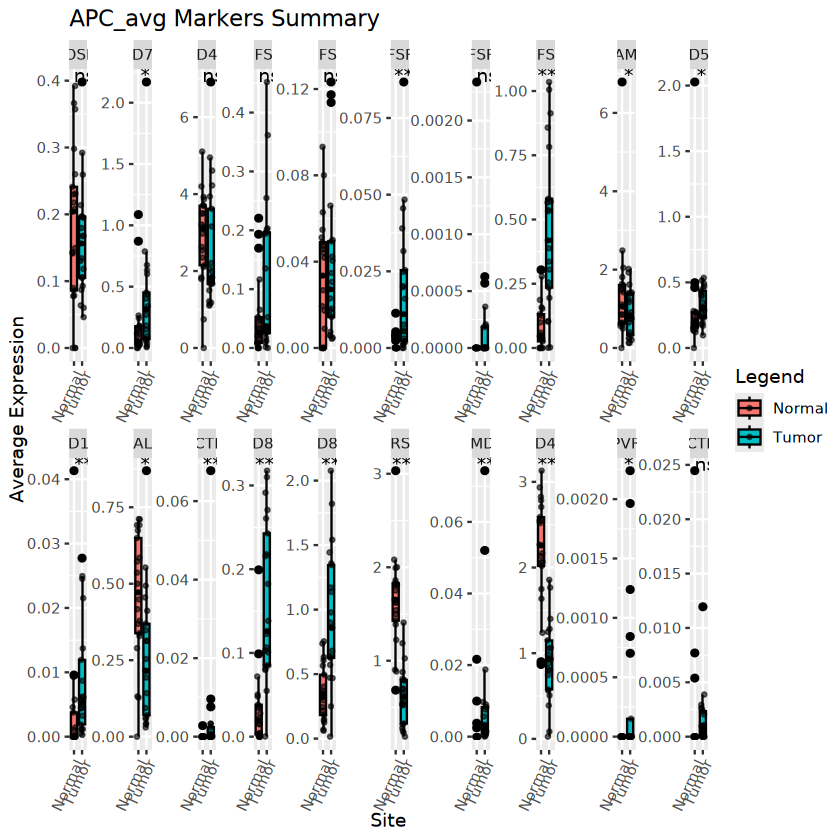

In [10]:
summary_plot <- ggplot(APC_avg, aes(x = site, y = avg.exp, fill = site)) +
  geom_boxplot(position= "dodge", color = "black") +  # Boxplot without outliers shown
  geom_jitter(width = 0.2, alpha = 0.6, color = "black", size = 0.8) +  # Add jittered points
  stat_compare_means(paired = TRUE, method = "wilcox.test", label = "p.signif", label.x.npc = "middle") +
  facet_wrap(~features.plot, scales = 'free', ncol = 10) +
  theme(axis.text.x = element_text(angle = 65, hjust = 1)) +
  labs(title = "APC_avg Markers Summary",
       x = "Site",
       y = "Average Expression",
       fill = "Legend")

summary_plot
ggsave("APC_summary.jpeg", plot = summary_plot, width = 18, height = 12, units = "in", dpi = 100, limitsize = FALSE)

In [23]:
plot_data <- Dot$data
plot_data2 <- Dot2$data

APC_table <- data.frame(
    Sample_ID = plot_data$id,
    Gene = plot_data$features.plot,
    Feature_group = plot_data$feature.groups,
    Expression = plot_data$avg.exp,
    Percent_exp = plot_data$pct.exp
)

APC_table2 <- data.frame(
    Sample_ID = plot_data2$id,
    Gene = plot_data2$features.plot,
    Feature_group = plot_data2$feature.groups,
    Expression = plot_data2$avg.exp,
    Percent_exp = plot_data2$pct.exp
)

APC_table2 <- APC_table2 %>%
  mutate(Sample_ID = str_replace_all(Sample_ID, c("Tumor Bcell" = "Tumor Average", "Normal Bcell" = "Normal Average")))

APC_data <- rbind(APC_table, APC_table2)
APC_data

save(APC_data, file = "APC_Dotplot.Robj")
write.csv(APC_data, file = "APC_Dotplot.csv")

Sample_ID,Gene,Feature_group,Expression,Percent_exp
<fct>,<fct>,<fct>,<dbl>,<dbl>
Tumor Bcell_30021,ICOSLG,APC Costims,0.1336413538,5.27258079
Tumor Bcell_30021,CD70,APC Costims,0.2693769424,8.32512756
Tumor Bcell_30021,CD40,APC Costims,1.1372173315,33.55115925
Tumor Bcell_30021,TNFSF9,APC Costims,0.0119729738,0.50129800
Tumor Bcell_30021,TNFSF4,APC Costims,0.0655461547,2.67657327
Tumor Bcell_30021,TNFSF15,APC Costims,0.0387443352,1.81720526
Tumor Bcell_30021,TNFSF18,APC Costims,0.0000000000,0.00000000
Tumor Bcell_30021,TNFSF8,APC Costims,0.3337393072,11.78050309
Tumor Bcell_30021,SLAMF1,APC Costims,0.3962440508,12.24599409


[1] 450

[1] 157

Warning message:
“The following requested variables were not found (10 out of 33 shown): TRIM50, ASB10, ASB17, ASB5, ASB11, FGG, FGA, FGB, CBLL2, UBE2U”
Warning message:
“The following requested variables were not found (10 out of 33 shown): TRIM50, ASB10, ASB17, ASB5, ASB11, FGG, FGA, FGB, CBLL2, UBE2U”
Warning message:
“Scaling data with a low number of groups may produce misleading results”


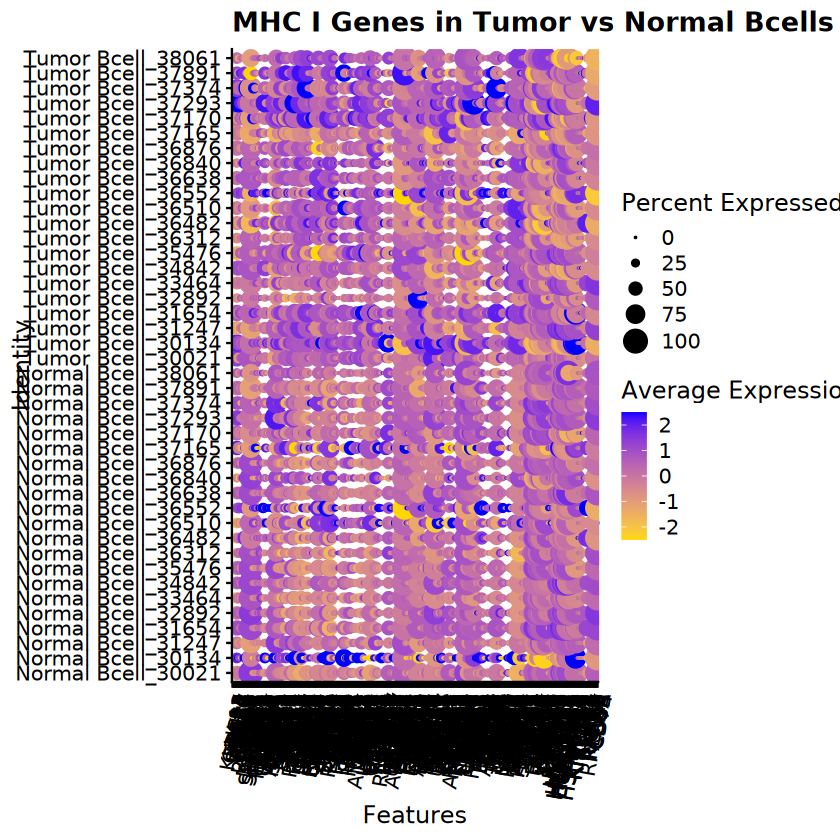

Warning message:
“The following requested variables were not found (10 out of 11 shown): SH3GL2, KIF2B, TUBA3E, TUBB8B, CAPZA3, TUBAL3, HLA-DRB3, TUBA3C, HLA-DRB4, MARCHF8”


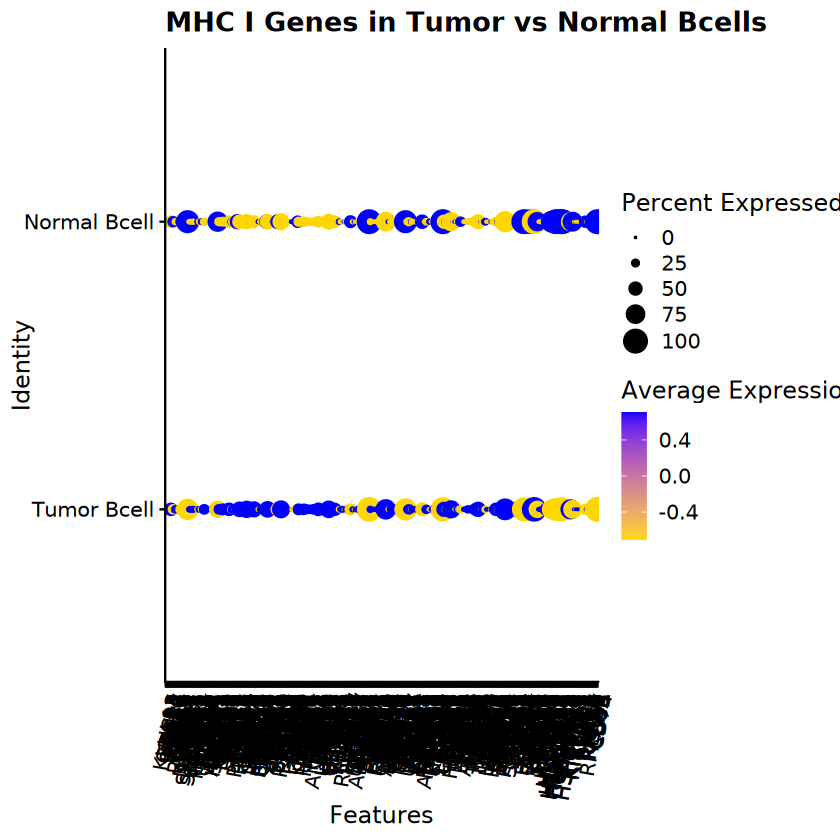

Warning message:
“The following requested variables were not found (10 out of 11 shown): SH3GL2, KIF2B, TUBA3E, TUBB8B, CAPZA3, TUBAL3, HLA-DRB3, TUBA3C, HLA-DRB4, MARCHF8”
Warning message:
“Scaling data with a low number of groups may produce misleading results”


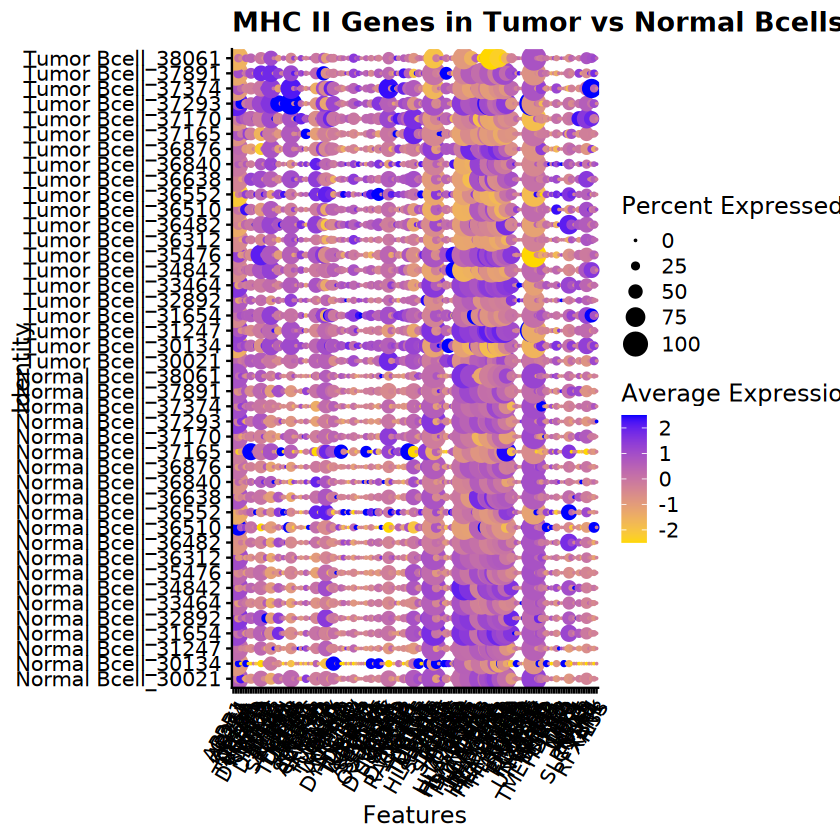

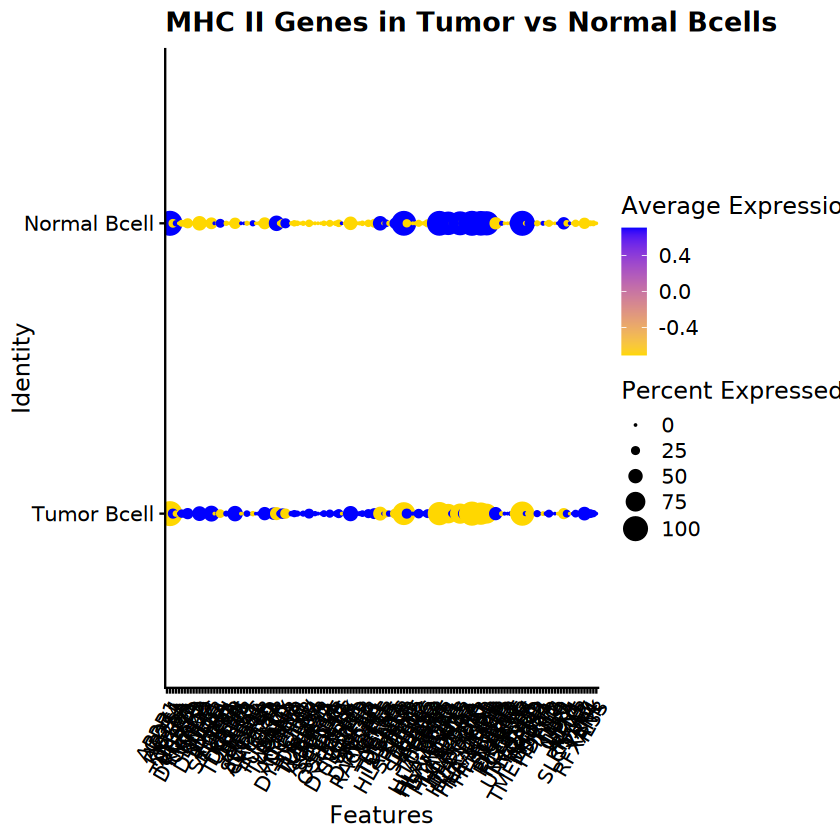

In [11]:
MHCI_genes1 <- c("KLHL13", "CDC27", "FBXL3", "ASB4", "MYLIP", "PSMB1", "UBE3C", "BTK", "MRC2", "PSMC4", "RNF14", "UFL1", "UBR2", "UBA6", "RNF19A", "CUL3", "PSMA4", "CUL7", "HSPA5", "VAMP3", "NEDD4L", "CYBA", "ANAPC4", "CUL1", "SEC61A1", "UNKL", "RNF4", "BTBD1", "SEC61A2", "ASB1", "PSME4", "NEDD4", "RNF126", "LNX1", "UBE2D1", "FBXW11", "KLHL20", "UBE2A", "UBE2K", "PIK3C3", "ITCH", "UBE2D4", "KEAP1", "UBA5", "ITGB5", "HACE1", "HUWE1", "PSMC5", "KLHL42", "ANAPC5", "PSME1", "HECTD1", "SNAP23", "CDC23", "PSMD5", "PSMD8", "FBXL19", "CDC34", "KLHL22", "FBXO7", "NCF4", "RBX1", "TRIM9", "PSMC6", "PSMA3", "ASB2", "PSMC1", "PSMB5", "PSMA6", "PSME2", "SEC23A", "PSMA7", "PSMD10", "ASB9", "MGRN1", "PSMD7", "FBXO31", "STUB1", "ELOB", "STX4", "HERC1", "UBE2W", "IKBKB", "FZR1", "PSMA2", "SEC61B", "UBE2R2", "FBXW4", "FBXL15", "CUL2", "UBE2S", "FBXL20", "PSMD3", "TRIM37", "BLMH", "PSMD11", "SMURF2", "WSB1", "UBE2D3", "KLHL2", "FBXW7", "KLHL5", "ZBTB16", "UBE4A", "PSMD9", "SPSB2", "FBXO9", "FBXL4", "TAPBP", "RNF130", "LNPEP", "SKP1", "SEC24A", "UBE3A", "RNF7", "CBLB", "PSMD14", "ASB3", "CD207", "RNF19B", "FBXO2", "FBXO6", "NCF2", "CDC20", "UBE3D", "FBXO30", "FBXL5", "VAMP8", "UBE2B", "TRIM32", "FBXW2", "AREL1", "KBTBD7", "RBBP6", "WWP1", "RNF114", "PSMF1", "RBCK1", "PSMB2", "HECTD3", "BECN1", "ATG14", "CANX", "FBXL12", "UBR4", "FBXL16", "RNF6", "SEM1", "HERC2", "ANAPC13", "PSMA1", "CDC16", "UBAC1", "UBE2M", "UBA1", "RLIM", "PSME3", "UBE2D2", "TRAF7", "FBXW9", "TRIM21", "LRRC41", "UBE2G1", "SEC61G", "FBXO44", "MKRN1", "VHL", "RNF138", "TPP2", "CTSL", "FBXO21", "CD36", "FBXL8", "LMO7", "TLR4", "PSMB7", "CTSV", "RNF144B", "HLA-F", "TLR2", "FBXO11", "HECW2", "ITGAV", "HERC3", "HERC6", "HERC5", "SEC31A", "SEC24B", "UBE2Q2", "DET1", "NPEPPS", "ANAPC11", "FBXO15", "PSMB6", "PSMA5", "S100A8", "RPS27A", "UBA3", "DCAF1", "SKP2", "KLHL3", "TRIM41", "RNF217", "TRIM50", "ASB15", "TRIM4", "ASB10", "FBXO10", "ASB6", "LRSAM1", "HERC4", "FCGR1A", "TIRAP", "SEC24D", "UBC", "UBE3B", "FBXO4", "TRIM36", "SAR1B", "ANAPC1", "TRIP12", "ASB17", "LONRF1", "TRIM11", "SH3RF1", "ELOC", "LY96", "PSMA8", "FBXL18", "UBE2L6", "FBXO32", "SEC13", "RNF111", "TRIM63", "NCF1", "FBXW5", "UBE2Z", "PSMD4", "PSMB4", "UBR1", "UBE2J2", "S100A1", "UBE2Q1", "FBXL13", "PSMC2", "FBXO27", "ASB16", "CCNF", "KLHL21", "FBXO41", "CTSS", "S100A9", "KBTBD8", "RNF25", "PSMD6", "RCHY1", "FBXO40", "DTX3L", "FBXW12", "RNF123", "ASB5", "ANAPC10", "ERAP1", "ERAP2", "CYBB", "ASB11", "HECTD2", "LRR1", "KBTBD6", "PSMC3", "BTRC", "CUL5", "B2M", "PDIA3", "FBXO22", "KCTD6", "TAP1", "UBE2V2", "UBE2E3", "UBE2E1", "UBB", "CD14", "RNF34", "FGG", "FGA", "FGB", "SPSB1", "FBXL14", "FBXW10", "THOP1", "MYD88", "PSMD1", "RNF213", "TLR1", "TLR6", "GLMN", "FBXW8", "UBE2C", "SPSB4", "PSMD2", "CBLL2", "UBE2O", "ANAPC2", "CDC26", "MEX3C", "SEC24C", "UBE2U", "ARIH2", "UBE2N", "ASB8", "KLHL11", "CALR", "ZNRF2", "RNF182", "PJA1", "SIAH2", "RNF41", "ASB18", "UBA7", "UBE2E2", "ASB7", "FBXL7", "KLHL25", "TRAIP", "UBE2F", "SOCS3", "UBE2G2", "BTBD6", "UBOX5", "SOCS1", "PRKN", "PSMD13", "UBE2L3", "BCAP31", "TRIM69", "ZNRF1", "UBE2H", "RNF220", "HMGB1", "ASB13", "PIK3R4", "SIAH1", "ANAPC7", "PSMD12", "FBXL22", "MIB2", "ATG7", "FCGR1BP", "KLHL9", "SMURF1", "UBE2J1", "LTN1", "ASB12", "DZIP3", "PJA2", "PSMB8", "TAP2", "HLA-C", "HLA-E", "TRIM39", "HLA-G", "HLA-F", "PSMB10", "TAPBP", "TAP2", "TAPBP", "TAP1", "PSMB8", "TAP2", "HLA-E", "TRIM39", "HLA-A", "HLA-G", "HLA-F", "TRIM71", "CHUK", "UBA52", "PSMB11", "TAP2", "TAP1", "TRIM39", "HLA-E", "TAP2", "TAP1", "PSMB8", "TRIM39", "TAP1", "TAP2", "HLA-E", "HLA-F", "TRIM39", "PSMB8", "HLA-E", "TRIM39", "HLA-G", "PSMB8", "TAP1", "PSMB8", "TAPBP", "TAP2", "TAP1", "TRIM39", "HLA-G", "HLA-E", "KBTBD13", "HLA-B", "HLA-F", "HLA-G", "HLA-G", "PSMB8", "PSMB8", "TAPBP", "HLA-E", "HLA-G", "HLA-F", "TAP2", "ASB14", "KLHL41", "PSMB9", "PSMB9", "PSMB9", "PSMB9", "PSMB9", "PSMB9", "KCTD7", "PSMB9", "PSMB9", "UBE2V1", "MRC1", "GAN", "RNF115", "SEC22B", "FBXO17", "IKBKG", "B2M", "PSMB3", "HLA-G", "PSMB3", "TRIM69", "ASB2", "PSMC4", "FBXO17", "CANX", "PSME2", "PSME1")
MHCI_genes2 <- c("HSPA5", "PIK3C3", "SEC23A", "TAPBP", "SEC24A", "BECN1", "ATG14", "CANX", "HLA-F", "SEC31A", "SEC24B", "SEC24D", "SAR1B", "SEC13", "ERAP1", "ERAP2", "B2M", "PDIA3", "TAP1", "SEC24C", "CALR", "BCAP31", "PIK3R4", "TAP2", "HLA-C", "HLA-E", "HLA-G", "HLA-F", "TAPBP", "TAP2", "TAPBP", "TAP1", "TAP2", "HLA-E", "HLA-A", "HLA-G", "HLA-F", "TAP2", "TAP1", "HLA-E", "TAP2", "TAP1", "TAP1", "TAP2", "HLA-E", "HLA-F", "HLA-E", "HLA-G", "TAP1", "TAPBP", "TAP2", "TAP1", "HLA-G", "HLA-E", "HLA-B", "HLA-F", "HLA-G", "HLA-G", "TAPBP", "HLA-E", "HLA-G", "HLA-F", "TAP2", "B2M", "HLA-G", "CANX")
MHCI_genes3 <- c("PSME3", "IFI30", "KIR3DL3", "CREB1", "CTSB", "CTSL", "CTSS", "PDIA3", "HLA-A", "HLA-B", "HLA-C", "HLA-DMA", "HLA-DMB", "HLA-DOA", "HLA-DOB", "HLA-DPA1", "HLA-DPB1", "HLA-DQA1", "HLA-DQA2", "HLA-DQB1", "HLA-DRA", "HLA-DRB1", "HLA-DRB3", "HLA-DRB4", "HLA-DRB5", "HLA-E", "HLA-F", "HLA-G", "HSPA1A", "HSPA1B", "HSPA1L", "HSPA2", "HSPA4", "HSPA5", "HSPA6", "HSPA8", "HSP90AA1", "HSP90AB1", "IFNA1", "IFNA2", "IFNA4", "IFNA5", "IFNA6", "IFNA7", "IFNA8", "IFNA10", "IFNA13", "IFNA14", "IFNA16", "IFNA17", "IFNA21", "KIR2DL1", "KIR2DL2", "KIR2DL3", "KIR2DL4", "KIR2DS1", "KIR2DS3", "KIR2DS4", "KIR2DS5", "KIR3DL1", "KIR3DL2", "KLRC1", "KLRC2", "KLRC3", "KLRD1", "LTA", "CIITA", "NFYA", "NFYB", "NFYC", "LGMN", "B2M", "PSME1", "PSME2", "KIR2DL5A", "RFX5", "RFXAP", "TAP1", "TAP2", "TAPBP", "CALR", "CANX", "KLRC4", "RFXANK", "CD4", "CD8A", "CD8B", "CD74")
MHCI_genes4 <- c("PDIA3", "HLA-A", "HLA-B", "HLA-C", "HLA-E", "HLA-F", "HLA-G", "B2M", "TAP1", "TAP2", "TAPBP", "CALR")
MHCI_genes5 <- c("HSPA5", "PIK3C3", "SEC23A", "TAPBP", "SEC24A", "BECN1", "ATG14", "CANX", "HLA-F", "SEC31A", "SEC24B", "SEC24D", "SAR1B", "SEC13", "ERAP1", "ERAP2", "B2M", "PDIA3", "TAP1", "SEC24C", "CALR", "BCAP31", "PIK3R4", "TAP2", "HLA-C", "HLA-E", "HLA-G", "HLA-F", "TAPBP", "TAP2", "TAPBP", "TAP1", "TAP2", "HLA-E", "HLA-A", "HLA-G", "HLA-F", "TAP2", "TAP1", "HLA-E", "TAP2", "TAP1", "TAP1", "TAP2", "HLA-E", "HLA-F", "HLA-E", "HLA-G", "TAP1", "TAPBP", "TAP2", "TAP1", "HLA-G", "HLA-E", "HLA-B", "HLA-F", "HLA-G", "HLA-G", "TAPBP", "HLA-E", "HLA-G", "HLA-F", "TAP2", "B2M", "HLA-G", "CANX")


MHCII_genes1 <- c("AP2B1", "CD74", "AP2S1", "CTSA", "KIF26A", "KIF2A", "AP1M1", "RAB7A", "TUBA3D", "KIFAP3", "DYNC1I2", "CAPZB", "KIF22", "DNM2", "KIF3C", "DYNLL1", "LAG3", "KIF4A", "AP1B1", "LGMN", "SEC23A", "TUBB1", "KIF3B", "CTSH", "DCTN6", "TUBB4A", "KLC3", "AP1S1", "DNM1", "SH3GL2", "CTSC", "KIF20A", "SEC24A", "ACTR1B", "CAPZA1", "CTSD", "KIF18A", "CLTA", "TUBA1B", "KLC1", "CANX", "TUBA4A", "AP1M2", "KIF3A", "ACTR10", "DCTN4", "CTSL", "DYNC1LI2", "CTSV", "DCTN3", "KLC4", "TUBB2A", "TUBB2B", "KIF23", "ACTR1A", "KIF11", "SEC31A", "CENPE", "SEC24B", "KIF2B", "CLTC", "OSBPL1A", "KIF2C", "CTSK", "ARF1", "DYNC1LI1", "SEC24D", "AP1S3", "TUBA3E", "SAR1B", "KIF5A", "SEC13", "DYNC1I1", "AP2M1", "RACGAP1", "CTSS", "KIF15", "CTSB", "AP1G1", "DCTN5", "TUBA1A", "TUBA1C", "RILP", "HLA-DPA1", "KIF5B", "TUBB8B", "SPTBN2", "CTSF", "KLC2", "DCTN2", "TUBB6", "SEC24C", "CAPZA3", "TUBAL3", "AP1S2", "AP2A2", "TUBA8", "TUBB4B", "HLA-DRB3", "HLA-DRB1", "CTSE", "HLA-DQB2", "HLA-DQA1", "AP2A1", "DYNC1H1", "DNM3", "TUBA3C", "HLA-DRB5", "CAPZA2", "HLA-DOA", "HLA-DMA", "HLA-DRA", "DCTN1", "HLA-DPA1", "HLA-DOA", "HLA-DQA2", "HLA-DQA1", "HLA-DRA", "HLA-DPB1", "IFI30", "HLA-DQA2", "HLA-DPB1", "HLA-DPA1", "HLA-DQB2", "HLA-DQA2", "HLA-DQB1", "HLA-DQB2", "HLA-DRA", "HLA-DMB", "KIF4B", "HLA-DPB1", "HLA-DRB4", "HLA-DRA", "HLA-DPA1", "HLA-DQB2", "HLA-DQB2", "HLA-DRA", "HLA-DQB2", "HLA-DPA1", "HLA-DOA", "HLA-DQB2", "HLA-DRA", "HLA-DPB1", "HLA-DRB4", "HLA-DQB1", "HLA-DPA1", "HLA-DQA2", "HLA-DOA", "HLA-DRB3", "HLA-DQA2", "HLA-DQA1", "HLA-DQB2", "HLA-DOA", "HLA-DOA", "HLA-DQA2", "HLA-DQB1", "HLA-DMB", "HLA-DRA", "HLA-DOA", "HLA-DPA1", "HLA-DPA1", "HLA-DPB1", "HLA-DQA2", "HLA-DPB1", "HLA-DMB", "HLA-DOB", "HLA-DMA", "HLA-DOB", "HLA-DMB", "HLA-DOB", "HLA-DMB", "HLA-DOB", "HLA-DMB", "HLA-DMA", "HLA-DMB", "HLA-DMB", "HLA-DMA", "HLA-DMA", "HLA-DMA", "HLA-DOB", "HLA-DOB", "HLA-DMA", "TUBA4B", "CTSO", "HLA-DQA2", "TUBB3", "TUBB8", "CTSO", "DYNLL2", "RILP", "HLA-DRA", "KIF15", "CANX", "CTSB")
MHCII_genes2 <- c("IFI30", "CTSD", "CTSE", "CTSL", "CTSV", "CTSS", "DNM2", "PIKFYVE", "FCER1G", "FCGR2B", "HLA-DMA", "HLA-DMB", "HLA-DOA", "HLA-DOB", "HLA-DPA1", "HLA-DPB1", "HLA-DQA1", "HLA-DQA2", "HLA-DQB1", "HLA-DQB2", "HLA-DRA", "HLA-DRB1", "HLA-DRB3", "HLA-DRB4", "HLA-DRB5", "LGMN", "B2M", "TRAF6", "UNC93B1", "CTSF", "CD74")
MHCII_genes3 <- c("IFI30", "CTSD", "CTSE", "CTSL", "CTSV", "CTSS", "DNM2", "PIKFYVE", "FCER1G", "MARCHF8", "FCGR2B", "PYCARD", "HLA-DMA", "HLA-DMB", "HLA-DOA", "HLA-DOB", "HLA-DPA1", "HLA-DPB1", "HLA-DQA1", "HLA-DQA2", "HLA-DQB1", "HLA-DQB2", "HLA-DRA", "HLA-DRB1", "HLA-DRB3", "HLA-DRB4", "HLA-DRB5", "TREM2", "MARCHF1", "ARL8B", "LGMN", "B2M", "THBS1", "TRAF6", "UNC93B1", "CTSF", "CD74")
MHCII_genes4 <- c("TMEM106A", "SIRT1", "HDAC2", "IFNG", "IL4", "IL10", "JAK2", "CIITA", "NFX1", "PF4", "AZU1", "RFX5", "RFXAP", "SLC11A1", "TAF7", "TLR4", "XBP1", "RFXANK", "IL33")
MHCII_genes5 <- c("HLA-DMA", "HLA-DMB", "HLA-DOA", "HLA-DOB", "HLA-DPA1", "HLA-DPB1", "HLA-DQA1", "HLA-DQA2", "HLA-DQB1", "HLA-DQB2", "HLA-DRA", "HLA-DRB1", "HLA-DRB3", "HLA-DRB4", "HLA-DRB5", "B2M")
MHCII_genes6 <- c("HLA-DMA", "HLA-DMB", "HLA-DOA", "HLA-DOB", "HLA-DPA1", "HLA-DPB1", "HLA-DQA1", "HLA-DQA2", "HLA-DQB1", "HLA-DQB2", "HLA-DRA", "HLA-DRB1", "HLA-DRB3", "HLA-DRB4", "HLA-DRB5", "B2M", "CD74")
MHCII_genes7 <- c("HLA-DMA", "HLA-DMB", "HLA-DOA", "HLA-DOB", "HLA-DPA1", "HLA-DPB1", "HLA-DQA1", "HLA-DQA2", "HLA-DQB1", "HLA-DRA", "HLA-DRB1", "HLA-DRB3", "HLA-DRB4", "HLA-DRB5", "CD74")


MHCI_geneset <- unique(c(MHCI_genes1, MHCI_genes2, MHCI_genes3, MHCI_genes4, MHCI_genes5))
MHCII_geneset <- unique(c(MHCII_genes1, MHCII_genes2, MHCII_genes3, MHCII_genes4, MHCII_genes5, MHCII_genes6, MHCII_genes7))

length(MHCI_geneset)
length(MHCII_geneset)

bcells <- subset(bcells, idents = setdiff(Idents(bcells), 'Prolif Bcell'))
bcells$group_patient <- paste(Idents(bcells), bcells$patient, sep = "_")

Dot1 <- DotPlot(bcells, MHCI_geneset, assay="RNA", cols = c("gold", "blue"), group.by = "group_patient")
Dot1 <- Dot1 + theme(axis.text.x = element_text(angle = 80, hjust = 1)) + ggtitle("MHC I Genes in Tumor vs Normal Bcells")
Dot1
Dot1.1 <- DotPlot(bcells, MHCI_geneset, assay="RNA", cols = c("gold", "blue"))
Dot1.1 <- Dot1.1 + theme(axis.text.x = element_text(angle = 80, hjust = 1)) + ggtitle("MHC I Genes in Tumor vs Normal Bcells")
Dot1.1

ggsave("MHCI DotPlot by Patient.jpeg", plot = Dot1, width = 65, height = 12, units = "in", dpi = 300, limitsize = FALSE) # 72 dpi for points to inches conversion
ggsave("MHCI DotPlot.jpeg", plot = Dot1.1, width = 65, height = 12, units = "in", dpi = 300, limitsize = FALSE) # 72 dpi for points to inches conversion

Dot2 <- DotPlot(bcells, MHCII_geneset, assay="RNA", , cols = c("gold", "blue"), group.by = "group_patient")
Dot2 <- Dot2 + theme(axis.text.x = element_text(angle = 60, hjust = 1))+ ggtitle("MHC II Genes in Tumor vs Normal Bcells")
Dot2
Dot2.1 <- DotPlot(bcells, MHCII_geneset, assay="RNA", , cols = c("gold", "blue"))
Dot2.1 <- Dot2.1 + theme(axis.text.x = element_text(angle = 60, hjust = 1))+ ggtitle("MHC II Genes in Tumor vs Normal Bcells")
Dot2.1


ggsave("MHCII DotPlot by Patient.jpeg", plot = Dot2, width = 30, height = 12, units = "in", dpi = 300) # 72 dpi for points to inches conversion
ggsave("MHCII DotPlot.jpeg", plot = Dot2.1, width = 30, height = 12, units = "in", dpi = 300) # 72 dpi for points to inches conversion


In [23]:
test <- boxplot$data
head(test)

,avg.exp,pct.exp,features.plot,id,avg.exp.scaled,Phenotype,patient
,<dbl>,<dbl>,<fct>,<chr>,<dbl>,<chr>,<chr>
KLHL13,0.0076450752,0.280956334,KLHL13,Tumor Bcell,0.7071068,Tumor,
CDC27,0.3927026637,12.733879604,CDC27,Tumor Bcell,0.7071068,Tumor,
FBXL3,0.3162421140,10.469383581,FBXL3,Tumor Bcell,0.7071068,Tumor,
ASB4,0.0000666462,0.001804859,ASB4,Tumor Bcell,0.7071068,Tumor,
MYLIP,0.4575752266,12.937227015,MYLIP,Tumor Bcell,-0.7071068,Tumor,
PSMB1,1.8571005286,46.300039707,PSMB1,Tumor Bcell,0.7071068,Tumor,


In [12]:
MHCI_avg <- Dot1$data

MHCI_avg$site <- ifelse(grepl("Tumor", MHCI_avg$id), "Tumor", 
                       ifelse(grepl("Normal", MHCI_avg$id), "Normal", NA))

MHCI_avg$id <- as.character(MHCI_avg$id)

MHCI_avg$patient <- ifelse(
  grepl("Tumor", MHCI_avg$id), 
  substr(MHCI_avg$id, 13, nchar(MHCI_avg$id)),  # Remove first 12 characters for Tumor
  substr(MHCI_avg$id, 14, nchar(MHCI_avg$id))   # Remove 13 characters for Normal
)
head(MHCI_avg)
unique(MHCI_avg$patient)


,avg.exp,pct.exp,features.plot,id,avg.exp.scaled,site,patient
,<dbl>,<dbl>,<fct>,<chr>,<dbl>,<chr>,<chr>
KLHL13,0.0002175949,0.01802776,KLHL13,Tumor Bcell_30021,-0.4673033,Tumor,30021
CDC27,0.5095143511,19.38885884,CDC27,Tumor Bcell_30021,0.6062272,Tumor,30021
FBXL3,0.3514332476,14.02559942,FBXL3,Tumor Bcell_30021,0.7455591,Tumor,30021
ASB4,0.0000000000,0.00000000,ASB4,Tumor Bcell_30021,-0.2458458,Tumor,30021
MYLIP,0.3417729671,12.37605913,MYLIP,Tumor Bcell_30021,-0.4110638,Tumor,30021
PSMB1,2.4337817594,62.82675320,PSMB1,Tumor Bcell_30021,1.2895827,Tumor,30021


[1] "30021" "30134" "31247" "31654" "32892" "33464" "34842" "35476" "36312"
[10] "36482" "36510" "36552" "36638" "36840" "36876" "37165" "37170" "37293"
[19] "37374" "37891" "38061"

In [54]:
MHCII_avg <- Dot2$data

MHCII_avg$site <- ifelse(grepl("Tumor", MHCII_avg$id), "Tumor", 
                       ifelse(grepl("Normal", MHCII_avg$id), "Normal", NA))

MHCII_avg$id <- as.character(MHCII_avg$id)

MHCII_avg$patient <- ifelse(
  grepl("Tumor", MHCII_avg$id), 
  substr(MHCII_avg$id, 13, nchar(MHCII_avg$id)),  # Remove first 12 characters for Tumor
  substr(MHCII_avg$id, 14, nchar(MHCII_avg$id))   # Remove 13 characters for Normal
)
head(MHCII_avg)
unique(MHCII_avg$patient)

,avg.exp,pct.exp,features.plot,id,avg.exp.scaled,site,patient
,<dbl>,<dbl>,<fct>,<chr>,<dbl>,<chr>,<chr>
AP2B1,0.3178128,13.03407,AP2B1,Tumor Bcell_30021,-0.28713046,Tumor,30021
CD74,209.7237260,99.98197,CD74,Tumor Bcell_30021,0.04015029,Tumor,30021
AP2S1,1.1043965,38.90391,AP2S1,Tumor Bcell_30021,0.39418415,Tumor,30021
CTSA,0.3760082,16.08076,CTSA,Tumor Bcell_30021,-0.16273438,Tumor,30021
KIF26A,0.0000000,0.00000,KIF26A,Tumor Bcell_30021,-0.17914415,Tumor,30021
KIF2A,0.6918725,25.73463,KIF2A,Tumor Bcell_30021,0.09426494,Tumor,30021


[1] "30021" "30134" "31247" "31654" "32892" "33464" "34842" "35476" "36312"
[10] "36482" "36510" "36552" "36638" "36840" "36876" "37165" "37170" "37293"
[19] "37374" "37891" "38061"

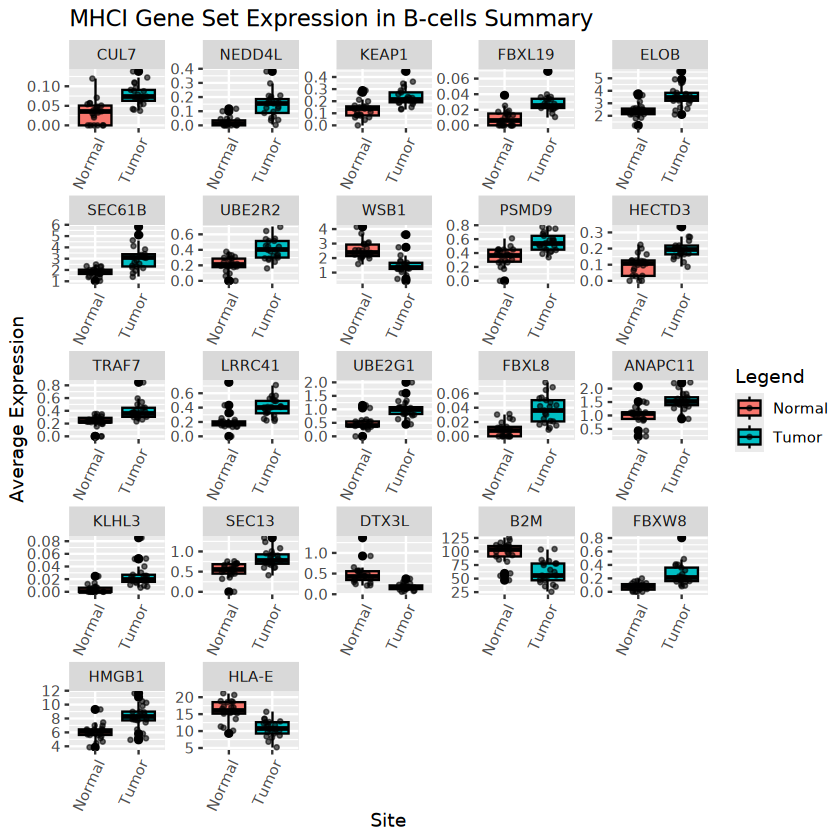

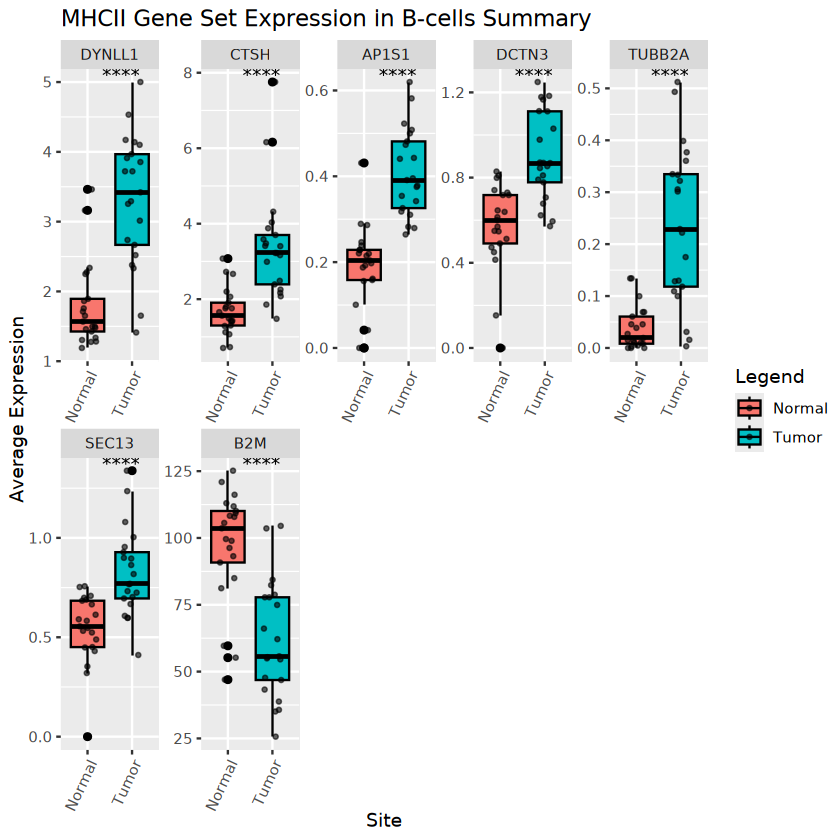

In [62]:
summary_plot <- ggplot(filtered_dataset, aes(x = site, y = avg.exp, fill = site)) +
  geom_boxplot(position= "dodge", color = "black") +  # Boxplot without outliers shown
  geom_jitter(width = 0.2, alpha = 0.6, color = "black", size = 0.8) +  # Add jittered points
  stat_compare_means(paired = TRUE, method = "wilcox.test", label = "p.signif", label.x.npc = "middle") +
  facet_wrap(~features.plot, scales = 'free', ncol = 5) +
  theme(axis.text.x = element_text(angle = 65, hjust = 1)) +
  labs(title = "MHCI Gene Set Expression in B-cells Summary",
       x = "Site",
       y = "Average Expression",
       fill = "Legend")

summary_plot
ggsave("MHCIsummary.jpeg", plot = summary_plot, width = 12, height = 16, units = "in", dpi = 100, limitsize = FALSE)

summary_plot2 <- ggplot(filtered_dataset2, aes(x = site, y = avg.exp, fill = site)) +
  geom_boxplot(position= "dodge", color = "black") +  # Boxplot without outliers shown
  geom_jitter(width = 0.2, alpha = 0.6, color = "black", size = 0.8) +  # Add jittered points
  stat_compare_means(paired = TRUE, method = "wilcox.test", label = "p.signif", label.x.npc = "middle") +
  facet_wrap(~features.plot, scales = 'free', ncol = 5) +
  theme(axis.text.x = element_text(angle = 65, hjust = 1)) +
  labs(title = "MHCII Gene Set Expression in B-cells Summary",
       x = "Site",
       y = "Average Expression",
       fill = "Legend")

summary_plot2
ggsave("MHCIIsummary.jpeg", plot = summary_plot2, width = 12, height = 8, units = "in", dpi = 100, limitsize = FALSE)

Warning message:
“Computation failed in `stat_compare_means()`.
Caused by error in `data.frame()`:
! arguments imply differing number of rows: 0, 1”
Warning message:
“Computation failed in `stat_compare_means()`.
Caused by error in `data.frame()`:
! arguments imply differing number of rows: 0, 1”
Warning message:
“Computation failed in `stat_compare_means()`.
Caused by error in `data.frame()`:
! arguments imply differing number of rows: 0, 1”
Warning message:
“Computation failed in `stat_compare_means()`.
Caused by error in `data.frame()`:
! arguments imply differing number of rows: 0, 1”


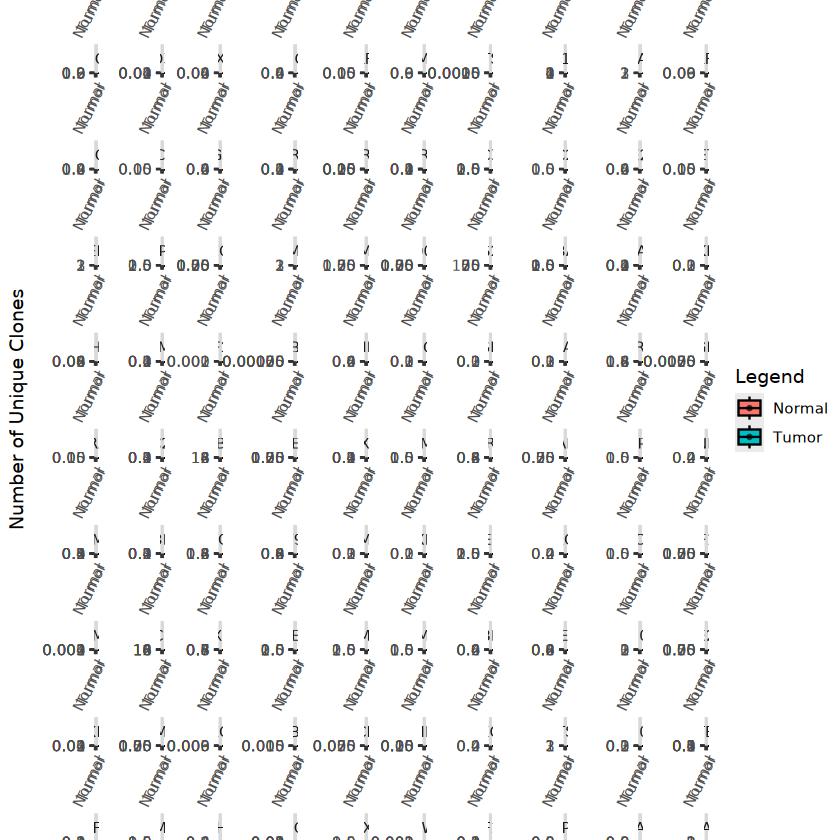

In [20]:
summary_plot <- ggplot(MHCI_avg, aes(x = site, y = avg.exp, fill = site)) +
  geom_boxplot(position= "dodge", color = "black") +  # Boxplot without outliers shown
  geom_jitter(width = 0.2, alpha = 0.6, color = "black", size = 0.8) +  # Add jittered points
  stat_compare_means(paired = TRUE, method = "wilcox.test", hjust = -3, vjust = 5) +
  facet_wrap(~features.plot, scales = 'free', ncol = 10) +
  theme(axis.text.x = element_text(angle = 65, hjust = 1)) +
  labs(title = "MHCI_avg Markers Summaru",
       x = "Site",
       y = "Average Expression",
       fill = "Legend")

summary_plot
ggsave("test.jpeg", plot = summary_plot, width = 25, height = 90, units = "in", dpi = 100, limitsize = FALSE)

In [28]:
library(rstatix)

In [14]:
stat.test <- MHCI_avg %>%
  group_by(features.plot) %>%
  t_test(avg.exp ~ site) %>%
  adjust_pvalue() %>%
  add_significance("p.adj")
stat.test

table(stat.test$p.adj.signif)

features.plot,.y.,group1,group2,n1,n2,statistic,df,p,p.adj,p.adj.signif
<fct>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
KLHL13,avg.exp,Normal,Tumor,21,21,-2.5414633,23.92649,1.79e-02,1.00000000,ns
CDC27,avg.exp,Normal,Tumor,21,21,0.5507192,26.09338,5.87e-01,1.00000000,ns
FBXL3,avg.exp,Normal,Tumor,21,21,-1.4714102,39.93304,1.49e-01,1.00000000,ns
ASB4,avg.exp,Normal,Tumor,21,21,-1.6247841,20.00000,1.20e-01,1.00000000,ns
MYLIP,avg.exp,Normal,Tumor,21,21,0.7316180,37.93963,4.69e-01,1.00000000,ns
PSMB1,avg.exp,Normal,Tumor,21,21,-0.5993291,39.99866,5.52e-01,1.00000000,ns
UBE3C,avg.exp,Normal,Tumor,21,21,-0.1664352,25.55700,8.69e-01,1.00000000,ns
BTK,avg.exp,Normal,Tumor,21,21,1.2458537,34.93130,2.21e-01,1.00000000,ns
MRC2,avg.exp,Normal,Tumor,21,21,-3.3956177,20.03617,2.86e-03,0.98956000,ns



      *  ** ***  ns 
  2  12  10   3 390 

In [55]:
stat.test2 <- MHCII_avg %>%
  group_by(features.plot) %>%
  t_test(avg.exp ~ site) %>%
  adjust_pvalue() %>%
  add_significance("p.adj")
stat.test2

table(stat.test2$p.adj.signif)

features.plot,.y.,group1,group2,n1,n2,statistic,df,p,p.adj,p.adj.signif
<fct>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
AP2B1,avg.exp,Normal,Tumor,21,21,0.61492071,22.40989,5.45e-01,1.00000e+00,ns
CD74,avg.exp,Normal,Tumor,21,21,2.07200562,37.80467,4.51e-02,1.00000e+00,ns
AP2S1,avg.exp,Normal,Tumor,21,21,-0.87327502,29.85502,3.89e-01,1.00000e+00,ns
CTSA,avg.exp,Normal,Tumor,21,21,0.03416891,39.30857,9.73e-01,1.00000e+00,ns
KIF26A,avg.exp,Normal,Tumor,21,21,-1.16603823,20.00000,2.57e-01,1.00000e+00,ns
KIF2A,avg.exp,Normal,Tumor,21,21,-1.01685563,34.28009,3.16e-01,1.00000e+00,ns
AP1M1,avg.exp,Normal,Tumor,21,21,-0.17132505,22.95861,8.65e-01,1.00000e+00,ns
RAB7A,avg.exp,Normal,Tumor,21,21,-0.84236885,29.84886,4.06e-01,1.00000e+00,ns
TUBA3D,avg.exp,Normal,Tumor,21,21,-1.55946167,20.00000,1.35e-01,1.00000e+00,ns



   *   **  *** ****   ns 
   2    3    2    2  137 

In [15]:
# Filter the data frame to extract rows with asterisks in the 'p.adj.signif' column
significant_rows <- stat.test[grepl("\\*", stat.test$p.adj.signif), ]

# View the filtered rows
head(significant_rows)
sig.genes <- significant_rows$features.plot

sig.genes

sig.p_val <- significant_rows$p.adj

features.plot,.y.,group1,group2,n1,n2,statistic,df,p,p.adj,p.adj.signif
<fct>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
CUL7,avg.exp,Normal,Tumor,21,21,-4.942695,39.51568,1.46e-05,0.00589840,**
NEDD4L,avg.exp,Normal,Tumor,21,21,-5.788126,25.25495,4.75e-06,0.00195225,**
KEAP1,avg.exp,Normal,Tumor,21,21,-4.621729,39.62545,3.98e-05,0.01592000,*
KLHL42,avg.exp,Normal,Tumor,21,21,-4.380097,39.74063,8.41e-05,0.03305130,*
FBXL19,avg.exp,Normal,Tumor,21,21,-5.610357,39.50936,1.73e-06,0.00071795,***
ELOB,avg.exp,Normal,Tumor,21,21,-5.090467,35.02494,1.22e-05,0.00494100,**


[1] CUL7    NEDD4L  KEAP1   KLHL42  FBXL19  ELOB    SEC61B  UBE2R2  WSB1   
[10] PSMD9   HECTD3  UBAC1   TRAF7   LRRC41  UBE2G1  FBXL8   ANAPC11 KLHL3  
[19] SEC13   DTX3L   B2M     FBXW8   MEX3C   HMGB1   HLA-E  
450 Levels: KLHL13 CDC27 FBXL3 ASB4 MYLIP PSMB1 UBE3C BTK MRC2 PSMC4 ... CD74

In [ ]:
# Filter the data frame to extract rows with asterisks in the 'p.adj.signif' column
significant_rows2 <- stat.test2[grepl("\\*", stat.test2$p.adj.signif), ]

# View the filtered rows
head(significant_rows2)
sig.genes2 <- significant_rows$features.plot

sig.genes2

sig.p_val2 <- significant_rows$p.adj

In [16]:
# Order the dataset by ascending p-value
geneset_data <- stat.test[order(stat.test$p.adj), ]

# Add a rank column, ranking the genes by p-value (1 being the smallest)
geneset_data$rank <- seq_len(nrow(geneset_data))

# Calculate the BH critical value (Q) for each gene
total_samples <- 450  # Total number of samples
geneset_data$Q <- geneset_data$rank / total_samples

# View the updated dataset
head(geneset_data)


# Filter the dataset to include only genes with Q < 0.05
significant_genes <- geneset_data[geneset_data$Q < 0.05, ]

# Count the number of such genes
num_significant_genes <- nrow(significant_genes)

significant_genes
sig.genes <- significant_genes$features.plot
# Print the result
print(paste("Number of genes with critical value (Q) < 0.05:", num_significant_genes))

features.plot,.y.,group1,group2,n1,n2,statistic,df,p,p.adj,p.adj.signif,rank,Q
<fct>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<int>,<dbl>
FBXL19,avg.exp,Normal,Tumor,21,21,-5.610357,39.50936,1.73e-06,0.00071795,***,1,0.002222222
HLA-E,avg.exp,Normal,Tumor,21,21,5.655621,37.24791,1.80e-06,0.00074520,***,2,0.004444444
UBE2G1,avg.exp,Normal,Tumor,21,21,-5.684485,36.04272,1.83e-06,0.00075579,***,3,0.006666667
FBXL8,avg.exp,Normal,Tumor,21,21,-5.617178,30.79917,3.74e-06,0.00154088,**,4,0.008888889
NEDD4L,avg.exp,Normal,Tumor,21,21,-5.788126,25.25495,4.75e-06,0.00195225,**,5,0.011111111
UBE2R2,avg.exp,Normal,Tumor,21,21,-5.314093,37.63314,5.09e-06,0.00208690,**,6,0.013333333


features.plot,.y.,group1,group2,n1,n2,statistic,df,p,p.adj,p.adj.signif,rank,Q
<fct>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<int>,<dbl>
FBXL19,avg.exp,Normal,Tumor,21,21,-5.610357,39.50936,1.73e-06,0.00071795,***,1,0.002222222
HLA-E,avg.exp,Normal,Tumor,21,21,5.655621,37.24791,1.80e-06,0.00074520,***,2,0.004444444
UBE2G1,avg.exp,Normal,Tumor,21,21,-5.684485,36.04272,1.83e-06,0.00075579,***,3,0.006666667
FBXL8,avg.exp,Normal,Tumor,21,21,-5.617178,30.79917,3.74e-06,0.00154088,**,4,0.008888889
NEDD4L,avg.exp,Normal,Tumor,21,21,-5.788126,25.25495,4.75e-06,0.00195225,**,5,0.011111111
UBE2R2,avg.exp,Normal,Tumor,21,21,-5.314093,37.63314,5.09e-06,0.00208690,**,6,0.013333333
B2M,avg.exp,Normal,Tumor,21,21,5.234534,39.94927,5.61e-06,0.00229449,**,7,0.015555556
WSB1,avg.exp,Normal,Tumor,21,21,5.124188,39.21438,8.35e-06,0.00340680,**,8,0.017777778
HECTD3,avg.exp,Normal,Tumor,21,21,-5.121053,39.25264,8.41e-06,0.00342287,**,9,0.020000000


[1] "Number of genes with critical value (Q) < 0.05: 22"


In [56]:
# Order the dataset by ascending p-value
geneset_data2 <- stat.test2[order(stat.test2$p.adj), ]

# Add a rank column, ranking the genes by p-value (1 being the smallest)
geneset_data2$rank <- seq_len(nrow(geneset_data2))

# Calculate the BH critical value (Q) for each gene
total_samples <- 157  # Total number of samples
geneset_data2$Q <- geneset_data2$rank / total_samples

# View the updated dataset
head(geneset_data2)


# Filter the dataset to include only genes with Q < 0.05
significant_genes2 <- geneset_data2[geneset_data2$Q < 0.05, ]

# Count the number of such genes
num_significant_genes2 <- nrow(significant_genes2)

significant_genes2
sig.genes2 <- significant_genes2$features.plot
# Print the result
print(paste("Number of genes with critical value (Q) < 0.05:", num_significant_genes2))

features.plot,.y.,group1,group2,n1,n2,statistic,df,p,p.adj,p.adj.signif,rank,Q
<fct>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<int>,<dbl>
AP1S1,avg.exp,Normal,Tumor,21,21,-7.083114,39.96474,1.44e-08,2.10240e-06,****,1,0.006369427
DYNLL1,avg.exp,Normal,Tumor,21,21,-6.291504,34.30083,3.48e-07,5.04600e-05,****,2,0.012738854
B2M,avg.exp,Normal,Tumor,21,21,5.234534,39.94927,5.61e-06,8.07840e-04,***,3,0.019108280
TUBB2A,avg.exp,Normal,Tumor,21,21,-5.811664,23.06974,6.31e-06,9.02330e-04,***,4,0.025477707
DCTN3,avg.exp,Normal,Tumor,21,21,-5.113626,39.99188,8.24e-06,1.17008e-03,**,5,0.031847134
CTSH,avg.exp,Normal,Tumor,21,21,-5.026434,27.15953,2.79e-05,3.93390e-03,**,6,0.038216561


features.plot,.y.,group1,group2,n1,n2,statistic,df,p,p.adj,p.adj.signif,rank,Q
<fct>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<int>,<dbl>
AP1S1,avg.exp,Normal,Tumor,21,21,-7.083114,39.96474,1.44e-08,2.10240e-06,****,1,0.006369427
DYNLL1,avg.exp,Normal,Tumor,21,21,-6.291504,34.30083,3.48e-07,5.04600e-05,****,2,0.012738854
B2M,avg.exp,Normal,Tumor,21,21,5.234534,39.94927,5.61e-06,8.07840e-04,***,3,0.019108280
TUBB2A,avg.exp,Normal,Tumor,21,21,-5.811664,23.06974,6.31e-06,9.02330e-04,***,4,0.025477707
DCTN3,avg.exp,Normal,Tumor,21,21,-5.113626,39.99188,8.24e-06,1.17008e-03,**,5,0.031847134
CTSH,avg.exp,Normal,Tumor,21,21,-5.026434,27.15953,2.79e-05,3.93390e-03,**,6,0.038216561
SEC13,avg.exp,Normal,Tumor,21,21,-4.558585,38.14098,5.18e-05,7.25200e-03,**,7,0.044585987


[1] "Number of genes with critical value (Q) < 0.05: 7"


In [17]:
# Filter the dataset
filtered_dataset <- MHCI_avg %>%
  filter(features.plot %in% sig.genes)

#filtered_dataset$p_val <- sig.p_val

head(filtered_dataset)


,avg.exp,pct.exp,features.plot,id,avg.exp.scaled,site,patient
,<dbl>,<dbl>,<fct>,<chr>,<dbl>,<chr>,<chr>
CUL7,0.05463282,2.460790,CUL7,Tumor Bcell_30021,-0.02288251,Tumor,30021
NEDD4L,0.17052264,7.454480,NEDD4L,Tumor Bcell_30021,0.99335896,Tumor,30021
KEAP1,0.22707848,10.420047,KEAP1,Tumor Bcell_30021,0.50458723,Tumor,30021
FBXL19,0.02075661,1.018569,FBXL19,Tumor Bcell_30021,0.14011962,Tumor,30021
ELOB,3.21563586,71.885704,ELOB,Tumor Bcell_30021,0.35710387,Tumor,30021
SEC61B,2.55278020,65.017126,SEC61B,Tumor Bcell_30021,0.23579146,Tumor,30021


In [25]:
#library(GEOquery)

read_counts <- function(file){
    x <- read.table(file)
    x <- as.data.frame(x)
    genes <- x$Gene
    rownames(x) <- genes
    return(as.matrix(x))
}

read_meta <- function(file){
    y <- read.table(file)
    y <- as.data.frame(y)
    cells <- y$Cells
    y <- y[,-1]
    rownames(y) <- cells
    return(y)
}

#dat <- read.table(file = "/home/exacloud/gscratch/ShreeLab/FabianS/Jupyter/GSE182434/GSE182434_raw_count_matrix.txt")
#gse <-getGEO(GEO = 'GSE182434', GSEMatrix = TRUE)
#file <- "/home/exacloud/gscratch/ShreeLab/FabianS/Jupyter/GSE182434/GSE182434_raw_count_matrix.txt"
#counts <- read_counts(file)
counts

meta_file <- "/home/exacloud/gscratch/ShreeLab/FabianS/Jupyter/GSE182434/GSE182434_cell_annotation.txt"
meta <- read_meta(meta_file)
meta

GSE_Seurat <- CreateSeuratObject(counts = counts, meta.data = meta, names.field = 4)

V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,⋯,V28408,V28409,V28410,V28411,V28412,V28413,V28414,V28415,V28416,V28417
Gene,AAACCTGAGTTAAGTG_DLBCL002B,AAACCTGCATGTAAGA_DLBCL002B,AAACCTGTCGCGCCAA_DLBCL002B,AAACGGGAGACTTTCG_DLBCL002B,AAACGGGCATGTTGAC_DLBCL002B,AAACGGGTCATAGCAC_DLBCL002B,AAACGGGTCCGAAGAG_DLBCL002B,AAACGGGTCCTTCAAT_DLBCL002B,AAACGGGTCGCCAGCA_DLBCL002B,⋯,TTTGGTTGTATGCTTG_T2NB,TTTGGTTGTCCGTGAC_T2NB,TTTGGTTGTTCCACGG_T2NB,TTTGGTTTCGGTGTTA_T2NB,TTTGTCAAGCCAGAAC_T2NB,TTTGTCACATGGGAAC_T2NB,TTTGTCACATGGTCTA_T2NB,TTTGTCAGTAAGTTCC_T2NB,TTTGTCAGTGACTCAT_T2NB,TTTGTCATCTGATTCT_T2NB
MIR1302-2HG,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
FAM138A,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
OR4F5,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
AL627309.1,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
AL627309.3,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
AL627309.2,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
AL627309.5,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
AL627309.4,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
AP006222.2,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0


V2,V3,V4,V5,V6,V7
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
Patient,Sample,CellType,TumorNormal,COO,Tissue
DLBCL002,DLBCL002B,B cells,Normal,ABC,DLBCL
DLBCL002,DLBCL002B,B cells,Tumor,ABC,DLBCL
DLBCL002,DLBCL002B,B cells,Tumor,ABC,DLBCL
DLBCL002,DLBCL002B,B cells,Tumor,ABC,DLBCL
DLBCL002,DLBCL002B,B cells,Tumor,ABC,DLBCL
DLBCL002,DLBCL002B,B cells,Tumor,ABC,DLBCL
DLBCL002,DLBCL002B,B cells,Tumor,ABC,DLBCL
DLBCL002,DLBCL002B,B cells,Tumor,ABC,DLBCL


Warning message:
“Data is of class matrix. Coercing to dgCMatrix.”
Warning message in matrix(data = as.numeric(x = x), ncol = nc):
“NAs introduced by coercion”
Warning message:
“Input parameters result in NA values for initial cell identities. Setting all initial idents to the project name”


In [32]:
table(GSE_Seurat$V4)
#CELL TYPES


     Normal       Tumor TumorNormal 
       4037       24379           1 

In [18]:
Merged_patients <- subsetted_obj

In [5]:
Gene_set <- c("AR", "NR3C1", "NR3C2", "ESR1", "ESR2", "AICDA")
Merged_patients$barcode <- colnames(Merged_patients)
i <- 0
# Initialize a list to store data for each gene
vln_data_list <- list()
final_vln_data <- data.frame()
# Loop over each gene in the Gene_set
for (gene in Gene_set) {
  # Generate the VlnPlot for the current gene
  test <- VlnPlot(Merged_patients, features = gene, group.by = "new.ident", combine = FALSE)
  
  # Extract the data from the VlnPlot object
  vln_data <- test[[1]]$data
  if(i == 0){
    final_vln_data <- vln_data
    i <- i + 1
  }
  else{
    # Store the extracted data in the list using the gene name as the key
    print(colnames(final_vln_data))
    print(colnames(vln_data))
    str(final_vln_data)
    str(vln_data)
    final_vln_data <- full_join(final_vln_data, vln_data, by = "ident")
  }
  

}
# Check the structure of the combined data frame
str(final_vln_data)

#write.csv(test$data, file = "merged_patients_AR-ER_expression.csv")

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



[1] "AR"    "ident"
[1] "NR3C1" "ident"
'data.frame':	305921 obs. of  2 variables:
 $ AR   : num  1.37e-05 -5.65e-06 3.63e-06 6.33e-06 4.04e-06 ...
 $ ident: Factor w/ 8 levels "Tcell","Tumor Bcell",..: 1 2 1 1 4 2 2 2 2 2 ...
'data.frame':	305921 obs. of  2 variables:
 $ NR3C1: num  1.83 2.34 3.63e-06 6.33e-06 4.04e-06 ...
 $ ident: Factor w/ 8 levels "Tcell","Tumor Bcell",..: 1 2 1 1 4 2 2 2 2 2 ...


ERROR: [1m[33mError[39m in `full_join()`:[22m
[1m[22m[33m![39m This join would result in more rows than dplyr can handle.
[36mℹ[39m 37523977851 rows would be returned. 2147483647 rows is the maximum number allowed.
[36mℹ[39m Double check your join keys. This error commonly occurs due to a missing join key, or an improperly specified join condition.


In [20]:
Gene_set <- c("AR", "NR3C1", "NR3C2", "ESR1", "ESR2", "AICDA")
Merged_patients$barcode <- colnames(Merged_patients)
test <- VlnPlot(Merged_patients, features = Gene_set, group.by = "new.ident", combine = TRUE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



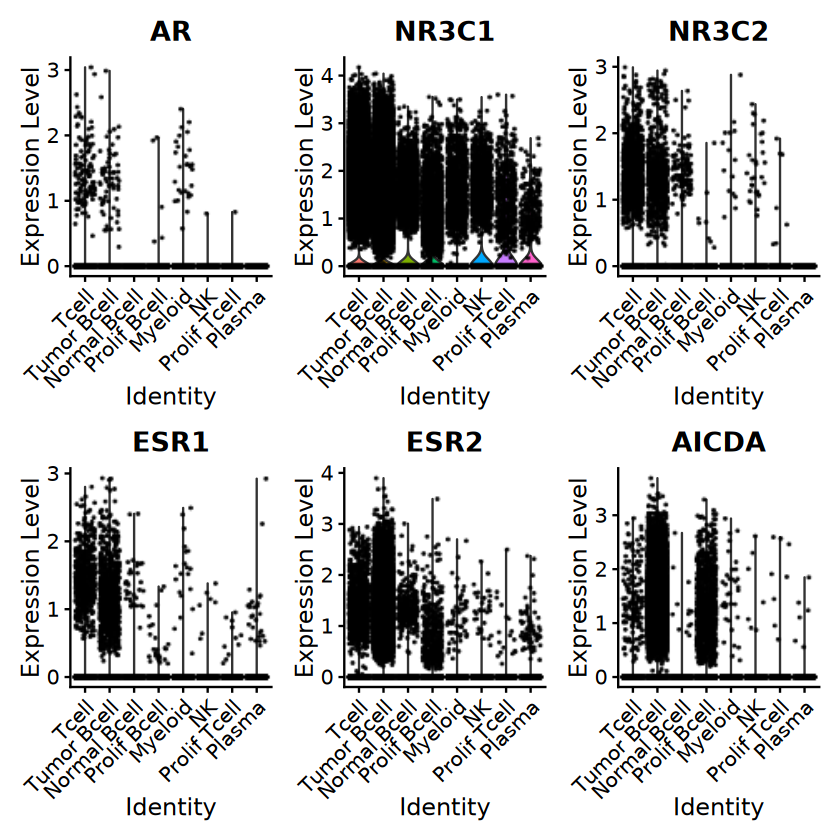

In [21]:
test

In [13]:
library(data.table)


Attaching package: ‘data.table’


The following objects are masked from ‘package:dplyr’:

    between, first, last




In [20]:
# Ensure all variables are vectors
lapply(list(barcodes, idents, AR, NR3C1, NR3C2, ESR1, ESR2), class)

barcodes <- unlist(barcodes)
#barcodes <- as.vector(barcodes)
idents <- as.vector(idents)
AR <- as.vector(AR)
NR3C1 <- as.vector(NR3C1)
NR3C2 <- as.vector(NR3C2)
ESR1 <- as.vector(ESR1)
ESR2 <- as.vector(ESR2)

lapply(list(barcodes, idents, AR, NR3C1, NR3C2, ESR1, ESR2), class)


ERROR: Error in lapply(list(barcodes, idents, AR, NR3C1, NR3C2, ESR1, ESR2), : object 'barcodes' not found


In [18]:
lengths <- sapply(list(barcodes, idents, AR, NR3C1, NR3C2, ESR1, ESR2), length)
print(lengths)  # Ensure they all return the same value (e.g., 1.5 million)
# Check if there are missing elements
which.min(lengths)  # Identify the shortest column

[1] 1529605 1529605 1529605 1529605 1529605 1529605 1529605


[1] 1

In [20]:
write.csv(final_vln_data, file = "merged_patients_AR-ER_expression.csv")

In [46]:
# Create a list of your data frames with their respective gene names
data_list <- list(AR = AR, NR3C1 = NR3C1, NR3C2 = NR3C2, ESR1 = ESR1, ESR2 = ESR2, AICDA = AICDA)

# Extract unique barcodes from all data frames
all_barcodes <- unique(unlist(lapply(data_list, function(df) df$barcodes)))

# Create an empty data frame to hold the merged results
merged_data <- data.frame(
  Barcode = all_barcodes,
  stringsAsFactors = FALSE  # Ensure strings are not converted to factors
)

# Initialize columns for each gene with 0
for (gene in names(data_list)) {
  merged_data[[gene]] <- 0  # Set default value to 0 for each gene
}

# Initialize the ident column
merged_data$ident <- NA  # Add the ident column to merged_data

# Loop through the list of data frames and populate the corresponding gene columns where barcodes match
for (gene in names(data_list)) {
  df <- data_list[[gene]]  # Get the current data frame
  
  # Print column names for debugging
  print(paste("Checking data frame for gene:", gene))
  print(df$barcodes[1:10])  # Display column names
  df <- as.data.frame(df)
  str(df)
  
  # Ensure df is a data frame and has a barcodes column
  if (is.data.frame(df)) {
    # Find matching barcodes
    matched <- df[df$barcodes %in% merged_data$Barcode, ]
    
    # Update gene column where barcodes match
    merged_data[match(matched$barcodes, merged_data$Barcode), gene] <- matched[[gene]]
    
    # Update 'ident' column, keeping the first occurrence
    for (j in seq_len(nrow(matched))) {
      idx <- which(merged_data$Barcode == matched$barcodes[j])
      if (is.na(merged_data$ident[idx])) {
        merged_data$ident[idx] <- matched$ident[j]
      }
    }
  } else {
    warning(paste("Data frame for gene", gene, "is not valid or does not contain a barcodes column."))
  }
}

# Verify the result
head(merged_data)
str(merged_data)
# Save to CSV
write.csv(merged_data, "merged_data.csv", row.names = FALSE)


[1] "Checking data frame for gene: AR"
 [1] "30021_lesA_pre-AAACCTGAGCCACCTG" "30021_lesA_pre-AAACCTGAGCTGATAA"
 [3] "30021_lesA_pre-AAACCTGAGTACTTGC" "30021_lesA_pre-AAACCTGCACCTCGTT"
 [5] "30021_lesA_pre-AAACCTGCACGGCCAT" "30021_lesA_pre-AAACCTGCAGACGCAA"
 [7] "30021_lesA_pre-AAACCTGGTATAATGG" "30021_lesA_pre-AAACCTGGTCATGCCG"
 [9] "30021_lesA_pre-AAACCTGGTTCCAACA" "30021_lesA_pre-AAACCTGGTTCGCTAA"
'data.frame':	305921 obs. of  3 variables:
 $ AR      : num  1.37e-05 -5.65e-06 3.63e-06 6.33e-06 4.04e-06 ...
 $ ident   : Factor w/ 8 levels "Tcell","Tumor Bcell",..: 1 2 1 1 4 2 2 2 2 2 ...
 $ barcodes: chr  "30021_lesA_pre-AAACCTGAGCCACCTG" "30021_lesA_pre-AAACCTGAGCTGATAA" "30021_lesA_pre-AAACCTGAGTACTTGC" "30021_lesA_pre-AAACCTGCACCTCGTT" ...
[1] "Checking data frame for gene: NR3C1"
 [1] "30021_lesA_pre-AAACCTGAGCCACCTG" "30021_lesA_pre-AAACCTGAGCTGATAA"
 [3] "30021_lesA_pre-AAACCTGAGTACTTGC" "30021_lesA_pre-AAACCTGCACCTCGTT"
 [5] "30021_lesA_pre-AAACCTGCACGGCCAT" "30021_lesA_pre-AA

,Barcode,AR,NR3C1,NR3C2,ESR1,ESR2,ident
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
1,30021_lesA_pre-AAACCTGAGCCACCTG,1.370958e-05,1.827514e+00,1.370958e-05,1.370958e-05,1.370958e-05,1
2,30021_lesA_pre-AAACCTGAGCTGATAA,-5.646982e-06,2.335497e+00,-5.646982e-06,-5.646982e-06,-5.646982e-06,2
3,30021_lesA_pre-AAACCTGAGTACTTGC,3.631284e-06,3.631284e-06,3.631284e-06,3.631284e-06,3.631284e-06,1
4,30021_lesA_pre-AAACCTGCACCTCGTT,6.328626e-06,6.328626e-06,6.328626e-06,6.328626e-06,6.328626e-06,1
5,30021_lesA_pre-AAACCTGCACGGCCAT,4.042683e-06,4.042683e-06,4.042683e-06,4.042683e-06,4.042683e-06,4
6,30021_lesA_pre-AAACCTGCAGACGCAA,-1.061245e-06,1.463266e+00,-1.061245e-06,-1.061245e-06,-1.061245e-06,2


'data.frame':	305921 obs. of  7 variables:
 $ Barcode: chr  "30021_lesA_pre-AAACCTGAGCCACCTG" "30021_lesA_pre-AAACCTGAGCTGATAA" "30021_lesA_pre-AAACCTGAGTACTTGC" "30021_lesA_pre-AAACCTGCACCTCGTT" ...
 $ AR     : num  1.37e-05 -5.65e-06 3.63e-06 6.33e-06 4.04e-06 ...
 $ NR3C1  : num  1.83 2.34 3.63e-06 6.33e-06 4.04e-06 ...
 $ NR3C2  : num  1.37e-05 -5.65e-06 3.63e-06 6.33e-06 4.04e-06 ...
 $ ESR1   : num  1.37e-05 -5.65e-06 3.63e-06 6.33e-06 4.04e-06 ...
 $ ESR2   : num  1.37e-05 -5.65e-06 3.63e-06 6.33e-06 4.04e-06 ...
 $ ident  : int  1 2 1 1 4 2 2 2 2 2 ...


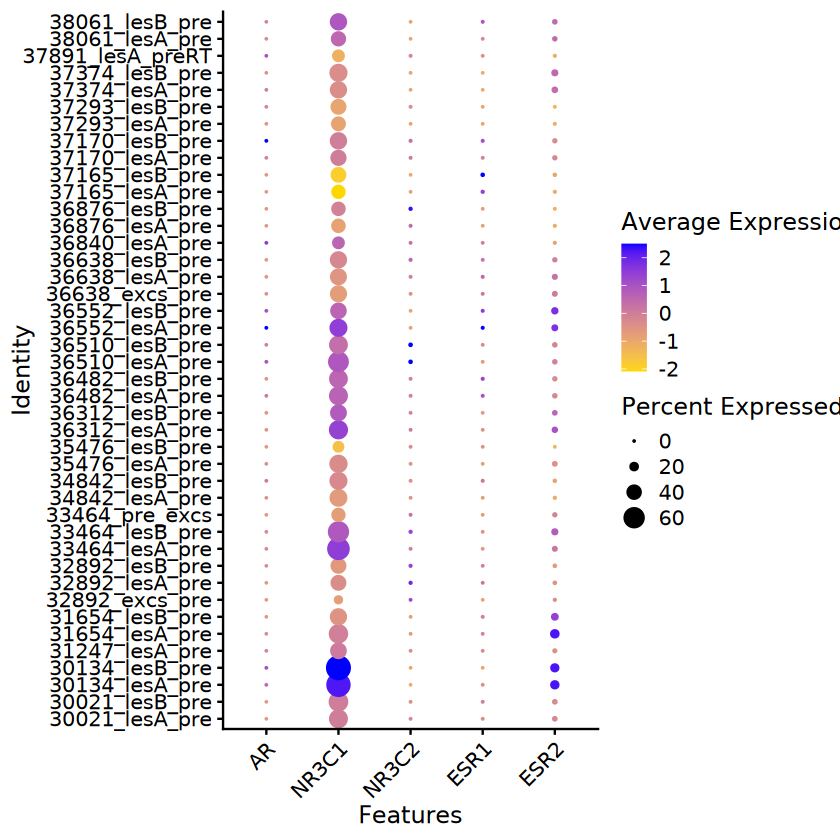

In [28]:
Dot.p <- DotPlot(object = Merged_patients, features = Gene_set, group.by = 'patient.site.timepoint', cols = c("gold", "blue"))
Dot.p <- Dot.p + theme(axis.text.x = element_text(angle = 45, hjust = 1))
Dot.p

In [1]:
library(Seurat)
library(ggplot2)
library(grid)
library(dplyr)

Merged_patients <- readRDS("/home/exacloud/gscratch/ShreeLab/FabianS/Jupyter/Merged_patients_sub.RDS")

Loading required package: SeuratObject

Loading required package: sp


Attaching package: ‘SeuratObject’


The following objects are masked from ‘package:base’:

    intersect, t



Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union




In [5]:
Merged_patients_other <- subset(Merged_patients, idents = setdiff(levels(Merged_patients), c("Tcell", "Tumor Bcell")))

,orig.ident,nCount_RNA,nFeature_RNA,patient,site,timepoint,site.timepoint,tissue,patient.timepoint,patient.site,⋯,RNA_snn_res.1.4,RNA_snn_res.1.2,RNA_snn_res.1,RNA_snn_res.0.8,RNA_snn_res.0.65,RNA_snn_res.0.7,RNA_snn_res.0.75,RNA_snn_res.0.9,RNA_snn_res.0.85,new.ident
,<chr>,<dbl>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>
30021_lesA_pre-AAACCTGCACGGCCAT,SeuratProject,3606.4758,1450,30021,lesA,pre,lesA_pre,lymph,30021_pre,30021_lesA,⋯,26,23,19,19,15,16,17,18,18,Prolif Bcell
30021_lesA_pre-AAACGGGAGTCAAGGC,SeuratProject,3451.0953,1134,30021,lesA,pre,lesA_pre,lymph,30021_pre,30021_lesA,⋯,26,23,19,19,15,16,17,18,18,Prolif Bcell
30021_lesA_pre-AAAGATGTCGCGCCAA,SeuratProject,1060.3710,490,30021,lesA,pre,lesA_pre,lymph,30021_pre,30021_lesA,⋯,29,29,24,26,22,21,23,26,27,Myeloid
30021_lesA_pre-AAAGCAATCAGTCAGT,SeuratProject,26901.5068,4885,30021,lesA,pre,lesA_pre,lymph,30021_pre,30021_lesA,⋯,26,23,19,19,15,16,17,18,18,Prolif Bcell
30021_lesA_pre-AAAGTAGAGCTAAGAT,SeuratProject,1186.9059,383,30021,lesA,pre,lesA_pre,lymph,30021_pre,30021_lesA,⋯,29,29,24,26,22,21,23,26,27,Myeloid
30021_lesA_pre-AAAGTAGAGGCCGAAT,SeuratProject,1442.3900,708,30021,lesA,pre,lesA_pre,lymph,30021_pre,30021_lesA,⋯,26,23,19,19,15,16,17,18,18,Prolif Bcell
30021_lesA_pre-AAAGTAGGTCCAGTGC,SeuratProject,6969.7157,1690,30021,lesA,pre,lesA_pre,lymph,30021_pre,30021_lesA,⋯,26,23,19,19,15,16,17,18,18,Prolif Bcell
30021_lesA_pre-AAATGCCAGAGTCGGT,SeuratProject,6356.0565,1875,30021,lesA,pre,lesA_pre,lymph,30021_pre,30021_lesA,⋯,26,23,19,19,15,16,17,18,18,Prolif Bcell
30021_lesA_pre-AACCATGCAGCGATCC,SeuratProject,769.3551,384,30021,lesA,pre,lesA_pre,lymph,30021_pre,30021_lesA,⋯,29,29,24,26,22,21,23,26,27,Myeloid


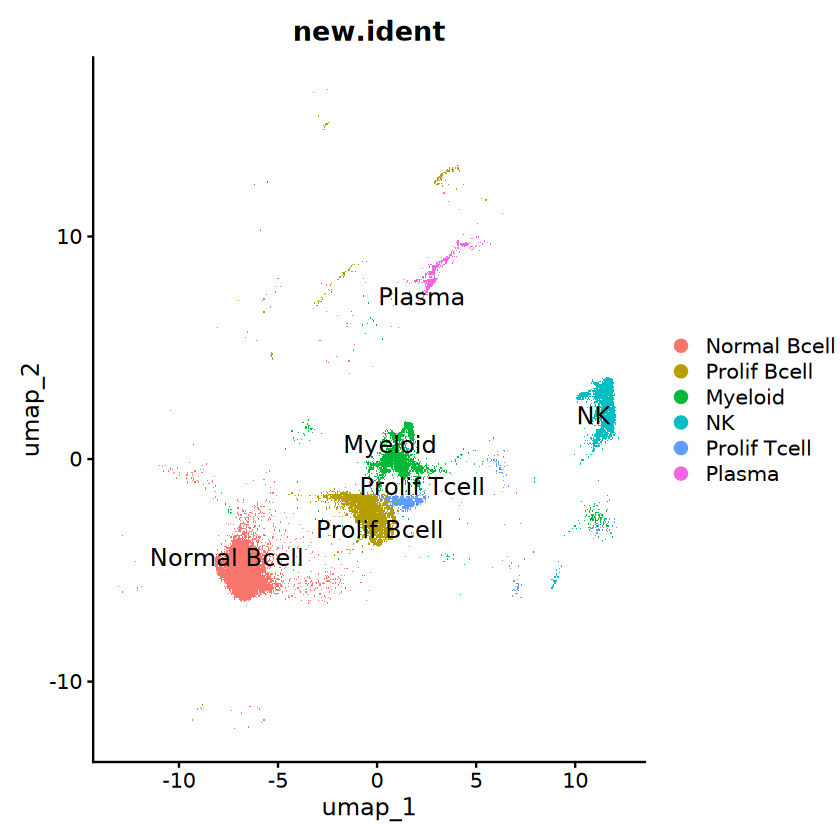

In [7]:
head(Merged_patients_other)
DimPlot(
        Merged_patients_other, reduction = "umap", 
        group.by = "new.ident", label = TRUE, 
        label.size = 5, repel = TRUE, raster = TRUE
    )

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



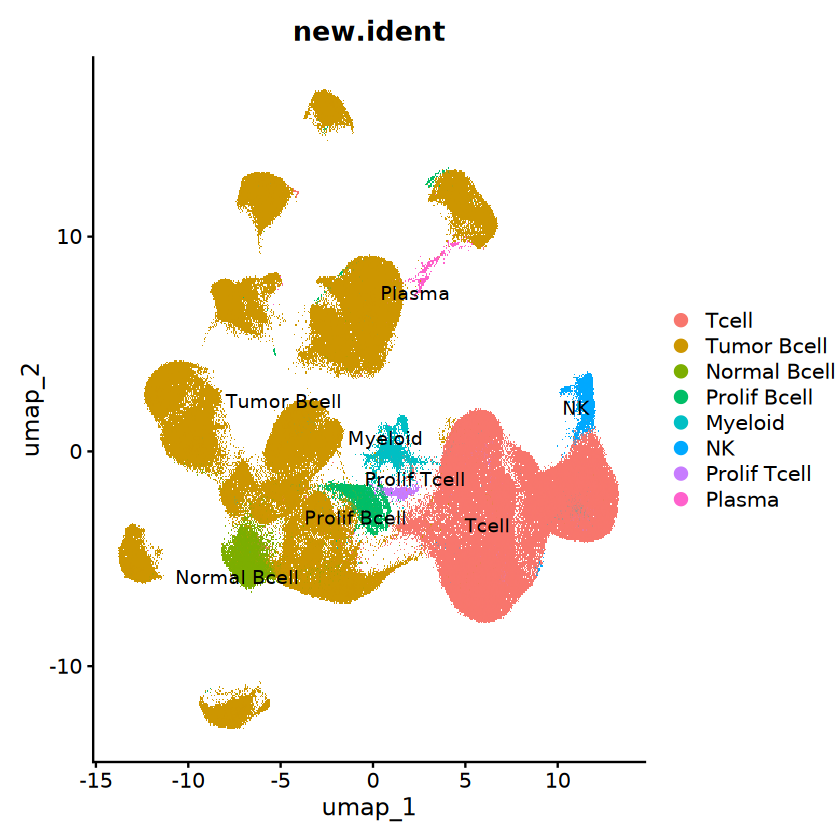

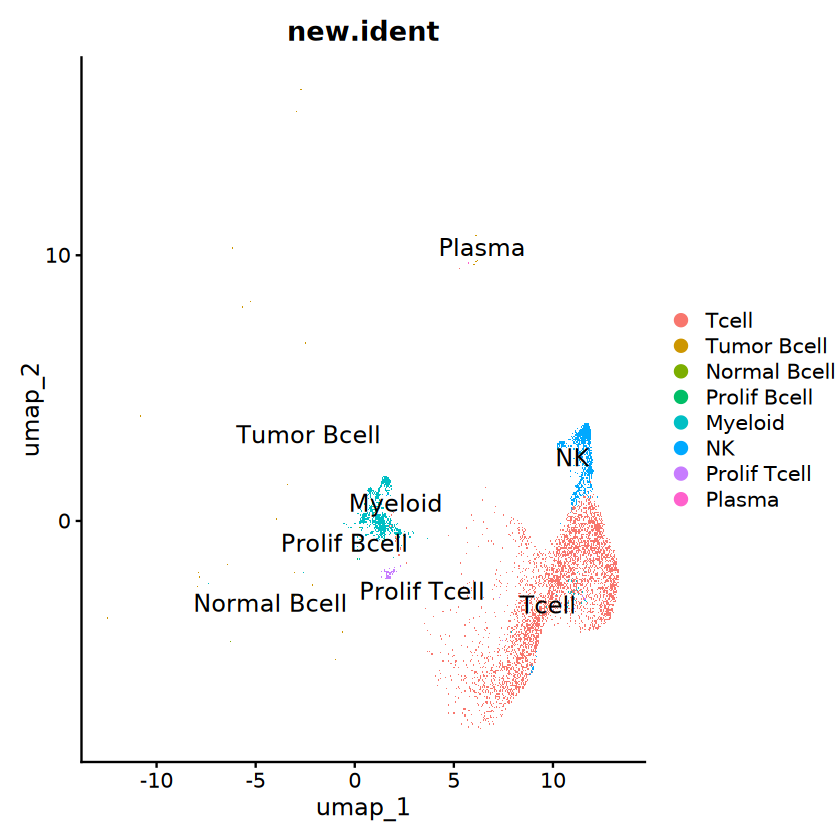

In [25]:
Merged_patients@active.ident <- Merged_patients$"new.ident"
DimPlot(Merged_patients, reduction = "umap", group.by = "new.ident", label = TRUE, repel = TRUE)


# Step 1: Define your gene list
gene_list <- c("LGALS2", "CLEC10A", "C1orf54","CLEC9A", "FDCSP", "CXCL14", "LILRA4", "IL3RA", "APOE", "MMP9", "S100A8", "GZMB", "FCGR3A", "XCL1", "GZMK", "IL7R", "KLRG1")  # Example genes

# Step 2: Retrieve the counts matrix for the RNA assay
counts_matrix <- GetAssayData(Merged_patients, assay = "RNA", slot = "counts")

# Step 3: Identify the indices of the genes in the matrix
gene_indices <- which(rownames(counts_matrix) %in% gene_list)

# Step 4: Ensure that all genes were found
if (length(gene_indices) < length(gene_list)) {
    warning("Some genes were not found in the dataset:")
    print(setdiff(gene_list, rownames(counts_matrix)[gene_indices]))
}

# Step 5: Subsetting logic (choose one)

## Option A: Cells expressing **at least one gene** from the list
expressing_cells <- which(colSums(counts_matrix[gene_indices, ] > 2) > 1)

## Option B: Cells expressing **all genes** in the list
# expressing_cells <- which(colSums(counts_matrix[gene_indices, ] > 0) == length(gene_list))

# Step 6: Retrieve the barcodes of the expressing cells
barcode_list <- colnames(counts_matrix)[expressing_cells]

# Step 7: Subset the Seurat object to retain only these cells
if (length(barcode_list) > 0) {
    sub.merged_obj <- subset(Merged_patients, cells = barcode_list)

    # Step 8: Plot the UMAP
    DimPlot(
        sub.merged_obj, reduction = "umap", 
        group.by = "RNA_snn_res.0.8", label = TRUE, 
        label.size = 5, repel = TRUE, raster = TRUE
    )
    ncol(sub.merged_obj)
    DimPlot(
        sub.merged_obj, reduction = "umap", 
        group.by = "new.ident", label = TRUE, 
        label.size = 5, repel = TRUE, raster = TRUE
    )
} else {
    stop("No cells expressing the specified genes were found.")
}


In [14]:

Merged_patients$id <- colnames(Merged_patients)

# Ensure the barcodes are matching between Dot_plot_cell and Merged_patients
Dot_plot_cell$Phenotype <- Merged_patients$new.ident[match(Dot_plot_cell$id, Merged_patients$id)]
#Dot_plot_sample$Phenotype <- Merged_patients$new.ident[match(Dot_plot_sample$id, Merged_patients$id)]
# Check the updated Dot_plot_cell
Dot_plot_sample$Phenotype <- NULL
head(Dot_plot_cell)
head(Dot_plot_sample)


save(Dot_plot_sample, file = "Dot_plot_sample.Robj")
write.csv(Dot_plot_sample, file = "Dot_plot_sample.csv")

save(Dot_plot_cell, file = "Dot_plot_cell.Robj")
write.csv(Dot_plot_cell, file = "Dot_plot_cell.csv")

,avg.exp,pct.exp,features.plot,id,avg.exp.scaled,Phenotype
,<dbl>,<dbl>,<fct>,<fct>,<dbl>,<fct>
AR,0.000000,0,AR,30021_lesA_pre-AAACCTGAGCCACCTG,-0.02578213,Tcell
NR3C1,5.218321,100,NR3C1,30021_lesA_pre-AAACCTGAGCCACCTG,1.20272159,Tcell
NR3C2,0.000000,0,NR3C2,30021_lesA_pre-AAACCTGAGCCACCTG,-0.08557781,Tcell
ESR1,0.000000,0,ESR1,30021_lesA_pre-AAACCTGAGCCACCTG,-0.06972062,Tcell
ESR2,0.000000,0,ESR2,30021_lesA_pre-AAACCTGAGCCACCTG,-0.24382518,Tcell
AR1,0.000000,0,AR,30021_lesA_pre-AAACCTGAGTACTTGC,-0.02578213,Tcell


,avg.exp,pct.exp,features.plot,id,avg.exp.scaled
,<dbl>,<dbl>,<fct>,<fct>,<dbl>
AR,5.160212e-05,0.01129178,AR,30021_lesA_pre,-0.607399528
NR3C1,2.223776e+00,51.73893406,NR3C1,30021_lesA_pre,0.009497533
NR3C2,2.036402e-02,0.71138211,NR3C2,30021_lesA_pre,-0.221128934
ESR1,1.186814e-02,0.62104788,ESR1,30021_lesA_pre,-0.382403498
ESR2,1.596968e-01,6.93315266,ESR2,30021_lesA_pre,-0.254222838
AR1,0.000000e+00,0.00000000,AR,30021_lesB_pre,-0.616748460


In [17]:
library(data.table)

Gene_set <- c("AR", "NR3C1", "NR3C2", "ESR1", "ESR2", "AICDA")

# Initialize an empty list to store each vln_data table
vln_data_list <- list()

# Create each vln_data and store it in the list, including CellType
vln_data_list[[1]] <- data.table(
    Barcode = test[[1]]$data$barcodes,
    CellType = test[[1]]$data$ident,
    Gene = Gene_set[1],
    Expression = test[[1]]$data$AR 
)

vln_data_list[[2]] <- data.table(
    Barcode = test[[2]]$data$barcodes,
    CellType = test[[2]]$data$ident,
    Gene = Gene_set[2],
    Expression = test[[2]]$data$NR3C1
)

vln_data_list[[3]] <- data.table(
    Barcode = test[[3]]$data$barcodes,
    CellType = test[[3]]$data$ident,
    Gene = Gene_set[3],
    Expression = test[[3]]$data$NR3C2
)

vln_data_list[[4]] <- data.table(
    Barcode = test[[4]]$data$barcodes,
    CellType = test[[4]]$data$ident,
    Gene = Gene_set[4],
    Expression = test[[4]]$data$ESR1
)

vln_data_list[[5]] <- data.table(
    Barcode = test[[5]]$data$barcodes,
    CellType = test[[5]]$data$ident,
    Gene = Gene_set[5],
    Expression = test[[5]]$data$ESR2
)

vln_data_list[[6]] <- data.table(
    Barcode = test[[6]]$data$barcodes,
    CellType = test[[6]]$data$ident,
    Gene = Gene_set[6],
    Expression = test[[6]]$data$AICDA
)

# Combine all vln_data tables into one final data table
final_vln_data <- rbindlist(vln_data_list)

# Ensure CellType is included
final_vln_data <- final_vln_data[, .(Barcode, CellType, Gene, Expression)]

# Verify the dimensions of the final data table
dim(final_vln_data)  # Should now have 4 columns
head(final_vln_data) # Check the first few rows

write.csv(final_vln_data, "merged_data_vln.csv", row.names = FALSE)
save(final_vln_data, file = "final_vln_data.Robj")

[1] 1764864       4

Barcode,CellType,Gene,Expression
<chr>,<fct>,<chr>,<dbl>
30021_lesA_pre-AAACCTGAGCCACCTG,Tcell,AR,1.370958e-05
30021_lesA_pre-AAACCTGAGCTGATAA,Tumor Bcell,AR,-5.646982e-06
30021_lesA_pre-AAACCTGAGTACTTGC,Tcell,AR,3.631284e-06
30021_lesA_pre-AAACCTGCACCTCGTT,Tcell,AR,6.328626e-06
30021_lesA_pre-AAACCTGCACGGCCAT,Prolif Bcell,AR,4.042683e-06
30021_lesA_pre-AAACCTGCAGACGCAA,Tumor Bcell,AR,-1.061245e-06


In [66]:
length(rownames(final_vln_data))

table(final_vln_data$Gene)

[1] 1529605


    AR   ESR1   ESR2  NR3C1  NR3C2 
305921 305921 305921 305921 305921 

In [1]:
library(Seurat)
library(ggplot2)
library(grid)
library(dplyr)
load("/home/exacloud/gscratch/ShreeLab/FabianS/Jupyter/Merged_patients_01.RDS")

Loading required package: SeuratObject

Loading required package: sp


Attaching package: ‘SeuratObject’


The following objects are masked from ‘package:base’:

    intersect, t



Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Warning message in readChar(con, 5L, useBytes = TRUE):
“truncating string with embedded nuls”
Warning message:
“file ‘Merged_patients_01.RDS’ has magic number 'X'
  Use of save versions prior to 2 is deprecated”


ERROR: Error in load("/home/exacloud/gscratch/ShreeLab/FabianS/Jupyter/Merged_patients_01.RDS"): bad restore file magic number (file may be corrupted) -- no data loaded


In [1]:
# Rename cell identity classes for res 1.9
tcells@active.ident <- as.factor(tcells$`RNA_snn_res.1.8`)
# Can provide an arbitrary amount of idents to rename
levels(tcells)
#> [1] "0" "1" "2"
tcells <- RenameIdents(
  tcells,
  '0' = 'CD4.naive',
  '1' = 'CD8.TEM',
  '2' = 'CD4.naive',
  '3' = 'Tfh', 
  '4' = 'Tfh', 
  '5' = 'Treg', 
  '6' = 'CD4.TEM', 
  '7' = 'CD8.TEM', 
  '8' = 'Treg', 
  '9' = 'CD8.TCM', 
  '10' = 'Treg',
  '11' = 'CD4.TEM', 
  '12' = 'CD4.TCM', 
  '13' = 'CD8.TCM',
  '14' = 'Bcell',
  '15' = 'CD8.naive', 
  '16' = 'CD8.TEM', 
  '17' = 'CD8.TEM',
  '18' = 'Bcell', 
  '19' = 'Bcell', 
  '20' = 'Tfh', 
  '21' = 'CD4.TCM', 
  '22' = 'CD8.TEM',
  '23' = 'Tfh', 
  '24' = 'Other', 
  '25' = 'CD8.TEM', 
  '26' = 'NK',
  '27' = 'Prolif', 
  '28' = 'Tr1',
  '29' = 'dnT', 
  '30' = 'CD4.naive', 
  '31' = 'NK', 
  '32' = 'NK', 
  '33' = 'CD4.naive',
  '34' = 'CD8.TCM'
)
levels(tcells)
DimPlot(tcells, reduction = "umap", label = TRUE, label.size = 3 ,repel = TRUE, raster = TRUE)
DimPlot(tcells, reduction = "umap", label = TRUE, label.size = 3 ,repel = TRUE, raster = FALSE)

tcells$new.ident <- tcells@active.ident 
unique(tcells$new.ident)


ERROR: Error in is.factor(x): object 'tcells' not found


[1] "0"  "1"  "2"  "3"  "4"  "5"  "6"  "7"  "8"  "9"  "10" "11" "12" "13" "14"
[16] "15" "16" "17" "18" "19" "20" "21" "22" "23" "24" "25" "26"

[1] "Tumor Bcell"  "Normal Bcell" "Prolif Bcell"

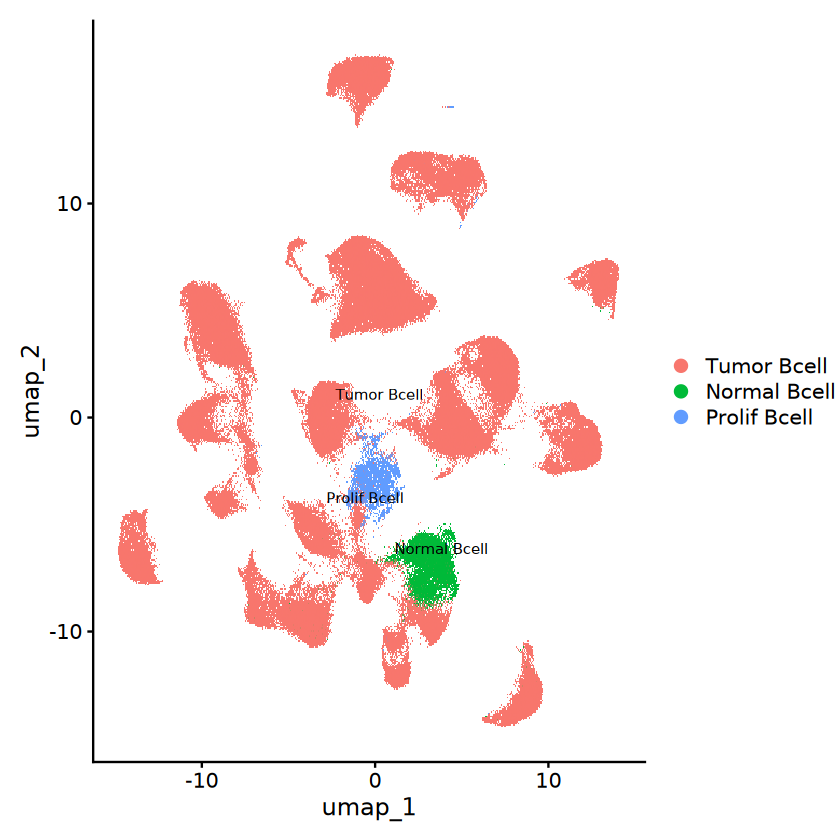

[1] Tumor Bcell  Prolif Bcell Normal Bcell
Levels: Tumor Bcell Normal Bcell Prolif Bcell

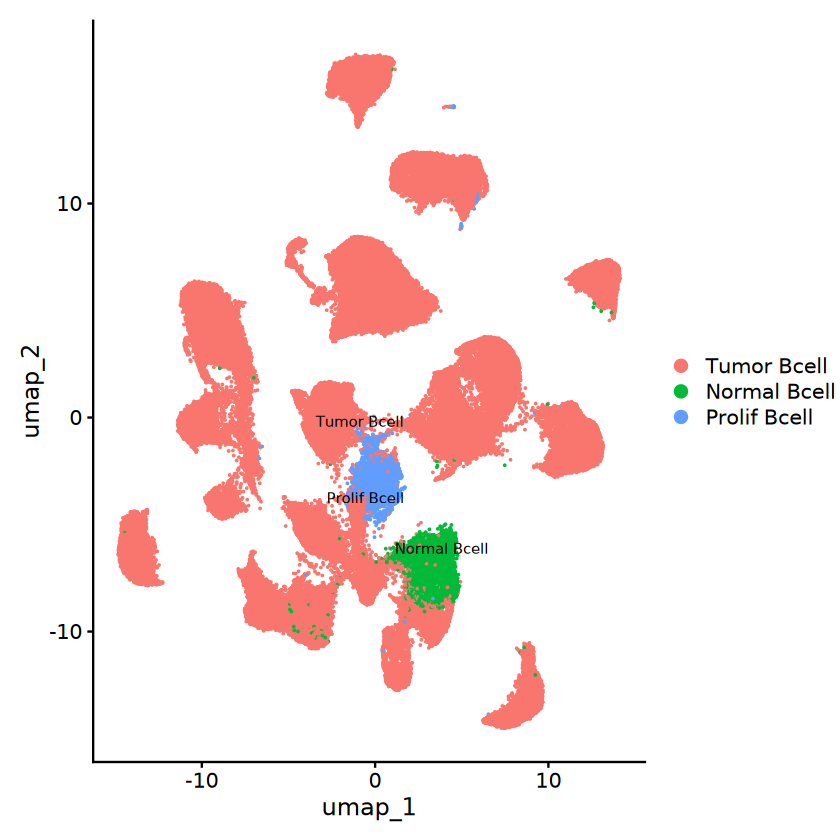

In [8]:
# Rename cell identity classes for res 1.9
bcells@active.ident <- as.factor(bcells$`RNA_snn_res.0.4`)
# Can provide an arbitrary amount of idents to rename
levels(bcells)
#> [1] "0" "1" "2"
bcells <- RenameIdents(
  bcells,
  '0' = 'Tumor Bcell',
  '1' = 'Tumor Bcell',
  '2' = 'Tumor Bcell',
  '3' = 'Tumor Bcell', 
  '4' = 'Normal Bcell', 
  '5' = 'Tumor Bcell', 
  '6' = 'Tumor Bcell', 
  '7' = 'Tumor Bcell', 
  '8' = 'Tumor Bcell', 
  '9' = 'Tumor Bcell', 
  '10' = 'Tumor Bcell',
  '11' = 'Tumor Bcell', 
  '12' = 'Tumor Bcell', 
  '13' = 'Tumor Bcell',
  '14' = 'Tumor Bcell',
  '15' = 'Prolif Bcell', 
  '16' = 'Tumor Bcell', 
  '17' = 'Tumor Bcell',
  '18' = 'Tumor Bcell', 
  '19' = 'Tumor Bcell', 
  '20' = 'Tumor Bcell', 
  '21' = 'Tumor Bcell', 
  '22' = 'Tumor Bcell',
  '23' = 'Tumor Bcell', 
  '24' = 'Tumor Bcell', 
  '25' = 'Tumor Bcell', 
  '26' = 'Tumor Bcell'
)
levels(bcells)
DimPlot(bcells, reduction = "umap", label = TRUE, label.size = 3 ,repel = TRUE, raster = TRUE)
DimPlot(bcells, reduction = "umap", label = TRUE, label.size = 3 ,repel = TRUE, raster = FALSE)

bcells$new.ident <- bcells@active.ident 
unique(bcells$new.ident)


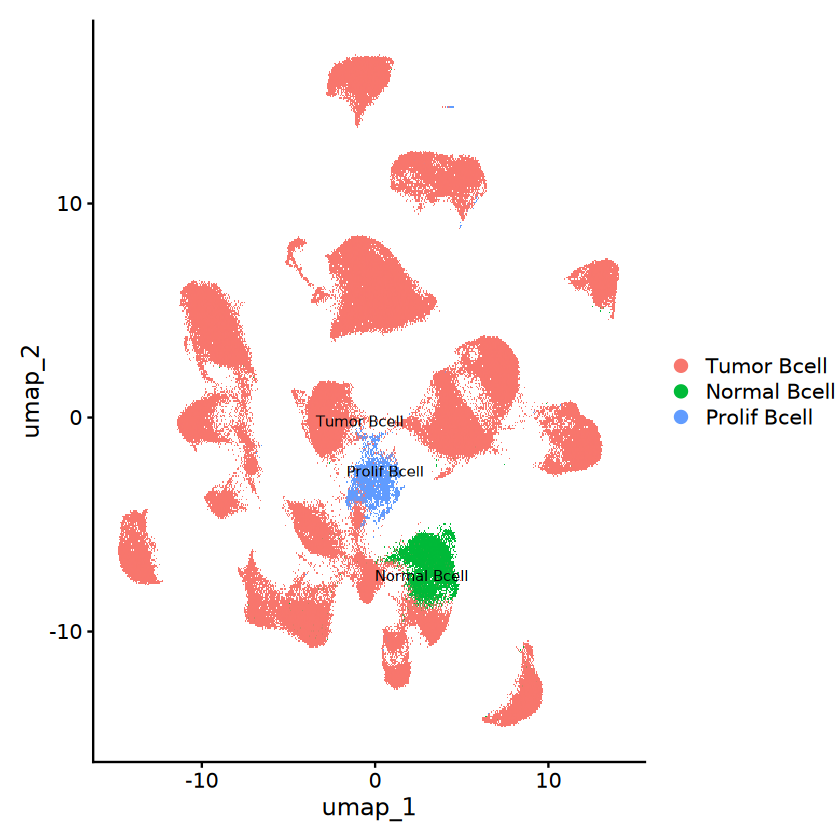

In [4]:
DimPlot(bcells, reduction = "umap", label = TRUE, label.size = 3 ,repel = TRUE, raster = TRUE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



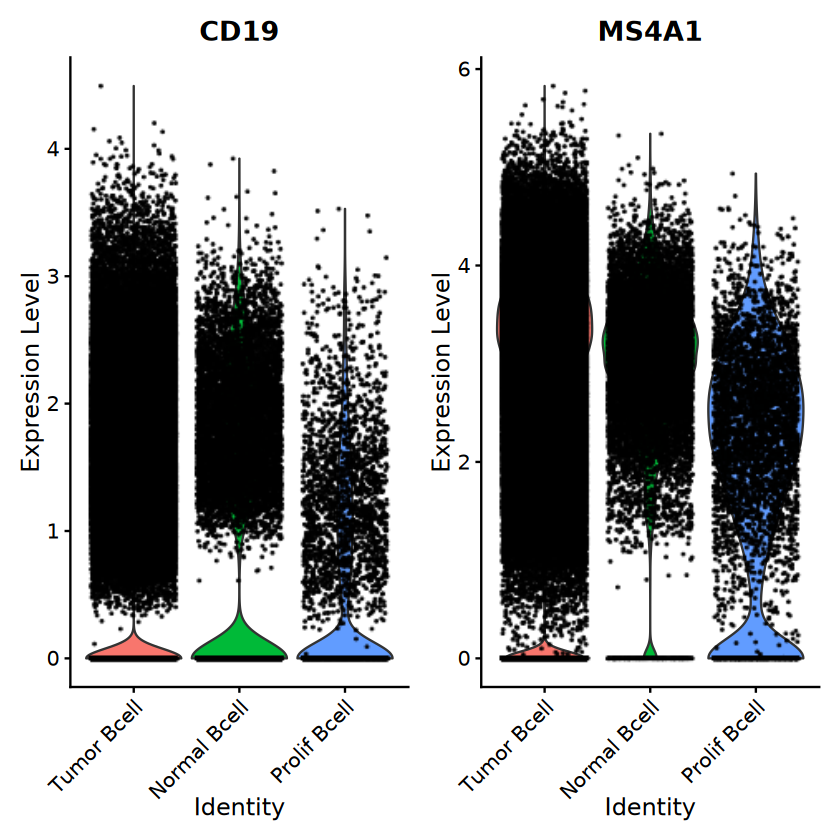

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



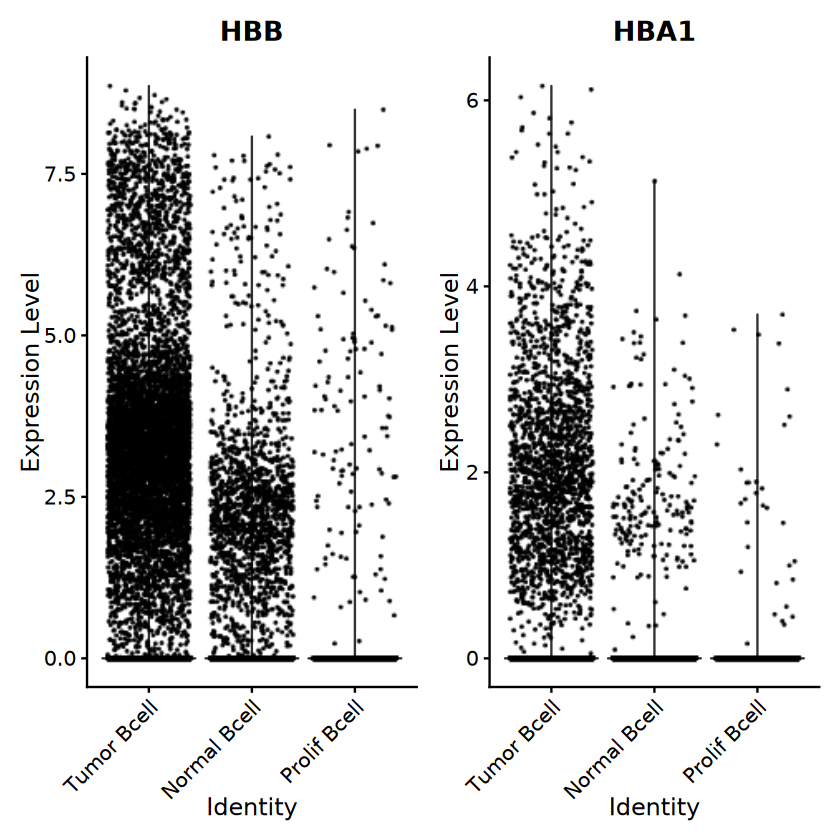

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



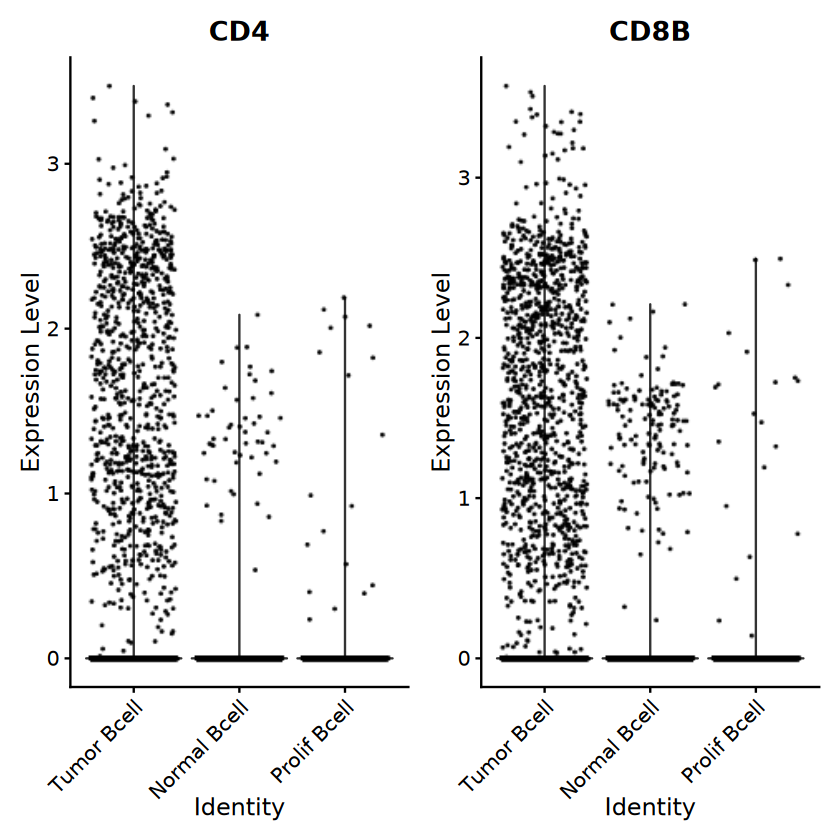

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



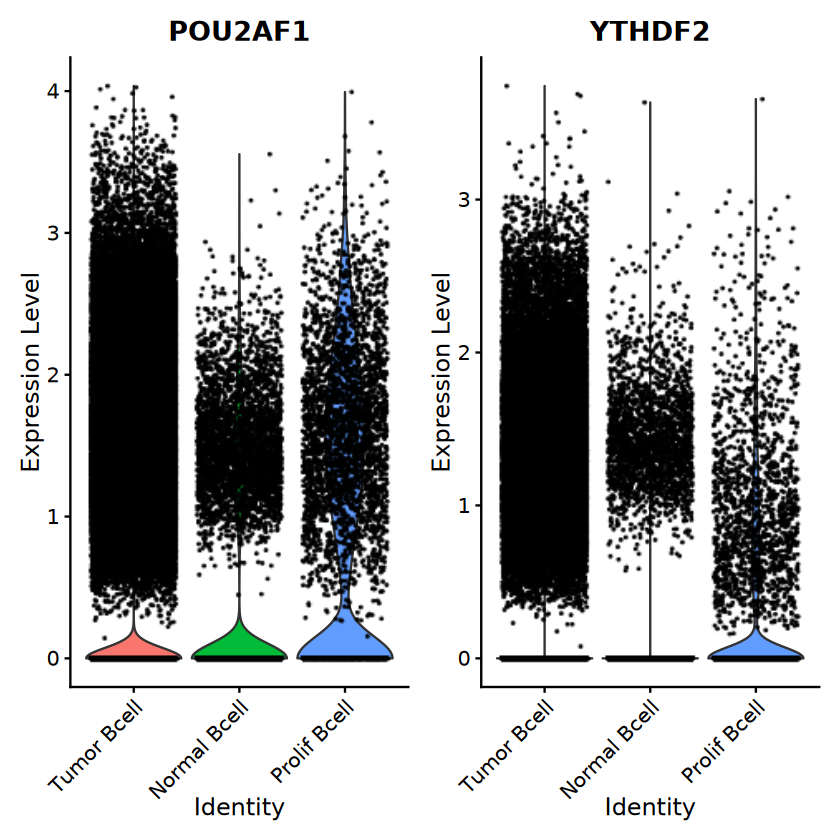

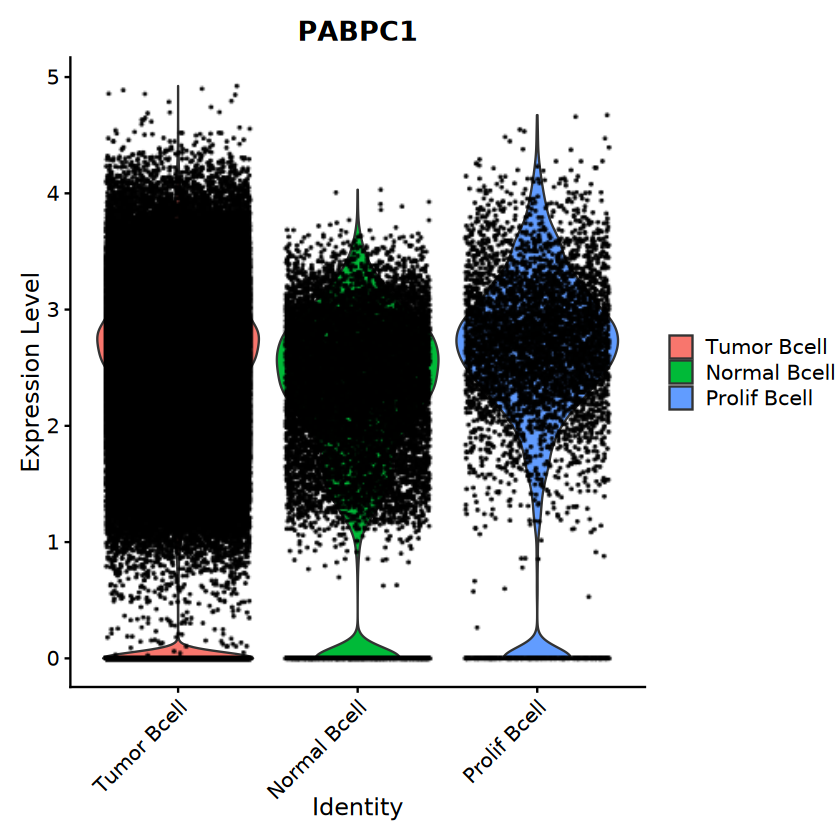

In [6]:
VlnPlot(bcells, features = c("CD19", "MS4A1"), combine = TRUE)
VlnPlot(bcells, features = c("HBB", "HBA1"), combine = TRUE)
VlnPlot(bcells, features = c("CD4", "CD8B"), combine = TRUE)
VlnPlot(bcells, features = c("POU2AF1", "YTHDF2"), combine = TRUE)
VlnPlot(bcells, features = c("PABPC1"), combine = TRUE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Warning message:
“Scaling data with a low number of groups may produce misleading results”


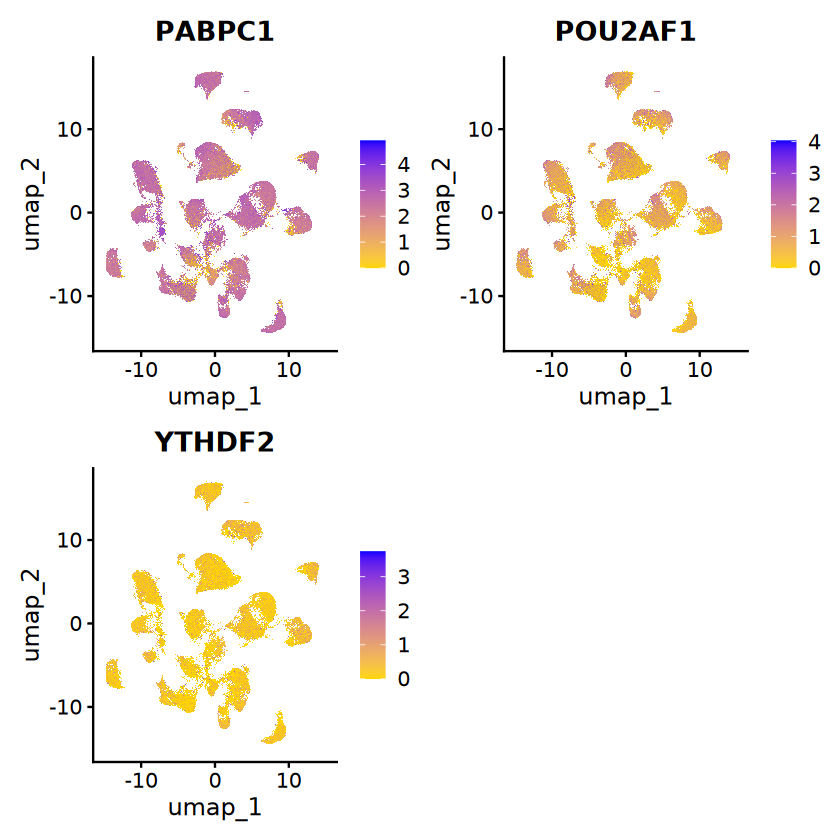

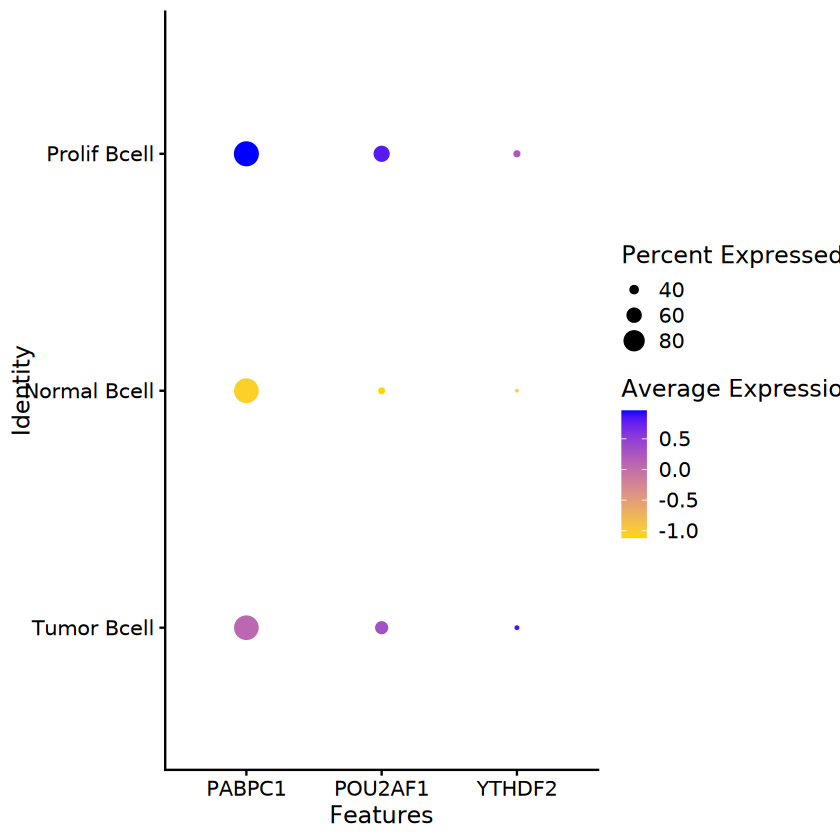

In [2]:
library(Seurat)
Gene_set <- c("PABPC1", "POU2AF1", "YTHDF2")
FeaturePlot(bcells, features = Gene_set, cols = c("gold", "blue"))
DotPlot(object = bcells, features = Gene_set, group.by = 'new.ident', cols = c("gold", "blue"))

`summarise()` has grouped output by 'seurat_clusters'. You can override using the `.groups` argument.


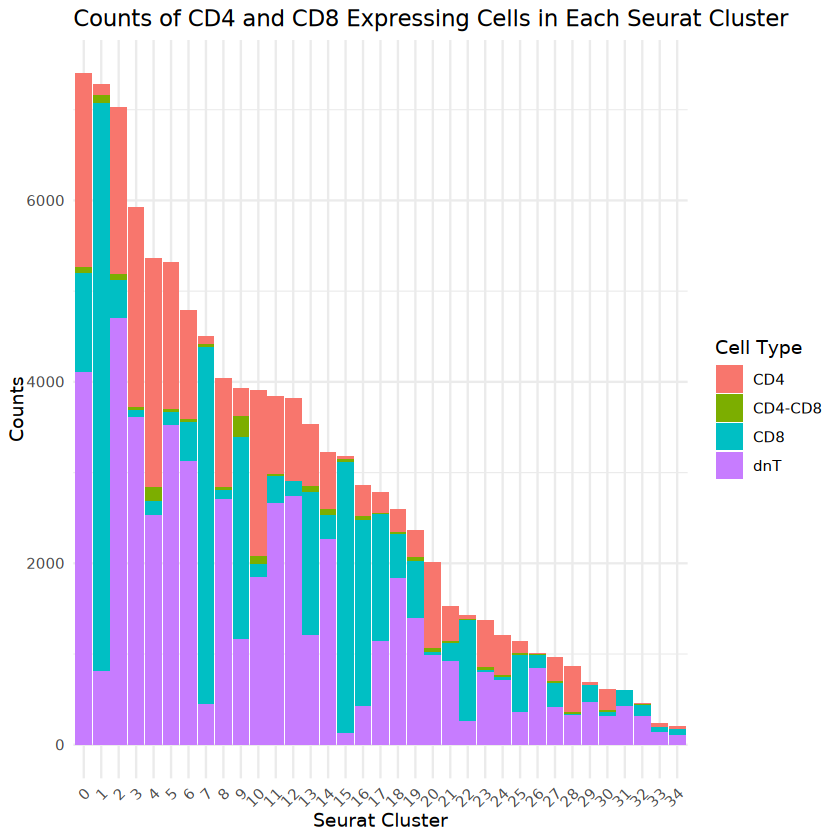

In [21]:
library(Seurat)
library(ggplot2)
library(dplyr)

#tcells@active.ident <- tcells$'RNA_snn_res.1.8'
# Assuming 'merged_obj' is your Seurat object
tcells$seurat_clusters <- tcells@active.ident
# Fetch data for CD4 and CD8B
cd4_data <- FetchData(object = tcells, vars = "CD4")
cd8_data <- FetchData(object = tcells, vars = c("CD8B", "CD8A"))

# Combine the data frames
combined_data <- cbind(cd4_data, cd8_data)

# Create a new metadata column 'cell_type'
cell_type <- ifelse(combined_data$CD4 > 0 & (combined_data$CD8B > 0 | combined_data$CD8A > 0), "CD4-CD8",
                    ifelse(combined_data$CD4 > 0, "CD4",
                           ifelse(combined_data$CD8B > 0 | combined_data$CD8A > 0, "CD8", "dnT")))

# Add the 'cell_type' column to the metadata
tcells <- AddMetaData(object = tcells, metadata = cell_type, col.name = "cell_type")
# Count the number of cells in each category per cluster
cell_counts <- tcells@meta.data %>%
  group_by(seurat_clusters, cell_type) %>%
  summarise(count = n()) %>%
  ungroup()

# Create the bar plot using ggplot2
ggplot(cell_counts, aes(x = factor(seurat_clusters), y = count, fill = cell_type)) +
  geom_bar(stat = "identity", position = "stack") +
  labs(x = "Seurat Cluster", y = "Counts", fill = "Cell Type") +
  theme_minimal() +
  ggtitle("Counts of CD4 and CD8 Expressing Cells in Each Seurat Cluster")+
  theme(axis.text.x = element_text(angle = 45, hjust = 1))

Warning message:
“The following requested variables were not found: GMZK”


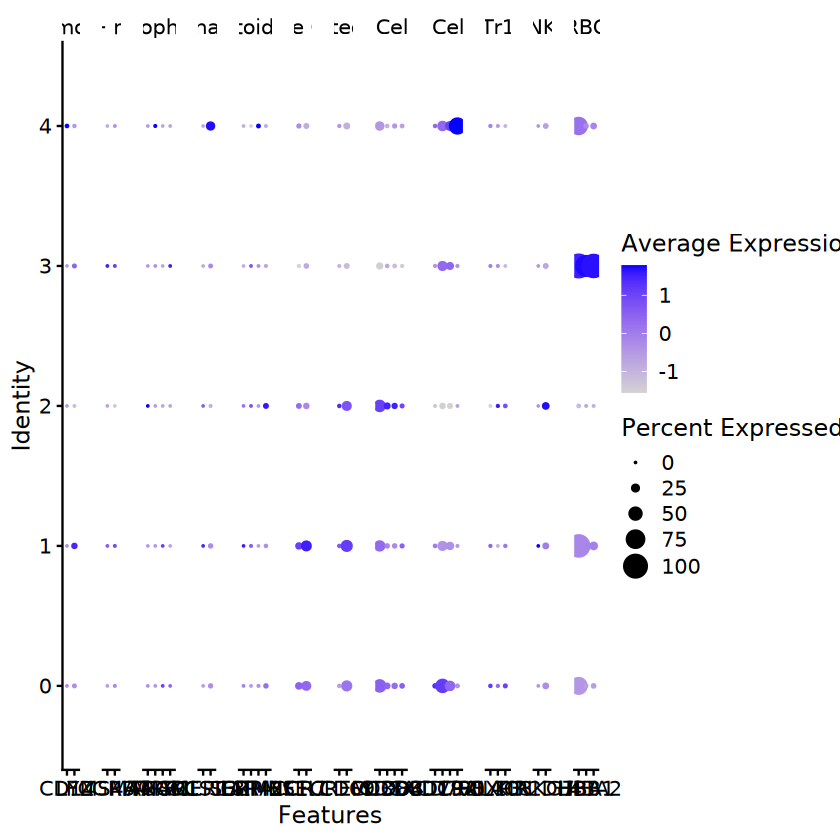

In [23]:
library(Seurat)
library(ggplot2)
library(grid)

Idents(object = clus14) <- clus14$`RNA_snn_res.0.1`
# List of known celltype markers
markers <- list()
markers[["CD14+ monocytes"]] <- c("CD14", "LYZ")
markers[["FCGR3A+ monocyte"]] <- c("FCGR3A", "MS4A7")
markers[["Macrophages"]] <- c("MARCO", "ITGAM", "MRC1", "MSR1")
markers[["Conventional dendritic"]] <- c("FCER1A", "CST3")
markers[["Plasmacytoid dendritic"]] <- c("IL3RA", "GZMB", "SERPINF1", "ITM2C")
markers[["Naive Cells"]] <- c("CCR7", "SELL")
markers[["Activated Cells"]] <- c("CREM", "CD69")
markers[["T Cells"]] <- c("CD3D", "CD8A", "CD8B", "CD4")
markers[["B Cells"]] <- c("CD19", "CD79A", "CD79B", "CR2")
markers[["Tr1"]] <- c("FOXP3", "IL10", "LAG3")
markers[["NK"]] <- c("KIR2DL4", "NKG7", "GMZK")
markers[["RBC"]] <- c("HBB", "HBA1", "HBA2")

# Create dotplot based on RNA expression
Dot <- DotPlot(Seurat_obj, markers, assay="RNA")
Dot
ggsave("Generalized-DotPlot.jpeg", plot = Dot, width = 2400 / 100, height = 1200 / 100, units = "in", dpi = 100)

In [5]:
all.markers <- FindAllMarkers(object = tcells)
save(all.markers, file = "merged_patients_tcell_markers-unlabeled.Robj")
#all.markers
write.csv(all.markers, file = "merged_patients_tcell_markers-unlabeled.csv")

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16

Calculating cluster 17

Calculating cluster 18

Calculating cluster 19

Calculating cluster 20

Calculating cluster 21

Calculating cluster 22

Calculating cluster 23

Calculating cluster 24

Calculating cluster 25

Calculating cluster 26

Calculating cluster 27

Calculating cluster 28

Calculating cluster 29

Calculating cluster 30

Calculating cluster 31

Calculating cluster 32

Calculating cluster 33



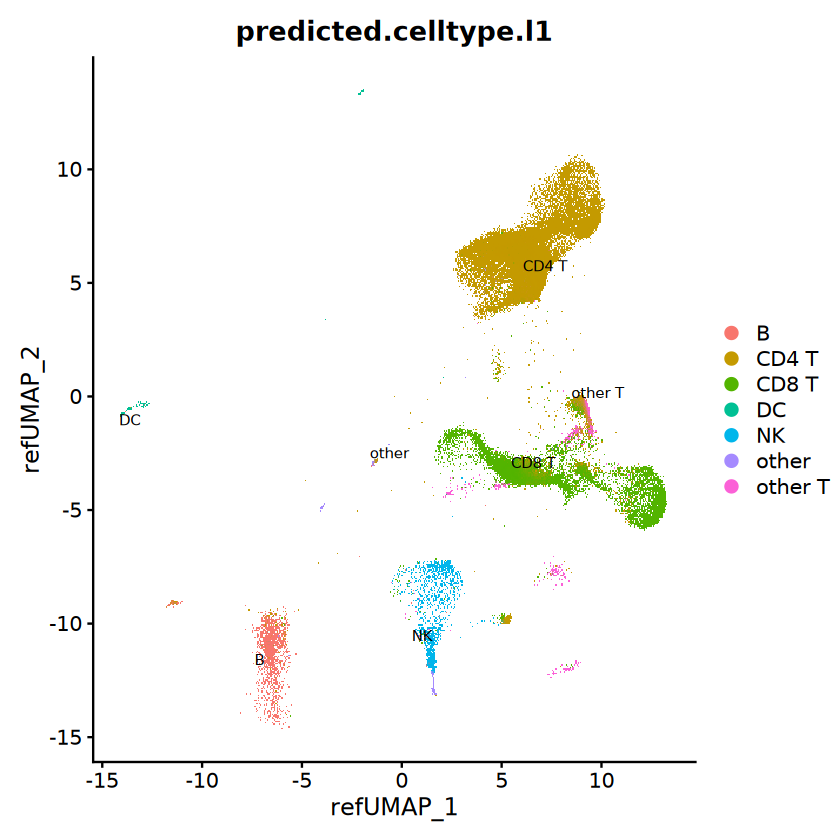

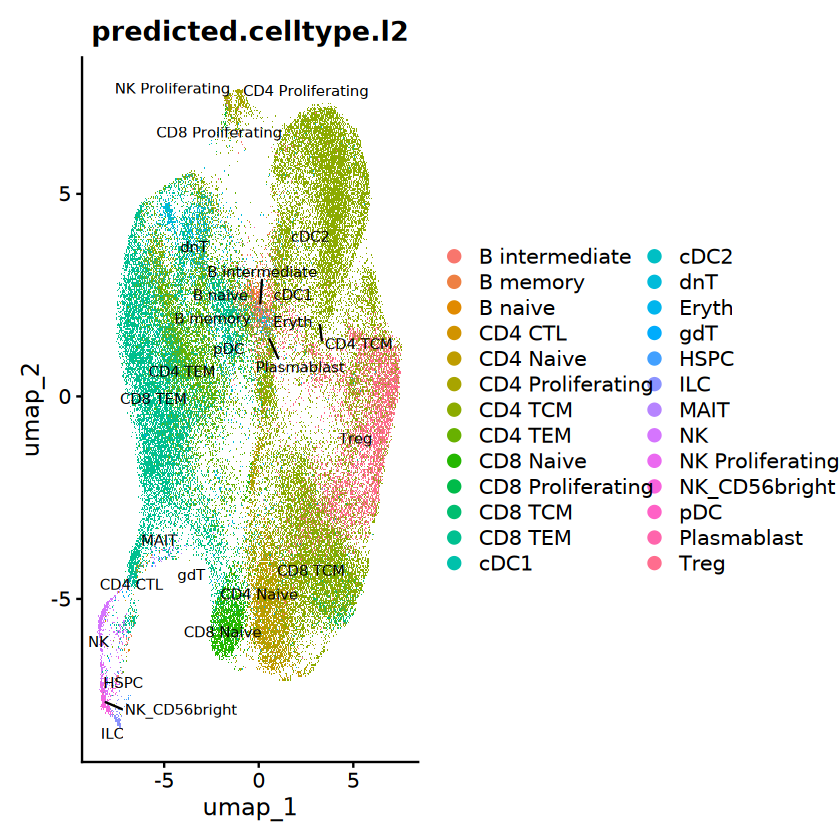

In [6]:
p1
p2

Normalizing query using reference SCT model

Projecting cell embeddings

Finding neighborhoods

Finding anchors

	Found 18168 anchors

Finding integration vectors

Finding integration vector weights

Predicting cell labels

Warning message:
“Layer counts isn't present in the assay object; returning NULL”
Predicting cell labels

Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”
Warning message:
“Layer counts isn't present in the assay object; returning NULL”
Warning message:
“Layer counts isn't present in the assay object; returning NULL”
Warning message:
“Layer counts isn't present in the assay object; returning NULL”

Integrating dataset 2 with reference dataset

Finding integration vectors

Integrating data

Computing nearest neighbors

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-lea

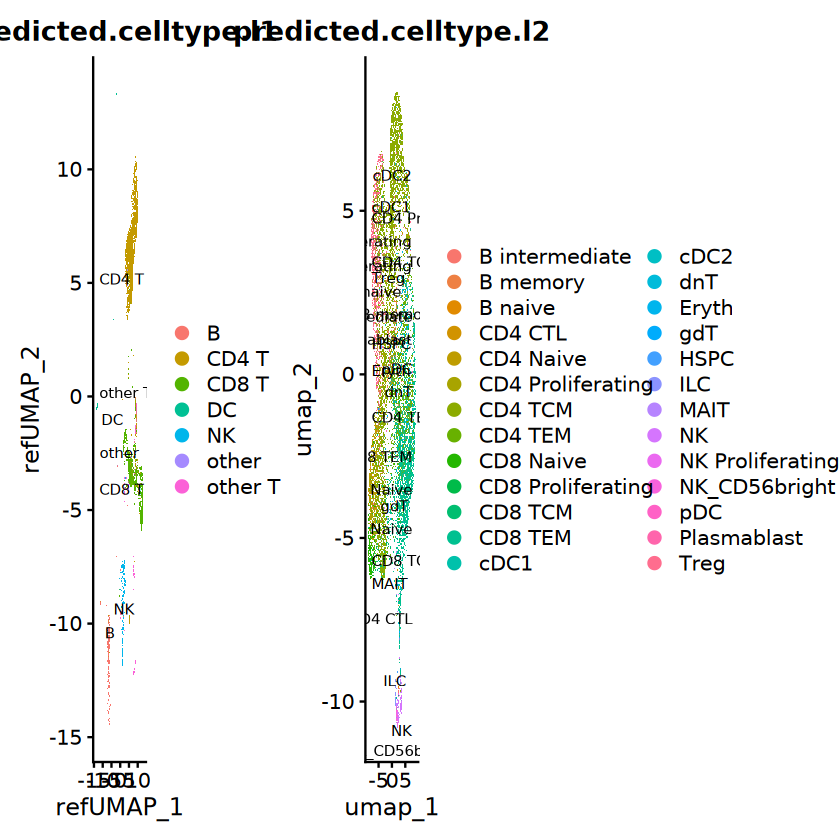

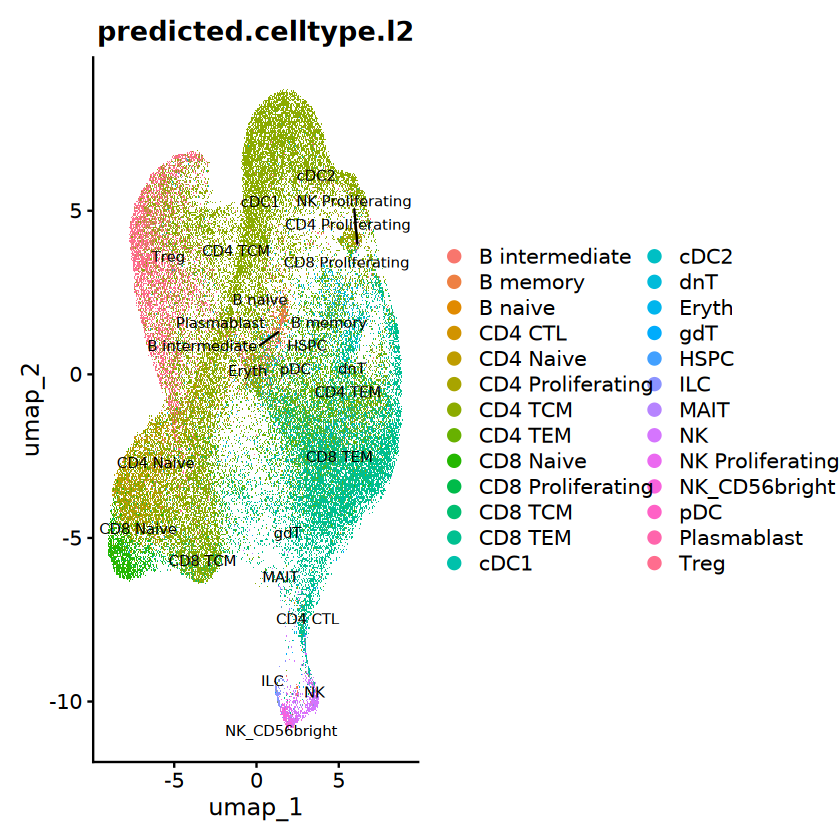

In [7]:
library(Seurat)
library(ggplot2)
library(dplyr)

reference <- readRDS("/home/exacloud/gscratch/ShreeLab/FabianS/Jupyter/pbmc_multimodal_2023.rds")

anchors <- FindTransferAnchors(
  reference = reference,
  query = int_tcells,
  normalization.method = "SCT",
  reference.reduction = "spca",
  dims = 1:50
)

PBMC.Tcells <- MapQuery(
  anchorset = anchors,
  query = int_tcells,
  reference = reference,
  refdata = list(
    celltype.l1 = "celltype.l1",
    celltype.l2 = "celltype.l2"
  ),
  reduction.model = "wnn.umap"
)
p1 = DimPlot(PBMC.Tcells, reduction = "umap", group.by = "predicted.celltype.l1", label = TRUE, label.size = 3, repel = TRUE)
p2 = DimPlot(PBMC.Tcells, reduction = "umap", group.by = "predicted.celltype.l2", label = TRUE, label.size = 3 ,repel = TRUE)
p1 + p2
p2

In [9]:
p1 = DimPlot(PBMC.Tcells, reduction = "umap", group.by = "predicted.celltype.l1", label = TRUE, label.size = 3, repel = TRUE)
p2 = DimPlot(PBMC.Tcells, reduction = "umap", group.by = "predicted.celltype.l2", label = TRUE, label.size = 3 ,repel = TRUE)
ggsave("test1.jpeg", plot = p1, width = 14, height = 8, units = "in", dpi = 100, limitsize = FALSE)
ggsave("test2.jpeg", plot = p2, width = 14, height = 8, units = "in", dpi = 100, limitsize = FALSE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



In [4]:
head(tcells)

,orig.ident,nCount_RNA,nFeature_RNA,patient,site,timepoint,site.timepoint,tissue,patient.timepoint,patient.site,⋯,RNA_snn_res.1.4,RNA_snn_res.1.2,RNA_snn_res.1,RNA_snn_res.0.8,RNA_snn_res.0.65,RNA_snn_res.0.7,RNA_snn_res.0.75,RNA_snn_res.0.9,RNA_snn_res.0.85,new.ident
,<chr>,<dbl>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>
30021_lesA_pre-AAACCTGAGCCACCTG,SeuratProject,3778.400,1264,30021,lesA,pre,lesA_pre,lymph,30021_pre,30021_lesA,⋯,1,1,0,0,1,1,0,0,0,CD4.naive
30021_lesA_pre-AAACCTGAGTACTTGC,SeuratProject,2439.354,1017,30021,lesA,pre,lesA_pre,lymph,30021_pre,30021_lesA,⋯,6,4,0,0,1,1,0,0,0,Treg
30021_lesA_pre-AAACCTGCACCTCGTT,SeuratProject,3144.359,1243,30021,lesA,pre,lesA_pre,lymph,30021_pre,30021_lesA,⋯,6,6,7,6,7,7,8,6,7,Treg
30021_lesA_pre-AAACGGGGTACCTACA,SeuratProject,2298.424,935,30021,lesA,pre,lesA_pre,lymph,30021_pre,30021_lesA,⋯,1,1,0,0,1,1,0,0,0,CD4.naive
30021_lesA_pre-AAACGGGGTGGCGAAT,SeuratProject,1639.069,799,30021,lesA,pre,lesA_pre,lymph,30021_pre,30021_lesA,⋯,6,6,0,6,1,7,0,6,7,Treg
30021_lesA_pre-AAAGATGCAATGAATG,SeuratProject,2898.752,1218,30021,lesA,pre,lesA_pre,lymph,30021_pre,30021_lesA,⋯,0,3,6,1,0,0,7,1,17,CD8.TEM
30021_lesA_pre-AAAGCAACACGAAATA,SeuratProject,2978.429,1205,30021,lesA,pre,lesA_pre,lymph,30021_pre,30021_lesA,⋯,7,5,7,6,7,7,8,6,7,Treg
30021_lesA_pre-AAAGCAAGTTATCCGA,SeuratProject,3020.362,1345,30021,lesA,pre,lesA_pre,lymph,30021_pre,30021_lesA,⋯,2,2,2,3,4,4,4,3,3,Tfh
30021_lesA_pre-AAAGCAATCCACGTGG,SeuratProject,9465.418,2767,30021,lesA,pre,lesA_pre,lymph,30021_pre,30021_lesA,⋯,1,1,0,0,1,1,0,0,0,CD4.naive


In [ ]:
tcells[["RNA"]] <- split(tcells[["RNA"]], f = ifnb$patient)

In [12]:
test <- DimPlot(int_tcells, reduction = "umap", split.by = "patient")
ggsave("test.jpeg", plot = test, width = 70, height = 12, units = "in", dpi = 350, limitsize = FALSE)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



`summarise()` has grouped output by 'seurat_clusters'. You can override using the `.groups` argument.


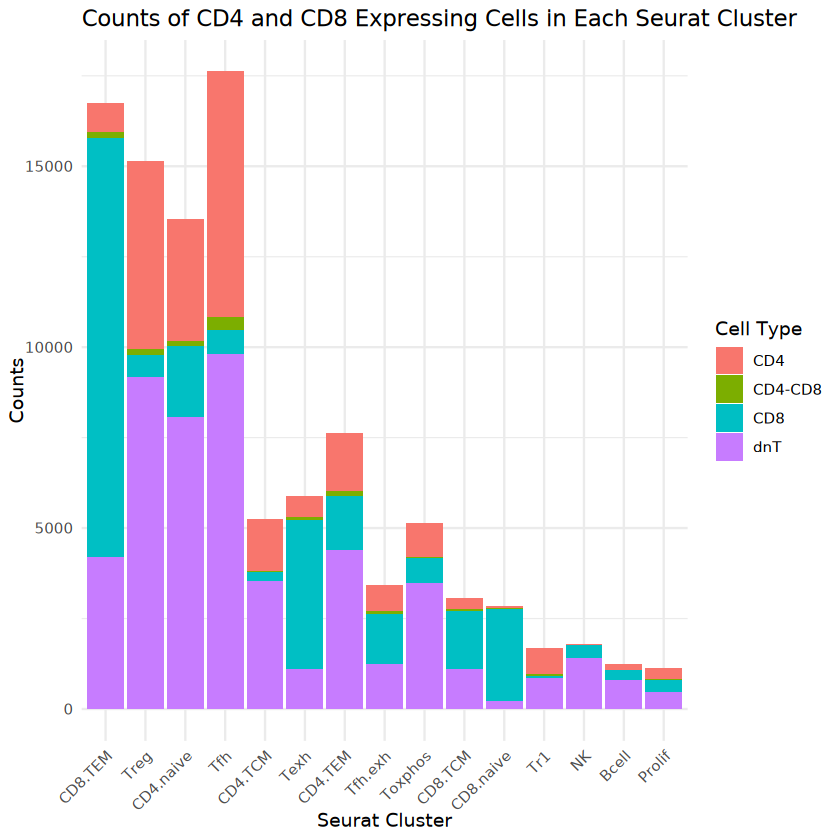

In [7]:
library(Seurat)
library(ggplot2)
library(dplyr)

#int_tcells@active.ident <- int_tcells$'RNA_snn_res.1.4'
# Assuming 'merged_obj' is your Seurat object
int_tcells$seurat_clusters <- int_tcells@active.ident
# Fetch data for CD4 and CD8B
cd4_data <- FetchData(object = int_tcells, vars = "CD4")
cd8_data <- FetchData(object = int_tcells, vars = c("CD8B", "CD8A"))

# Combine the data frames
combined_data <- cbind(cd4_data, cd8_data)

# Create a new metadata column 'cell_type'
cell_type <- ifelse(combined_data$CD4 > 0 & (combined_data$CD8B > 0 | combined_data$CD8A > 0), "CD4-CD8",
                    ifelse(combined_data$CD4 > 0, "CD4",
                           ifelse(combined_data$CD8B > 0 | combined_data$CD8A > 0, "CD8", "dnT")))

# Add the 'cell_type' column to the metadata
int_tcells <- AddMetaData(object = int_tcells, metadata = cell_type, col.name = "cell_type")
# Count the number of cells in each category per cluster
cell_counts <- int_tcells@meta.data %>%
  group_by(seurat_clusters, cell_type) %>%
  summarise(count = n()) %>%
  ungroup()

# Create the bar plot using ggplot2
ggplot(cell_counts, aes(x = factor(seurat_clusters), y = count, fill = cell_type)) +
  geom_bar(stat = "identity", position = "stack") +
  labs(x = "Seurat Cluster", y = "Counts", fill = "Cell Type") +
  theme_minimal() +
  ggtitle("Counts of CD4 and CD8 Expressing Cells in Each Seurat Cluster")+
  theme(axis.text.x = element_text(angle = 45, hjust = 1))

[1] "0"  "1"  "2"  "3"  "4"  "5"  "6"  "7"  "8"  "9"  "10" "11" "12" "13" "14"
[16] "15" "16" "17" "18" "19" "20" "21" "22" "23" "24" "25" "26" "27" "28" "29"
[31] "30" "31"

[1] "CD8.TEM"   "Treg"      "CD4.naive" "Tfh"       "CD4.TCM"   "Texh"     
 [7] "CD4.TEM"   "pTexh"     "Toxphos"   "CD8.TCM"   "CD8.naive" "Tr1"      
[13] "NK"        "Bcell"     "Prolif"

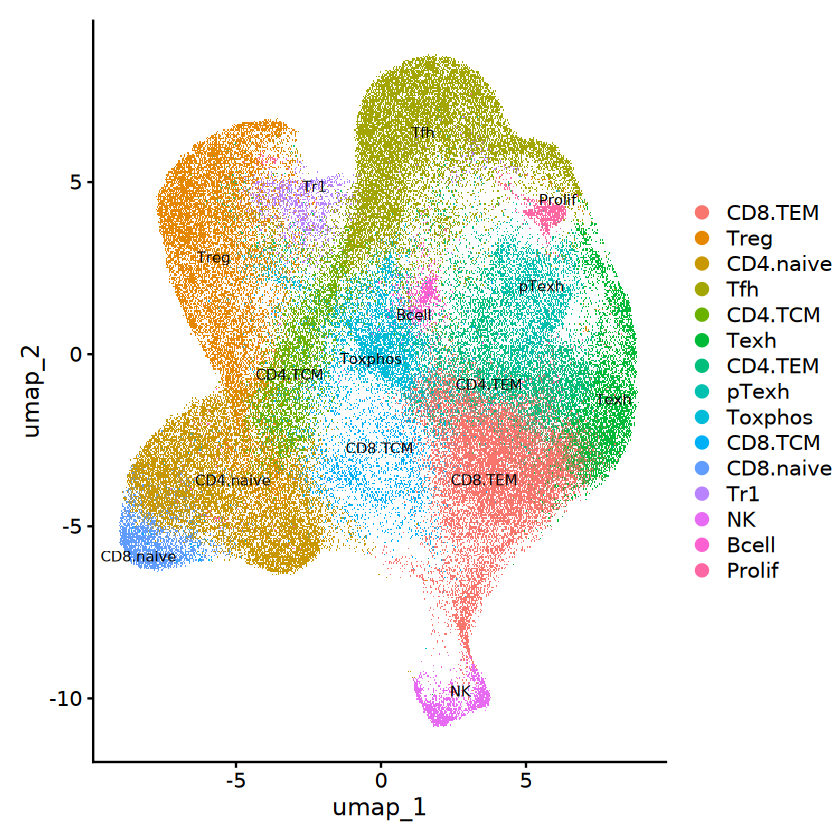

[1] Treg      CD4.naive CD8.TEM   Tfh       CD8.TCM   Texh      Tr1      
 [8] CD8.naive Toxphos   Bcell     CD4.TCM   pTexh     NK        Prolif   
[15] CD4.TEM  
15 Levels: CD8.TEM Treg CD4.naive Tfh CD4.TCM Texh CD4.TEM pTexh ... Prolif

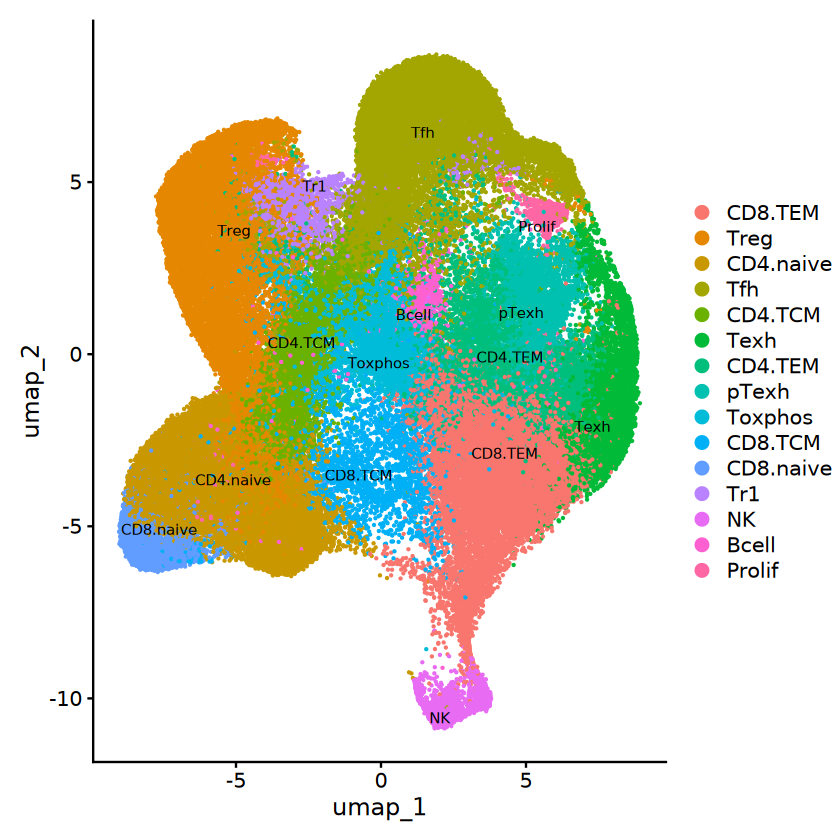

In [19]:
# Rename cell identity classes for res 1.9
int_tcells@active.ident <- as.factor(int_tcells$`RNA_snn_res.1.4`)
# Can provide an arbitrary amount of idents to rename
levels(int_tcells)
#> [1] "0" "1" "2"
int_tcells <- RenameIdents(
  int_tcells,
  '0' = 'CD8.TEM',
  '1' = 'Treg',
  '2' = 'CD4.naive',
  '3' = 'Tfh', 
  '4' = 'Tfh', 
  '5' = 'CD4.TCM', 
  '6' = 'CD4.naive', 
  '7' = 'Treg', 
  '8' = 'Texh', 
  '9' = 'Tfh', 
  '10' = 'CD8.TEM',
  '11' = 'CD4.TEM', 
  '12' = 'CD8.TEM', 
  '13' = 'CD4.TEM',
  '14' = 'pTexh',
  #'15' = 'RBC',
  '15' = 'Toxphos', 
  '16' = 'CD8.TCM', 
  '17' = 'CD4.naive',
  '18' = 'CD8.naive', 
  '19' = 'Treg', 
  '20' = 'Treg', 
  '21' = 'Toxphos', 
  '22' = 'Tr1',
  '23' = 'CD8.TEM',
  '23' = 'CD8.TEM', 
  '24' = 'NK', 
  '25' = 'Texh',
  '26' = 'Tfh',
  '27' = 'Bcell', 
  '28' = 'Tfh', 
  '29' = 'Prolif',
  '30' = 'CD8.TEM', 
  '31' = 'NK'
)
levels(int_tcells)
DimPlot(int_tcells, reduction = "umap", label = TRUE, label.size = 3 ,repel = TRUE, raster = TRUE)
DimPlot(int_tcells, reduction = "umap", label = TRUE, label.size = 3 ,repel = TRUE, raster = FALSE)

int_tcells$new.ident2 <- int_tcells@active.ident 
unique(int_tcells$new.ident2)


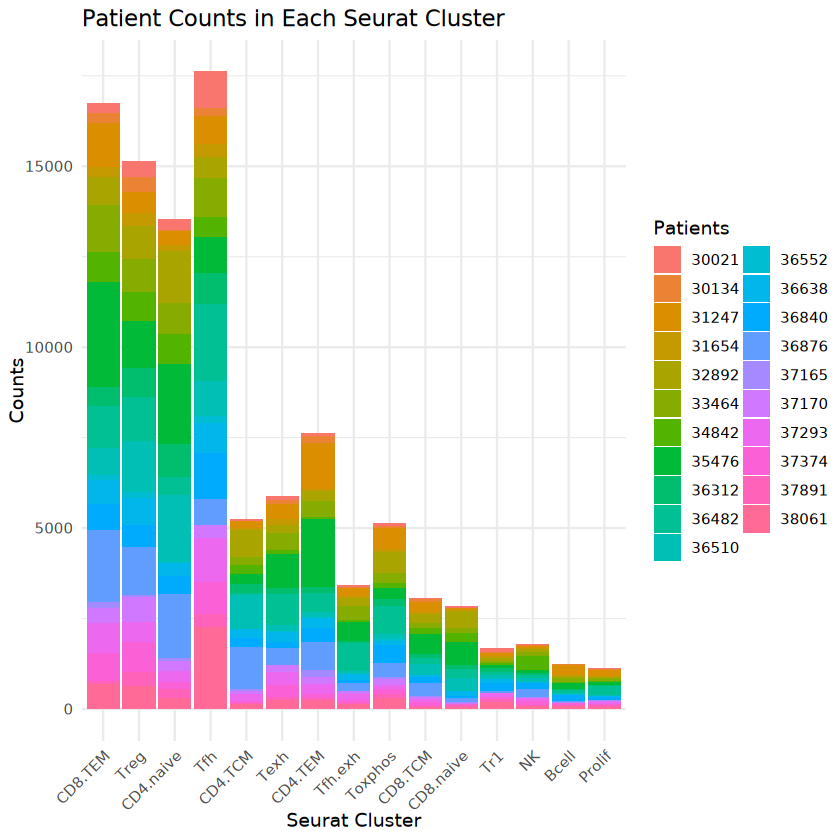

In [8]:
data <- as.data.frame(table(Idents(int_tcells), int_tcells$patient))

# Rename columns for clarity
colnames(data) <- c("Cluster", "Patient", "Count")

ggplot(data, aes(x = Cluster, y = Count, fill = factor(Patient))) +
  geom_bar(stat = "identity") +
  labs(title = "Patient Counts in Each Seurat Cluster",
       x = "Seurat Cluster", y = "Counts", fill = "Patients") +
  theme_minimal() +
  theme(axis.text.x = element_text(angle = 45, hjust = 1))

`summarise()` has grouped output by 'seurat_clusters'. You can override using the `.groups` argument.


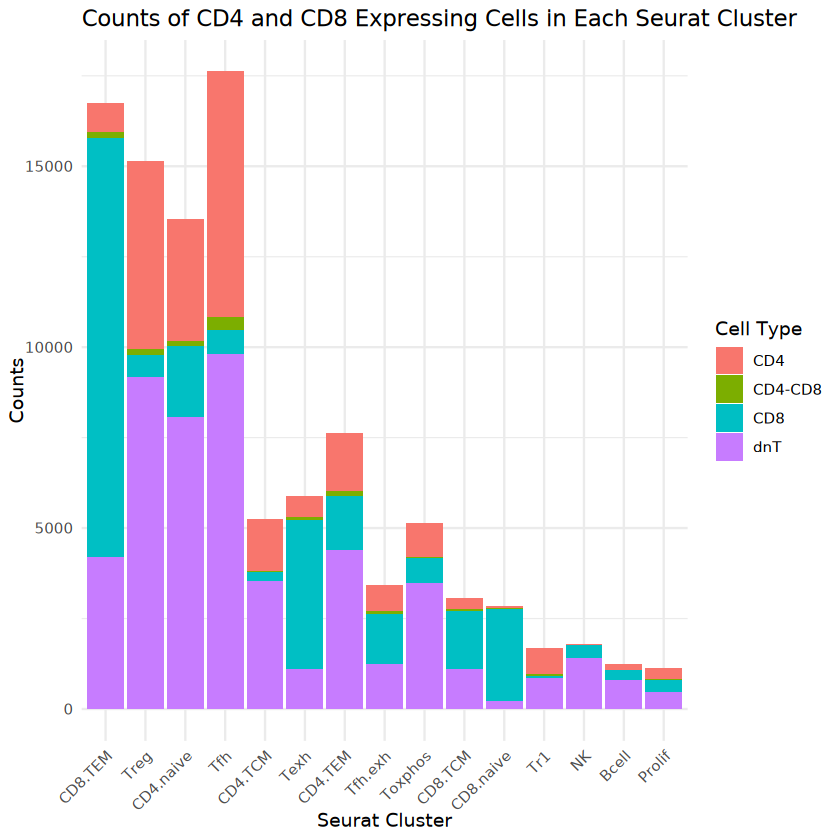

In [5]:
#int_tcells@active.ident <- int_tcells$'RNA_snn_res.1.2'
# Assuming 'merged_obj' is your Seurat object
int_tcells$seurat_clusters <- int_tcells@active.ident
# Fetch data for CD4 and CD8B
cd4_data <- FetchData(object = int_tcells, vars = "CD4")
cd8_data <- FetchData(object = int_tcells, vars = c("CD8B", "CD8A"))

# Combine the data frames
combined_data <- cbind(cd4_data, cd8_data)

# Create a new metadata column 'cell_type'
cell_type <- ifelse(combined_data$CD4 > 0 & (combined_data$CD8B > 0 | combined_data$CD8A > 0), "CD4-CD8",
                    ifelse(combined_data$CD4 > 0, "CD4",
                           ifelse(combined_data$CD8B > 0 | combined_data$CD8A > 0, "CD8", "dnT")))

# Add the 'cell_type' column to the metadata
int_tcells <- AddMetaData(object = int_tcells, metadata = cell_type, col.name = "cell_type")
# Count the number of cells in each category per cluster
cell_counts <- int_tcells@meta.data %>%
  group_by(seurat_clusters, cell_type) %>%
  summarise(count = n()) %>%
  ungroup()

# Create the bar plot using ggplot2
ggplot(cell_counts, aes(x = factor(seurat_clusters), y = count, fill = cell_type)) +
  geom_bar(stat = "identity", position = "stack") +
  labs(x = "Seurat Cluster", y = "Counts", fill = "Cell Type") +
  theme_minimal() +
  ggtitle("Counts of CD4 and CD8 Expressing Cells in Each Seurat Cluster")+
  theme(axis.text.x = element_text(angle = 45, hjust = 1))

In [50]:
int_tcells@active.ident <- int_tcells$'RNA_snn_res.1.4'
int_tcells$seurat_clusters <- int_tcells@active.ident

other <- FindMarkers(object = int_tcells, ident.1 = '15')
head(x = other)

other <- FindMarkers(object = int_tcells, ident.1 = '9', ident.2 = '14')
head(x = other)

other <- FindMarkers(object = int_tcells, ident.1 = '21')
head(x = other)

other <- FindMarkers(object = int_tcells, ident.1 = '27')
head(x = other)

other <- FindMarkers(object = int_tcells, ident.1 = '12')
head(x = other)

other <- FindMarkers(object = int_tcells, ident.1 = '16')
head(x = other)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
RPS9,0.000000e+00,-0.7591798,0.660,0.936,0.000000e+00
RPL3,0.000000e+00,-0.8061421,0.761,0.964,0.000000e+00
EEF1A1,0.000000e+00,-0.7372954,0.981,0.996,0.000000e+00
MALAT1,0.000000e+00,0.8787433,0.983,0.987,0.000000e+00
TMSB4X,1.521946e-296,-0.5300769,0.953,0.995,3.588597e-292
RPL13,3.769145e-290,-0.5736449,0.940,0.991,8.887268e-286


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
GZMK,0,-5.803560,0.052,0.950,0
CST7,0,-4.898096,0.092,0.881,0
CD40LG,0,4.446539,0.652,0.056,0
SMCO4,0,2.521879,0.741,0.203,0
EOMES,0,-5.290610,0.019,0.535,0
IL21,0,5.246565,0.494,0.023,0


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
EEF1B2,0,-2.262747,0.259,0.895,0
RPS5,0,-2.444224,0.320,0.949,0
TOMM7,0,-1.656492,0.253,0.841,0
RPSA,0,-2.192869,0.350,0.934,0
RPL27,0,-1.774517,0.307,0.891,0
COMMD6,0,-1.502704,0.238,0.822,0


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
HLA-DRA,0,3.242422,0.816,0.269,0
CD79A,0,2.743070,0.548,0.152,0
HLA-DQA1,0,2.764564,0.505,0.137,0
HLA-DQA2,0,2.824710,0.424,0.105,0
TCL1A,0,3.919713,0.326,0.036,0
MEF2C,0,3.707785,0.305,0.035,0


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
GZMK,0,1.646764,0.927,0.383,0
CCL5,0,1.719096,0.787,0.309,0
GZMA,0,1.861764,0.743,0.280,0
CCL4,0,1.327840,0.644,0.227,0
CST7,0,1.482853,0.854,0.441,0
FXYD5,0,-1.134610,0.407,0.784,0


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
IL7R,0.000000e+00,1.0697561,0.706,0.359,0.000000e+00
NELL2,0.000000e+00,1.7896963,0.326,0.102,0.000000e+00
RPS12,0.000000e+00,0.5117572,0.998,0.987,0.000000e+00
RPL13,0.000000e+00,0.4134767,0.998,0.989,0.000000e+00
KLF2,6.827450e-285,1.1688963,0.544,0.256,1.609844e-280
RPS14,1.180968e-272,0.3947013,0.994,0.981,2.784606e-268


In [42]:
int_tcells@active.ident <- as.factor(int_tcells$`RNA_snn_res.1.4`)
t.markers <- FindAllMarkers(object = int_tcells)
save(t.markers, file = "int_tcell-markers-unlabeled.Robj")
write.csv(t.markers, file = "int_tcell-markers-unlabeled.csv")

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16

Calculating cluster 17

Calculating cluster 18

Calculating cluster 19

Calculating cluster 20

Calculating cluster 21

Calculating cluster 22

Calculating cluster 23

Calculating cluster 24

Calculating cluster 25

Calculating cluster 26

Calculating cluster 27

Calculating cluster 28

Calculating cluster 29

Calculating cluster 30

Calculating cluster 31

